<a href="https://colab.research.google.com/github/romqn1999/Predict-price-after-pattern/blob/main/Find_price_patterns.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Find price patterns

## Install packages

In [ ]:
#optional installations: 
!pip install yfinance --upgrade --no-cache-dir
!pip3 install pandas_datareader
!pip install tsmoothie

     |████████████████████████████████| 6.3MB 37.1MB/s 
  Created wheel for yfinance: filename=yfinance-0.1.60-py2.py3-none-any.whl size=23819 sha256=9e47c5e8058fec192adf7e40a9847ba586dc70160ffd1a4c891a94e232b78aab
  Stored in directory: /tmp/pip-ephem-wheel-cache-dm95bgv5/wheels/f0/be/a4/846f02c5985562250917b0ab7b33fff737c8e6e8cd5209aa3b
Successfully built yfinance
  Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6


## Import packages

In [ ]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# ___library_import_statements___
import pandas as pd

# for pandas_datareader, otherwise it might have issues, sometimes there is some version mismatch
pd.core.common.is_list_like = pd.api.types.is_list_like
import pandas_datareader.data as web
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import argrelextrema
import datetime
import time

#newest yahoo API 
import yfinance as yahoo_finance

from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import DotProduct, WhiteKernel, RBF, ConstantKernel as C

from tsmoothie.smoother import *

#optional 
#yahoo_finance.pdr_override()

%matplotlib inline

## Get data

In [ ]:
#@title Set symbol and time for get data
ticker = "All" #@param ["AA", "AAA", "AAAU", "AABB", "AAC", "AACG", "AACQ", "AADAX", "AADEX", "AADR", "AADTX", "AAEEF", "AAGC", "AAGH", "AAIC", "AAIGF", "AAIIQ", "AAIRF", "AAL", "AAMC", "AAME", "AAMMF", "AAN", "AAOI", "AAP", "AAPL", "AAPT", "AAQC", "AASP", "AASZF", "AAT", "AATGF", "AATRL", "AATV", "AAVVF", "AAVXF", "AAWW", "AAXJ", "ABB", "ABBRF", "ABBV", "ABC", "ABCB", "ABCL", "ABCM", "ABEO", "ABEV", "ABG", "ABGI", "ABGSF", "ABIO", "ABKB", "ABLZF", "ABM", "ABMBF", "ABMC", "ABMD", "ABML", "ABMT", "ABNAF", "ABNB", "ABQQ", "ABR", "ABRRP", "ABST", "ABT", "ABTI", "ABTX", "ABVC", "ABVG", "ABWN", "ABXXF", "ABZPF", "ABZPY", "ABZT", "ABZUF", "ACA", "ACAC", "ACAD", "ACB", "ACBA", "ACBAU", "ACBI", "ACC", "ACCD", "ACDSF", "ACDVF", "ACER", "ACES", "ACET", "ACEV", "ACFL", "ACFN", "ACGBY", "ACGL", "ACGLO", "ACGLP", "ACH", "ACHC", "ACHL", "ACHV", "ACI", "ACIC", "ACIU", "ACIW", "ACKAY", "ACKIU", "ACKIW", "ACKRF", "ACLLF", "ACLS", "ACM", "ACMC", "ACMR", "ACN", "ACNB", "ACND", "ACNNF", "ACNV", "ACP", "ACPRF", "ACR", "ACRDF", "ACRE", "ACRHF", "ACRS", "ACRX", "ACST", "ACTC", "ACTG", "ACV", "ACVA", "ACVF", "ACWI", "ACWV", "ACWX", "ACXIF", "ACY", "ADAP", "ADBE", "ADBRF", "ADC", "ADCOF", "ADCT", "ADDC", "ADDDF", "ADDXF", "ADDYY", "ADES", "ADFI", "ADFS", "ADGCF", "ADGO", "ADHC", "ADI", "ADIL", "ADKT", "ADM", "ADMA", "ADMP", "ADN", "ADNT", "ADP", "ADPT", "ADRNY", "ADS", "ADSK", "ADT", "ADTM", "ADTN", "ADTX", "ADV", "ADVM", "ADWPF", "ADX", "ADXN", "ADXS", "ADYEY", "ADYX", "ADYYF", "AE", "AEAC", "AEAU", "AEAW", "AEB", "AEBZY", "AEE", "AEEX", "AEF", "AEFC", "AEG", "AEGY", "AEHDX", "AEHL", "AEHR", "AEI", "AEIS", "AEL", "AELTF", "AEM", "AEMD", "AENG", "AENZ", "AEP", "AEPPL", "AEPT", "AER", "AES", "AESC", "AESE", "AESO", "AETUF", "AEVA", "AEXAY", "AEXE", "AEY", "AEYE", "AEZS", "AFAQ", "AFAQU", "AFAQW", "AFAVX", "AFAZX", "AFB", "AFBA", "AFBG", "AFBI", "AFC.L", "AFCG", "AFDIX", "AFDVX", "AFE.JO", "AFE.V", "AFG", "AFG.AX", "AFG.OL", "AFGC", "AFGD", "AFGYF", "AFH.JO", "AFHBL", "AFHIF", "AFHL.TA", "AFHP.L", "AFI", "AFIB", "AFIN", "AFINP", "AFJAX", "AFJCX", "AFK", "AFK.OL", "AFKS.ME", "AFL", "AFL.SG", "AFLG", "AFLT.ME", "AFLYY", "AFM.JF", "AFM.V", "AFMD", "AFML", "AFN.L", "AFP.L", "AFP.SW", "AFPW", "AFQSX", "AFRM", "AFS.L", "AFSIB", "AFSIC", "AFSIM", "AFSIN", "AFSIP", "AFT", "AFTM", "AFTPY", "AFW.AX", "AFW.DE", "AFW.DU", "AFW.F", "AFW.MU", "AFW.SG", "AFX.DE", "AFX.F", "AFX.HA", "AFX.L", "AFX.TI", "AFX.VI", "AFYA", "AFYG", "AFZ.BE", "AFZ.F", "AFZ.MU", "AFZ.SG", "AMC", "AMD", "AMZN", "BA", "BABA", "BB", "BTC", "BTC-USD", "DAX", "ETH-USD", "F", "FB", "GME", "GOOG", "IBM", "KO", "NFLX", "NOK", "NVDA", "PLUG", "QCOM", "QQQ", "QYLD", "R", "RIDE", "RIOT", "SNP", "SPCE", "SPY", "T", "TSLA", "V", "VIAC", "VICI", "VXRT", "VZ", "W", "WFC", "WMT", "X", "XOM", "XPEV", "Y", "Z", "ZM", "ZOM"] {allow-input: true}
tickers = ["AA", "AACG", "AACQ", "AADAX", "AADEX", "AADR", "AAIC", "AAIGF", "AAIIQ", "AAL", "AAMC", "AAME", "AAN", "AAOI", "AAP", "AAPL", "AASP", "AAT", "AATRL", "AAVVF", "AAVXF", "AAWW", "AAXJ", "ABB", "ABBV", "ABC", "ABCB", "ABCL", "ABEO", "ABEV", "ABG", "ABIO", "ABLZF", "ABM", "ABMD", "ABNAF", "ABNB", "ABR", "ABST", "ABT", "ABTX", "ABWN", "ACA", "ACAC", "ACAD", "ACB", "ACBI", "ACC", "ACCD", "ACDVF", "ACER", "ACES", "ACET", "ACFL", "ACFN", "ACGBY", "ACGL", "ACGLO", "ACH", "ACHC", "ACHV", "ACI", "ACIU", "ACIW", "ACKAY", "ACLLF", "ACLS", "ACM", "ACMR", "ACN", "ACNB", "ACP", "ACR", "ACRDF", "ACRE", "ACRHF", "ACRS", "ACRX", "ACST", "ACTC", "ACTG", "ACV", "ACWI", "ACWV", "ACWX", "ACXIF", "ACY", "ADAP", "ADBE", "ADC", "ADCT", "ADDDF", "ADDYY", "ADES", "ADHC", "ADI", "ADIL", "ADM", "ADMA", "ADMP", "ADNT", "ADP", "ADPT", "ADRNY", "ADS", "ADSK", "ADT", "ADTM", "ADTN", "ADTX", "ADVM", "ADX", "ADXN", "ADXS", "ADYEY", "ADYX", "ADYYF", "AE", "AEB", "AEE", "AEF", "AEFC", "AEG", "AEGY", "AEHL", "AEHR", "AEIS", "AEL", "AEM", "AEMD", "AENZ", "AEP", "AEPPL", "AEPT", "AER", "AES", "AESC", "AETUF", "AEXAY", "AEXE", "AEY", "AEYE", "AEZS", "AFAVX", "AFAZX", "AFB", "AFBA", "AFC.L", "AFCG", "AFDIX", "AFDVX", "AFE.JO", "AFG.OL", "AFGC", "AFGD", "AFH.JO", "AFHBL", "AFHIF", "AFHL.TA", "AFHP.L", "AFI", "AFIB", "AFIN", "AFINP", "AFJAX", "AFJCX", "AFK", "AFK.OL", "AFKS.ME", "AFL", "AFL.SG", "AFLG", "AFLT.ME", "AFLYY", "AFM.JF", "AFMD", "AFN.L", "AFP.SW", "AFPW", "AFRM", "AFS.L", "AFSIB", "AFSIC", "AFSIM", "AFSIN", "AFSIP", "AFT", "AFTM", "AFTPY", "AFW.DE", "AFW.DU", "AFW.F", "AFW.MU", "AFW.SG", "AFX.DE", "AFX.F", "AFX.HA", "AFX.L", "AFX.VI", "AFYA", "AFZ.BE", "AFZ.F", "AFZ.MU", "AFZ.SG", "AMC", "AMD", "AMZN", "BA", "BABA", "BB", "DAX", "ETH-USD", "F", "FB", "GME", "GOOG", "IBM", "KO", "NFLX", "NOK", "NVDA", "PLUG", "QCOM", "QQQ", "QYLD", "R", "RIDE", "RIOT", "SNP", "SPCE", "SPY", "T", "TSLA", "V", "VIAC", "VICI", "VXRT", "VZ", "W", "WFC", "WMT", "X", "XOM", "XPEV", "Y", "Z", "ZM"]
start_time = "2000-01-01" #@param {type:"date"}
start_time = datetime.datetime.strptime(start_time, "%Y-%m-%d")
# end_time = datetime.datetime.now().date().isoformat()         # today
end_time = "2021-06-15" #@param {type:"date"}
price_name = "Close" #@param ["Open", "High", "Low", "Close", "Adj Close"]

In [ ]:
def get_data_yahoo(ticker, start_time, end_time, max_try=5):
    # yahoo gives only daily historical data
    connected = False
    tried = 0
    while not connected and tried < max_try:
        tried += 1
        try:
            stock_data = yahoo_finance.Ticker(ticker)
            ticker_df = stock_data.history(start=start_time, end=end_time)
            # ticker_df = web.get_data_yahoo(ticker, start=start_time, end=end_time)
            connected = True
            print('connected to yahoo')
        except Exception as e:
            print("Error: " + str(e))
            time.sleep(5)
            pass

    if tried >= max_try:
        return None

    # use numerical integer index instead of date    
    ticker_df = ticker_df.reset_index()
    # print(ticker_df.head(5))
    return ticker_df

def get_data_multiple_tickers(tickers, start_time, end_time, max_try=5):
    ticker_dfs = {}
    for ticker in tickers:
        ticker_df = get_data_yahoo(ticker, start_time, end_time)
        ticker_dfs[ticker] = ticker_df
    return ticker_dfs

In [ ]:
ticker_df = get_data_yahoo(ticker, start_time, end_time)
print(ticker_df)

if ticker is 'All':
    ticker_dfs = get_data_multiple_tickers(tickers, start_time, end_time)
else:
    ticker_dfs = get_data_multiple_tickers([ticker], start_time, end_time)
print(ticker_dfs)

connected to yahoo
           Date        Open        High  ...   Volume  Dividends  Stock Splits
0    2000-01-03   14.280729   14.392297  ...  2993100        0.0             0
1    2000-01-04   13.946024   14.131971  ...  3186700        0.0             0
2    2000-01-05   13.685699   14.243540  ...  3290200        0.0             0
3    2000-01-06   13.908841   14.355114  ...  2760400        0.0             0
4    2000-01-07   14.131968   14.764187  ...  3140400        0.0             0
...         ...         ...         ...  ...      ...        ...           ...
5391 2021-06-08  134.009995  134.990005  ...  1624700        0.0             0
5392 2021-06-09  134.169998  134.419998  ...  1256300        0.0             0
5393 2021-06-10  133.500000  134.259995  ...  1359700        0.0             0
5394 2021-06-11  131.929993  132.830002  ...  1538300        0.0             0
5395 2021-06-14  131.000000  131.610001  ...  1491300        0.0             0

[5396 rows x 8 columns]
connecte

## Find pattern

### Helper

In [ ]:
#@title Check if data is nearly formed a line
#@markdown ### Delta price distance from data point to trend line
trend_delta =  30#@param {type:"number"}

# Get angle of vector ba & vector bc
def get_angle(a, b, c):
    a = np.array(a)
    b = np.array(b)
    c = np.array(c)

    if np.array_equal(a, b) or np.array_equal(a, c) or np.array_equal(b, c):
        return 0

    ba = a - b
    bc = c - b

    if np.all(ba == 0) or np.all(bc == 0):
        return 0

    cosine_angle = np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc))
    # print(a, b, c)
    # print(cosine_angle)
    angle = np.arccos(cosine_angle)

    deg = np.degrees(angle)
    # print('get_angle({}, {}, {}) = {}'.format(a, b, c, deg))
    return deg

def is_trend(x_data, y_data):
    assert len(x_data) == len(y_data)
    if len(x_data) < 2:
        return False
    # print(x_data)
    # print(y_data)
    # Find the line from the first to the last point
    # y = a * x + b
    x1, y1 = x_data[0], y_data[0]
    x2, y2 = x_data[-1], y_data[-1]
    a = (y1 - y2) / (x1 - x2)  # slope
    b = y1 - a * x1  # intercept
    b_is_trend = True
    sum_angle = 0
    for i in range(len(x_data)):
        if y_data[i] > max(y1, y2) or y_data[i] < min(y1, y2):
            b_is_trend = False
            break
        angle1 = get_angle([x_data[0], y_data[0]],
                           [x_data[-1], y_data[-1]],
                           [x_data[i], y_data[i]])
        angle2 = get_angle([x_data[-1], y_data[-1]],
                           [x_data[0], y_data[0]],
                           [x_data[i], y_data[i]])
        avg_angle = (angle1 + angle2) / 2
        # sum_angle += (angle1 + angle2) / 2
        # if (angle1 > trend_delta) or (angle2 > trend_delta):
        if (avg_angle > trend_delta):
            b_is_trend = False
            break
        # y_val = a * x_data[i] + b
        # err = abs(y_val - y_data[i])
        # if (err > trend_delta * y_val):
        #     b_is_trend = False
        #     break
    # b_is_trend = sum_angle / len(x_data) < trend_delta
    return b_is_trend
    # p, res, _, _, _ = np.polyfit(x_data, y_data, 1, full=True)
    # err = res[0] if res.size > 0 else 0
    # if err <= len(x_data) * trend_delta:
    #     return True
    # return False

In [ ]:
#@markdown ### Delta distance between 2 tops/bottoms
#@markdown min days between 2 tops/bottoms
x_delta =  3#@param {type:"number"}
#@markdown max ratio of price distance between 2 tops/bottoms compare with pattern height
y_delta = 0.25 #@param {type:"number"}
#@markdown min ratio of pattern height compare with max price in pattern
min_height = 0.05 #@param {type:"number"}

In [ ]:
def gaussfit(x_data, y_data, chunk_size=2000):
    # Define kernel parameters. 
    l = 0.1
    sigma_f = 2
    # Error standard deviation. 
    sigma_n = 0.5

    # Define kernel object. 
    kernel = C(constant_value=sigma_f,constant_value_bounds=(1e-3, 1e3)) \
                * RBF(length_scale=l, length_scale_bounds=(1e-3, 1e3))

    # Define GaussianProcessRegressor object. 
    gp = GaussianProcessRegressor(kernel=kernel, alpha=sigma_n**2, n_restarts_optimizer=2)

    y_res = np.empty((0))
    # Split data into sized chunks
    for i in range(0, len(x_data), chunk_size):
        x_chunk = x_data[i: i + chunk_size]
        y_chunk = y_data[i: i + chunk_size]
        # Fit to data using Maximum Likelihood Estimation of the parameters
        gp.fit(np.array(x_chunk).reshape(-1, 1), y_chunk)
        # Make the prediction on the meshed x-axis (ask for MSE as well)
        y_pre, sigma = gp.predict(np.array(x_chunk).reshape(-1, 1), return_std=True)
        y_res = np.append(y_res, y_pre)
    return y_res

### Patterns detection func

In [ ]:
def get_all_local_minmax(y_data):
    #           ___ detection of local minimums and maximums ___
    # make a list of all the relative max/min and order them
    min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
    l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
    l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
    # +1 due to the fact that diff reduces the original index number
    key_points = min_max

    return key_points

In [ ]:
#@title Double top detection

def check_double_top(x_data, y_data, key_points, i, j):
    # i: index in key_points of left top
    # j: index in key_points of right top
    # l: index in y_data of left top
    # r: index in y_data of right top
    l = key_points[i]
    r = key_points[j]
    is_double_top = True
    if j - i <= 1:
        is_double_top = False
        return False, -1, -1, -1, -1, -1
    if x_data[j] - x_data[i] <= x_delta:
        is_double_top = False
        return False, -1, -1, -1, -1, -1
    if max(y_data[l], y_data[r]) < max(y_data[key_points[i + 1: j]]):
        is_double_top = False
        return False, -1, -1, -1, -1, -1

    # Find the bottom
    ibot = np.argmin(y_data[l + 1: r]) + l + 1

    # Check height of pattern
    height = max(y_data[l], y_data[r]) - y_data[ibot]
    if height < min_height * max(y_data[l],y_data[r]) \
        or abs(y_data[l] - y_data[r]) > y_delta * height:
        # or abs(y_data[l] - y_data[r]) > y_delta * max(y_data[l],y_data[r]):
        is_double_top = False
        return False, -1, -1, -1, -1, -1

    # Check trend of left top -> bot -> right top
    if not is_trend(x_data[l: ibot + 1], y_data[l: ibot + 1]) \
        or not is_trend(x_data[ibot: r + 1], y_data[ibot: r + 1]):
        return False, -1, -1, -1, -1, -1

    # Find the start index
    (ilows,) = np.where(y_data[:l] <= y_data[ibot])
    istart = None
    if ilows.size > 0:
        istart = ilows[-1]
    # Find the end index
    (ilows,) = np.where(y_data[r:] <= y_data[ibot])
    iend = None
    if ilows.size > 0:
        iend = ilows[0] + r
    if istart and iend \
        and is_trend(x_data[istart: l + 1], y_data[istart:l + 1]) \
        and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
        return True, istart, l, ibot, r, iend
    return False, -1, -1, -1, -1, -1

def find_double_top(x_data, y_data, key_points=None):
    assert len(x_data) == len(y_data)
    # print(x_data, y_data)
    if key_points is None:        
        # #           ___ detection of local minimums and maximums ___
        # min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
        # l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
        # l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
        # # +1 due to the fact that diff reduces the original index number
        # key_points = min_max

        key_points = get_all_local_minmax(y_data)
        # print(key_points)

    suspected_double_tops = list()
    n = len(x_data)
    maxy = np.max(y_data)
    # for i in range(1, n - 3):
    #     for j in range(i + 2, n - 1):
    for i in range(1, len(key_points) - 2):
        for j in range(i + 2, len(key_points)):
            # l = key_points[i]
            # r = key_points[j]
            # # print(l, r, abs(y_data[l] - y_data[r]))
            # # if l == 301 and r == 307:
            # #     print(y_data[l], y_data[r], max(y_data[key_points[i + 1: j]]))
            # if r - l > 1 \
            #    and min(y_data[l], y_data[r]) >= max(y_data[key_points[i + 1: j]]):
            #     k_bottom = np.argmin(y_data[l + 1: r]) + l + 1
            #     height = min(y_data[l], y_data[r]) - y_data[k_bottom]
            #     # print(l, k_bottom, r)
            #     if height < min_height \
            #        or abs(y_data[l] - y_data[r]) > y_delta * height:
            #         continue
            #     (ilows,) = np.where(y_data[:l] <= y_data[k_bottom])
            #     istart = None
            #     if ilows.size > 0:
            #         istart = ilows[-1]
            #     (ilows,) = np.where(y_data[r:] <= y_data[k_bottom])
            #     iend = None
            #     if ilows.size > 0:
            #         iend = ilows[0] + r
            #     # print(istart, l, k_bottom, r, iend)
            #     if istart and iend \
            #        and is_trend(x_data[istart: l + 1], y_data[istart:l + 1]) \
            #        and is_trend(x_data[l: k_bottom + 1], y_data[l: k_bottom + 1]) \
            #        and is_trend(x_data[k_bottom: r + 1], y_data[k_bottom: r + 1]) \
            #        and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
            #         # print(istart, l, k_bottom, r, iend)
            #         suspected_double_tops.append((istart, l, k_bottom, r, iend))
            is_double_top, istart, l, ibot, r, iend = \
                check_double_top(x_data, y_data, key_points, i, j)
            if is_double_top:
                suspected_double_tops.append((istart, l, ibot, r, iend))
    return suspected_double_tops

def find_double_top_in_pre_time_steps(x_data, y_data, pre_time_steps=30, smooth=False):
    n = len(x_data)
    suspected_double_tops = list()
    for i in range(0, n - pre_time_steps + 1):
        x_data_i = x_data[i: i + pre_time_steps]
        y_data_i = y_data[i: i + pre_time_steps]
        if smooth:
            y_data_i = gaussfit(x_data_i, y_data_i)
        patterns = find_double_top(x_data_i, y_data_i)
        for p in patterns:
            p = (p[0] + i, p[1] + i, p[2] + i, p[3] + i, p[4] + i)
            if p not in suspected_double_tops:
                suspected_double_tops.append(p)
    return suspected_double_tops

In [ ]:
#@title Double bottom detection

def check_double_bot(x_data, y_data, key_points, i, j):
    # i: index in key_points of left bot
    # j: index in key_points of right bot
    # l: index in y_data of left bot
    # r: index in y_data of right bot
    l = key_points[i]
    r = key_points[j]
    if j - i <= 1:
        return False, -1, -1, -1, -1, -1
    if x_data[j] - x_data[i] <= x_delta:
        is_double_top = False
        return False, -1, -1, -1, -1, -1
    if min(y_data[l], y_data[r]) > min(y_data[key_points[i + 1: j]]):
        return False, -1, -1, -1, -1, -1

    # Find the top
    itop = np.argmax(y_data[l + 1: r]) + l + 1

    # Check height of pattern
    height = y_data[itop] - min(y_data[l], y_data[r])
    if height < min_height * y_data[itop] \
        or abs(y_data[l] - y_data[r]) > y_delta * height:
        return False, -1, -1, -1, -1, -1

    # Check trend of left bot -> top -> right bot
    if not is_trend(x_data[l: itop + 1], y_data[l: itop + 1]) \
        or not is_trend(x_data[itop: r + 1], y_data[itop: r + 1]):
        return False, -1, -1, -1, -1, -1

    # Find the start index
    (ihights,) = np.where(y_data[:l] >= y_data[itop])
    istart = None
    if ihights.size > 0:
        istart = ihights[-1]
    (ihights,) = np.where(y_data[r:] >= y_data[itop])
    # Find the end index
    iend = None
    if ihights.size > 0:
        iend = ihights[0] + r
    if istart and iend \
        and is_trend(x_data[istart: l + 1], y_data[istart: l + 1]) \
        and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):
        return True, istart, l, itop, r, iend
    return False, -1, -1, -1, -1, -1

def find_double_bottom(x_data, y_data, key_points=None):
    assert len(x_data) == len(y_data)
    if key_points is None:        
        # #           ___ detection of local minimums and maximums ___
        # min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
        # l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
        # l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
        # # +1 due to the fact that diff reduces the original index number
        # key_points = min_max
        
        key_points = get_all_local_minmax(y_data)

    suspected_double_bottoms = list()
    n = len(x_data)
    maxy = np.max(y_data)
    # for i in range(1, n - 3):
    #     for j in range(i + 2, n - 1):
    for i in range(1, len(key_points) - 2):
        for j in range(i + 2, len(key_points)):
            # l = key_points[i]
            # r = key_points[j]
            # if r - l > 1 \
            #    and max(y_data[l], y_data[r]) <= min(y_data[key_points[i + 1: j]]):
            #     k_top = np.argmax(y_data[l + 1: r]) + l + 1
            #     height = y_data[k_top] - max(y_data[l], y_data[r])
            #     if height < min_height \
            #        or abs(y_data[l] - y_data[r]) > y_delta * height:
            #         continue
            #     (ihights,) = np.where(y_data[:l] >= y_data[k_top])
            #     istart = None
            #     if ihights.size > 0:
            #         istart = ihights[-1]
            #     (ihights,) = np.where(y_data[r:] >= y_data[k_top])
            #     iend = None
            #     if ihights.size > 0:
            #         iend = ihights[0] + r
            #     if istart and iend \
            #        and is_trend(x_data[istart: l + 1], y_data[istart: l + 1]) \
            #        and is_trend(x_data[l: k_top + 1], y_data[l: k_top + 1]) \
            #        and is_trend(x_data[k_top: r + 1], y_data[k_top: r + 1]) \
            #        and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
            #         suspected_double_bottoms.append((istart, l, k_top, r, iend))
            is_double_bot, istart, l, itop, r, iend = \
                check_double_bot(x_data, y_data, key_points, i, j)
            if is_double_bot:
                suspected_double_bottoms.append((istart, l, itop, r, iend))
    return suspected_double_bottoms

def find_double_bot_in_pre_time_steps(x_data, y_data, pre_time_steps=30, smooth=False):
    n = len(x_data)
    suspected_double_bots = list()
    for i in range(0, n - pre_time_steps + 1):
        x_data_i = x_data[i: i + pre_time_steps]
        y_data_i = y_data[i: i + pre_time_steps]
        if smooth:
            y_data_i = gaussfit(x_data_i, y_data_i)
        patterns = find_double_bottom(x_data_i, y_data_i)
        for p in patterns:
            p = (p[0] + i, p[1] + i, p[2] + i, p[3] + i, p[4] + i)
            if p not in suspected_double_bots:
                suspected_double_bots.append(p)
    return suspected_double_bots

### Final visualization

In [ ]:
def visualize_res(x_data, y_data, y_fit, suspected_double_tops, suspected_double_bottoms):
    # ___ plotting ___
    plt.figure(figsize=(20, 10), dpi= 120, facecolor='w', edgecolor='k')
    # plot stock data
    plt.plot(x_data, y_data, 'o', markersize=0.5, color='magenta')
    plt.plot(x_data, y_fit, '-', markersize=1.5, color='magenta', alpha=0.7)
    # plt.axis('equal')

    for istart, top1, bottom, top2, iend in suspected_double_tops:
        plt.plot(x_data[istart], y_data[istart], "o", color='r')
        plt.plot(x_data[top1], y_data[top1], "o", color='b')
        plt.plot(x_data[bottom], y_data[bottom], "o", color='g')
        plt.plot(x_data[top2], y_data[top2], "o", color='b')
        plt.plot(x_data[iend], y_data[iend], "o", color='r')
        plt.plot(np.array(x_data)[[istart, top1, bottom, top2, iend]], np.array(y_data)[[istart, top1, bottom, top2, iend]], "-", color='g')

    for istart, bot1, top, bot2, iend in suspected_double_bottoms:
        plt.plot(x_data[istart], y_data[istart], "o", color='r')
        plt.plot(x_data[bot1], y_data[bot1], "o", color='b')
        plt.plot(x_data[top], y_data[top], "o", color='g')
        plt.plot(x_data[bot2], y_data[bot2], "o", color='b')
        plt.plot(x_data[iend], y_data[iend], "o", color='r')
        plt.plot(np.array(x_data)[[istart, bot1, top, bot2, iend]], np.array(y_data)[[istart, bot1, top, bot2, iend]], "-", color='b')

    plt.show()

In [ ]:
#@title Get data at patterns
pre_time_steps =  30#@param {type:"integer"}

def save_data_price_patterns(x_data, y_data, suspected_patterns, filename):
    price_patterns_df = pd.DataFrame()
    last = -1
    for pattern in suspected_patterns:
        # if 2 patterns have same end point then only use 1 skip other
        if last == pattern[-1]:
            continue
        last = pattern[-1]
        if last < pre_time_steps or last + 1 >= len(x_data):
            continue
        prices = np.array(y_data).reshape(-1, 1)[last - pre_time_steps + 1 : last + 2]
        price_patterns_df = price_patterns_df.append(pd.DataFrame(prices).T)

    price_patterns_df.to_csv(filename, index=False, header=False)


def save_data_price_pattern(df, pattern, filename):
    last = pattern[-1]
    # print(last)
    if last < pre_time_steps or last + 1 >= len(df):
        return
    start = last - pre_time_steps + 1
    end = last + 2
    # prices = np.array(y_data).reshape(-1, 1)[last - pre_time_steps + 1 : last + 2]
    # price_patterns_df = price_patterns_df.append(pd.DataFrame(prices).T)
    price_pattern_df = df[start: end]

    price_pattern_df.to_csv(filename, index=False, header=True)

In [ ]:
def kalmanSmooth(y_data):
    # operate smoothing
    smoother = KalmanSmoother(component='level_trend', 
                            component_noise={'level':0.8, 'trend':0.8})
    smoother.smooth(y_data)

    return smoother.smooth_data[0]

[(75, 78, 82, 92, 98), (208, 211, 213, 221, 223), (344, 348, 354, 358, 362), (641, 643, 648, 661, 668), (2040, 2049, 2056, 2062, 2063), (2307, 2308, 2311, 2312, 2313), (3129, 3136, 3139, 3146, 3150), (4119, 4133, 4137, 4144, 4146), (4699, 4710, 4715, 4719, 4721), (4780, 4790, 4792, 4799, 4804), (4825, 4833, 4836, 4845, 4853), (4898, 4902, 4908, 4919, 4925), (5179, 5183, 5186, 5190, 5201)]
[(636, 639, 643, 648, 661), (733, 738, 741, 749, 754), (869, 872, 880, 889, 892), (1139, 1144, 1147, 1157, 1163), (2053, 2056, 2062, 2064, 2074), (2335, 2336, 2340, 2342, 2345), (2916, 2917, 2922, 2926, 2934), (3110, 3114, 3120, 3123, 3135), (5140, 5142, 5150, 5161, 5164)]
Ticker AA found 13 double top patterns, 9 double bottom patterns


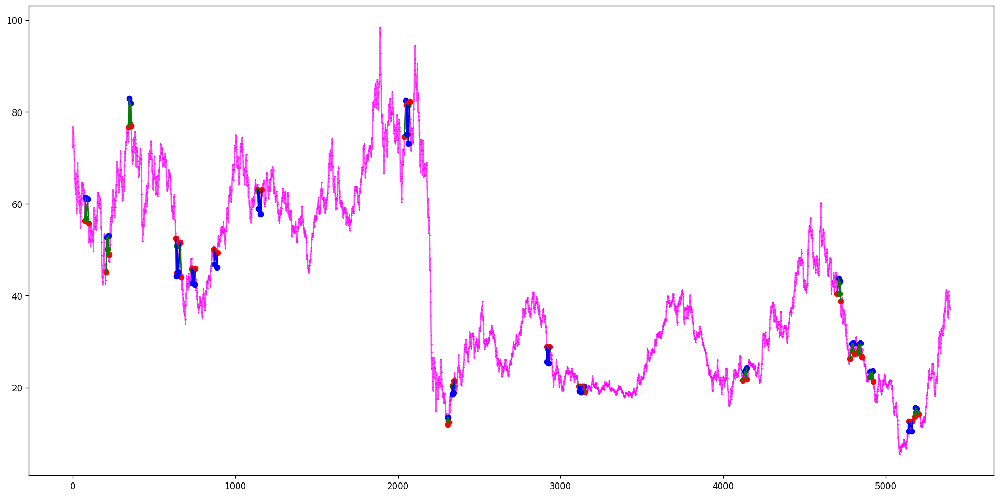

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(120, 121, 123, 131, 134), (288, 289, 292, 296, 305), (292, 296, 300, 303, 305), (905, 911, 916, 918, 921), (1050, 1053, 1057, 1059, 1067), (1113, 1116, 1120, 1125, 1128), (1338, 1340, 1345, 1350, 1355), (1392, 1394, 1398, 1399, 1407), (1423, 1433, 1439, 1445, 1447), (2009, 2013, 2014, 2020, 2022), (2002, 2004, 2008, 2013, 2024), (2101, 2103, 2113, 2114, 2116), (2214, 2218, 2221, 2223, 2228), (2214, 2218, 2221, 2225, 2228), (2302, 2304, 2318, 2325, 2329), (2558, 2567, 2568, 2574, 2579), (2558, 2567, 2568, 2575, 2579), (2558, 2574, 2580, 2583, 2584), (2558, 2575, 2580, 2583, 2584), (2698, 2701, 2704, 2711, 2718), (2948, 2949, 2952, 2957, 2959)]
[(304, 305, 306, 312, 314), (304, 305, 306, 313, 314), (726, 727, 731, 737, 748), (726, 727, 731, 738, 748), (927, 929, 932, 934, 937), (1060, 1067, 1071, 1072, 1073), (1341, 1345, 1350, 1355, 1365), (1341, 1345, 1350, 1356, 1365), (1354, 1355, 1360, 1361, 1365), (1354, 1356, 1360, 1361, 1365), (1407, 1409, 1418, 1423, 1433), (1905, 1908, 1910, 

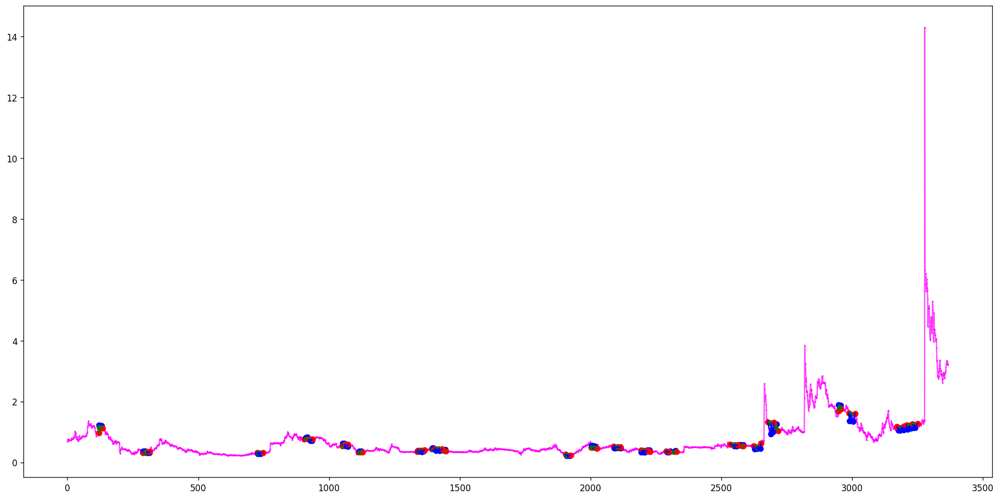

[]
[]
Ticker AACQ found 0 double top patterns, 0 double bottom patterns


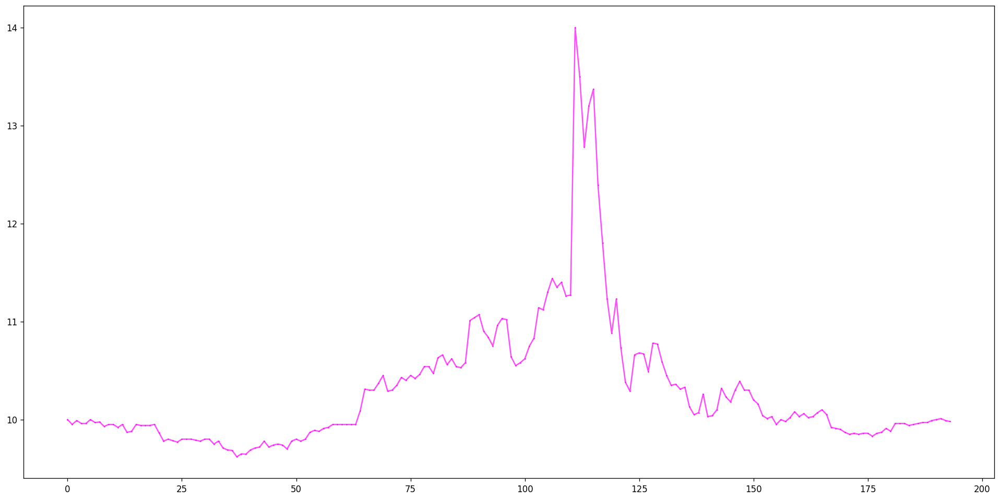

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1149, 1153, 1154, 1161, 1170), (1190, 1193, 1196, 1201, 1206)]
[(1827, 1830, 1835, 1839, 1845)]
Ticker AADAX found 2 double top patterns, 1 double bottom patterns


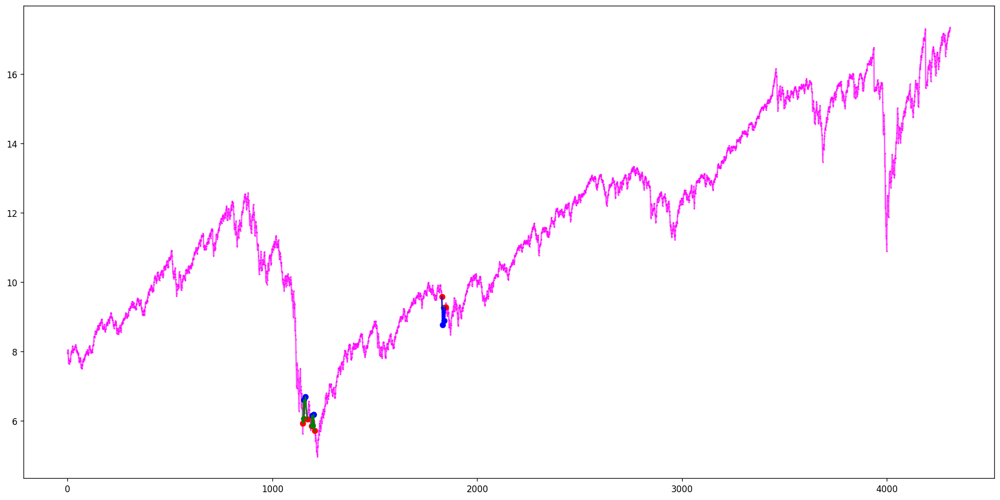

[(2206, 2208, 2209, 2212, 2214), (2274, 2280, 2283, 2288, 2289), (2927, 2934, 2940, 2945, 2949), (2969, 2974, 2977, 2982, 2989), (4736, 4743, 4752, 4760, 4762)]
[(2916, 2919, 2922, 2927, 2932), (5141, 5142, 5145, 5153, 5165)]
Ticker AADEX found 5 double top patterns, 2 double bottom patterns


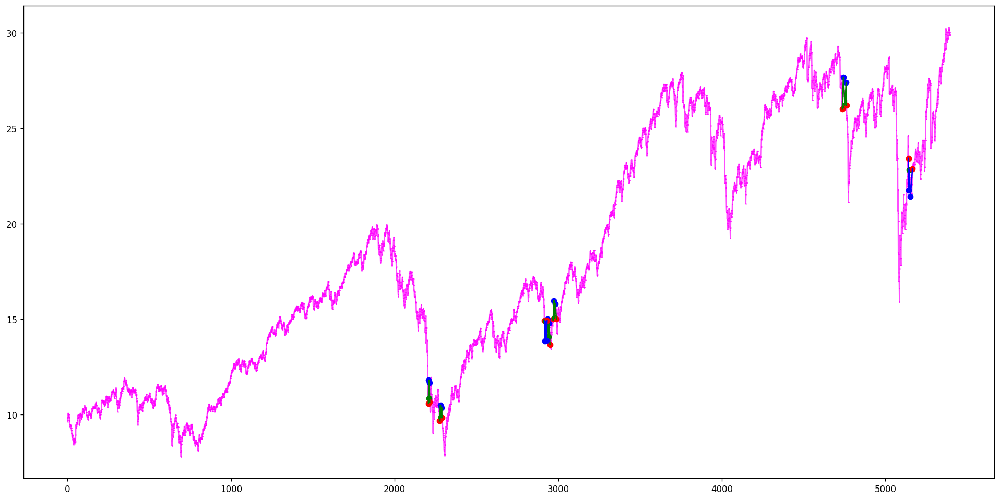

[]
[(262, 265, 272, 275, 280), (262, 265, 272, 276, 280), (1377, 1384, 1392, 1400, 1403), (2548, 2551, 2556, 2562, 2573)]
Ticker AADR found 0 double top patterns, 4 double bottom patterns


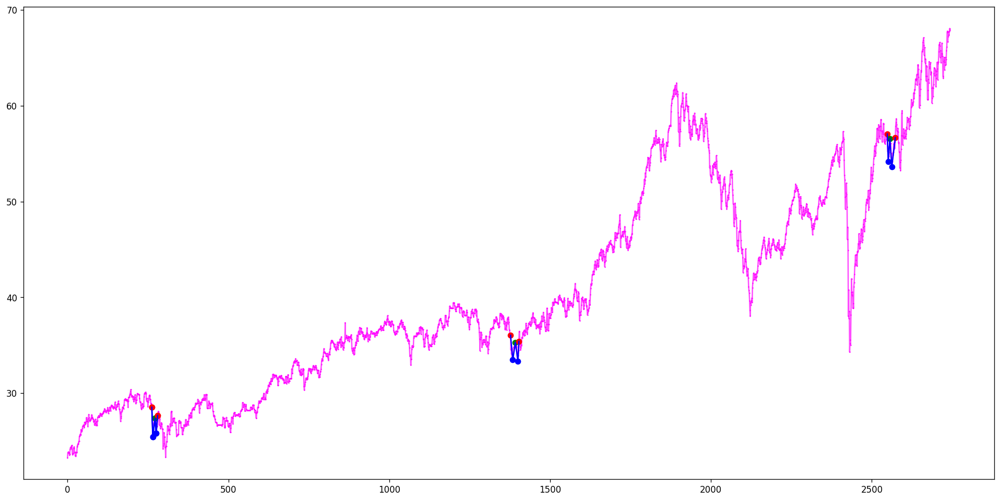

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(107, 110, 118, 124, 127), (169, 170, 171, 177, 178), (169, 170, 179, 188, 195), (206, 207, 208, 215, 218), (209, 210, 213, 215, 218), (261, 263, 267, 270, 275), (323, 326, 331, 334, 339), (375, 376, 380, 391, 400), (513, 520, 524, 529, 534), (654, 659, 665, 667, 675), (654, 659, 665, 671, 675), (1033, 1047, 1053, 1057, 1060), (1480, 1488, 1492, 1496, 1500), (2003, 2005, 2012, 2016, 2019), (2012, 2016, 2019, 2031, 2040), (2189, 2190, 2197, 2198, 2200), (2503, 2508, 2513, 2526, 2528), (2886, 2888, 2902, 2905, 2909), (2956, 2959, 2960, 2965, 2976), (4092, 4100, 4110, 4114, 4119), (4092, 4103, 4110, 4114, 4119), (4899, 4902, 4908, 4918, 4927), (4899, 4902, 4908, 4923, 4927)]
[(142, 144, 145, 151, 155), (224, 229, 234, 236, 238), (283, 284, 289, 291, 295), (283, 284, 289, 292, 295), (377, 380, 381, 386, 391), (455, 458, 459, 464, 468), (491, 493, 494, 499, 501), (714, 717, 720, 723, 739), (1209, 1213, 1216, 1220, 1229), (1710, 1711, 1713, 1718, 1719), (1837, 1841, 1848, 1850, 1855), (1837

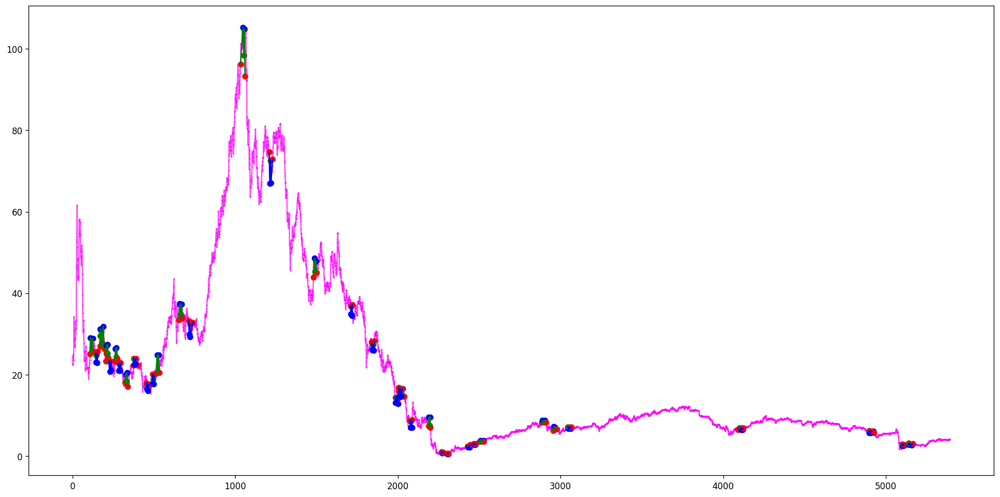

[(37, 46, 50, 51, 54), (37, 46, 50, 53, 54), (75, 78, 81, 92, 95), (155, 158, 162, 173, 175), (401, 405, 408, 412, 413), (1168, 1172, 1177, 1185, 1192), (1359, 1366, 1371, 1378, 1379), (1359, 1367, 1371, 1378, 1379), (1440, 1452, 1456, 1461, 1468), (1760, 1764, 1767, 1771, 1778), (1850, 1859, 1863, 1869, 1878), (2436, 2437, 2441, 2444, 2446), (2456, 2464, 2469, 2472, 2473), (2594, 2599, 2603, 2605, 2608)]
[(46, 50, 51, 56, 60), (350, 352, 354, 358, 363), (350, 352, 354, 360, 363), (350, 353, 354, 358, 363), (350, 353, 354, 360, 363), (1166, 1168, 1172, 1177, 1179), (1902, 1910, 1914, 1919, 1922), (1995, 1996, 2007, 2014, 2018), (1995, 1998, 2007, 2014, 2018), (2106, 2117, 2123, 2126, 2128), (2409, 2411, 2413, 2417, 2419)]
Ticker AAIGF found 14 double top patterns, 11 double bottom patterns


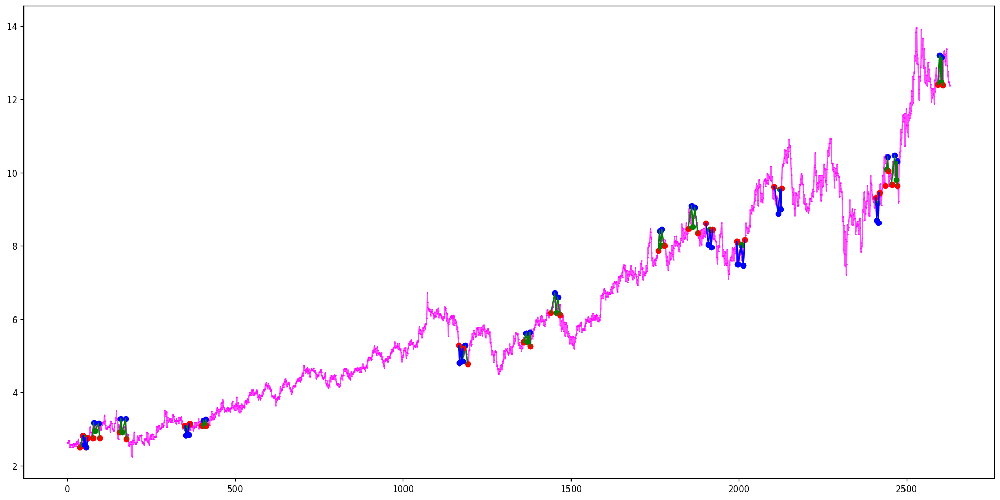

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(38, 39, 43, 54, 57), (86, 91, 95, 96, 101), (150, 151, 154, 158, 160), (150, 151, 154, 159, 160), (222, 223, 226, 228, 233), (222, 223, 226, 232, 233), (222, 225, 226, 232, 233), (270, 274, 277, 280, 287), (270, 274, 277, 284, 287), (307, 308, 311, 312, 319), (307, 308, 311, 317, 319), (307, 308, 311, 318, 319), (372, 375, 380, 386, 395), (965, 968, 971, 985, 986), (965, 969, 971, 985, 986), (1082, 1083, 1084, 1090, 1091), (1346, 1347, 1349, 1353, 1360), (1346, 1347, 1349, 1356, 1360), (1694, 1695, 1697, 1707, 1716), (1694, 1695, 1697, 1712, 1716), (1694, 1696, 1697, 1707, 1716), (1694, 1696, 1697, 1712, 1716), (1755, 1756, 1767, 1770, 1774), (1861, 1864, 1875, 1883, 1885), (1861, 1866, 1875, 1883, 1885), (2134, 2135, 2136, 2143, 2144), (2173, 2177, 2178, 2181, 2186), (2255, 2257, 2260, 2262, 2269), (2255, 2257, 2260, 2263, 2269), (2269, 2276, 2285, 2287, 2294), (2295, 2298, 2305, 2306, 2314), (2295, 2298, 2305, 2307, 2314), (2295, 2301, 2305, 2306, 2314), (2295, 2301, 2305, 2307, 23

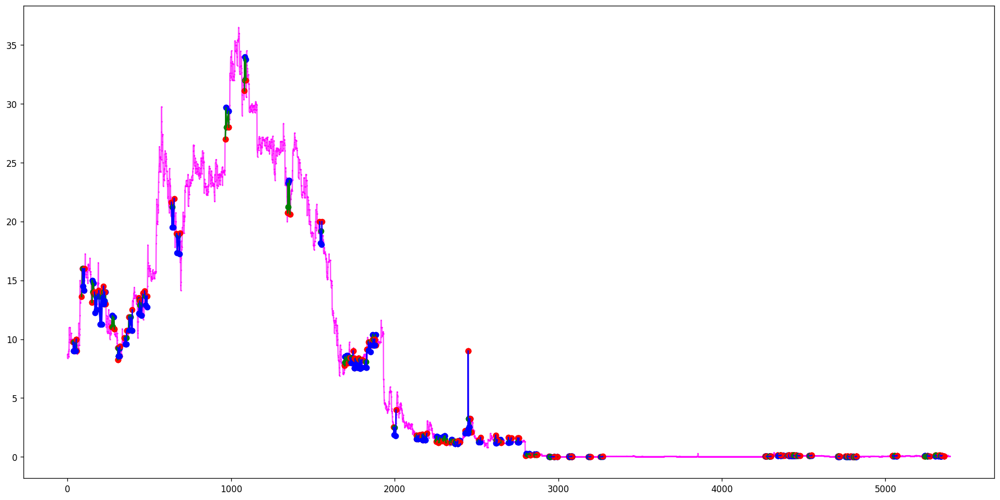

[(268, 271, 272, 275, 277), (286, 292, 298, 304, 309), (444, 446, 447, 454, 460), (720, 723, 730, 737, 743), (895, 899, 903, 907, 909), (1369, 1370, 1377, 1379, 1390), (1829, 1832, 1837, 1842, 1847), (2182, 2187, 2191, 2197, 2207), (2182, 2187, 2191, 2201, 2207), (2312, 2314, 2316, 2320, 2321), (3400, 3407, 3417, 3422, 3428), (3655, 3658, 3669, 3671, 3674), (3754, 3762, 3765, 3768, 3771), (3774, 3785, 3787, 3794, 3796)]
[(727, 730, 737, 743, 747), (873, 875, 879, 881, 884), (972, 974, 976, 980, 982), (1144, 1152, 1156, 1160, 1168), (1244, 1248, 1254, 1256, 1269), (1612, 1614, 1619, 1621, 1631), (1682, 1683, 1687, 1688, 1691), (1888, 1890, 1900, 1903, 1907), (2314, 2316, 2320, 2321, 2325), (2882, 2890, 2894, 2899, 2904), (3280, 3284, 3287, 3292, 3296), (3649, 3654, 3658, 3669, 3671), (3673, 3676, 3678, 3683, 3689)]
Ticker AAL found 14 double top patterns, 13 double bottom patterns


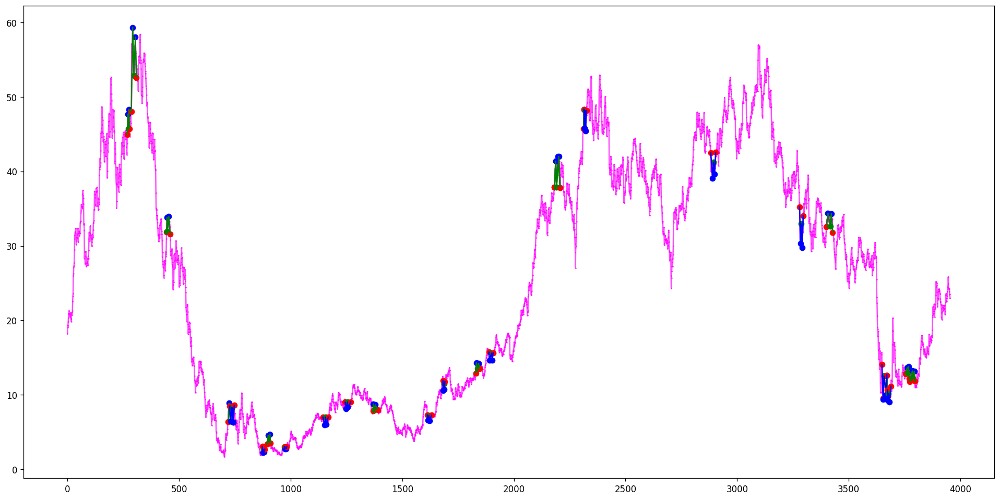

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(215, 218, 219, 227, 231), (1685, 1687, 1689, 1692, 1695), (1685, 1687, 1689, 1693, 1695), (1698, 1699, 1700, 1703, 1709), (1994, 1996, 1997, 2008, 2018), (2086, 2088, 2091, 2097, 2100), (2086, 2088, 2091, 2098, 2100)]
[(218, 219, 227, 231, 236), (735, 740, 745, 755, 762), (989, 992, 996, 999, 1002), (1533, 1535, 1536, 1539, 1544), (1843, 1845, 1847, 1850, 1852), (1959, 1961, 1963, 1973, 1975)]
Ticker AAMC found 7 double top patterns, 6 double bottom patterns


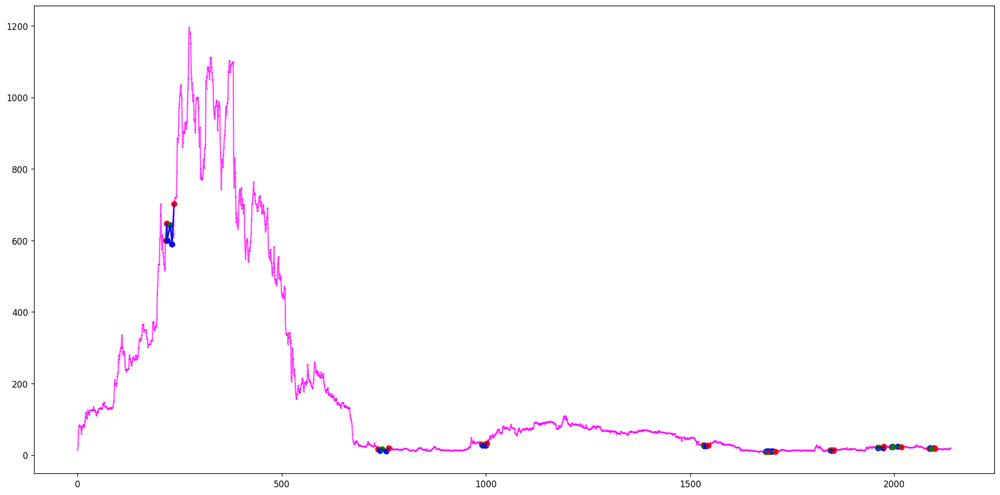

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(15, 16, 19, 20, 23), (19, 20, 23, 30, 36), (23, 24, 25, 30, 36), (107, 112, 116, 118, 120), (107, 112, 116, 119, 120), (107, 113, 116, 118, 120), (107, 113, 116, 119, 120), (179, 182, 184, 189, 191), (230, 233, 240, 243, 244), (230, 233, 240, 247, 248), (230, 239, 240, 247, 248), (260, 263, 270, 272, 286), (260, 263, 270, 273, 286), (260, 263, 270, 285, 286), (260, 266, 270, 272, 286), (260, 266, 270, 273, 286), (260, 266, 270, 285, 286), (270, 272, 283, 285, 286), (270, 273, 283, 285, 286), (286, 287, 289, 293, 294), (286, 287, 289, 296, 301), (286, 287, 289, 297, 301), (290, 292, 294, 297, 301), (304, 313, 319, 324, 330), (304, 314, 319, 324, 330), (409, 413, 416, 418, 426), (503, 504, 506, 510, 524), (556, 557, 558, 564, 566), (556, 557, 558, 565, 566), (549, 557, 566, 567, 569), (646, 647, 648, 655, 656), (706, 707, 712, 716, 717), (731, 732, 733, 738, 739), (792, 795, 800, 802, 803), (792, 796, 800, 802, 803), (855, 860, 864, 869, 871), (873, 876, 881, 882, 889), (911, 912, 916,

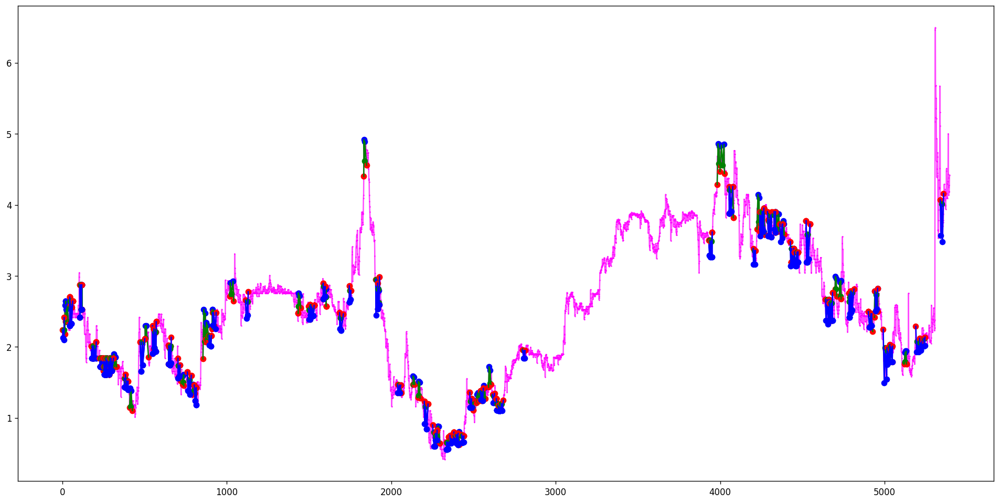

[]
[]
Ticker AAN found 0 double top patterns, 0 double bottom patterns


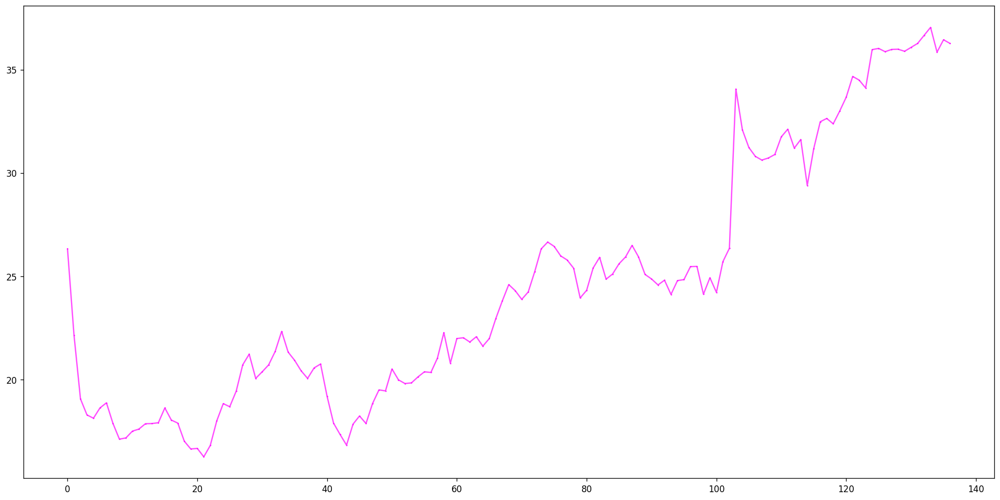

[(181, 184, 194, 198, 202), (416, 417, 427, 438, 441), (427, 431, 437, 438, 441), (467, 473, 480, 490, 494), (1292, 1295, 1298, 1306, 1309), (1497, 1499, 1505, 1509, 1513)]
[(374, 377, 378, 388, 390), (1281, 1284, 1286, 1289, 1290)]
Ticker AAOI found 6 double top patterns, 2 double bottom patterns


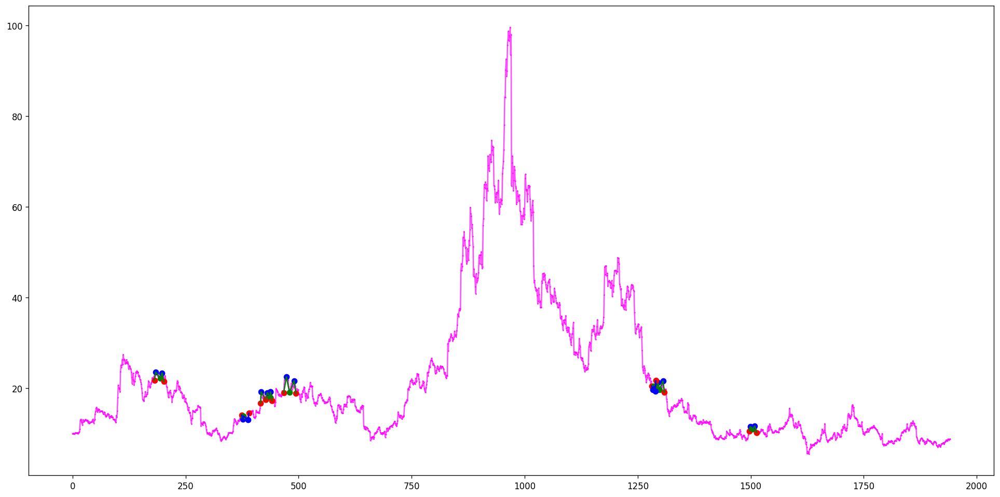

[(1455, 1459, 1465, 1472, 1481), (1632, 1639, 1644, 1646, 1652), (3970, 3974, 3980, 3985, 3992)]
[(150, 161, 167, 170, 178), (185, 191, 200, 205, 207), (440, 446, 456, 460, 463), (1449, 1455, 1459, 1465, 1472)]
Ticker AAP found 3 double top patterns, 4 double bottom patterns


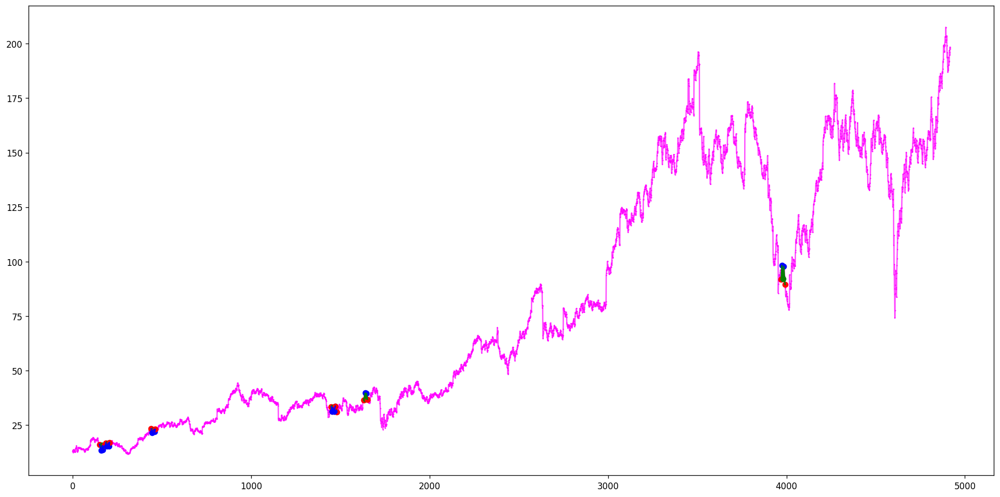

[(1136, 1137, 1143, 1147, 1153), (1236, 1237, 1238, 1245, 1247), (1304, 1309, 1317, 1322, 1326), (2205, 2207, 2213, 2220, 2229), (3677, 3688, 3693, 3703, 3705)]
[(118, 120, 123, 124, 129), (234, 235, 239, 244, 253), (234, 236, 239, 244, 253), (283, 285, 289, 291, 294), (352, 354, 360, 365, 369), (714, 717, 720, 723, 725), (742, 749, 753, 767, 770), (1234, 1236, 1245, 1247, 1260), (2032, 2035, 2037, 2047, 2049), (2198, 2205, 2207, 2213, 2220), (2370, 2381, 2387, 2390, 2396), (2597, 2601, 2604, 2610, 2618), (2636, 2640, 2644, 2650, 2654), (2914, 2917, 2922, 2926, 2931), (3771, 3774, 3778, 3783, 3786)]
Ticker AAPL found 5 double top patterns, 15 double bottom patterns


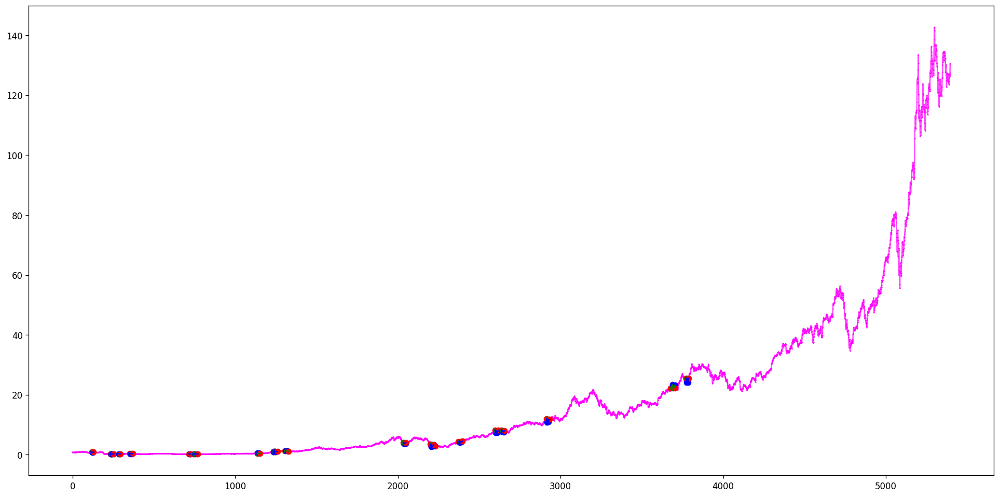

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(6, 8, 9, 14, 18), (6, 8, 9, 17, 18), (6, 8, 9, 20, 25), (141, 143, 144, 151, 154), (141, 143, 144, 156, 162), (141, 143, 144, 161, 162), (145, 146, 154, 156, 162), (145, 146, 154, 161, 162), (145, 151, 154, 156, 162), (145, 151, 154, 161, 162), (243, 244, 245, 249, 262), (243, 244, 245, 255, 262), (248, 249, 256, 260, 262), (248, 249, 256, 261, 262), (248, 255, 256, 261, 262), (321, 322, 328, 334, 338), (321, 322, 328, 337, 338), (321, 327, 328, 337, 338), (390, 391, 393, 396, 403), (390, 391, 393, 402, 403), (390, 392, 393, 402, 403), (413, 416, 418, 421, 425), (428, 432, 436, 443, 445), (428, 432, 436, 444, 445), (428, 435, 436, 444, 445), (428, 432, 436, 451, 452), (428, 435, 436, 451, 452), (442, 443, 445, 451, 452), (530, 531, 533, 542, 543), (530, 531, 543, 544, 546), (530, 531, 543, 545, 546), (530, 531, 543, 548, 549), (543, 544, 546, 548, 549), (689, 697, 704, 705, 712), (689, 697, 704, 706, 712), (760, 761, 767, 780, 786), (760, 761, 767, 785, 786), (760, 766, 767, 785, 786

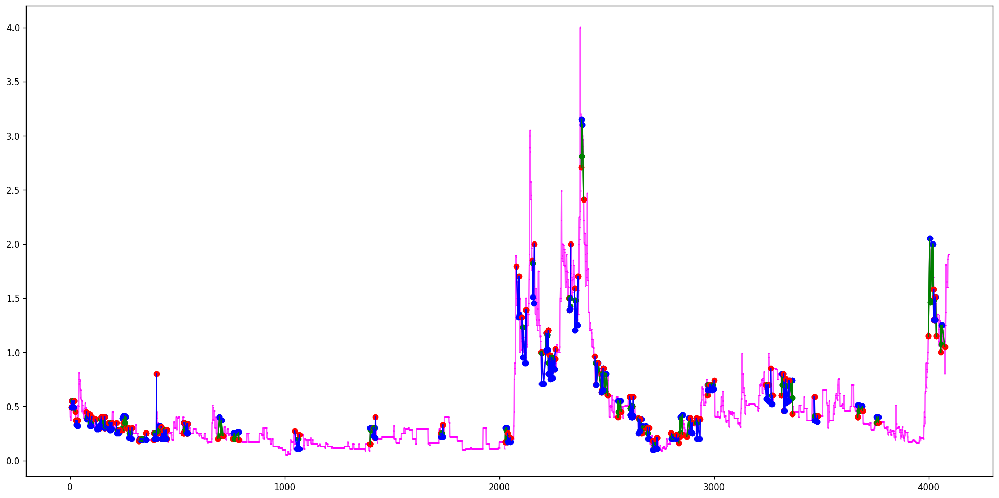

[(2322, 2324, 2331, 2337, 2346)]
[(141, 144, 149, 151, 159), (269, 273, 277, 284, 294), (1158, 1160, 1162, 1168, 1176), (2305, 2308, 2317, 2320, 2323)]
Ticker AAT found 1 double top patterns, 4 double bottom patterns


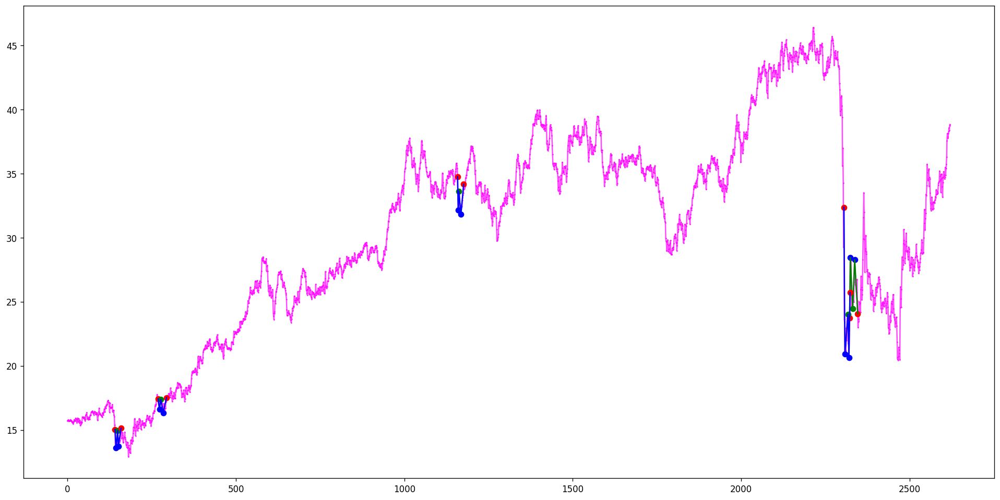

[(727, 735, 740, 742, 747), (727, 735, 740, 743, 747), (1015, 1016, 1017, 1020, 1022), (1612, 1615, 1620, 1630, 1633), (1757, 1759, 1763, 1768, 1769)]
[(342, 354, 356, 361, 366)]
Ticker AATRL found 5 double top patterns, 1 double bottom patterns


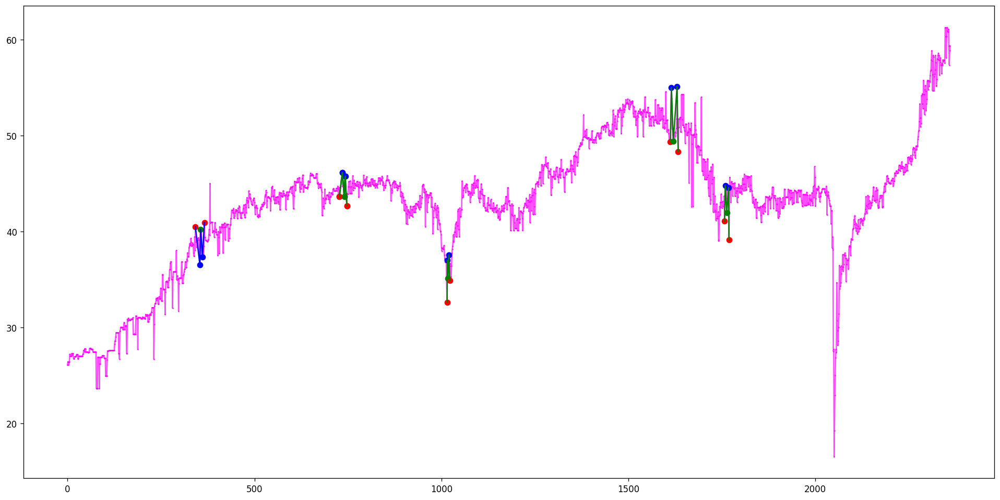

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1141, 1147, 1152, 1158, 1164), (1510, 1512, 1517, 1519, 1522), (1577, 1583, 1584, 1596, 1602), (2059, 2061, 2066, 2070, 2072), (2141, 2143, 2147, 2148, 2151), (2871, 2874, 2882, 2885, 2894), (2980, 2984, 2985, 2990, 2991), (3113, 3118, 3127, 3132, 3135), (3753, 3756, 3761, 3768, 3773), (3925, 3927, 3928, 3931, 3934), (3925, 3927, 3934, 3935, 3936), (3984, 3990, 3993, 3998, 4002), (4064, 4067, 4069, 4073, 4077), (4091, 4093, 4098, 4100, 4101), (4091, 4094, 4098, 4100, 4101)]
[(1419, 1424, 1428, 1432, 1435), (1601, 1603, 1606, 1611, 1618), (2018, 2022, 2026, 2030, 2032), (2050, 2059, 2061, 2074, 2078), (3070, 3074, 3076, 3081, 3087), (3500, 3503, 3506, 3511, 3517), (3500, 3503, 3506, 3513, 3517), (3500, 3503, 3506, 3515, 3517), (3927, 3928, 3931, 3934, 3935), (3978, 3982, 3990, 3993, 3998)]
Ticker AAVVF found 15 double top patterns, 10 double bottom patterns


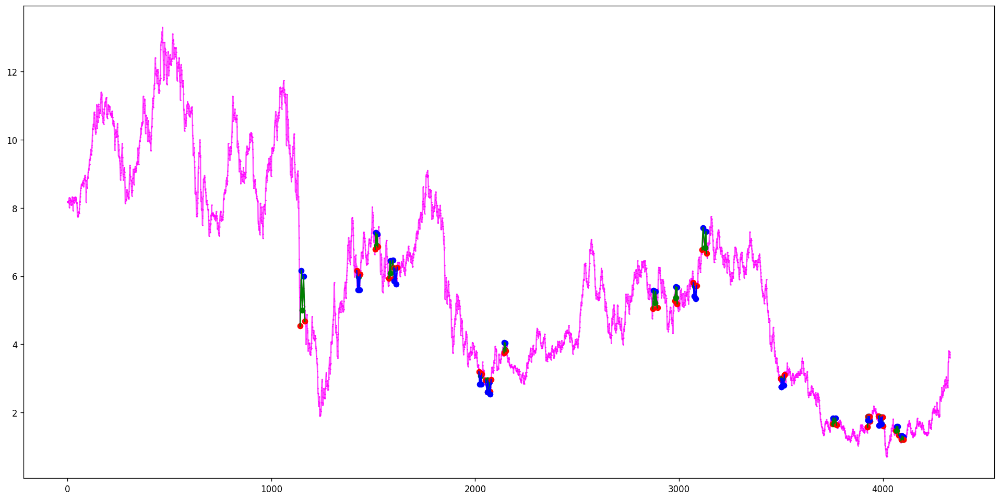

[(256, 274, 275, 283, 284)]
[(93, 94, 100, 107, 119), (192, 195, 199, 201, 208), (192, 195, 199, 203, 208), (308, 309, 316, 317, 332), (308, 309, 316, 320, 332), (460, 471, 474, 479, 487), (870, 871, 872, 880, 881)]
Ticker AAVXF found 1 double top patterns, 7 double bottom patterns


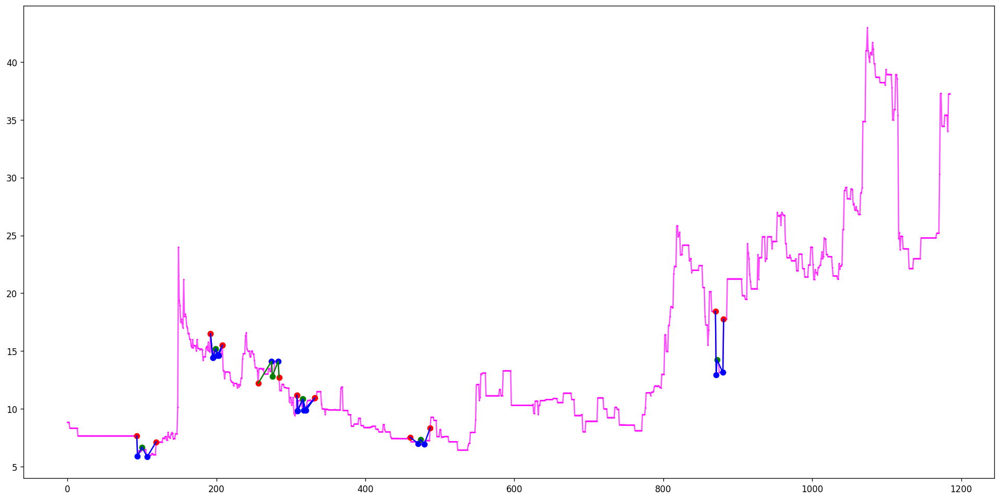

[(2621, 2626, 2630, 2632, 2636), (2796, 2798, 2808, 2811, 2818), (3817, 3820, 3823, 3827, 3830), (3841, 3844, 3849, 3858, 3867)]
[(903, 909, 912, 920, 930), (946, 950, 956, 959, 963), (1133, 1138, 1146, 1149, 1155), (1242, 1243, 1249, 1251, 1252), (1260, 1263, 1266, 1272, 1277), (1297, 1306, 1311, 1313, 1315), (1444, 1447, 1450, 1453, 1457), (1650, 1652, 1656, 1670, 1673), (2301, 2303, 2305, 2320, 2324), (2357, 2365, 2369, 2379, 2382), (2613, 2618, 2632, 2637, 2638), (2643, 2647, 2652, 2658, 2659), (2798, 2808, 2811, 2818, 2820), (3110, 3112, 3120, 3122, 3126), (3523, 3531, 3536, 3541, 3545), (3666, 3670, 3678, 3681, 3683), (3812, 3816, 3827, 3830, 3837)]
Ticker AAWW found 4 double top patterns, 17 double bottom patterns


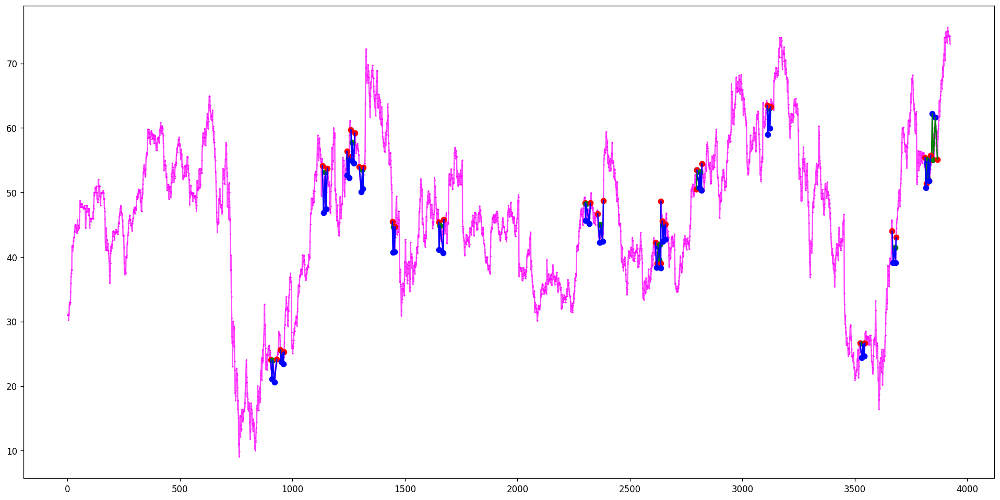

[]
[(207, 214, 220, 224, 229)]
Ticker AAXJ found 0 double top patterns, 1 double bottom patterns


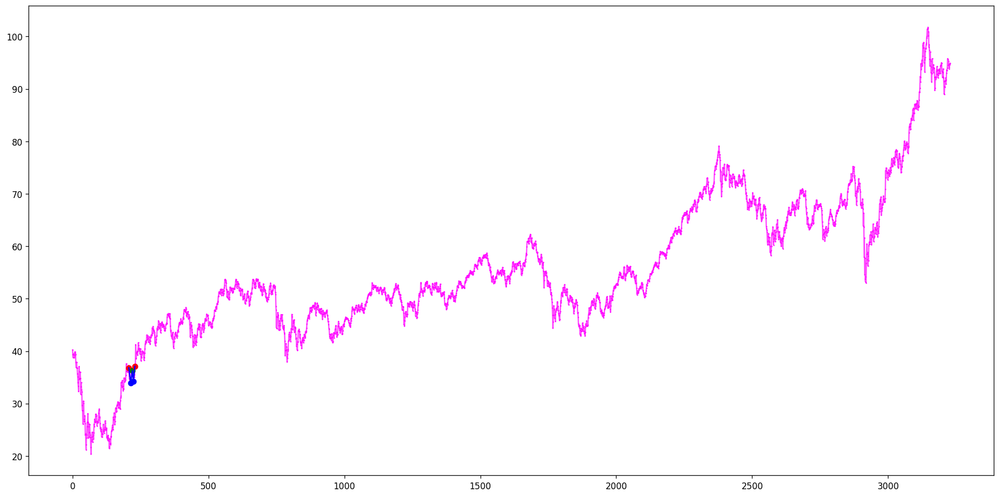

[(149, 158, 162, 164, 167), (342, 345, 348, 351, 354), (407, 413, 418, 423, 431), (598, 599, 607, 611, 619), (990, 991, 999, 1005, 1017), (1728, 1730, 1738, 1741, 1743), (2005, 2008, 2010, 2017, 2024), (4418, 4425, 4428, 4439, 4444)]
[(292, 295, 296, 301, 304), (328, 330, 334, 340, 342), (328, 330, 334, 341, 342), (525, 528, 532, 534, 544), (551, 560, 564, 569, 578), (592, 593, 595, 598, 599), (1196, 1204, 1206, 1220, 1221), (1976, 1979, 1983, 1984, 1990), (2017, 2018, 2020, 2024, 2028), (2056, 2062, 2069, 2073, 2078), (2289, 2292, 2297, 2303, 2306), (2629, 2631, 2636, 2638, 2643), (2629, 2632, 2636, 2638, 2643)]
Ticker ABB found 8 double top patterns, 13 double bottom patterns


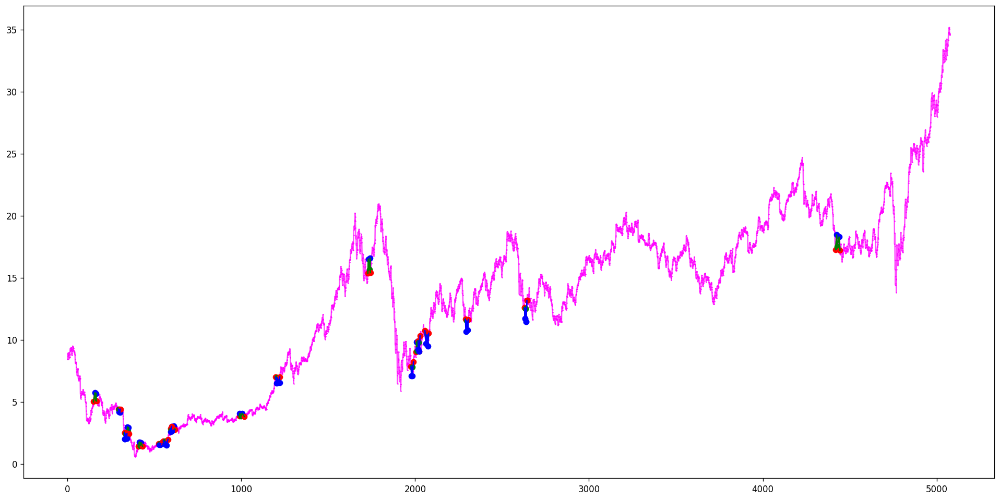

[(292, 305, 311, 315, 317), (1289, 1296, 1299, 1307, 1310)]
[(115, 117, 121, 123, 128)]
Ticker ABBV found 2 double top patterns, 1 double bottom patterns


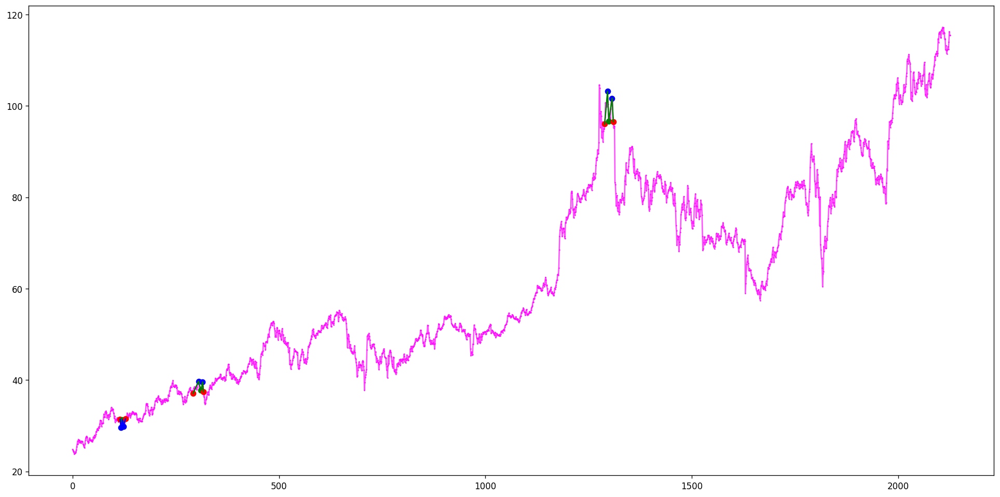

[(147, 150, 157, 160, 163), (354, 357, 363, 370, 376), (431, 435, 445, 451, 455), (1726, 1729, 1735, 1747, 1754), (2013, 2017, 2026, 2028, 2037), (4443, 4450, 4456, 4468, 4470), (4706, 4716, 4724, 4728, 4733)]
[(205, 206, 209, 213, 216), (371, 384, 388, 392, 395), (628, 631, 635, 638, 642), (4730, 4733, 4739, 4742, 4747)]
Ticker ABC found 7 double top patterns, 4 double bottom patterns


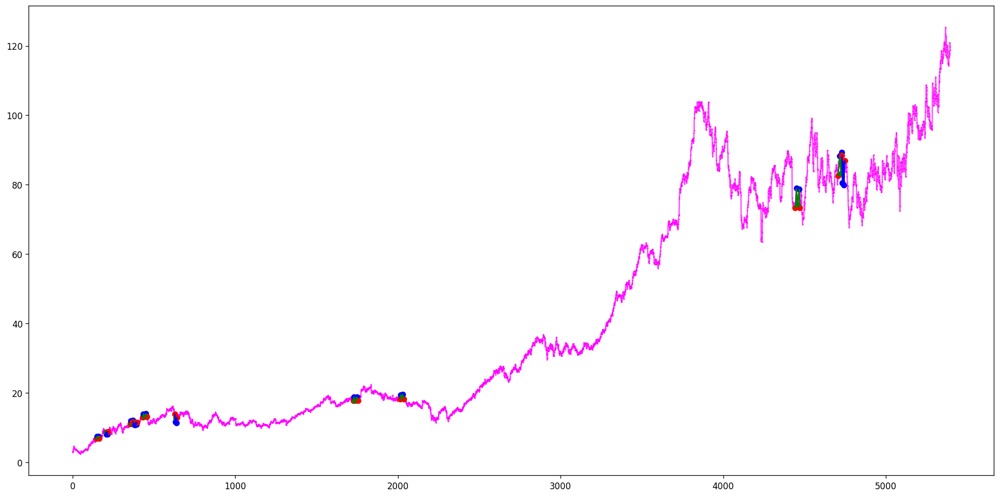

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(209, 210, 223, 228, 230), (209, 210, 223, 229, 230), (209, 214, 223, 228, 230), (209, 214, 223, 229, 230), (1292, 1299, 1301, 1305, 1311), (1337, 1342, 1347, 1350, 1359), (1385, 1387, 1391, 1400, 1405), (1810, 1813, 1818, 1830, 1837), (1869, 1874, 1878, 1881, 1895), (2029, 2030, 2033, 2039, 2045), (2153, 2155, 2158, 2160, 2161), (2162, 2166, 2173, 2188, 2189), (2189, 2191, 2197, 2198, 2203), (2247, 2255, 2260, 2262, 2271), (2341, 2343, 2349, 2350, 2353), (2355, 2356, 2360, 2361, 2362), (2395, 2397, 2399, 2410, 2419), (2757, 2764, 2766, 2770, 2778), (2786, 2789, 2792, 2804, 2810), (2972, 2974, 2977, 2982, 2991)]
[(721, 723, 724, 732, 745), (721, 723, 724, 736, 745), (721, 723, 724, 740, 745), (971, 974, 978, 989, 990), (1141, 1144, 1145, 1154, 1166), (1612, 1619, 1621, 1627, 1631), (1863, 1869, 1874, 1878, 1880), (1970, 1973, 1977, 1982, 1987), (2132, 2138, 2139, 2144, 2149), (2246, 2247, 2255, 2260, 2262), (2338, 2341, 2343, 2355, 2366), (2346, 2349, 2350, 2355, 2366), (2350, 2355, 2

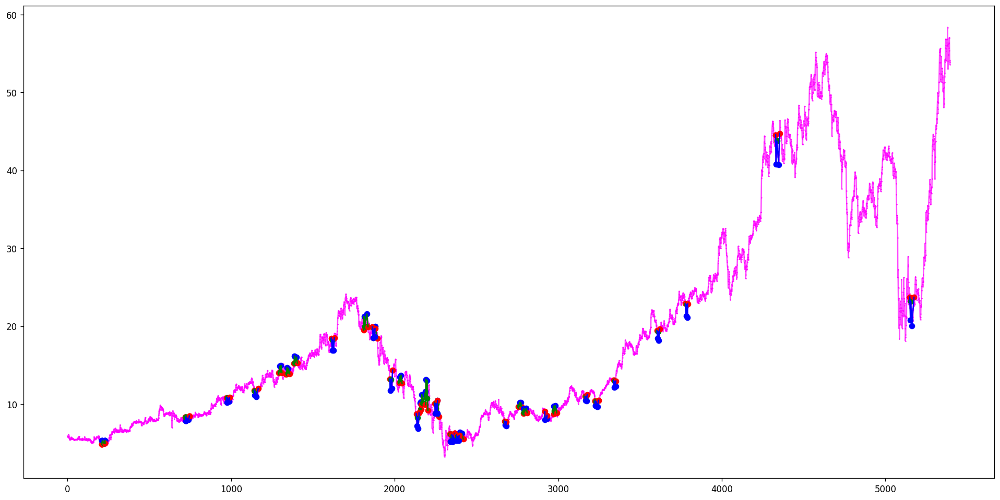

[]
[(74, 76, 78, 87, 91), (79, 81, 85, 87, 91)]
Ticker ABCL found 0 double top patterns, 2 double bottom patterns


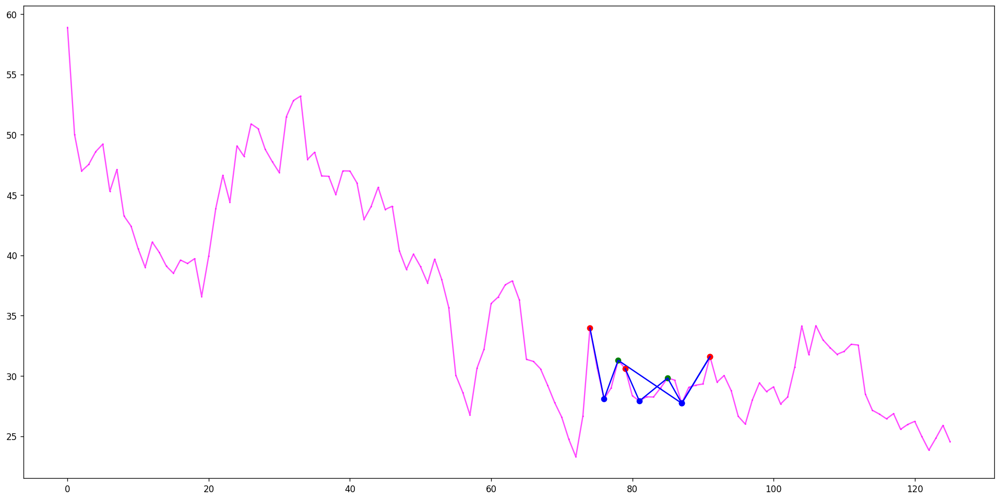

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(56, 58, 60, 67, 71), (183, 186, 191, 192, 197), (626, 629, 635, 637, 641), (828, 831, 836, 843, 845), (1226, 1229, 1238, 1242, 1246), (1549, 1550, 1553, 1557, 1567), (1580, 1586, 1589, 1596, 1599), (1616, 1618, 1622, 1623, 1624), (1669, 1670, 1671, 1680, 1684), (2002, 2006, 2016, 2018, 2022), (3255, 3256, 3258, 3263, 3264), (3365, 3369, 3370, 3374, 3388), (3365, 3369, 3370, 3376, 3388), (3458, 3460, 3463, 3464, 3470), (3458, 3460, 3463, 3466, 3470), (3458, 3460, 3463, 3468, 3470), (3555, 3556, 3561, 3564, 3565), (3555, 3558, 3561, 3564, 3565), (3555, 3560, 3561, 3564, 3565), (3597, 3598, 3608, 3612, 3614), (3677, 3678, 3680, 3683, 3684), (3677, 3679, 3680, 3683, 3684), (3902, 3904, 3914, 3920, 3928), (4567, 4575, 4580, 4582, 4587), (4633, 4634, 4648, 4651, 4658), (4752, 4755, 4756, 4760, 4761), (5097, 5101, 5104, 5112, 5114), (5119, 5122, 5125, 5133, 5136)]
[(306, 310, 313, 318, 322), (412, 414, 415, 419, 424), (805, 808, 812, 813, 815), (909, 911, 912, 919, 926), (1533, 1534, 1535, 

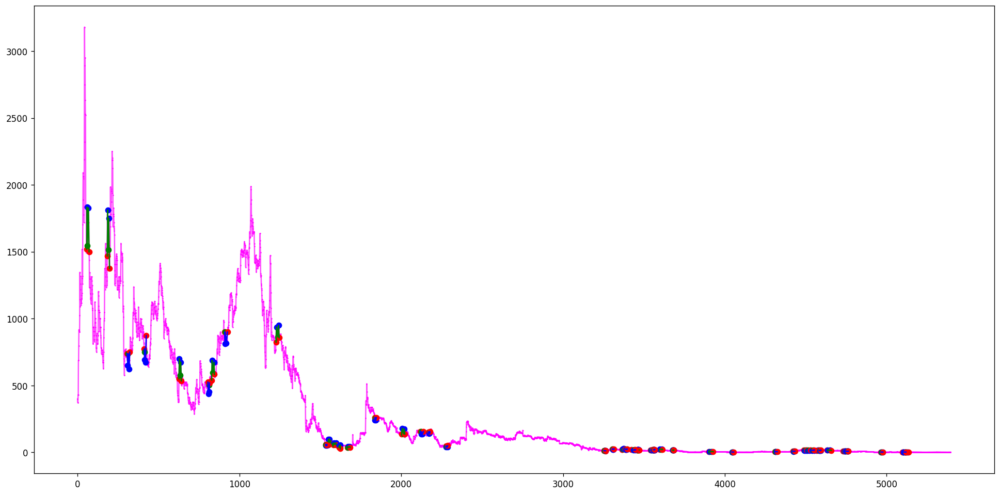

[(2092, 2095, 2099, 2104, 2110), (2247, 2252, 2260, 2265, 2274), (2707, 2719, 2723, 2729, 2735), (3509, 3518, 3523, 3527, 3536), (3509, 3519, 3523, 3527, 3536), (3725, 3731, 3741, 3746, 3752), (4042, 4047, 4054, 4058, 4062), (4173, 4181, 4189, 4195, 4200), (4947, 4954, 4969, 4970, 4974), (5109, 5112, 5118, 5119, 5122), (5222, 5227, 5231, 5237, 5239)]
[(1516, 1518, 1524, 1530, 1538), (2137, 2140, 2143, 2153, 2159), (2233, 2235, 2237, 2244, 2252), (2719, 2723, 2729, 2735, 2738), (2947, 2949, 2952, 2956, 2958), (3816, 3821, 3827, 3831, 3835), (4047, 4054, 4058, 4063, 4066), (4818, 4822, 4830, 4837, 4846), (5106, 5109, 5112, 5122, 5130), (5141, 5145, 5150, 5153, 5156), (5187, 5198, 5201, 5206, 5208)]
Ticker ABEV found 11 double top patterns, 11 double bottom patterns


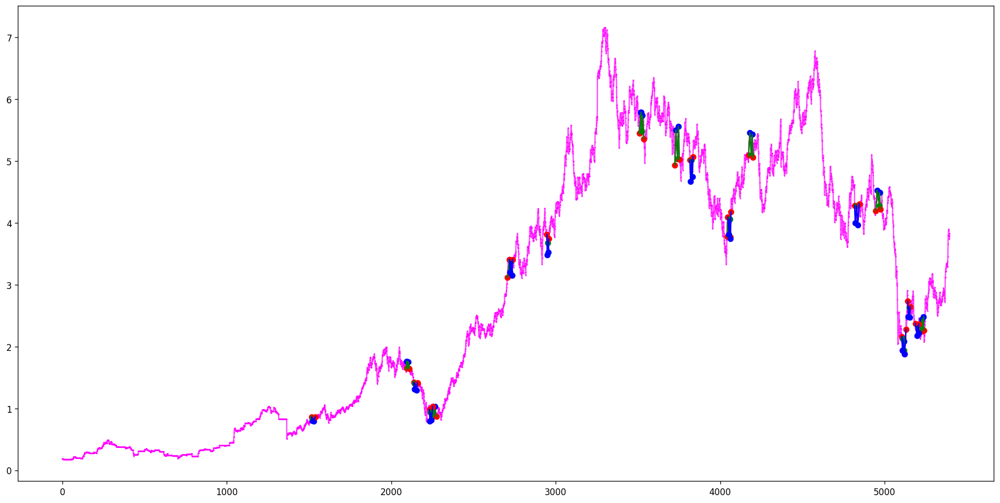

[(360, 369, 375, 378, 382), (453, 454, 455, 463, 467), (473, 480, 484, 487, 491), (505, 515, 519, 526, 531), (884, 886, 902, 907, 909), (1481, 1485, 1490, 1493, 1496), (1620, 1631, 1635, 1637, 1643), (1690, 1699, 1703, 1713, 1717), (1810, 1818, 1826, 1830, 1835), (1918, 1920, 1921, 1924, 1927), (1918, 1920, 1927, 1929, 1932), (3505, 3518, 3520, 3529, 3532), (3843, 3848, 3852, 3860, 3863), (4557, 4558, 4563, 4565, 4567)]
[(1083, 1089, 1094, 1099, 1110), (1513, 1515, 1521, 1526, 1534), (1718, 1720, 1726, 1731, 1733), (1863, 1865, 1872, 1876, 1882), (1917, 1918, 1920, 1932, 1935), (1973, 1979, 1981, 1987, 2001), (3162, 3163, 3168, 3170, 3172), (3479, 3481, 3485, 3491, 3500), (3627, 3631, 3648, 3651, 3654)]
Ticker ABG found 14 double top patterns, 9 double bottom patterns


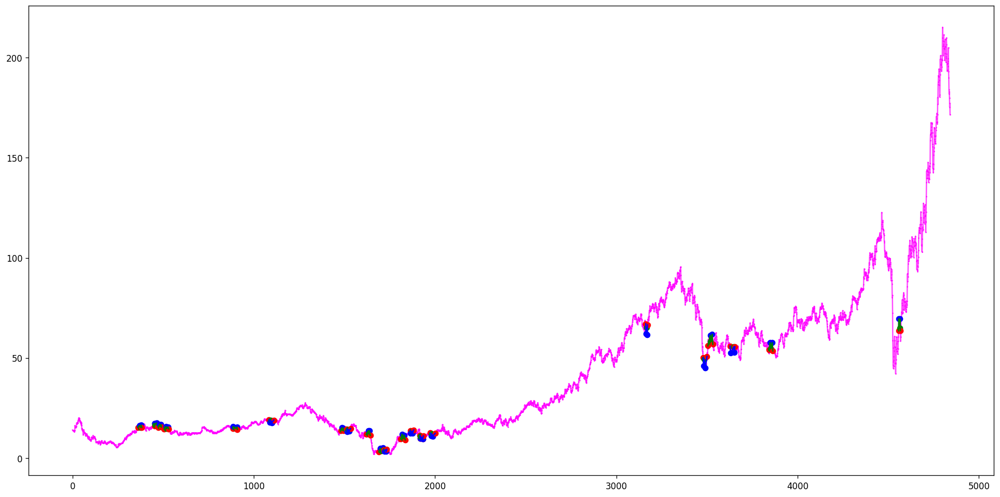

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(470, 471, 472, 478, 485), (967, 969, 973, 974, 977), (1043, 1046, 1051, 1052, 1054), (1061, 1068, 1074, 1083, 1085), (1565, 1571, 1576, 1582, 1586), (2164, 2166, 2170, 2179, 2183), (3455, 3461, 3462, 3469, 3478), (3527, 3529, 3532, 3535, 3537), (3833, 3834, 3838, 3841, 3854), (4242, 4244, 4245, 4260, 4264), (4687, 4688, 4689, 4695, 4700), (4687, 4688, 4689, 4697, 4700), (5328, 5330, 5335, 5337, 5338)]
[(148, 153, 155, 161, 163), (277, 282, 285, 288, 294), (671, 678, 680, 685, 687), (1141, 1144, 1148, 1153, 1158), (1785, 1789, 1792, 1796, 1798), (1798, 1800, 1805, 1809, 1816), (1844, 1850, 1861, 1869, 1872), (2021, 2024, 2028, 2042, 2044), (2028, 2030, 2032, 2042, 2044), (2118, 2121, 2124, 2141, 2143), (2151, 2161, 2166, 2170, 2179), (2418, 2419, 2426, 2430, 2440), (2839, 2842, 2850, 2856, 2858), (3138, 3140, 3143, 3144, 3146), (3346, 3349, 3363, 3364, 3366), (3525, 3527, 3529, 3532, 3534), (4137, 4140, 4144, 4146, 4150), (4232, 4235, 4236, 4240, 4242), (4435, 4437, 4440, 4443, 4449),

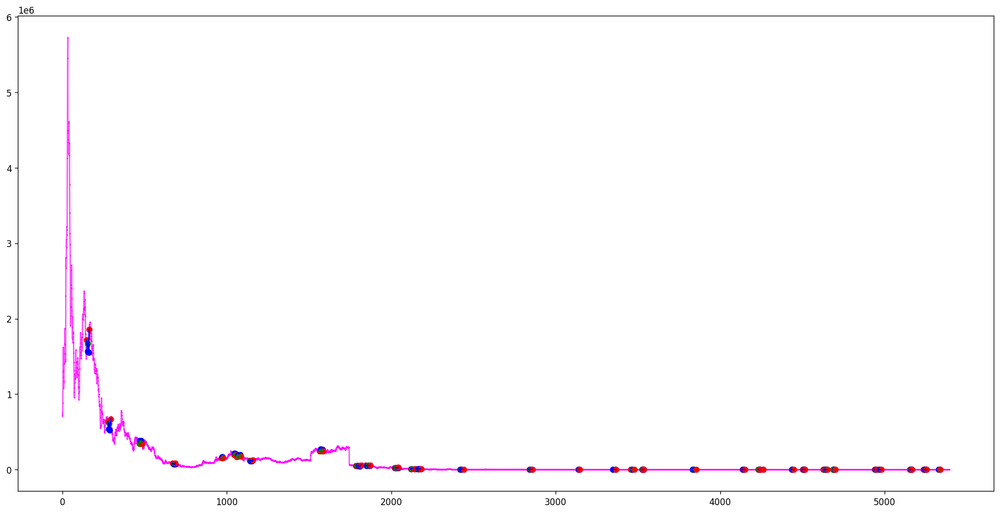

[(4989, 4993, 4996, 4997, 4999)]
[(1504, 1506, 1510, 1531, 1532), (1504, 1509, 1510, 1531, 1532), (1625, 1631, 1632, 1647, 1653), (1980, 1986, 1993, 1995, 2006), (4909, 4912, 4922, 4924, 4933)]
Ticker ABLZF found 1 double top patterns, 5 double bottom patterns


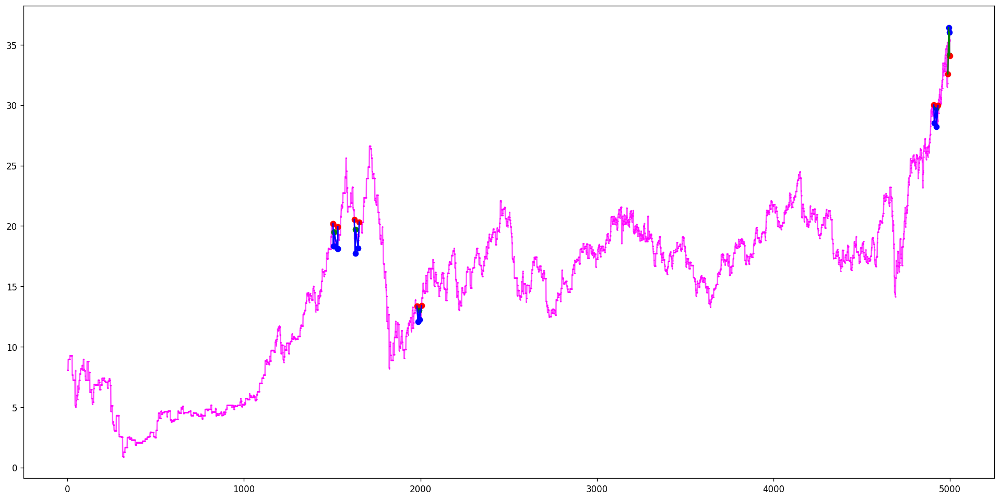

[(875, 885, 891, 896, 901), (1780, 1793, 1800, 1802, 1806), (1910, 1912, 1914, 1921, 1930), (1950, 1954, 1960, 1966, 1971), (1985, 1994, 1998, 2005, 2011), (2329, 2335, 2336, 2343, 2349), (2641, 2646, 2649, 2656, 2667), (5179, 5183, 5190, 5200, 5206), (5190, 5200, 5203, 5204, 5206), (5256, 5258, 5263, 5272, 5277)]
[(1929, 1936, 1947, 1949, 1951), (2076, 2079, 2082, 2086, 2090), (2132, 2138, 2141, 2143, 2145), (2609, 2613, 2618, 2622, 2627), (2636, 2641, 2646, 2649, 2655), (2938, 2949, 2952, 2956, 2961), (4549, 4554, 4565, 4569, 4574), (5113, 5122, 5130, 5133, 5137)]
Ticker ABM found 10 double top patterns, 8 double bottom patterns


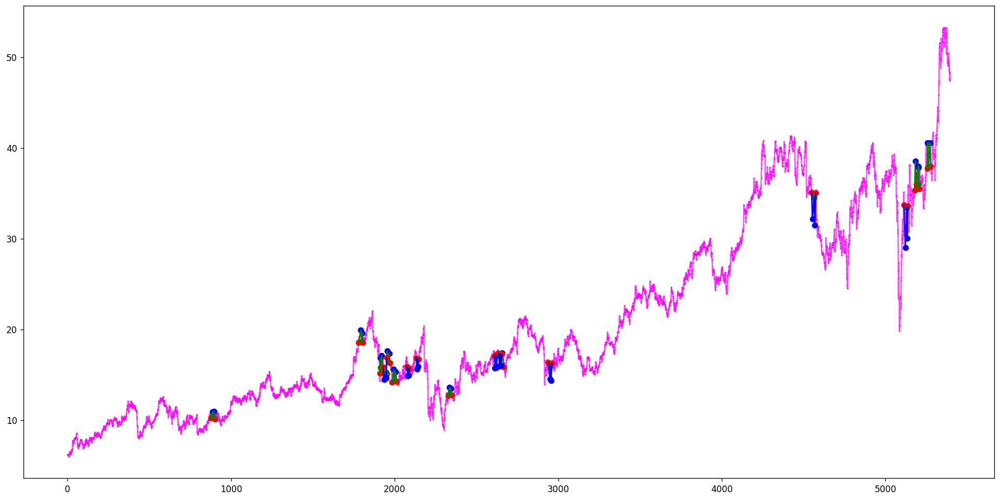

[(131, 135, 140, 142, 144), (274, 276, 279, 286, 288), (551, 552, 554, 560, 562), (652, 653, 656, 657, 660), (1147, 1148, 1154, 1155, 1157), (1914, 1916, 1920, 1927, 1936), (2220, 2223, 2229, 2230, 2231), (2245, 2246, 2249, 2252, 2257), (2550, 2558, 2567, 2574, 2576), (2550, 2560, 2567, 2574, 2576), (2586, 2590, 2593, 2597, 2599), (2726, 2731, 2744, 2748, 2749), (2920, 2924, 2930, 2934, 2939), (3096, 3099, 3114, 3115, 3116), (3253, 3255, 3258, 3269, 3274), (4028, 4031, 4037, 4039, 4042), (5032, 5037, 5038, 5055, 5059)]
[(88, 94, 100, 102, 105), (143, 147, 149, 152, 155), (170, 172, 174, 178, 180), (360, 365, 370, 374, 378), (704, 707, 711, 717, 721), (868, 870, 874, 878, 884), (897, 903, 909, 914, 919), (1024, 1027, 1032, 1037, 1045), (1187, 1188, 1195, 1204, 1209), (1237, 1242, 1246, 1249, 1253), (1474, 1486, 1493, 1499, 1502), (1651, 1658, 1665, 1669, 1673), (1728, 1730, 1731, 1737, 1741), (1972, 1974, 1977, 1986, 1989), (2400, 2403, 2410, 2412, 2417), (2516, 2521, 2527, 2533, 2539),

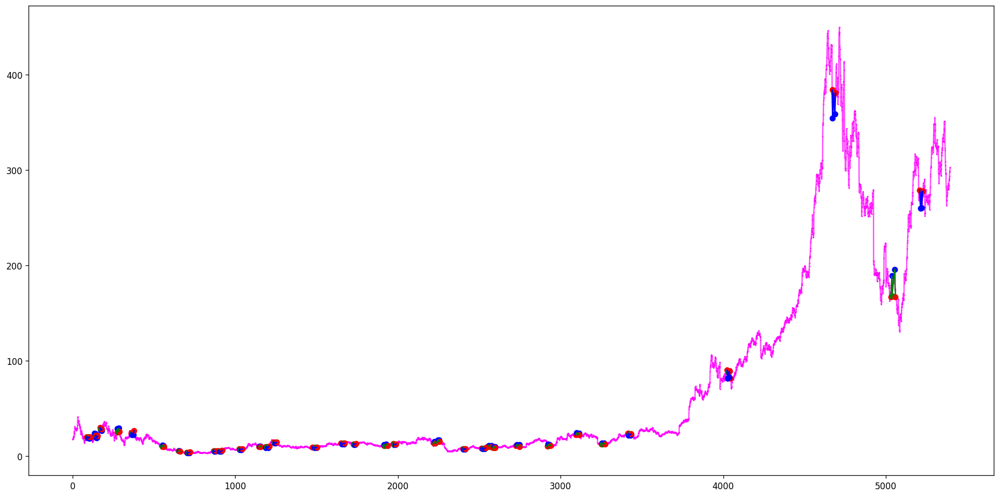

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1423, 1424, 1430, 1436, 1450), (1423, 1424, 1430, 1441, 1450), (1843, 1844, 1860, 1864, 1870), (1893, 1896, 1898, 1902, 1906), (1893, 1897, 1898, 1902, 1906), (2053, 2056, 2058, 2063, 2072), (2053, 2056, 2058, 2066, 2072), (2053, 2057, 2058, 2063, 2072), (2053, 2057, 2058, 2066, 2072), (2149, 2150, 2162, 2169, 2175), (2149, 2150, 2162, 2174, 2175), (2149, 2158, 2162, 2169, 2175), (2149, 2158, 2162, 2174, 2175), (2162, 2163, 2168, 2169, 2175), (2162, 2163, 2168, 2174, 2175), (2292, 2297, 2300, 2302, 2305), (2292, 2297, 2300, 2304, 2305), (2292, 2299, 2300, 2304, 2305), (2315, 2317, 2318, 2333, 2337), (2315, 2317, 2318, 2336, 2337), (2319, 2321, 2326, 2333, 2337), (2319, 2321, 2326, 2336, 2337), (2340, 2342, 2348, 2349, 2352), (2340, 2343, 2348, 2349, 2352), (2340, 2342, 2352, 2355, 2356), (2340, 2343, 2352, 2355, 2356), (2409, 2410, 2412, 2414, 2415), (2427, 2428, 2430, 2432, 2433), (2524, 2526, 2527, 2530, 2534), (2524, 2526, 2527, 2533, 2534), (2516, 2519, 2522, 2526, 2535), (2617, 

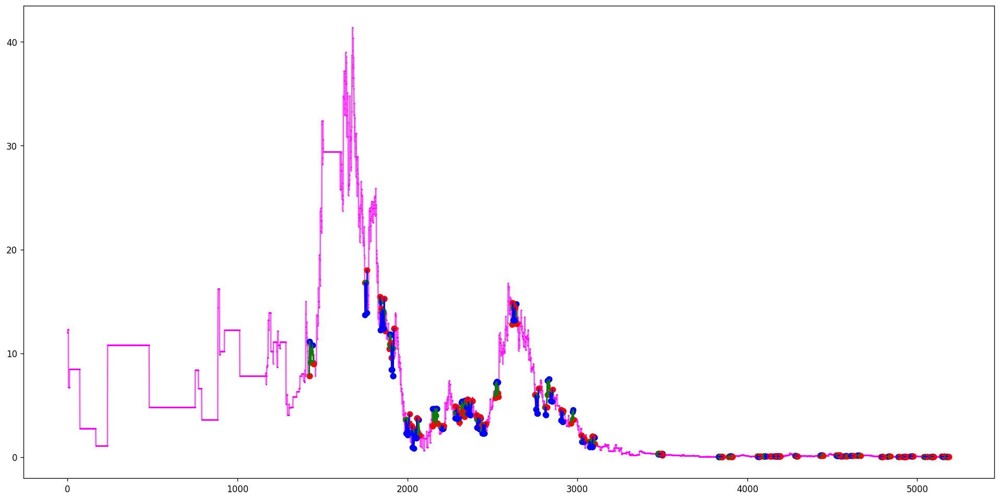

[]
[]
Ticker ABNB found 0 double top patterns, 0 double bottom patterns


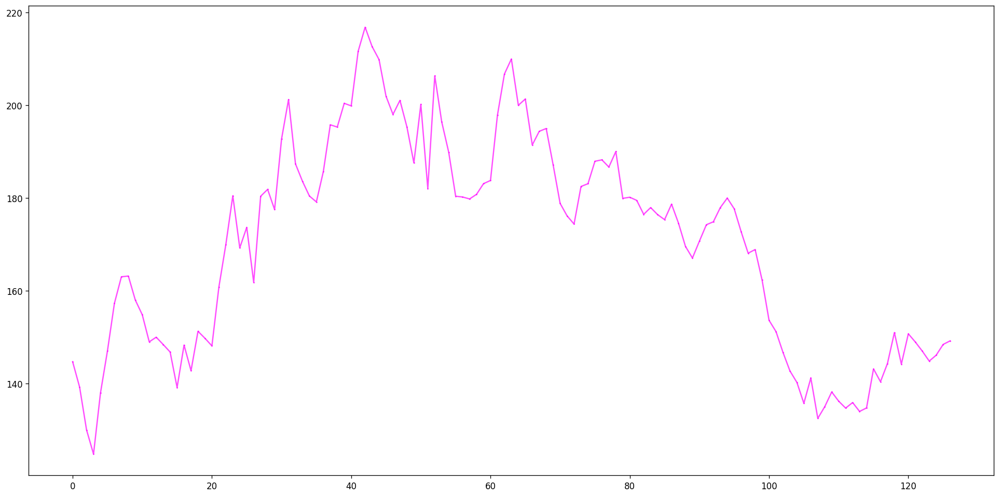

[(834, 835, 838, 839, 841), (1081, 1084, 1088, 1093, 1097), (1400, 1401, 1407, 1409, 1414), (1400, 1404, 1407, 1409, 1414), (1517, 1522, 1531, 1534, 1540)]
[(832, 834, 835, 838, 839), (1293, 1294, 1298, 1302, 1303), (1347, 1349, 1350, 1353, 1355), (1347, 1349, 1358, 1361, 1370), (1347, 1353, 1358, 1361, 1370), (1412, 1426, 1429, 1436, 1439), (1412, 1426, 1429, 1438, 1439), (1605, 1608, 1612, 1616, 1622), (1661, 1674, 1681, 1686, 1689), (1694, 1698, 1706, 1710, 1713), (1765, 1774, 1777, 1782, 1785), (1789, 1794, 1795, 1800, 1806), (4031, 4033, 4034, 4037, 4042), (4031, 4033, 4034, 4039, 4042), (4029, 4037, 4049, 4052, 4057), (4029, 4039, 4049, 4052, 4057), (4155, 4162, 4166, 4169, 4172)]
Ticker ABR found 5 double top patterns, 17 double bottom patterns


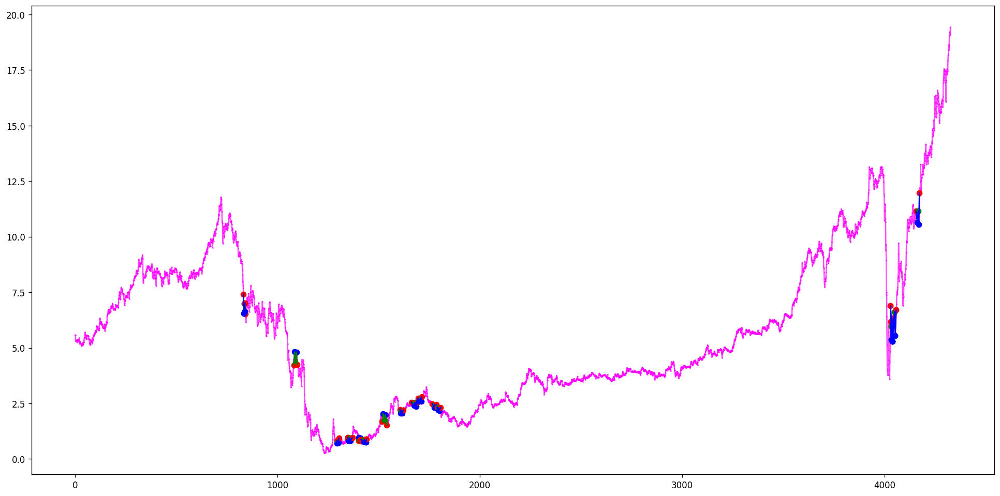

[(55, 58, 61, 66, 70), (55, 59, 61, 66, 70)]
[(60, 61, 66, 70, 71), (133, 135, 141, 144, 145), (1010, 1011, 1012, 1018, 1020), (1093, 1107, 1110, 1112, 1120), (1093, 1107, 1110, 1114, 1120), (1244, 1253, 1256, 1259, 1272), (1244, 1253, 1256, 1263, 1272), (1244, 1253, 1256, 1266, 1272), (2406, 2407, 2411, 2430, 2434), (2412, 2420, 2424, 2430, 2434), (2999, 3001, 3003, 3010, 3014), (3045, 3050, 3058, 3060, 3069)]
Ticker ABST found 2 double top patterns, 12 double bottom patterns


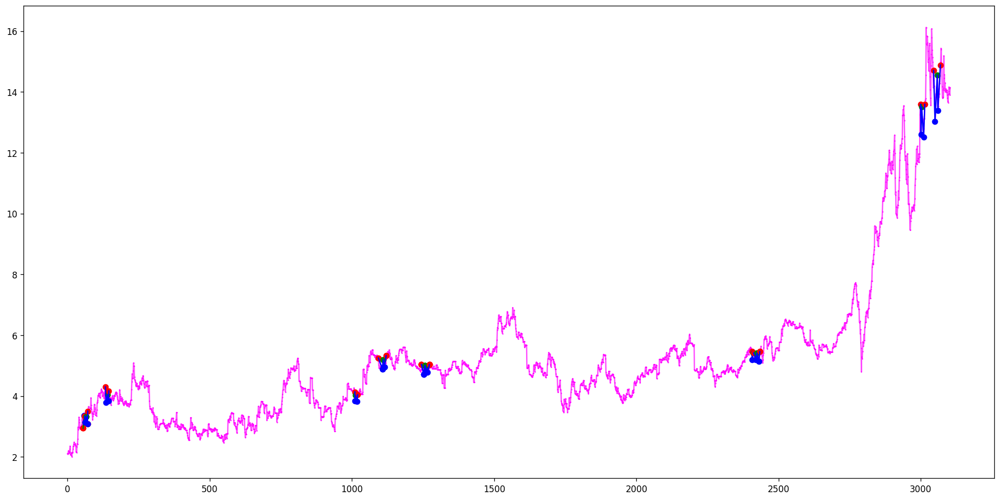

[(612, 615, 618, 622, 629), (712, 716, 719, 724, 731), (2217, 2223, 2225, 2230, 2235), (2241, 2243, 2250, 2263, 2266), (4122, 4127, 4140, 4144, 4146), (5101, 5105, 5115, 5120, 5126)]
[(609, 612, 615, 618, 622), (629, 631, 635, 639, 641), (2212, 2217, 2223, 2225, 2230), (2234, 2241, 2243, 2250, 2252), (4041, 4042, 4044, 4052, 4055), (4127, 4140, 4144, 4146, 4152)]
Ticker ABT found 6 double top patterns, 6 double bottom patterns


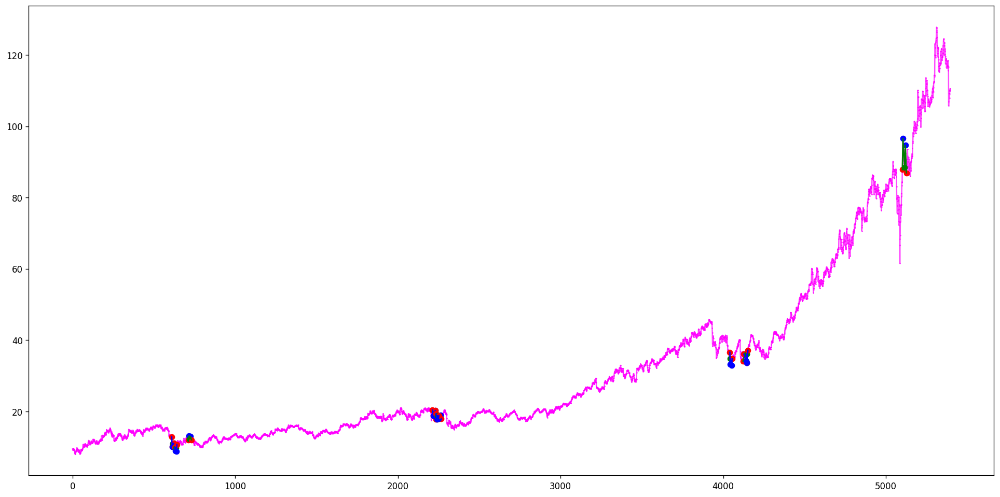

[(153, 165, 171, 178, 180)]
[(1118, 1129, 1133, 1137, 1146), (1148, 1151, 1153, 1158, 1159)]
Ticker ABTX found 1 double top patterns, 2 double bottom patterns


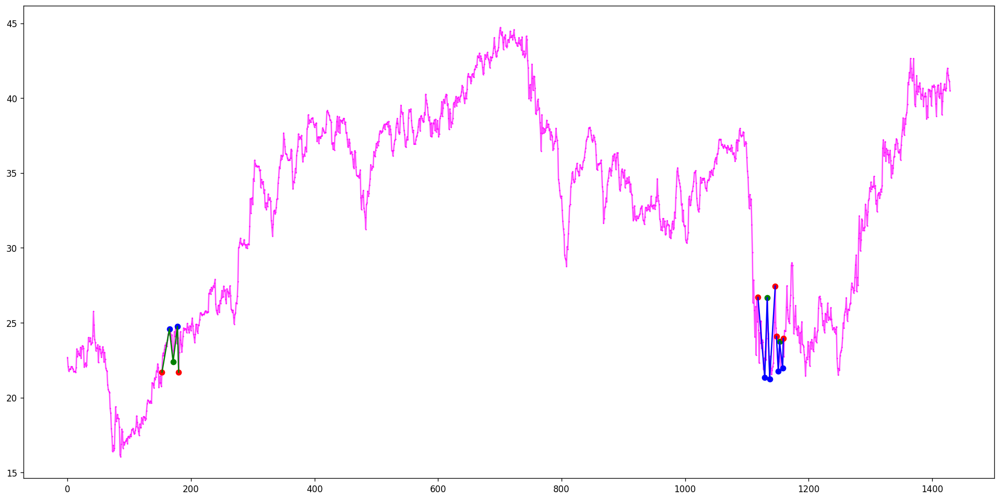

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(396, 399, 405, 408, 414), (1199, 1200, 1201, 1214, 1222), (1199, 1200, 1201, 1218, 1222), (1199, 1200, 1201, 1221, 1222), (1201, 1202, 1210, 1214, 1222), (1201, 1202, 1210, 1218, 1222), (1201, 1202, 1210, 1221, 1222), (1201, 1209, 1210, 1214, 1222), (1201, 1209, 1210, 1218, 1222), (1201, 1209, 1210, 1221, 1222), (1201, 1202, 1210, 1223, 1228), (1201, 1202, 1210, 1227, 1228), (1201, 1209, 1210, 1223, 1228), (1201, 1209, 1210, 1227, 1228), (1213, 1214, 1222, 1223, 1228), (1213, 1214, 1222, 1227, 1228), (1213, 1218, 1222, 1227, 1228), (1294, 1297, 1299, 1301, 1305), (1294, 1297, 1299, 1304, 1305), (1294, 1298, 1299, 1304, 1305), (1354, 1356, 1357, 1361, 1362), (1354, 1356, 1357, 1363, 1364), (1354, 1356, 1357, 1366, 1368), (1354, 1356, 1357, 1367, 1368), (1358, 1359, 1362, 1366, 1368), (1358, 1359, 1362, 1367, 1368), (1358, 1361, 1362, 1366, 1368), (1358, 1361, 1362, 1367, 1368), (1362, 1363, 1364, 1367, 1368)]
[(275, 277, 278, 282, 289), (278, 282, 287, 288, 289), (391, 396, 399, 405, 

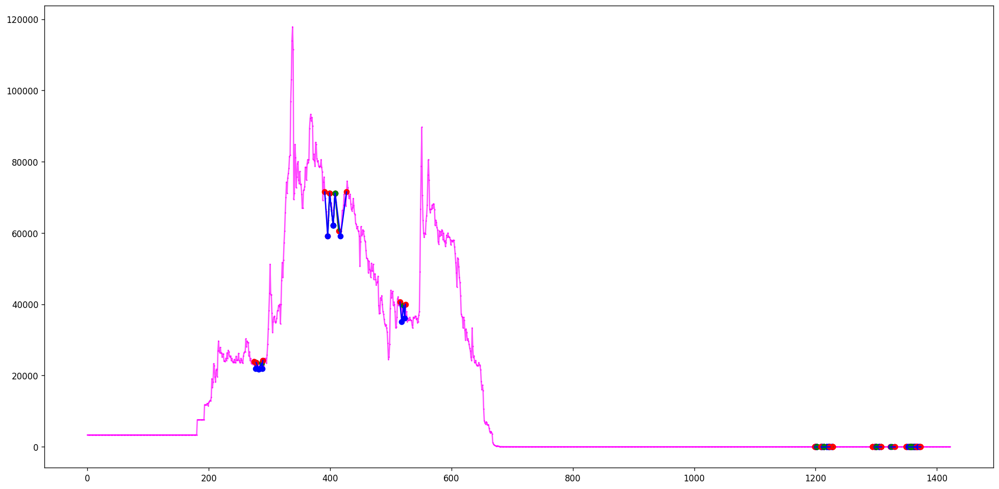

[(356, 358, 362, 363, 365)]
[(189, 194, 198, 202, 208), (463, 466, 469, 473, 483)]
Ticker ACA found 1 double top patterns, 2 double bottom patterns


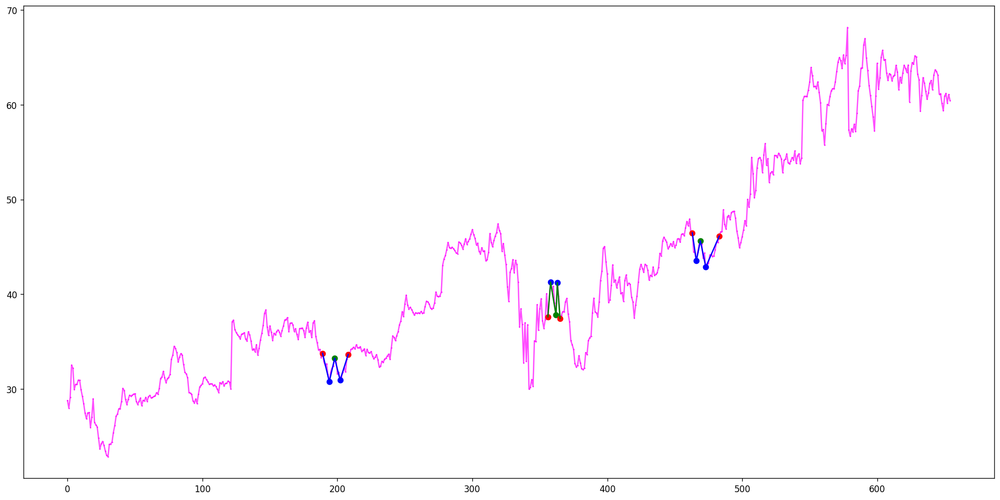

[]
[]
Ticker ACAC found 0 double top patterns, 0 double bottom patterns


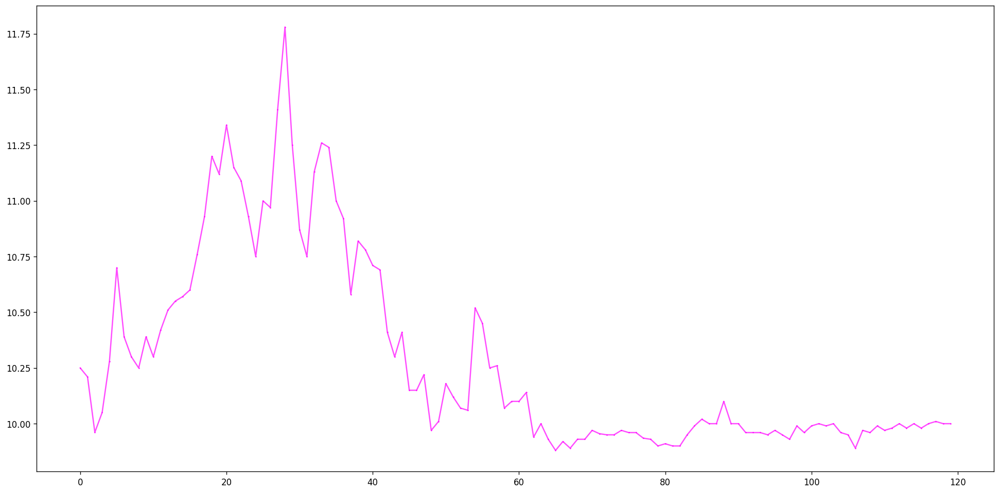

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(28, 29, 36, 37, 45), (28, 29, 36, 40, 45), (248, 249, 259, 265, 275), (322, 331, 332, 339, 343), (525, 528, 531, 533, 535), (831, 834, 844, 847, 852), (831, 834, 844, 850, 852), (882, 888, 891, 899, 903), (891, 892, 895, 899, 903), (1158, 1160, 1163, 1167, 1169), (1158, 1160, 1163, 1168, 1169), (1157, 1160, 1169, 1173, 1176), (1213, 1215, 1218, 1224, 1234), (1477, 1479, 1482, 1485, 1487), (1477, 1480, 1482, 1485, 1487), (1826, 1827, 1835, 1836, 1842), (1826, 1828, 1835, 1836, 1842), (1995, 1997, 1999, 2005, 2008), (2093, 2095, 2103, 2105, 2109), (2523, 2531, 2538, 2542, 2544), (3044, 3045, 3046, 3051, 3053), (3286, 3289, 3293, 3298, 3301), (3400, 3402, 3404, 3408, 3414), (3400, 3408, 3415, 3421, 3427), (3549, 3551, 3552, 3558, 3562), (4198, 4202, 4208, 4211, 4214)]
[(570, 575, 580, 585, 589), (664, 670, 675, 681, 687), (828, 831, 834, 844, 847), (890, 891, 892, 895, 899), (900, 907, 915, 924, 926), (1029, 1033, 1034, 1038, 1041), (1215, 1218, 1224, 1236, 1241), (1274, 1277, 1278, 128

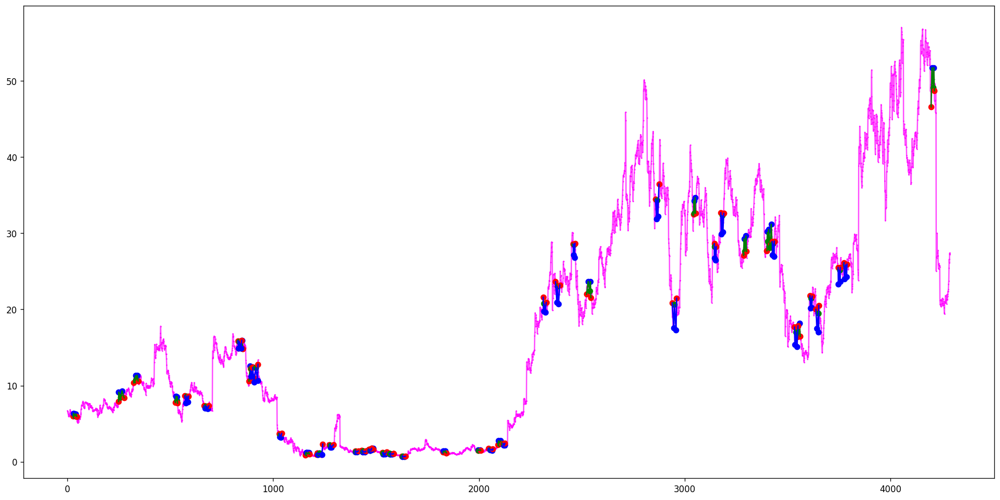

[(383, 384, 389, 393, 394), (562, 565, 568, 575, 583), (1328, 1331, 1336, 1338, 1340), (1385, 1387, 1393, 1399, 1402)]
[(279, 280, 283, 289, 291), (279, 280, 283, 290, 291), (279, 282, 283, 289, 291), (279, 282, 283, 290, 291), (384, 389, 393, 394, 396), (424, 429, 434, 436, 439), (602, 607, 610, 616, 625), (1325, 1328, 1331, 1340, 1341), (1573, 1577, 1580, 1585, 1589)]
Ticker ACB found 4 double top patterns, 9 double bottom patterns


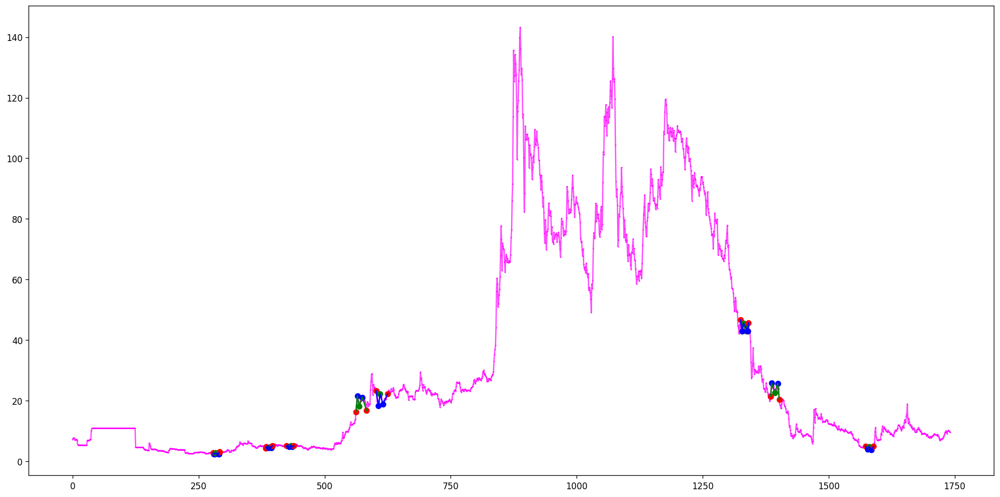

[(1105, 1108, 1112, 1116, 1119)]
[(897, 899, 906, 915, 923), (1175, 1178, 1186, 1194, 1201)]
Ticker ACBI found 1 double top patterns, 2 double bottom patterns


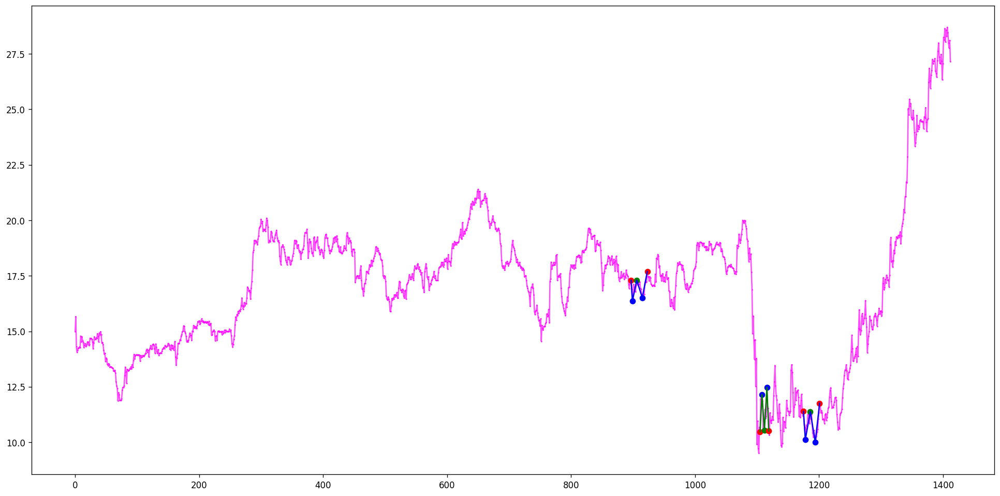

[(864, 868, 870, 876, 880), (1148, 1151, 1153, 1158, 1163), (1194, 1197, 1201, 1210, 1217), (3938, 3942, 3950, 3953, 3963)]
[(1304, 1306, 1314, 1318, 1324), (1788, 1790, 1793, 1797, 1802), (1823, 1825, 1829, 1834, 1838), (4062, 4073, 4077, 4080, 4083)]
Ticker ACC found 4 double top patterns, 4 double bottom patterns


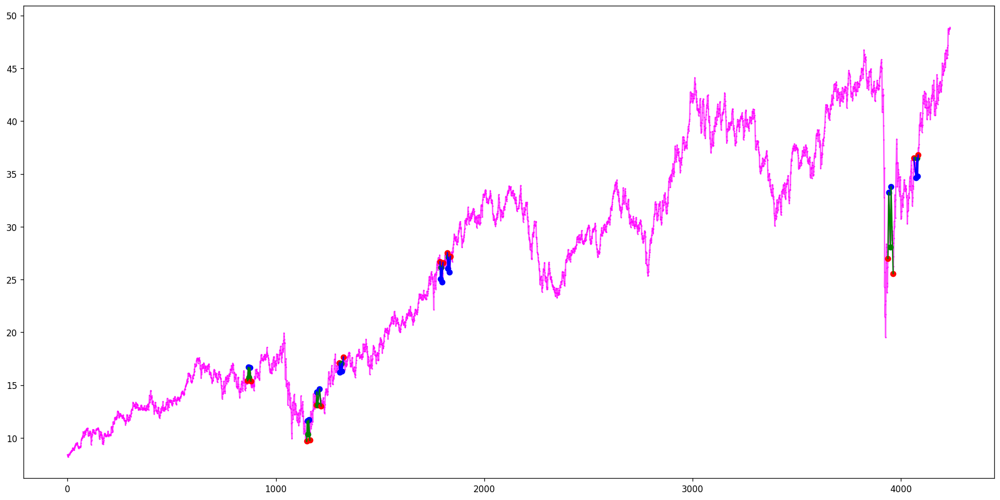

[(23, 25, 28, 37, 39)]
[]
Ticker ACCD found 1 double top patterns, 0 double bottom patterns


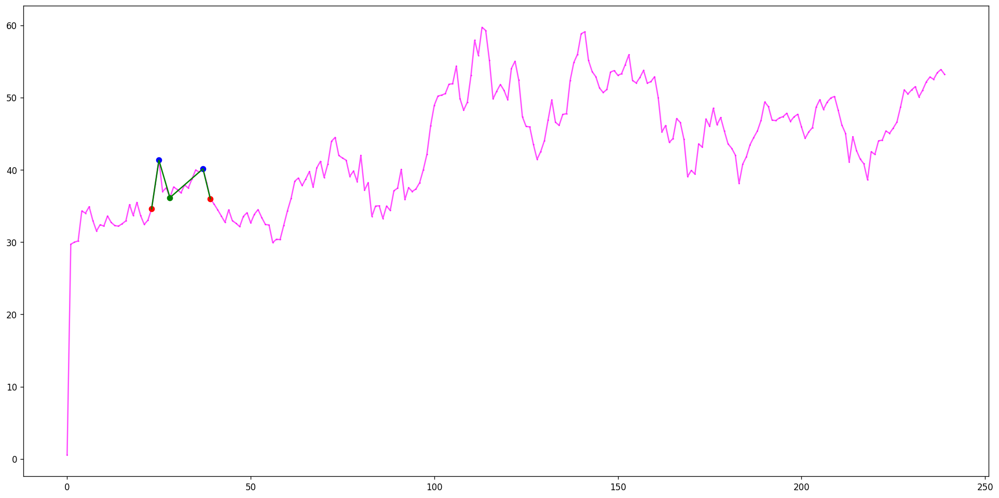

[(718, 721, 722, 734, 744), (1461, 1464, 1468, 1472, 1474), (1485, 1487, 1492, 1498, 1501)]
[(295, 297, 305, 308, 316), (546, 551, 555, 564, 567), (580, 583, 589, 593, 597), (911, 913, 919, 921, 926), (1213, 1218, 1219, 1230, 1236), (1536, 1539, 1544, 1546, 1549)]
Ticker ACDVF found 3 double top patterns, 6 double bottom patterns


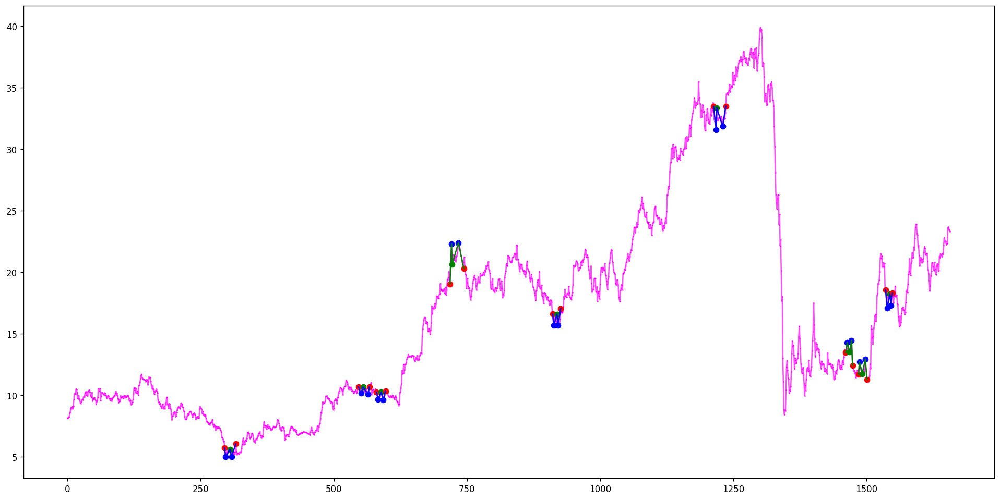

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(523, 524, 528, 530, 531), (546, 548, 549, 552, 553), (747, 748, 753, 755, 759), (978, 980, 982, 986, 987), (990, 992, 999, 1000, 1006), (1293, 1294, 1295, 1299, 1303), (2117, 2121, 2124, 2137, 2142), (2889, 2890, 2896, 2898, 2901), (2963, 2965, 2972, 2974, 2977), (3338, 3339, 3347, 3352, 3354), (3459, 3461, 3462, 3474, 3478), (3513, 3514, 3517, 3521, 3523), (3664, 3665, 3668, 3676, 3677), (3710, 3711, 3714, 3719, 3723), (3723, 3725, 3730, 3734, 3750), (3906, 3912, 3915, 3924, 3925), (4067, 4071, 4073, 4080, 4084), (4067, 4080, 4084, 4087, 4090), (4147, 4150, 4155, 4158, 4159), (4168, 4170, 4172, 4178, 4185), (4200, 4201, 4207, 4208, 4212), (4230, 4232, 4235, 4236, 4238)]
[(150, 154, 155, 158, 159), (220, 222, 225, 232, 233), (340, 355, 356, 360, 368), (640, 642, 645, 646, 648), (853, 860, 861, 864, 869), (872, 874, 879, 881, 884), (1454, 1456, 1462, 1464, 1469), (1561, 1565, 1570, 1577, 1579), (1593, 1597, 1604, 1613, 1615), (1899, 1901, 1904, 1907, 1908), (2047, 2053, 2057, 2058, 20

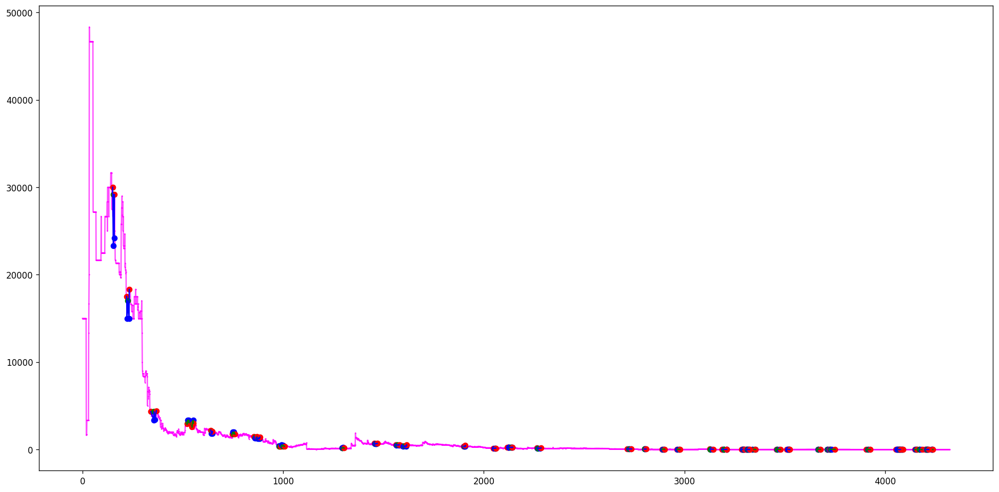

[]
[(489, 490, 493, 501, 503), (548, 551, 557, 563, 565)]
Ticker ACES found 0 double top patterns, 2 double bottom patterns


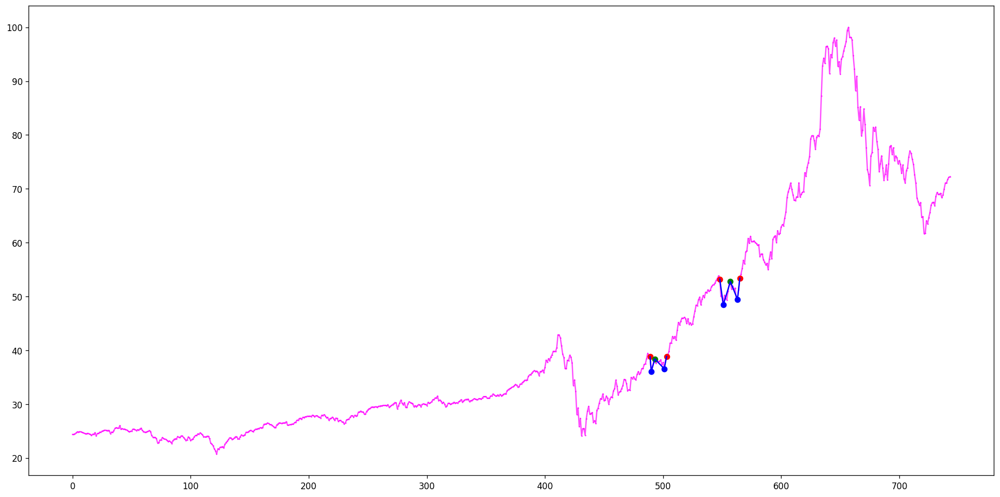

[(389, 394, 402, 411, 417), (459, 461, 467, 470, 475)]
[(52, 55, 56, 60, 65), (185, 186, 190, 191, 194), (595, 597, 605, 611, 613)]
Ticker ACET found 2 double top patterns, 3 double bottom patterns


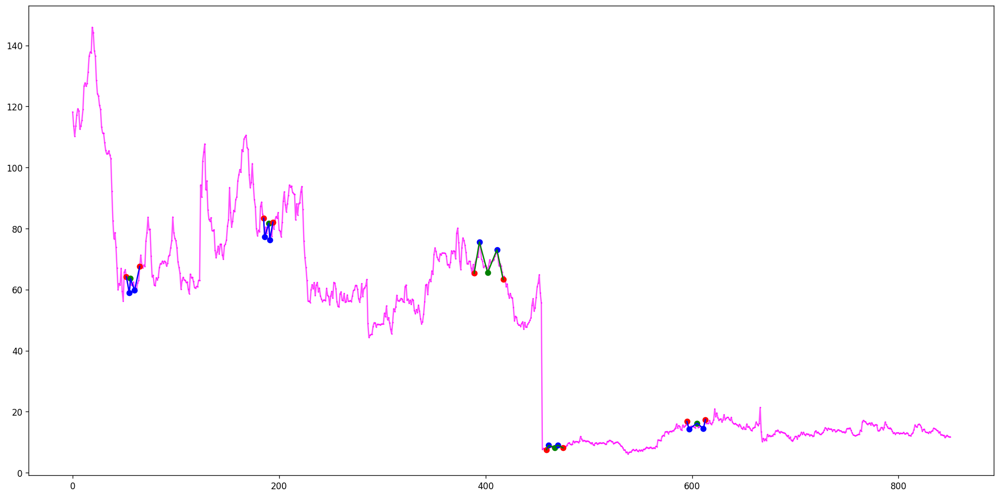

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(688, 689, 699, 702, 703), (688, 689, 699, 708, 710), (688, 689, 699, 709, 710), (688, 698, 699, 708, 710), (688, 698, 699, 709, 710), (699, 700, 703, 708, 710), (699, 700, 703, 709, 710), (699, 702, 703, 708, 710), (699, 702, 703, 709, 710), (759, 760, 770, 771, 772), (759, 760, 772, 774, 778), (759, 760, 772, 777, 778), (871, 873, 885, 895, 898), (871, 873, 885, 897, 898), (871, 884, 885, 895, 898), (871, 884, 885, 897, 898)]
[(357, 358, 359, 362, 365), (357, 358, 359, 364, 365), (662, 663, 686, 688, 689), (662, 666, 686, 688, 689), (698, 699, 700, 707, 708), (698, 699, 700, 710, 726), (698, 699, 700, 714, 726), (702, 703, 708, 710, 726), (702, 703, 708, 714, 726), (702, 707, 708, 714, 726), (769, 770, 771, 778, 783), (769, 770, 771, 782, 783), (771, 772, 774, 782, 783), (1469, 1475, 1477, 1480, 1481), (1919, 1920, 1921, 1926, 1931), (1919, 1920, 1921, 1930, 1931), (5087, 5089, 5092, 5093, 5094)]
Ticker ACFL found 16 double top patterns, 17 double bottom patterns


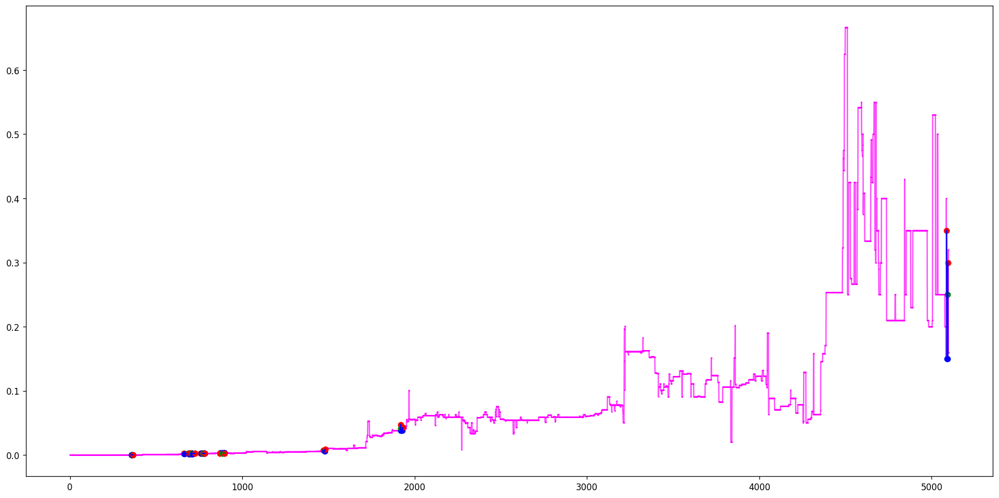

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(153, 156, 160, 168, 174), (153, 156, 160, 171, 174), (572, 575, 576, 580, 581), (808, 810, 815, 820, 822), (1046, 1047, 1054, 1057, 1060), (1273, 1274, 1279, 1287, 1288), (1312, 1314, 1318, 1324, 1328), (1312, 1315, 1318, 1324, 1328), (1312, 1324, 1328, 1330, 1332), (1685, 1687, 1691, 1694, 1699), (2029, 2031, 2034, 2047, 2051), (2144, 2145, 2149, 2156, 2159), (2149, 2152, 2153, 2156, 2159), (2166, 2169, 2171, 2177, 2181), (2238, 2240, 2248, 2252, 2259), (2348, 2350, 2354, 2356, 2359), (2348, 2350, 2354, 2357, 2359), (2766, 2768, 2771, 2775, 2780), (2910, 2914, 2917, 2921, 2925), (3143, 3146, 3149, 3153, 3154), (3358, 3360, 3364, 3373, 3380), (3492, 3497, 3500, 3501, 3504), (3946, 3947, 3950, 3952, 3953), (3985, 3986, 3993, 3996, 4003), (4053, 4059, 4063, 4066, 4069), (4074, 4075, 4081, 4087, 4088), (4064, 4066, 4069, 4075, 4090), (4064, 4066, 4069, 4080, 4090), (4064, 4066, 4069, 4082, 4090), (4064, 4066, 4069, 4087, 4090), (4064, 4066, 4069, 4089, 4090), (4074, 4075, 4081, 4089, 40

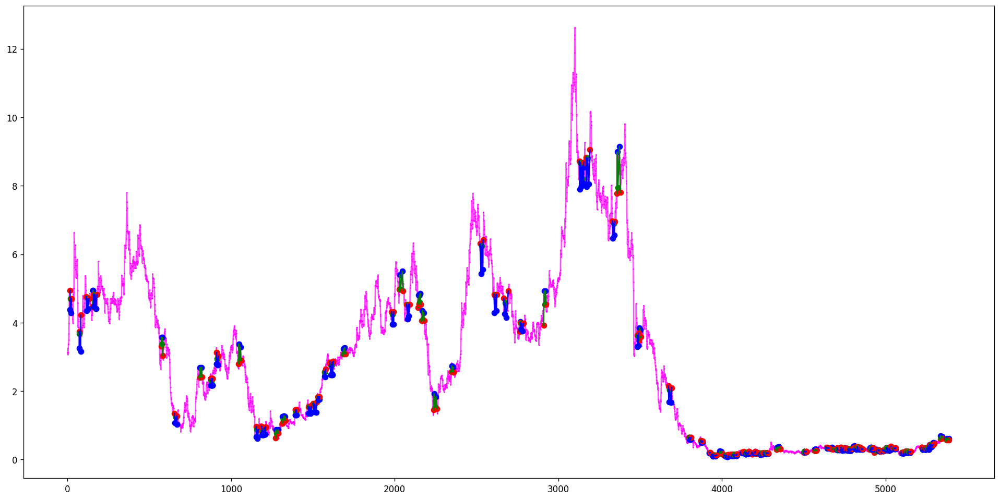

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(214, 218, 222, 227, 230), (256, 262, 264, 269, 275), (287, 288, 296, 297, 299), (1008, 1012, 1013, 1020, 1025), (1904, 1911, 1914, 1928, 1931), (2225, 2231, 2235, 2241, 2247)]
[(288, 299, 302, 307, 311), (1105, 1111, 1118, 1127, 1133), (1548, 1558, 1570, 1574, 1576)]
Ticker ACGBY found 6 double top patterns, 3 double bottom patterns


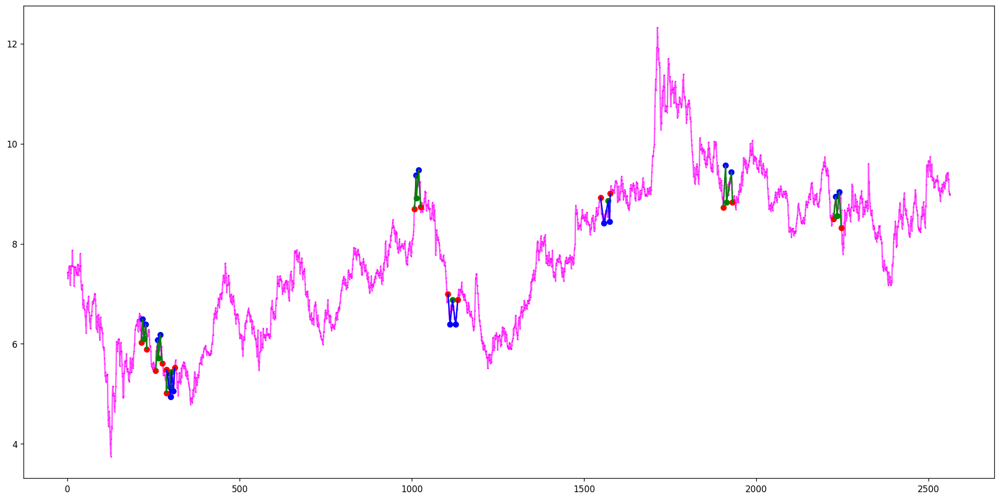

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(23, 25, 29, 32, 34), (385, 390, 396, 402, 404), (385, 390, 396, 403, 404), (840, 844, 848, 857, 867), (1434, 1436, 1438, 1444, 1452), (2070, 2075, 2080, 2090, 2097), (2341, 2343, 2347, 2356, 2360), (2968, 2974, 2977, 2987, 2993), (5086, 5091, 5095, 5099, 5108), (5221, 5227, 5232, 5236, 5238)]
[(18, 22, 32, 34, 36), (18, 22, 36, 37, 39), (361, 369, 372, 376, 377), (508, 512, 522, 526, 530), (2343, 2347, 2356, 2363, 2368), (5080, 5086, 5091, 5095, 5099), (5105, 5114, 5119, 5122, 5127)]
Ticker ACGL found 10 double top patterns, 7 double bottom patterns


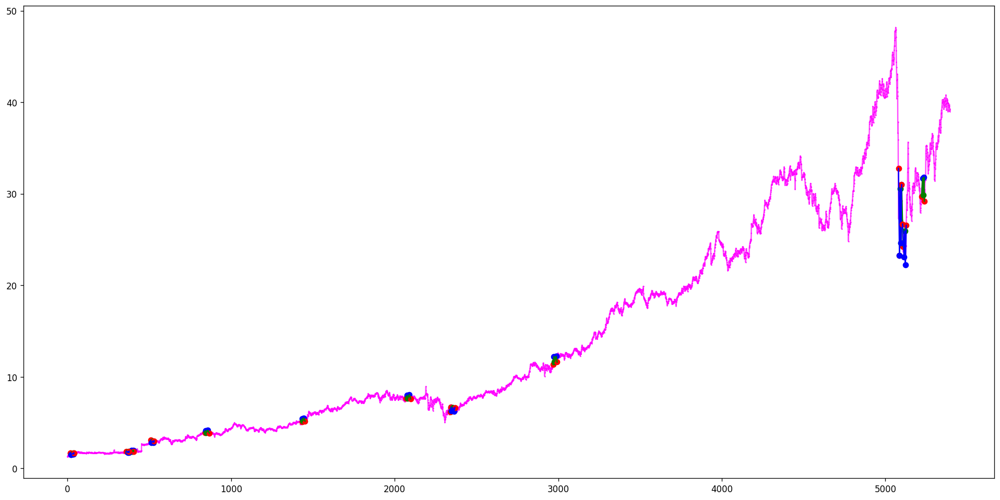

[]
[]
Ticker ACGLO found 0 double top patterns, 0 double bottom patterns


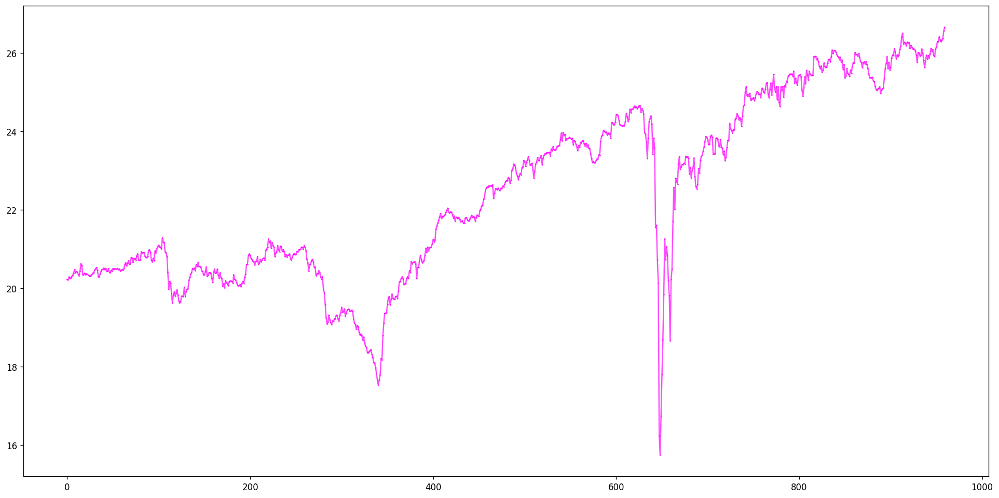

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(156, 159, 168, 171, 179), (288, 294, 296, 300, 308), (510, 514, 520, 521, 524), (1007, 1009, 1012, 1022, 1028), (1435, 1436, 1437, 1441, 1445), (1759, 1767, 1775, 1779, 1783), (1987, 1997, 2001, 2009, 2012), (2557, 2559, 2562, 2571, 2576), (2639, 2650, 2653, 2657, 2665), (3183, 3184, 3186, 3189, 3195), (3351, 3353, 3357, 3366, 3373), (3450, 3451, 3457, 3464, 3471), (3605, 3608, 3616, 3619, 3621), (4830, 4838, 4840, 4844, 4850)]
[(160, 162, 165, 168, 170), (478, 483, 485, 490, 495), (716, 719, 724, 725, 730), (930, 933, 944, 953, 957), (1536, 1537, 1538, 1543, 1545), (2010, 2012, 2017, 2020, 2029), (2383, 2387, 2389, 2397, 2405), (2518, 2524, 2527, 2530, 2538), (2623, 2627, 2629, 2633, 2634), (2841, 2847, 2851, 2855, 2869), (2962, 2966, 2971, 2976, 2978), (3255, 3259, 3260, 3265, 3268), (3255, 3265, 3269, 3275, 3279), (3445, 3450, 3451, 3457, 3464), (3874, 3879, 3892, 3896, 3898), (3942, 3946, 3947, 3953, 3957), (4378, 4383, 4386, 4392, 4403), (4440, 4443, 4444, 4448, 4453), (4440, 44

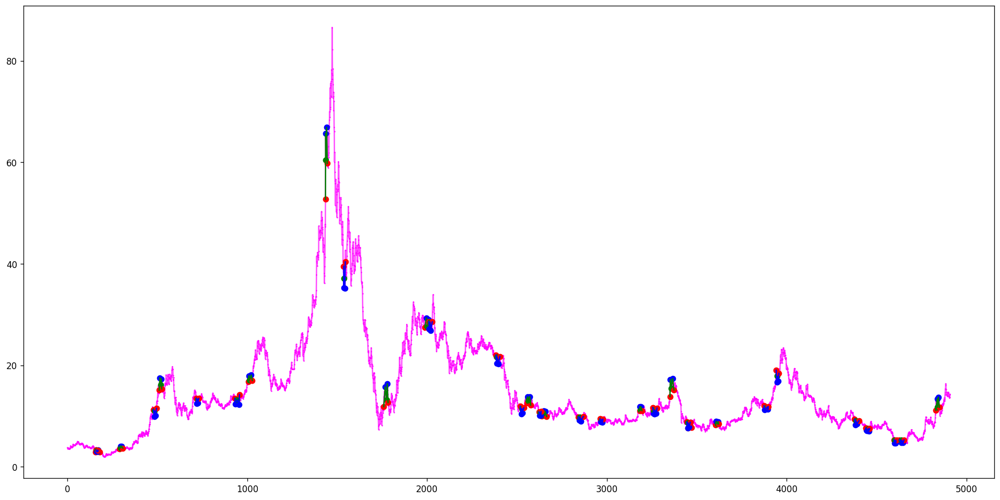

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(109, 112, 114, 117, 124), (109, 112, 114, 118, 124), (384, 385, 395, 398, 404), (384, 385, 395, 403, 404), (500, 507, 509, 516, 520), (549, 550, 551, 554, 559), (549, 550, 551, 556, 559), (549, 550, 551, 558, 559), (551, 552, 553, 558, 559), (577, 578, 581, 586, 590), (577, 578, 581, 588, 590), (803, 807, 809, 816, 824), (845, 846, 855, 858, 861), (845, 846, 855, 860, 861), (861, 863, 866, 867, 869), (927, 935, 939, 944, 953), (927, 937, 939, 944, 953), (2166, 2174, 2185, 2191, 2193), (2396, 2401, 2407, 2413, 2419), (2625, 2627, 2629, 2636, 2642), (2731, 2732, 2733, 2738, 2740), (2882, 2884, 2886, 2889, 2895), (4122, 4134, 4140, 4144, 4145), (4824, 4833, 4837, 4844, 4851)]
[(382, 384, 385, 404, 406), (386, 395, 398, 404, 406), (386, 397, 398, 404, 406), (450, 452, 455, 456, 458), (470, 471, 475, 476, 478), (478, 485, 486, 489, 496), (478, 485, 486, 491, 496), (478, 485, 486, 494, 496), (507, 509, 510, 520, 521), (550, 551, 552, 559, 561), (552, 553, 554, 559, 561), (689, 691, 695, 70

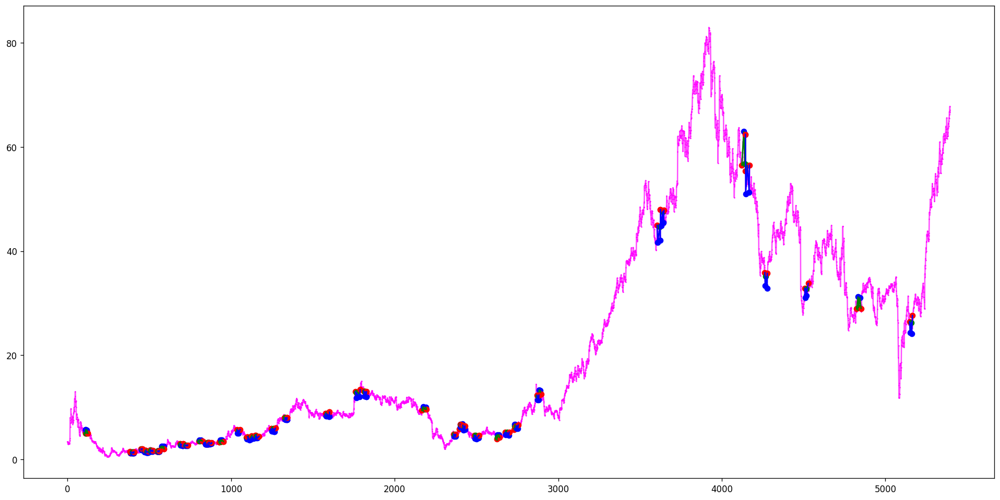

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(163, 166, 168, 171, 173), (494, 495, 505, 506, 510), (597, 598, 600, 603, 604), (776, 780, 787, 791, 792), (835, 839, 846, 851, 856), (1748, 1750, 1755, 1758, 1771), (2210, 2212, 2213, 2217, 2229), (2213, 2217, 2223, 2226, 2229), (2407, 2411, 2412, 2417, 2419), (2427, 2429, 2441, 2443, 2451), (2581, 2585, 2593, 2597, 2601), (2864, 2865, 2868, 2877, 2879), (3143, 3155, 3159, 3162, 3166), (3267, 3269, 3284, 3287, 3294), (3335, 3337, 3341, 3345, 3349), (3770, 3774, 3780, 3783, 3786), (5034, 5037, 5040, 5042, 5050), (5110, 5114, 5117, 5120, 5122), (5110, 5115, 5117, 5120, 5122)]
[(489, 493, 495, 505, 506), (697, 699, 701, 712, 713), (701, 704, 706, 712, 713), (733, 738, 742, 744, 745), (775, 776, 780, 787, 791), (855, 859, 865, 872, 879), (1331, 1335, 1342, 1345, 1347), (1742, 1748, 1750, 1755, 1758), (2347, 2348, 2352, 2353, 2354), (2379, 2381, 2384, 2391, 2401), (2952, 2956, 2961, 2968, 2973), (3424, 3427, 3431, 3433, 3441), (3500, 3503, 3506, 3511, 3521), (3624, 3625, 3630, 3633, 3644

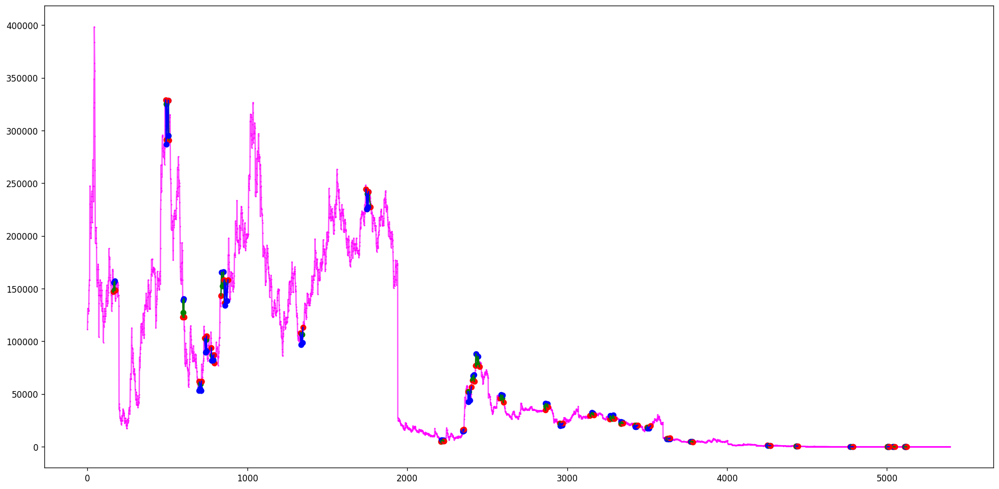

[]
[(205, 209, 211, 214, 218)]
Ticker ACI found 0 double top patterns, 1 double bottom patterns


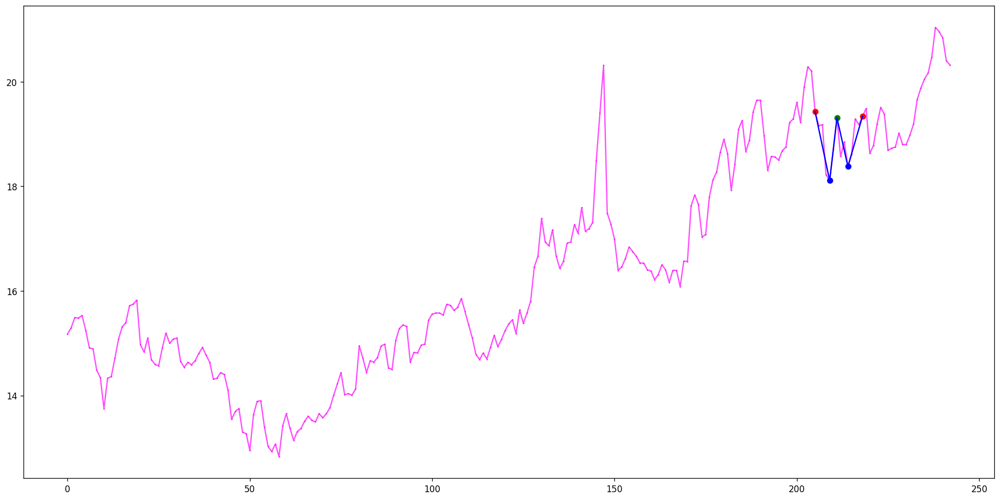

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(53, 54, 55, 60, 62), (95, 98, 105, 110, 112), (604, 605, 606, 612, 614), (604, 605, 606, 613, 614), (822, 832, 838, 844, 850)]
[(111, 112, 116, 117, 118), (376, 381, 383, 391, 399), (475, 479, 481, 484, 487), (734, 735, 738, 739, 743), (960, 963, 965, 969, 984), (1020, 1026, 1028, 1034, 1036), (1157, 1161, 1168, 1180, 1182)]
Ticker ACIU found 5 double top patterns, 7 double bottom patterns


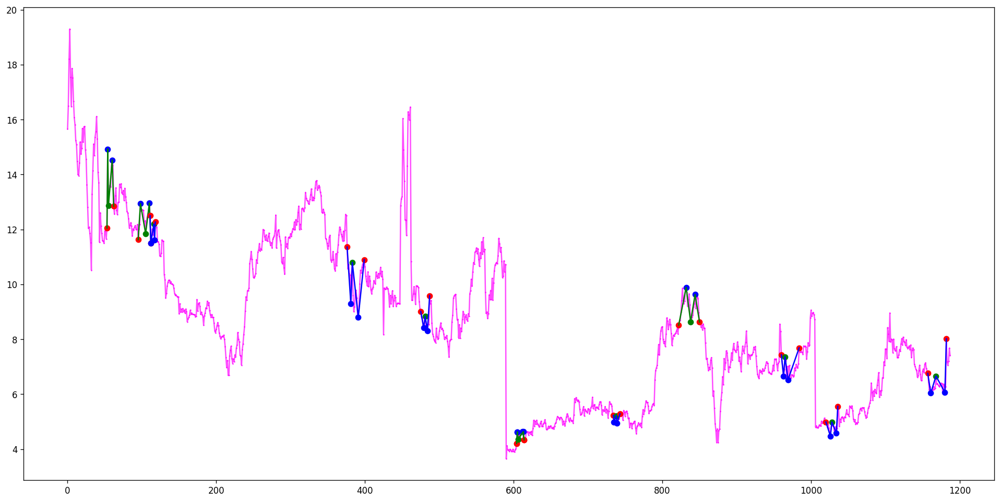

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(228, 229, 231, 238, 243), (245, 246, 252, 253, 265), (403, 406, 419, 420, 422), (740, 747, 750, 752, 761), (740, 747, 750, 760, 761), (1175, 1177, 1187, 1192, 1197), (1232, 1236, 1241, 1245, 1257), (1384, 1393, 1397, 1398, 1404), (2071, 2076, 2079, 2093, 2097), (2080, 2082, 2083, 2093, 2097), (2973, 2982, 2983, 2987, 2991), (3096, 3103, 3107, 3117, 3122), (4082, 4086, 4092, 4101, 4110), (4126, 4133, 4140, 4144, 4145), (5096, 5099, 5103, 5112, 5122)]
[(12, 18, 26, 28, 32), (215, 218, 221, 228, 229), (242, 245, 246, 252, 253), (747, 750, 752, 761, 767), (1095, 1097, 1104, 1106, 1111), (1550, 1561, 1564, 1570, 1572), (1959, 1964, 1968, 1973, 1977), (2131, 2138, 2142, 2143, 2145), (2242, 2244, 2246, 2249, 2260), (2240, 2241, 2242, 2249, 2262), (2307, 2309, 2314, 2316, 2324), (2377, 2380, 2387, 2394, 2402), (2849, 2853, 2857, 2865, 2869), (3604, 3608, 3610, 3618, 3629), (4767, 4774, 4778, 4780, 4784), (5082, 5083, 5089, 5095, 5098), (5203, 5205, 5208, 5214, 5220)]
Ticker ACIW found 15 dou

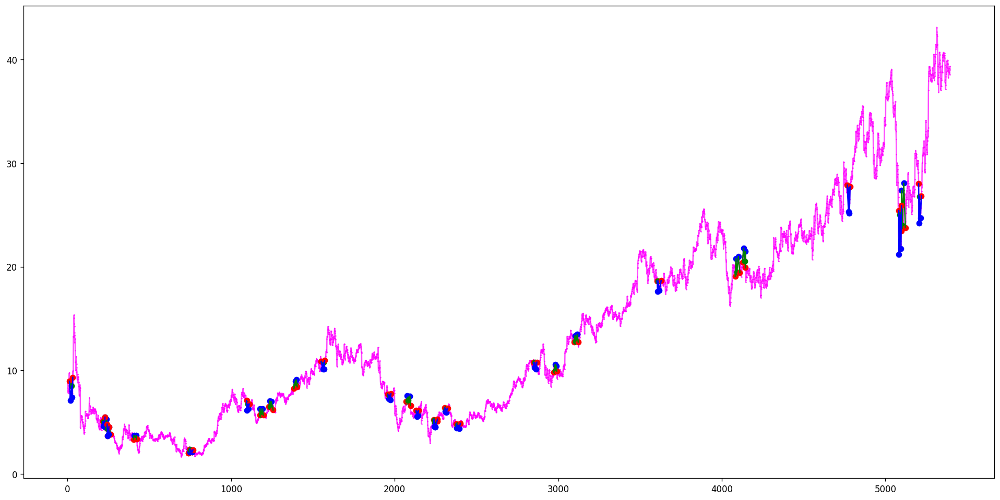

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1606, 1607, 1608, 1614, 1615), (1620, 1624, 1625, 1631, 1632), (1641, 1642, 1647, 1649, 1650), (2054, 2058, 2060, 2069, 2079), (2054, 2059, 2060, 2069, 2079)]
[(1094, 1096, 1101, 1103, 1107), (1094, 1096, 1101, 1105, 1107), (1508, 1511, 1523, 1527, 1531), (1970, 1973, 1975, 1979, 1986), (1970, 1973, 1975, 1980, 1986)]
Ticker ACKAY found 5 double top patterns, 5 double bottom patterns


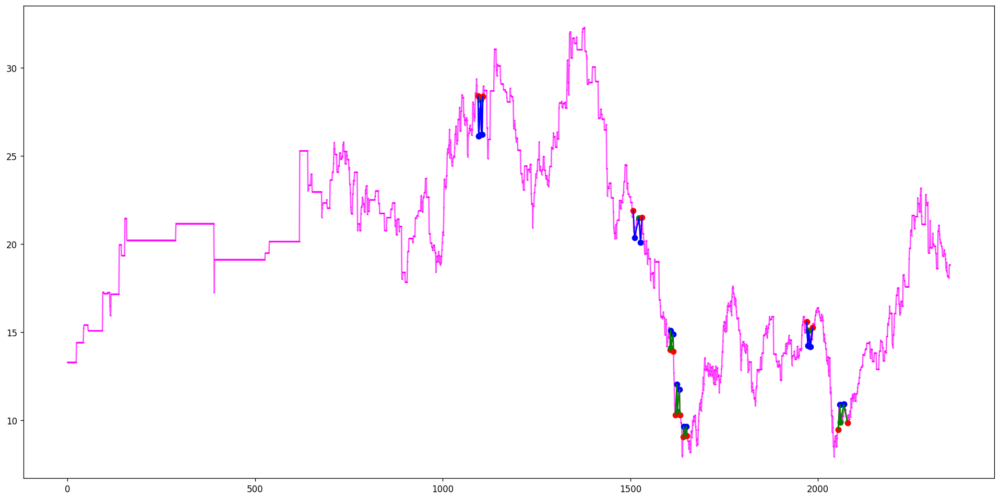

[]
[]
Ticker ACLLF found 0 double top patterns, 0 double bottom patterns


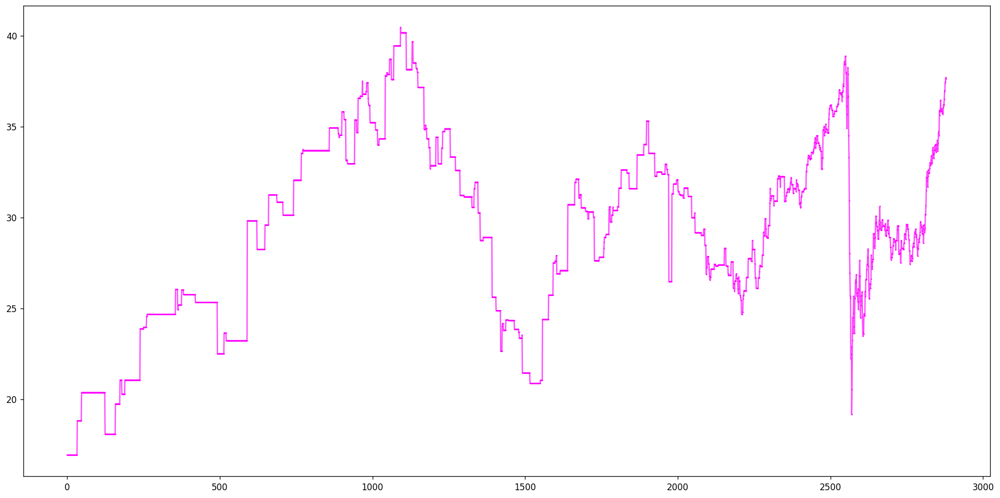

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(138, 141, 147, 153, 155), (481, 483, 487, 491, 494), (723, 727, 729, 736, 739), (790, 792, 794, 800, 804), (1499, 1500, 1506, 1507, 1509), (1923, 1928, 1930, 1935, 1948), (1984, 1987, 1991, 1995, 1999), (2011, 2024, 2031, 2033, 2038), (2120, 2124, 2131, 2133, 2142), (2236, 2238, 2245, 2248, 2253), (2385, 2395, 2399, 2405, 2408), (2411, 2414, 2416, 2423, 2436), (2416, 2417, 2419, 2423, 2436), (2512, 2515, 2517, 2531, 2536), (2517, 2519, 2527, 2531, 2536), (2517, 2525, 2527, 2531, 2536), (2624, 2628, 2641, 2645, 2651), (2786, 2791, 2796, 2801, 2809), (2897, 2903, 2906, 2909, 2913), (3245, 3247, 3248, 3253, 3255), (3332, 3335, 3340, 3341, 3347), (3382, 3385, 3396, 3404, 3408), (3633, 3641, 3644, 3655, 3661), (3633, 3641, 3644, 3660, 3661), (3840, 3846, 3851, 3854, 3855), (3901, 3903, 3905, 3912, 3915), (3901, 3903, 3905, 3913, 3915), (3993, 3998, 4004, 4013, 4014), (4082, 4088, 4101, 4104, 4106), (4998, 5000, 5001, 5010, 5011), (5026, 5027, 5032, 5037, 5041), (5174, 5182, 5189, 5191, 51

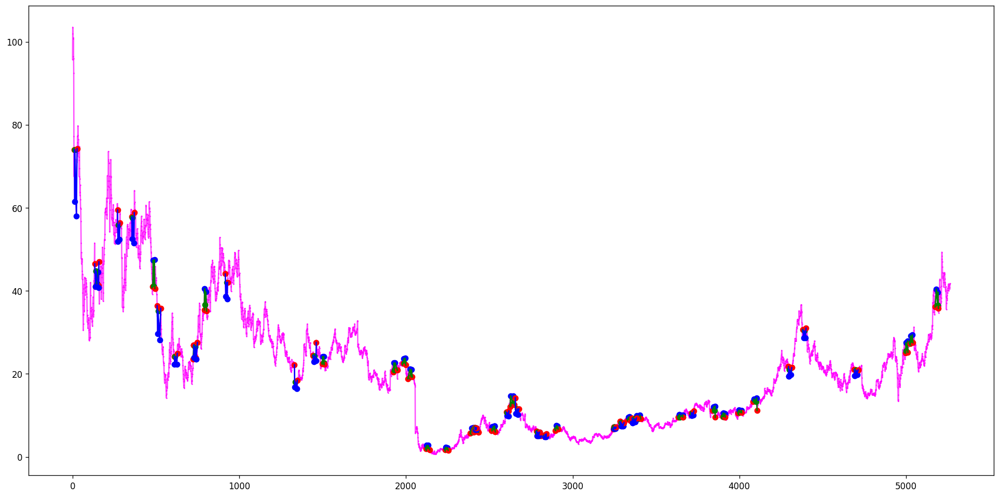

[(96, 100, 102, 111, 113), (143, 148, 153, 161, 164), (314, 319, 326, 330, 332), (1123, 1127, 1137, 1140, 1146), (2089, 2092, 2096, 2103, 2108), (2443, 2445, 2451, 2460, 2465), (2715, 2718, 2721, 2735, 2737)]
[(335, 336, 339, 342, 344), (2085, 2087, 2092, 2096, 2102), (2703, 2707, 2718, 2721, 2727), (3303, 3304, 3307, 3314, 3318)]
Ticker ACM found 7 double top patterns, 4 double bottom patterns


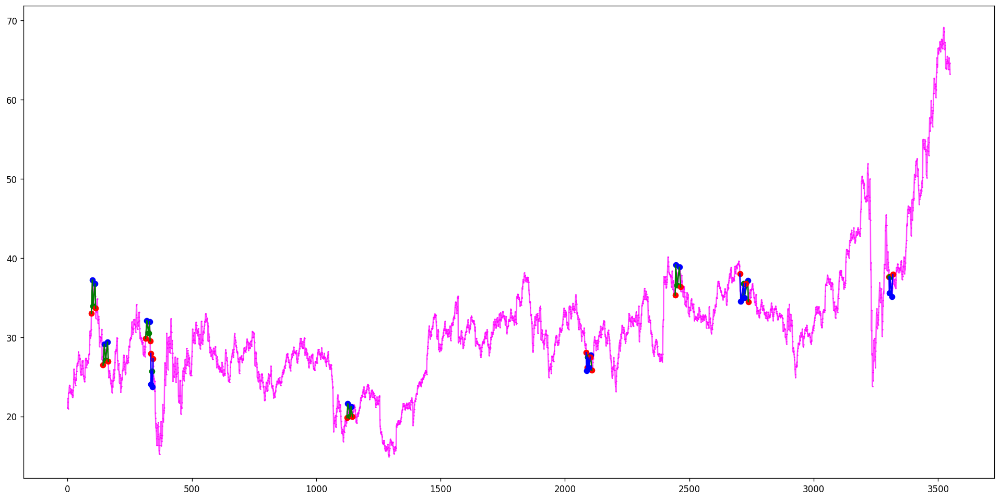

[(141, 144, 149, 154, 158), (797, 800, 805, 806, 811)]
[(27, 33, 40, 53, 54), (90, 92, 93, 105, 109), (302, 305, 307, 316, 324), (482, 492, 498, 501, 503), (509, 514, 515, 520, 525)]
Ticker ACMR found 2 double top patterns, 5 double bottom patterns


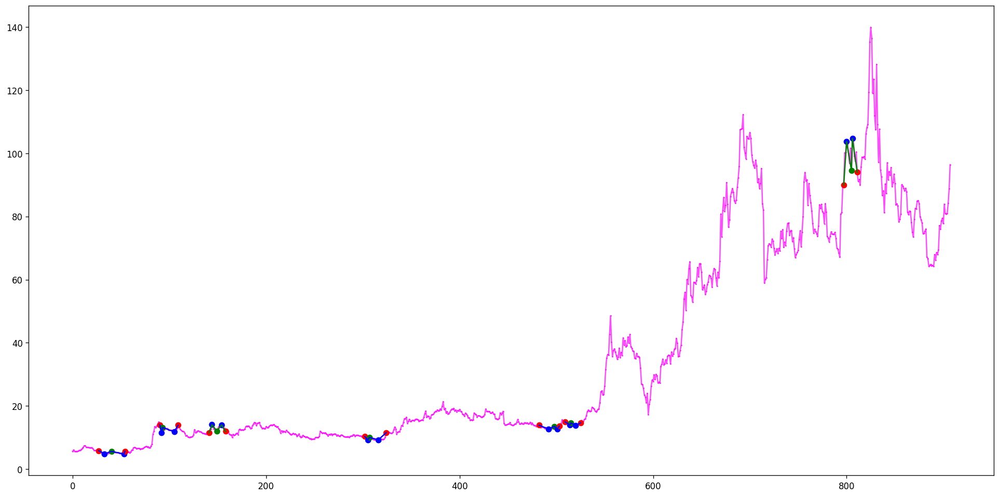

[(392, 394, 398, 399, 401), (392, 395, 398, 399, 401), (392, 394, 401, 406, 409), (392, 395, 401, 406, 409), (412, 418, 424, 425, 429), (495, 499, 500, 509, 512), (4167, 4176, 4179, 4192, 4194)]
[(190, 191, 192, 195, 198), (499, 500, 509, 512, 518), (1177, 1178, 1182, 1187, 1191), (1591, 1597, 1606, 1610, 1614), (1622, 1628, 1642, 1646, 1649)]
Ticker ACN found 7 double top patterns, 5 double bottom patterns


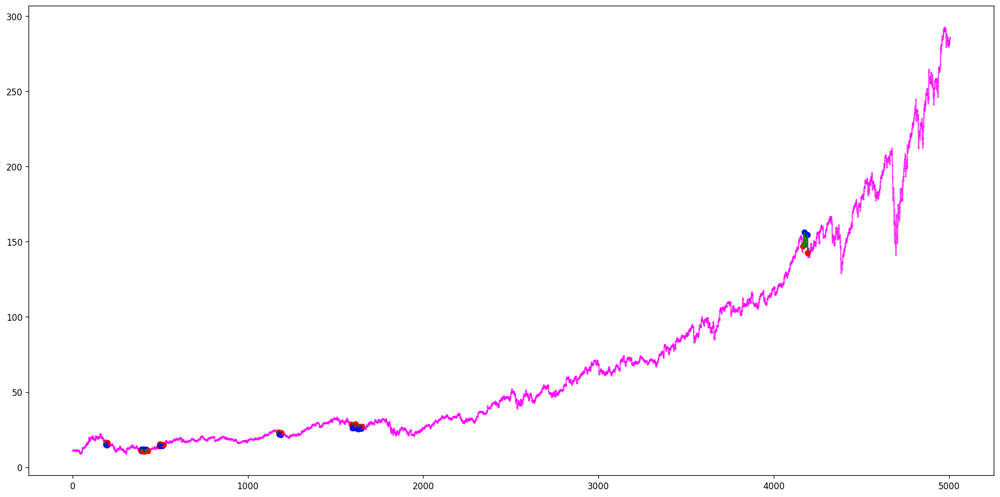

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1398, 1401, 1404, 1408, 1410), (1982, 1987, 1991, 1998, 2004), (2160, 2177, 2180, 2186, 2187), (2160, 2179, 2180, 2186, 2187), (2287, 2288, 2289, 2293, 2294), (2712, 2715, 2719, 2727, 2731), (2932, 2938, 2949, 2952, 2955), (2932, 2938, 2949, 2954, 2955), (3754, 3761, 3765, 3771, 3780), (3765, 3766, 3767, 3771, 3780), (3956, 3957, 3964, 3971, 3975), (3956, 3962, 3964, 3971, 3975), (5142, 5145, 5151, 5155, 5159)]
[(1401, 1404, 1408, 1424, 1429), (1820, 1824, 1828, 1846, 1848), (1820, 1824, 1828, 1847, 1848), (2005, 2010, 2013, 2024, 2029), (2208, 2209, 2214, 2221, 2226), (2208, 2209, 2214, 2222, 2226), (4124, 4130, 4142, 4146, 4147), (4709, 4725, 4727, 4733, 4737), (5141, 5142, 5145, 5151, 5155)]
Ticker ACNB found 13 double top patterns, 9 double bottom patterns


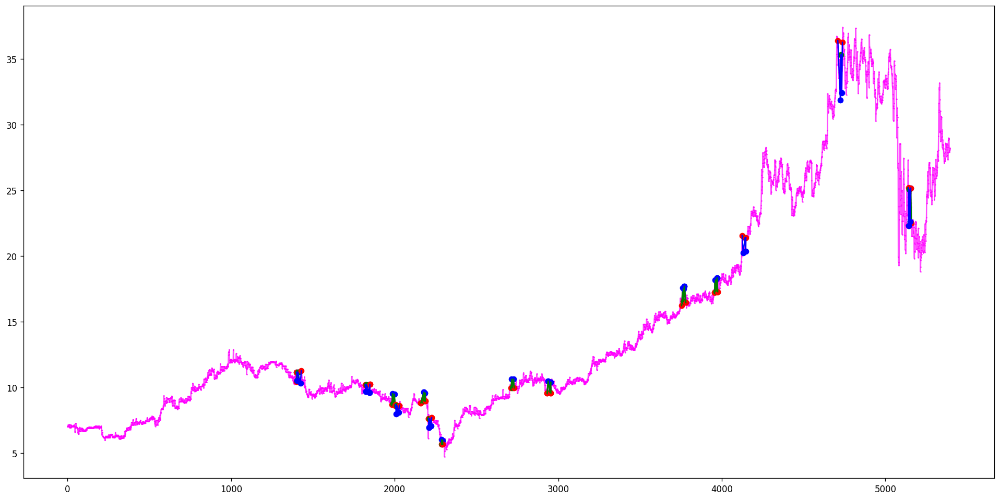

[(269, 272, 278, 282, 293)]
[(268, 269, 272, 278, 281)]
Ticker ACP found 1 double top patterns, 1 double bottom patterns


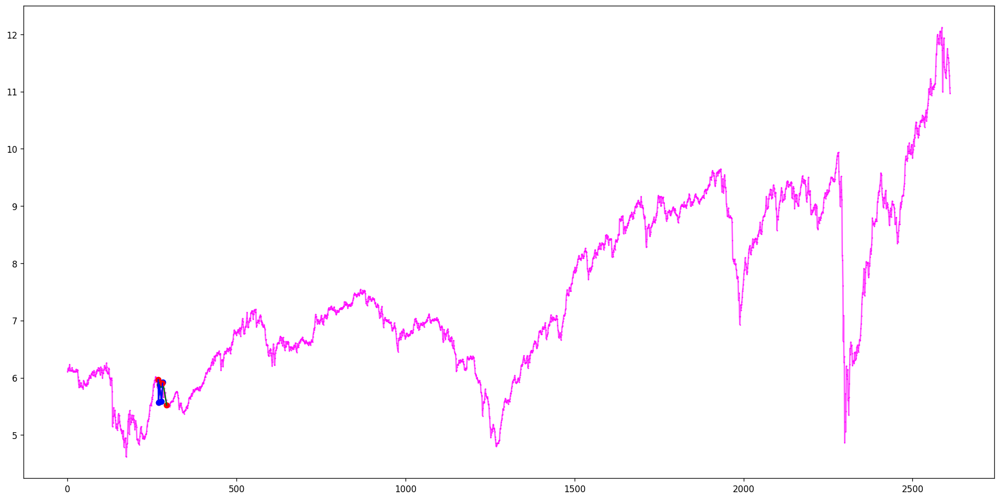

[(531, 534, 537, 544, 547), (800, 801, 804, 805, 806), (3812, 3816, 3825, 3830, 3840)]
[(406, 407, 408, 413, 415), (743, 745, 748, 754, 756), (743, 746, 748, 754, 756), (803, 804, 805, 809, 811), (805, 806, 811, 812, 814), (799, 800, 801, 804, 816), (799, 800, 801, 806, 816), (799, 800, 801, 809, 816), (820, 821, 824, 828, 833), (820, 821, 824, 831, 833), (988, 996, 1000, 1005, 1013), (1076, 1078, 1083, 1089, 1093), (1392, 1395, 1400, 1404, 1412), (2501, 2507, 2511, 2520, 2524), (3569, 3571, 3572, 3577, 3580), (3588, 3590, 3598, 3601, 3605), (3625, 3627, 3630, 3631, 3633), (3640, 3641, 3642, 3645, 3646), (3623, 3627, 3633, 3645, 3651), (3804, 3812, 3816, 3825, 3830)]
Ticker ACR found 3 double top patterns, 20 double bottom patterns


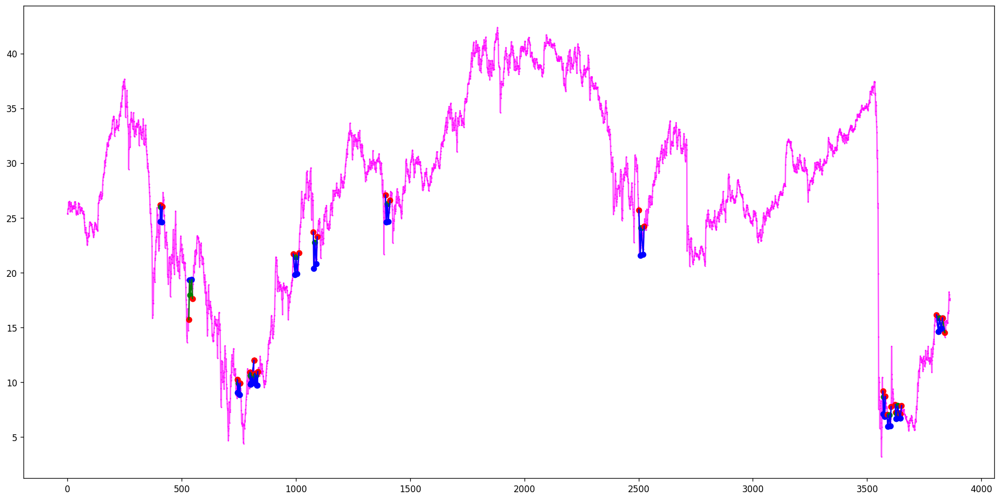

[(71, 75, 81, 93, 98)]
[]
Ticker ACRDF found 1 double top patterns, 0 double bottom patterns


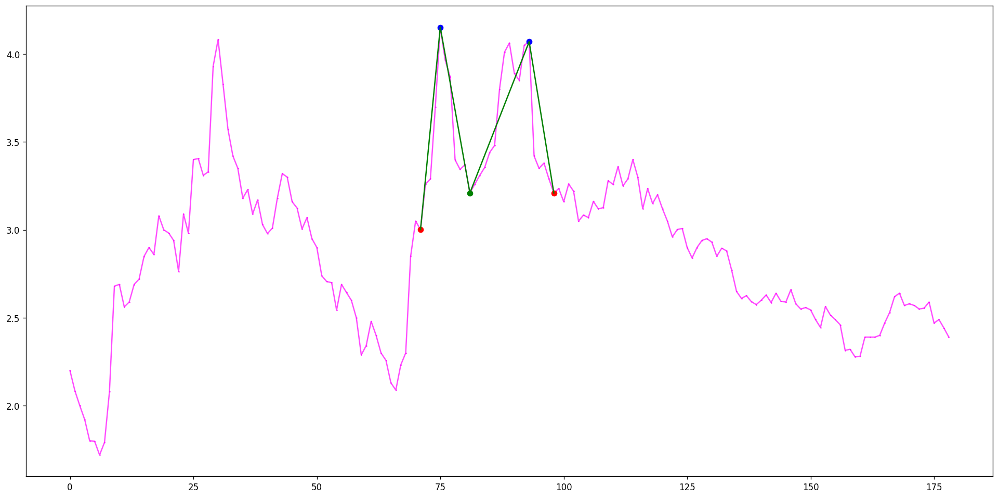

[(1998, 1999, 2010, 2013, 2023), (2043, 2051, 2052, 2056, 2060)]
[(839, 846, 853, 860, 866), (2175, 2178, 2181, 2186, 2198)]
Ticker ACRE found 2 double top patterns, 2 double bottom patterns


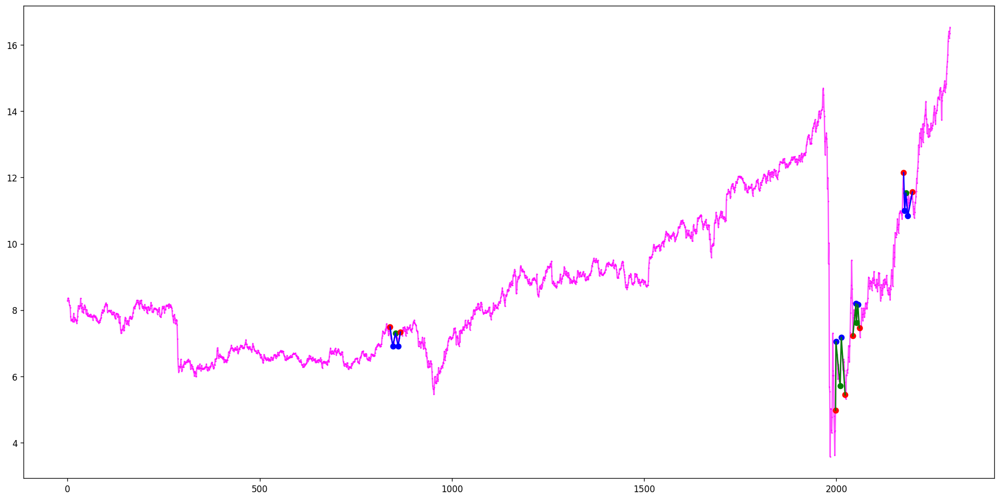

[]
[(156, 157, 160, 164, 166)]
Ticker ACRHF found 0 double top patterns, 1 double bottom patterns


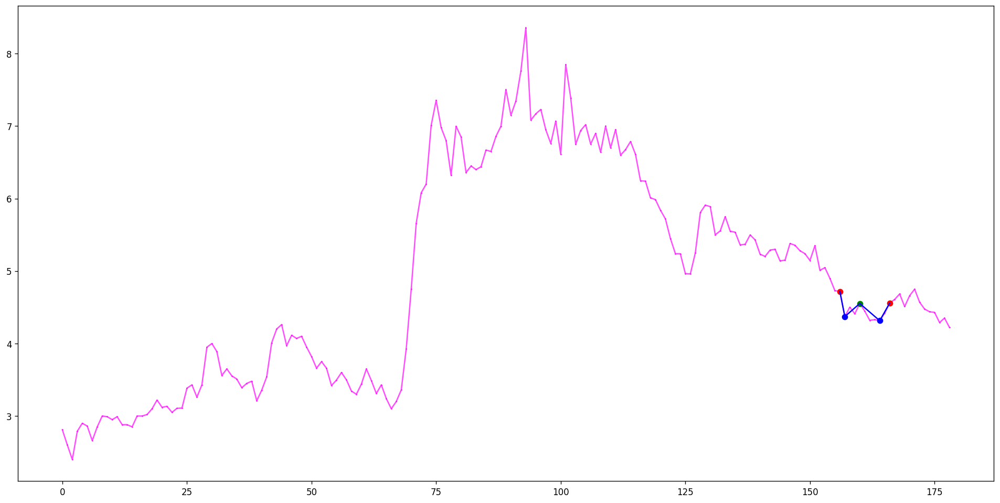

[(71, 73, 75, 79, 86), (728, 729, 731, 734, 751), (865, 867, 871, 881, 886), (1018, 1023, 1029, 1031, 1040)]
[(7, 8, 10, 16, 25), (526, 527, 530, 532, 539), (526, 527, 543, 545, 550), (847, 849, 850, 855, 856), (1060, 1061, 1064, 1068, 1073)]
Ticker ACRS found 4 double top patterns, 5 double bottom patterns


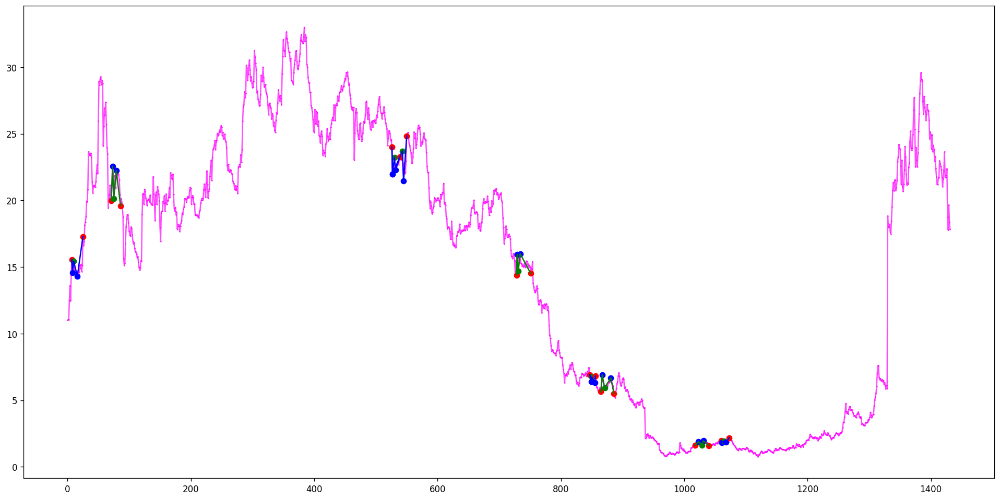

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(87, 96, 101, 105, 113), (267, 270, 281, 290, 293), (311, 312, 315, 316, 320), (311, 312, 315, 318, 320), (642, 647, 654, 656, 667), (766, 768, 771, 777, 789), (766, 768, 771, 778, 789), (838, 841, 846, 852, 860), (942, 944, 951, 954, 956), (1106, 1110, 1112, 1117, 1119), (1106, 1110, 1112, 1118, 1119), (1168, 1170, 1171, 1176, 1179), (1168, 1170, 1171, 1177, 1179), (1375, 1377, 1383, 1384, 1387), (1445, 1448, 1462, 1467, 1471), (1576, 1577, 1583, 1586, 1588), (1576, 1579, 1583, 1586, 1588), (1576, 1580, 1583, 1586, 1588), (1691, 1692, 1696, 1699, 1700), (1691, 1693, 1696, 1699, 1700), (1764, 1765, 1769, 1770, 1772), (1764, 1765, 1769, 1771, 1772), (2221, 2222, 2227, 2232, 2234), (2386, 2388, 2389, 2396, 2401), (2435, 2436, 2439, 2450, 2451), (2439, 2440, 2442, 2450, 2451), (2452, 2456, 2463, 2464, 2473), (2463, 2464, 2469, 2470, 2473)]
[(11, 15, 22, 24, 25), (86, 87, 96, 101, 105), (291, 293, 297, 301, 303), (325, 327, 328, 339, 345), (325, 327, 328, 341, 345), (489, 493, 494, 499, 5

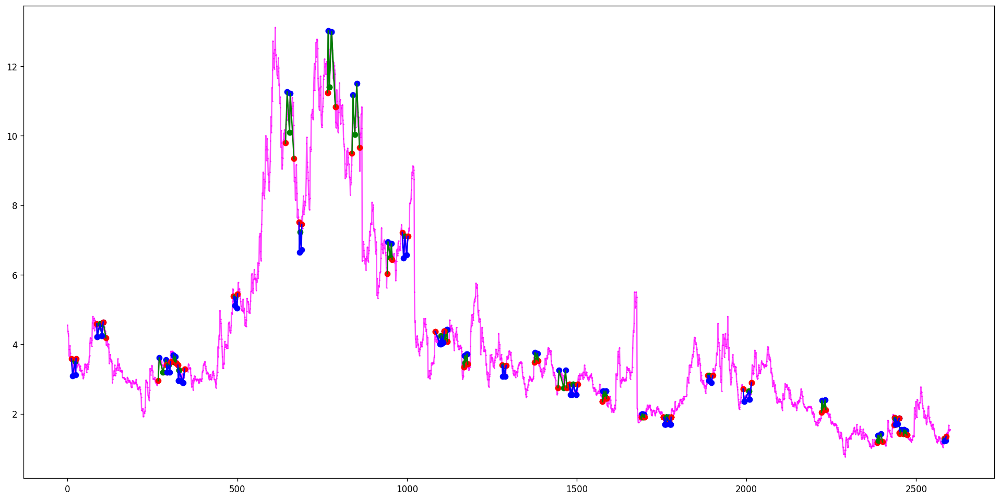

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(118, 121, 134, 143, 144), (242, 243, 244, 248, 251), (481, 482, 486, 487, 492), (481, 482, 486, 489, 492), (716, 718, 720, 734, 738), (720, 721, 728, 734, 738), (793, 795, 798, 800, 804), (799, 800, 804, 805, 807), (799, 800, 804, 806, 807), (845, 846, 848, 854, 856), (989, 990, 993, 995, 1000), (989, 990, 993, 997, 1000), (1053, 1057, 1061, 1062, 1065), (1053, 1058, 1061, 1062, 1065), (1089, 1090, 1095, 1097, 1099), (1118, 1124, 1130, 1132, 1134), (1114, 1115, 1118, 1124, 1136), (1114, 1115, 1118, 1132, 1136), (2092, 2093, 2099, 2104, 2108), (2133, 2137, 2144, 2147, 2150)]
[(235, 238, 243, 244, 248), (235, 239, 243, 244, 248), (258, 259, 272, 273, 275), (454, 461, 466, 469, 482), (627, 632, 638, 640, 647), (699, 700, 702, 708, 711), (846, 848, 854, 856, 861), (846, 848, 854, 858, 861), (846, 852, 854, 858, 861), (988, 989, 990, 993, 995), (1189, 1195, 1201, 1208, 1211), (1478, 1480, 1487, 1494, 1495), (1478, 1483, 1487, 1494, 1495), (1478, 1484, 1487, 1494, 1495), (1716, 1721, 1723,

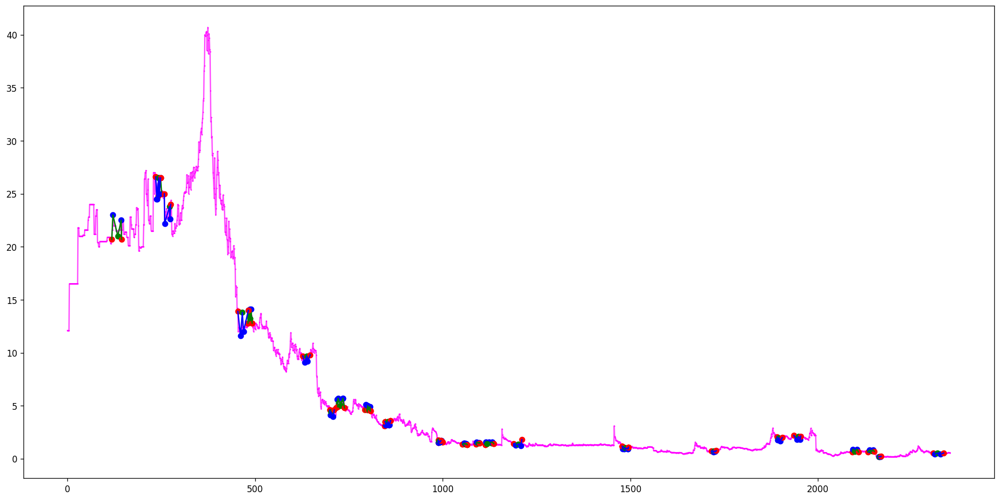

[]
[]
Ticker ACTC found 0 double top patterns, 0 double bottom patterns


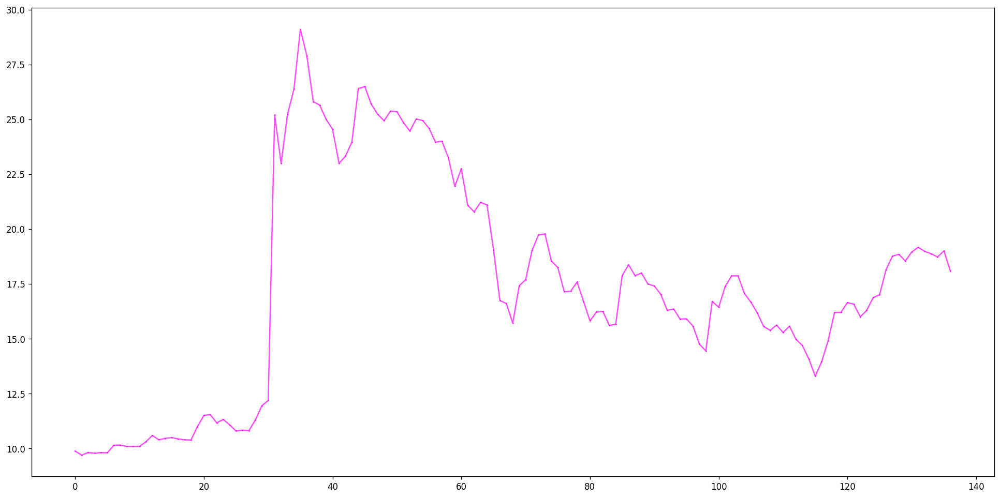

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(29, 31, 33, 37, 38), (40, 42, 47, 49, 50), (59, 62, 64, 73, 75), (584, 592, 595, 596, 601), (584, 592, 595, 597, 601), (701, 704, 711, 717, 723), (1068, 1071, 1076, 1082, 1090), (1208, 1216, 1222, 1224, 1232), (1322, 1331, 1339, 1347, 1350), (1544, 1546, 1548, 1554, 1556), (1860, 1864, 1869, 1878, 1880), (1885, 1890, 1893, 1895, 1896), (1976, 1978, 1983, 1986, 1994), (2287, 2288, 2293, 2300, 2308), (2471, 2474, 2481, 2486, 2492), (2583, 2586, 2589, 2597, 2598), (2627, 2632, 2633, 2637, 2645), (2773, 2778, 2785, 2793, 2801), (2840, 2847, 2854, 2855, 2865), (3507, 3509, 3515, 3521, 3530), (3507, 3511, 3515, 3521, 3530), (3517, 3521, 3523, 3528, 3530), (3584, 3586, 3590, 3597, 3606), (3936, 3938, 3943, 3948, 3958)]
[(81, 82, 85, 92, 97), (485, 490, 496, 500, 502), (561, 572, 582, 584, 585), (1042, 1048, 1051, 1058, 1068), (1114, 1116, 1122, 1128, 1131), (1159, 1167, 1168, 1173, 1183), (1387, 1389, 1391, 1394, 1400), (1784, 1787, 1791, 1798, 1803), (1912, 1917, 1924, 1934, 1935), (2074, 

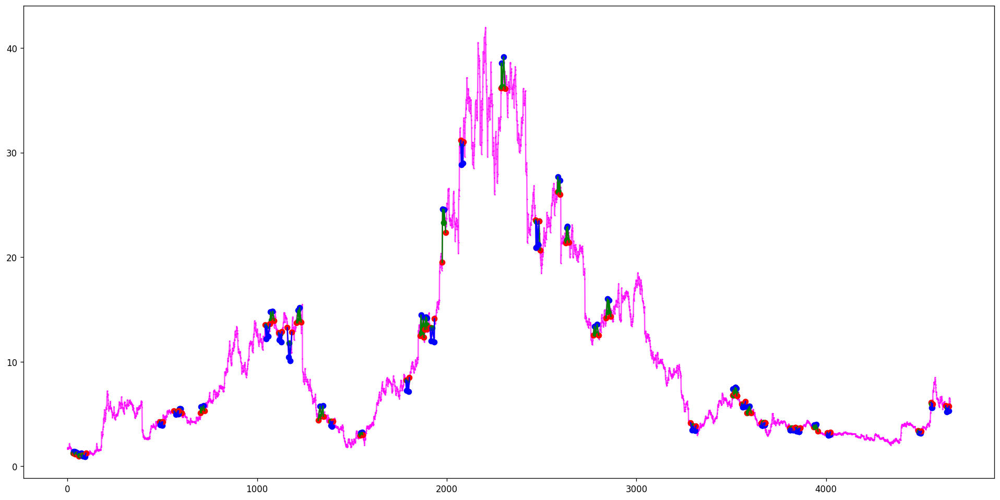

[]
[(1332, 1334, 1340, 1346, 1354), (1455, 1458, 1463, 1471, 1480)]
Ticker ACV found 0 double top patterns, 2 double bottom patterns


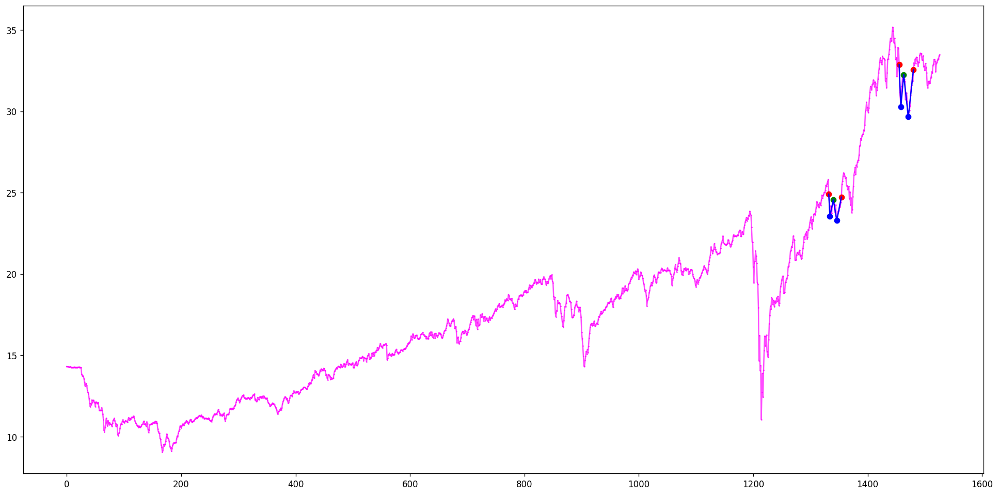

[(178, 183, 188, 196, 201), (2667, 2674, 2683, 2691, 2694)]
[(305, 311, 318, 322, 327), (540, 545, 549, 552, 558)]
Ticker ACWI found 2 double top patterns, 2 double bottom patterns


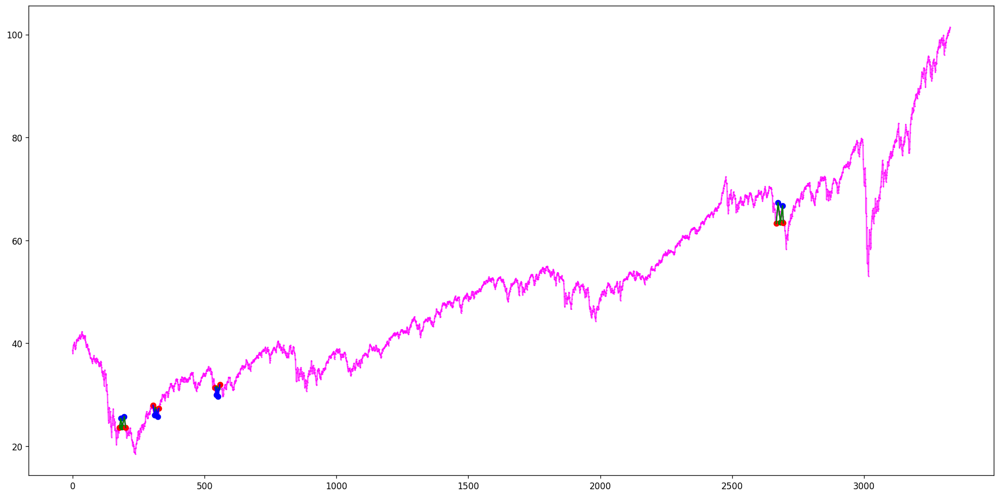

[]
[]
Ticker ACWV found 0 double top patterns, 0 double bottom patterns


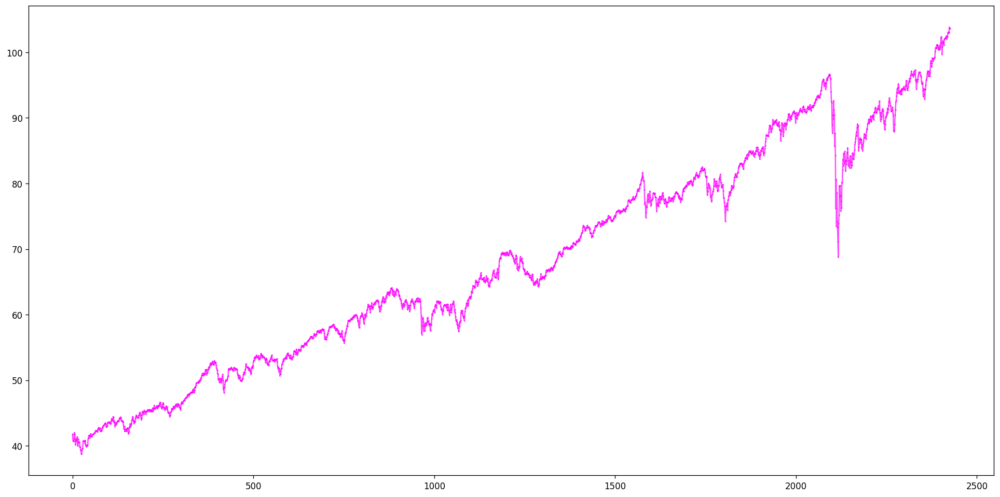

[(176, 181, 186, 194, 199), (206, 209, 212, 217, 222), (816, 821, 831, 835, 842), (848, 851, 855, 863, 869), (1863, 1866, 1872, 1880, 1884), (2665, 2672, 2681, 2689, 2692)]
[(303, 309, 316, 320, 325), (536, 543, 544, 550, 556), (876, 878, 881, 885, 890)]
Ticker ACWX found 6 double top patterns, 3 double bottom patterns


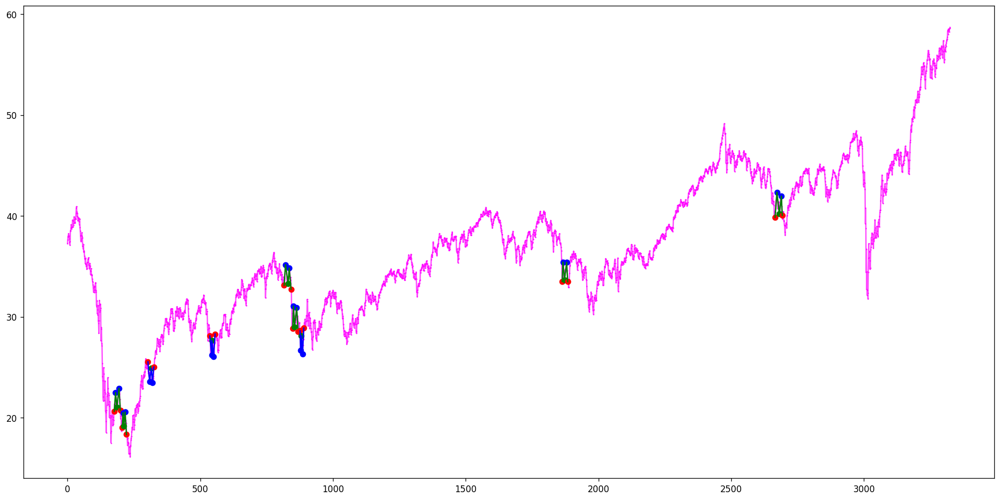

[(140, 144, 147, 149, 155), (958, 962, 970, 979, 985), (958, 963, 970, 979, 985)]
[(160, 165, 172, 173, 179)]
Ticker ACXIF found 3 double top patterns, 1 double bottom patterns


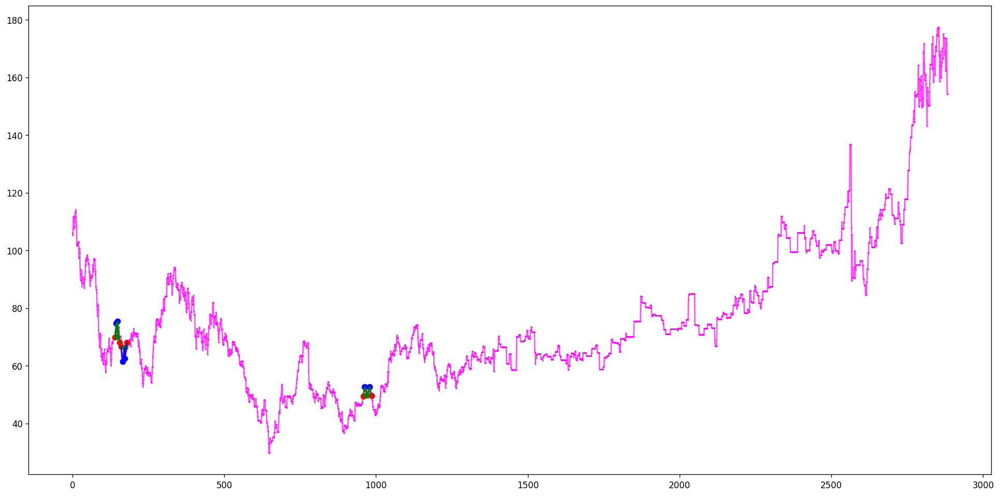

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(618, 621, 631, 632, 638), (618, 622, 631, 632, 638), (861, 862, 866, 870, 877), (2206, 2208, 2209, 2228, 2234), (2284, 2285, 2289, 2291, 2292), (2459, 2467, 2474, 2478, 2482), (2581, 2584, 2586, 2596, 2599), (2581, 2584, 2586, 2597, 2599), (3623, 3629, 3632, 3639, 3642), (3682, 3684, 3687, 3690, 3695), (3831, 3833, 3836, 3838, 3846), (3836, 3838, 3842, 3844, 3846), (3901, 3903, 3905, 3913, 3927), (4011, 4013, 4018, 4029, 4035), (4208, 4221, 4225, 4226, 4227), (4208, 4222, 4225, 4226, 4227), (4526, 4533, 4536, 4545, 4552), (5008, 5009, 5010, 5013, 5015), (5299, 5301, 5306, 5317, 5325)]
[(597, 598, 599, 606, 608), (610, 611, 612, 618, 632), (610, 611, 612, 631, 632), (972, 975, 978, 989, 994), (1065, 1066, 1074, 1075, 1076), (1932, 1936, 1939, 1943, 1954), (2188, 2190, 2193, 2197, 2199), (2325, 2326, 2331, 2344, 2349), (3118, 3125, 3134, 3135, 3144), (3609, 3613, 3618, 3622, 3629), (3690, 3701, 3713, 3714, 3715), (3904, 3905, 3913, 3927, 3928), (3973, 3977, 3992, 3993, 3998), (3973, 39

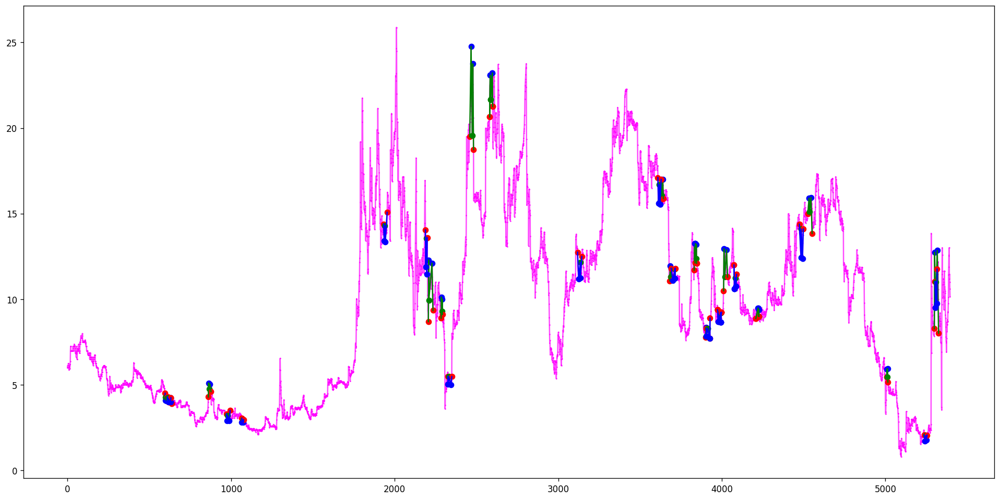

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(424, 427, 437, 441, 447), (424, 427, 437, 443, 447), (590, 591, 601, 609, 614), (601, 602, 604, 609, 614), (638, 645, 648, 649, 652), (1024, 1030, 1037, 1042, 1052), (1469, 1479, 1484, 1488, 1497), (1517, 1519, 1524, 1526, 1528)]
[(75, 76, 80, 81, 90), (134, 138, 148, 157, 161), (211, 218, 221, 226, 229), (528, 535, 538, 544, 550), (727, 729, 730, 735, 738), (838, 842, 845, 848, 849), (965, 966, 968, 976, 980)]
Ticker ADAP found 8 double top patterns, 7 double bottom patterns


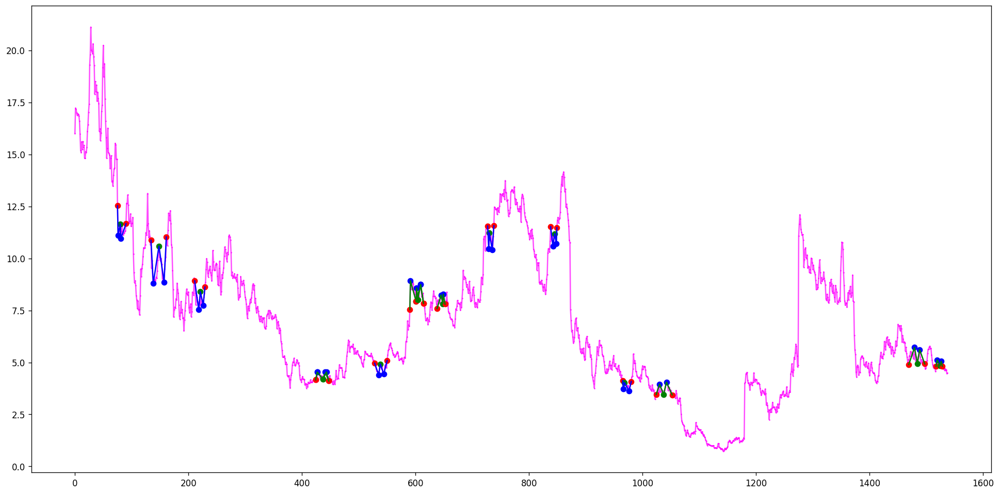

[(568, 571, 577, 582, 585), (675, 676, 682, 690, 694), (988, 991, 992, 998, 1009), (1239, 1243, 1246, 1252, 1257), (2793, 2800, 2802, 2811, 2816), (3125, 3135, 3139, 3146, 3148), (4700, 4705, 4710, 4716, 4721)]
[(82, 89, 93, 101, 105), (142, 144, 150, 153, 158), (251, 252, 253, 258, 264), (352, 355, 360, 365, 369), (384, 386, 389, 392, 393), (486, 488, 491, 493, 501), (486, 488, 491, 496, 501), (511, 513, 515, 520, 521), (560, 568, 571, 577, 582), (664, 670, 676, 682, 690), (732, 736, 742, 751, 754), (1768, 1772, 1773, 1785, 1790), (2230, 2235, 2239, 2244, 2248), (2273, 2274, 2275, 2282, 2287), (2417, 2419, 2423, 2431, 2436), (2608, 2614, 2618, 2623, 2629), (2734, 2744, 2748, 2755, 2759), (3146, 3151, 3156, 3159, 3162), (4670, 4672, 4683, 4686, 4690), (5080, 5081, 5089, 5095, 5101), (5162, 5166, 5168, 5172, 5181)]
Ticker ADBE found 7 double top patterns, 21 double bottom patterns


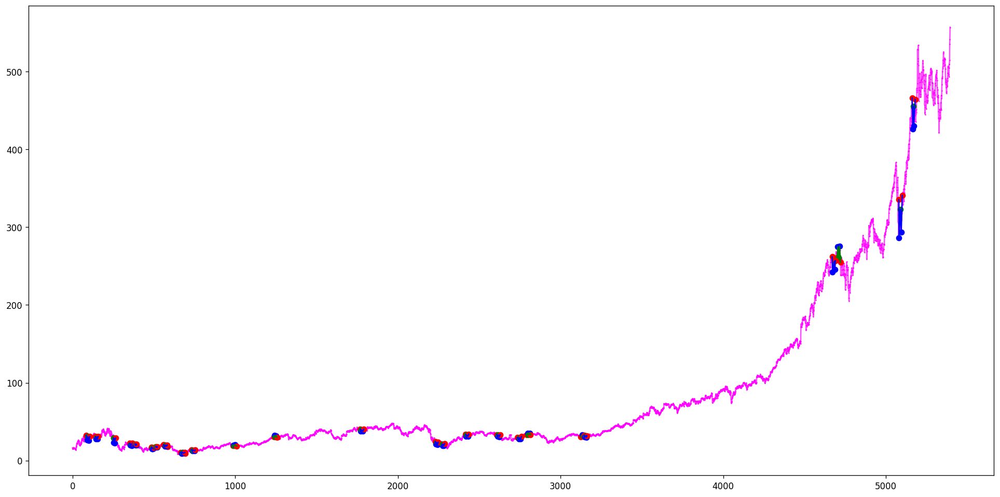

[(1713, 1716, 1718, 1732, 1739), (2023, 2031, 2036, 2039, 2049), (2161, 2166, 2171, 2176, 2179), (2256, 2259, 2260, 2265, 2267), (2282, 2284, 2289, 2292, 2294), (2274, 2278, 2282, 2292, 2295), (5095, 5099, 5103, 5112, 5122)]
[(1449, 1452, 1454, 1463, 1474), (1874, 1879, 1884, 1888, 1895), (1968, 1971, 1972, 1975, 1977), (2230, 2235, 2240, 2241, 2243), (2278, 2282, 2284, 2289, 2292), (2300, 2305, 2308, 2309, 2311), (2346, 2349, 2356, 2360, 2364), (5158, 5163, 5167, 5172, 5174)]
Ticker ADC found 7 double top patterns, 8 double bottom patterns


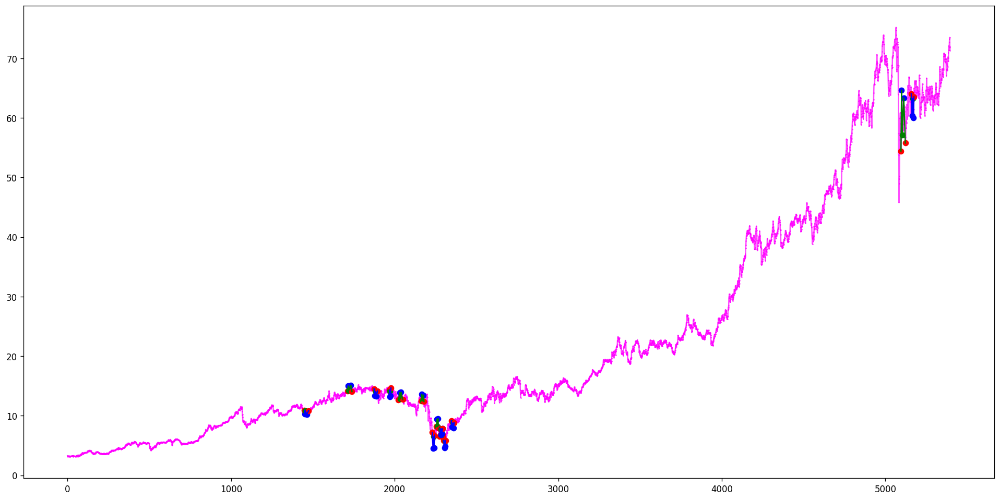

[]
[]
Ticker ADCT found 0 double top patterns, 0 double bottom patterns


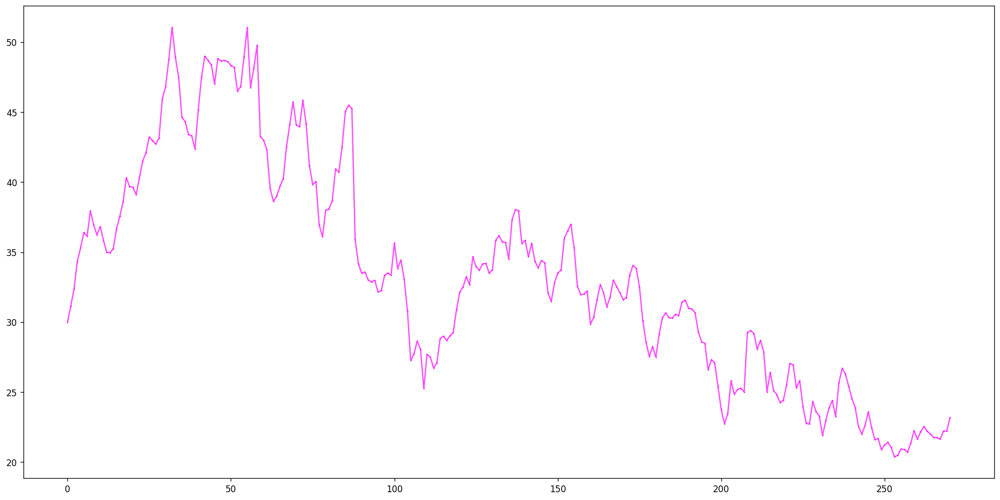

[(361, 370, 371, 377, 378), (751, 765, 766, 775, 778)]
[(408, 410, 417, 432, 436), (2614, 2616, 2618, 2627, 2631)]
Ticker ADDDF found 2 double top patterns, 2 double bottom patterns


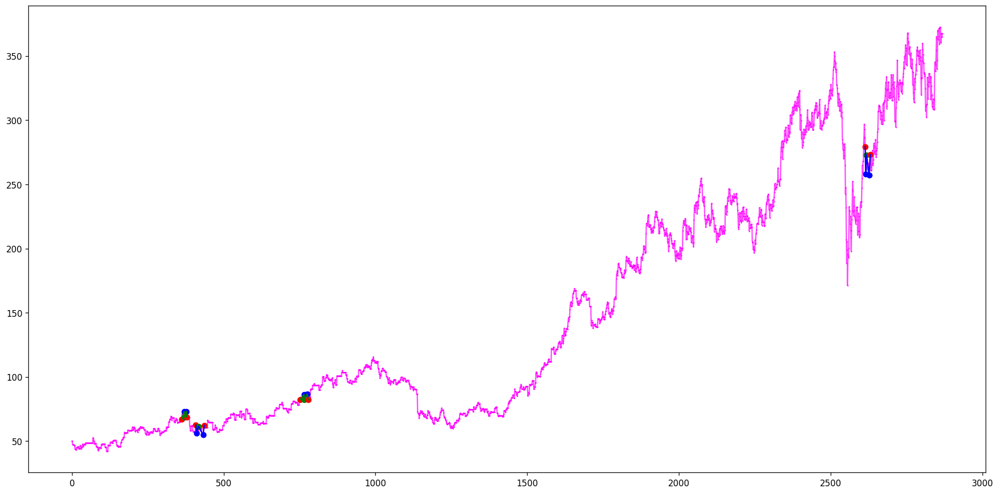

[(667, 670, 672, 678, 683), (760, 763, 770, 777, 780), (1180, 1186, 1193, 1198, 1206), (1278, 1283, 1288, 1291, 1293), (2391, 2397, 2401, 2412, 2416)]
[(461, 469, 472, 484, 486), (999, 1004, 1009, 1010, 1014), (1472, 1476, 1481, 1485, 1489), (3531, 3532, 3540, 3543, 3547)]
Ticker ADDYY found 5 double top patterns, 4 double bottom patterns


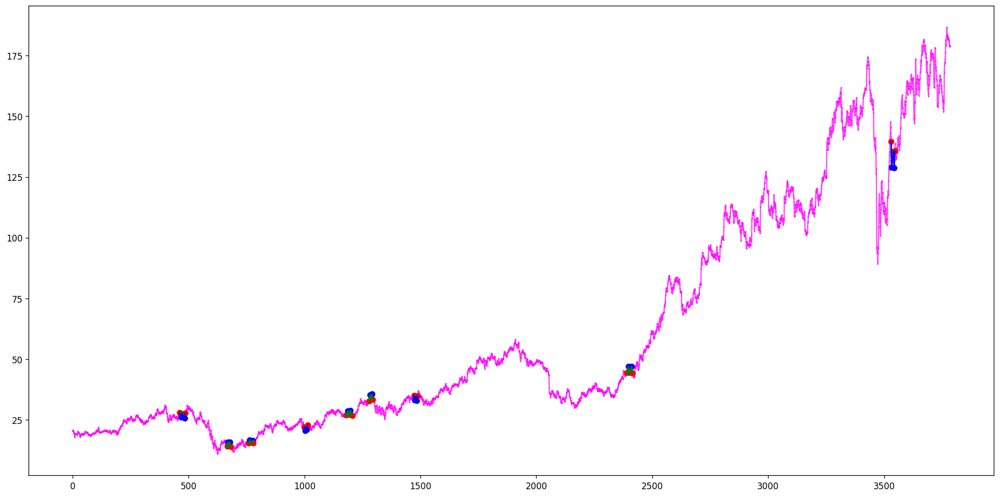

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(50, 52, 60, 66, 77), (61, 66, 77, 81, 82), (122, 128, 135, 145, 147), (703, 705, 707, 711, 728), (1059, 1067, 1070, 1074, 1079), (1137, 1138, 1142, 1144, 1159), (1489, 1490, 1494, 1504, 1513), (1819, 1820, 1821, 1825, 1828), (2096, 2099, 2107, 2117, 2124), (2215, 2217, 2219, 2227, 2231), (2531, 2534, 2540, 2544, 2551), (2711, 2721, 2724, 2730, 2733), (3080, 3082, 3084, 3095, 3097), (3176, 3177, 3185, 3189, 3194), (3883, 3889, 3897, 3901, 3909), (3986, 3987, 3988, 4000, 4010)]
[(133, 135, 145, 147, 149), (260, 264, 271, 273, 280), (887, 889, 892, 905, 911), (977, 984, 986, 990, 992), (1037, 1038, 1039, 1045, 1049), (1037, 1045, 1049, 1050, 1057), (1123, 1136, 1138, 1142, 1144), (1158, 1159, 1163, 1165, 1166), (1231, 1232, 1235, 1239, 1245), (1231, 1232, 1235, 1240, 1245), (1385, 1390, 1394, 1398, 1406), (1451, 1452, 1454, 1462, 1469), (1519, 1521, 1525, 1527, 1534), (1602, 1611, 1613, 1622, 1623), (1659, 1663, 1668, 1683, 1686), (1787, 1789, 1792, 1795, 1797), (2125, 2132, 2135, 2140,

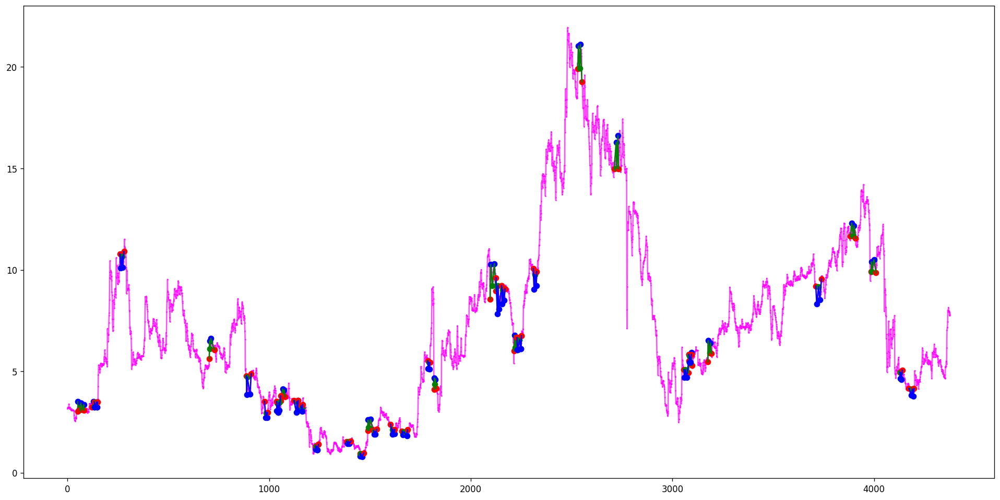

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(832, 833, 835, 837, 838), (882, 884, 889, 892, 893), (882, 885, 889, 892, 893), (882, 884, 889, 907, 909), (882, 885, 889, 907, 909), (891, 892, 893, 907, 909), (891, 892, 893, 913, 915), (899, 907, 909, 913, 915), (925, 926, 928, 931, 932), (935, 936, 938, 942, 943), (935, 936, 938, 944, 946), (935, 936, 938, 945, 946), (935, 937, 938, 944, 946), (935, 937, 938, 945, 946), (938, 939, 943, 945, 946), (946, 947, 948, 952, 953), (946, 947, 948, 954, 955), (994, 995, 996, 1002, 1003), (994, 995, 996, 1004, 1005), (1035, 1036, 1042, 1045, 1046), (1103, 1104, 1108, 1114, 1116), (1103, 1104, 1108, 1115, 1116), (1103, 1107, 1108, 1115, 1116), (1208, 1212, 1217, 1219, 1223), (1208, 1212, 1217, 1220, 1223), (1241, 1243, 1245, 1248, 1252), (1258, 1261, 1262, 1267, 1268), (1263, 1265, 1268, 1270, 1271), (1344, 1345, 1348, 1350, 1351), (1406, 1407, 1409, 1421, 1422), (1456, 1457, 1459, 1473, 1474), (1492, 1495, 1500, 1502, 1504), (1492, 1497, 1500, 1502, 1504), (1523, 1524, 1526, 1531, 1534), (1

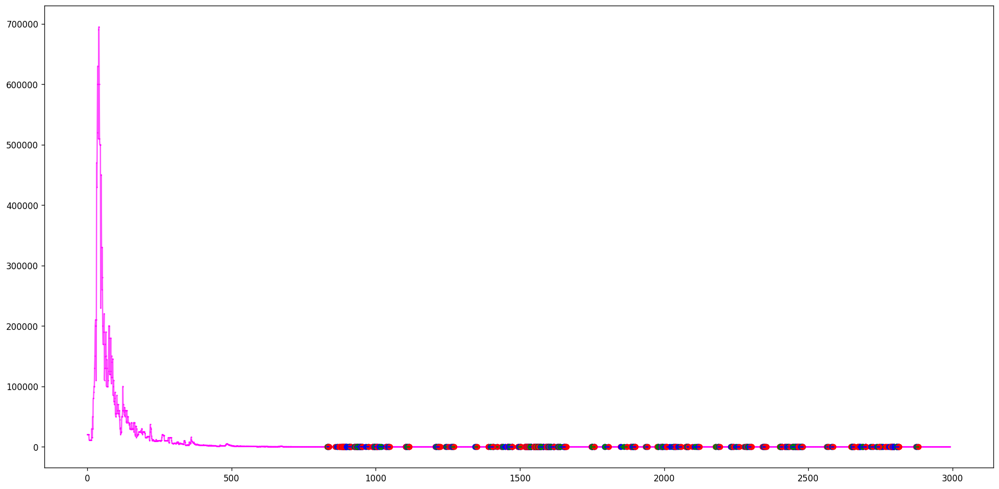

[(220, 221, 226, 227, 228), (219, 221, 233, 238, 246), (291, 295, 306, 308, 312), (397, 398, 403, 407, 412), (437, 444, 449, 455, 457), (480, 483, 488, 491, 493), (1029, 1035, 1038, 1043, 1049), (2094, 2105, 2107, 2117, 2121)]
[(194, 197, 198, 201, 202), (239, 246, 249, 257, 262), (297, 299, 302, 306, 308), (378, 382, 384, 388, 394), (401, 403, 407, 412, 415), (426, 430, 432, 436, 438), (445, 449, 455, 457, 462), (509, 513, 517, 518, 520), (806, 812, 817, 821, 824), (1152, 1158, 1164, 1174, 1177), (1633, 1637, 1644, 1646, 1651), (2375, 2381, 2387, 2391, 2396), (2598, 2601, 2604, 2608, 2615), (2665, 2669, 2672, 2681, 2693), (2675, 2681, 2684, 2688, 2693), (4580, 4584, 4585, 4594, 4599), (5082, 5083, 5088, 5093, 5096)]
Ticker ADI found 8 double top patterns, 17 double bottom patterns


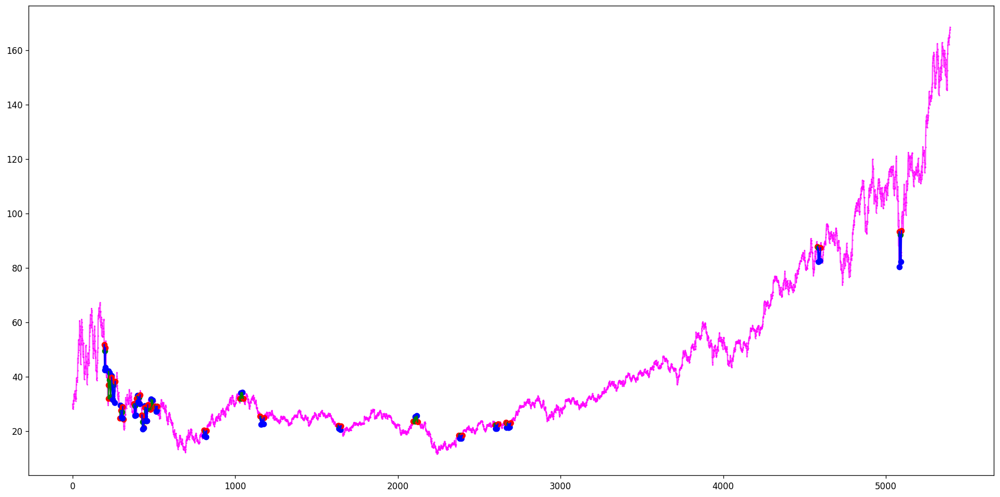

[(264, 271, 274, 285, 287), (274, 277, 280, 285, 287), (319, 320, 321, 325, 329), (347, 349, 350, 358, 371), (503, 505, 506, 510, 514), (563, 564, 576, 579, 582), (636, 642, 646, 648, 649)]
[(71, 77, 84, 86, 87), (271, 274, 277, 280, 285), (286, 291, 298, 304, 307), (286, 291, 298, 306, 307), (331, 332, 333, 342, 344), (474, 480, 481, 486, 488), (529, 533, 536, 544, 546), (529, 533, 536, 545, 546), (559, 563, 564, 576, 579), (564, 568, 575, 576, 579), (682, 686, 695, 703, 704)]
Ticker ADIL found 7 double top patterns, 11 double bottom patterns


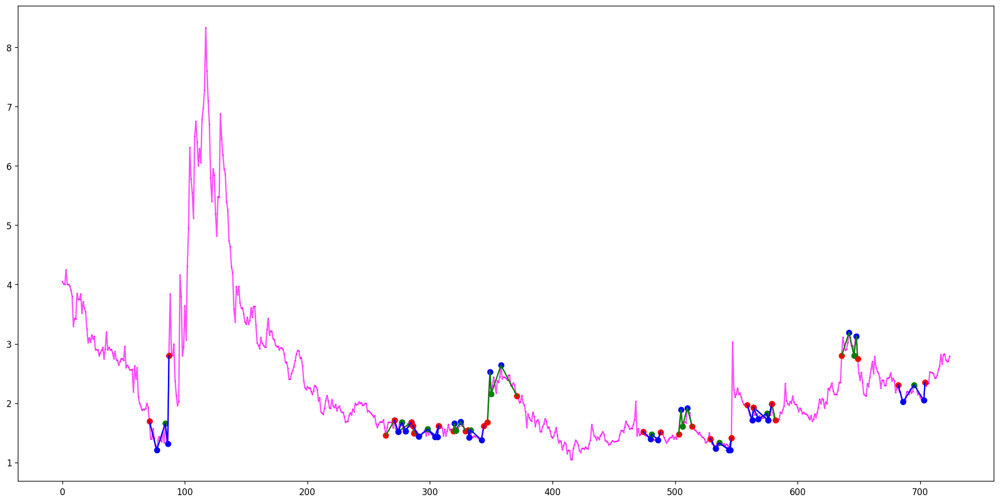

[(247, 251, 255, 262, 264), (1292, 1298, 1310, 1317, 1320), (1778, 1779, 1785, 1790, 1800), (2307, 2317, 2322, 2326, 2328), (5095, 5099, 5102, 5104, 5106), (5095, 5099, 5106, 5112, 5115)]
[(251, 255, 262, 264, 271), (635, 637, 643, 649, 653), (2335, 2339, 2346, 2347, 2350), (2975, 2977, 2982, 2993, 2997), (4044, 4045, 4047, 4052, 4061)]
Ticker ADM found 6 double top patterns, 5 double bottom patterns


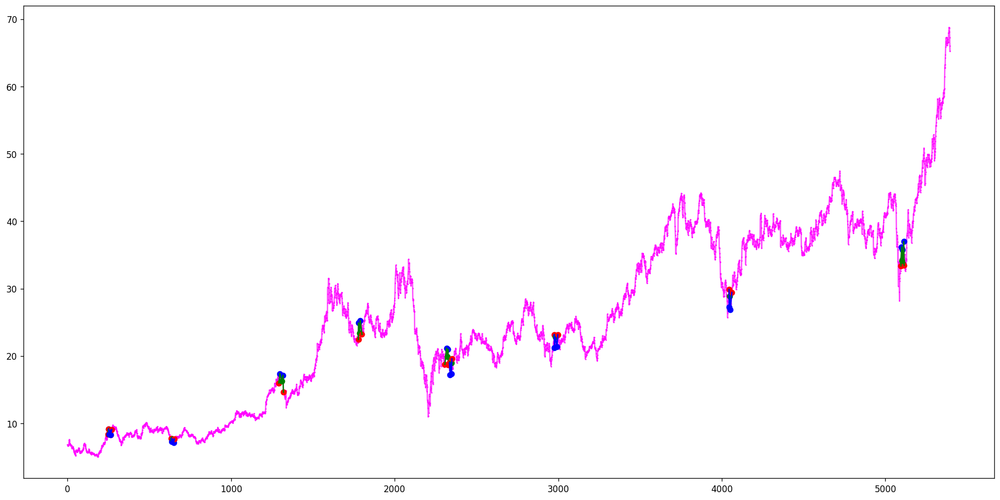

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(262, 266, 277, 279, 284), (357, 359, 362, 364, 371), (448, 450, 457, 461, 472), (854, 859, 862, 865, 875), (1149, 1154, 1160, 1162, 1164), (1313, 1315, 1319, 1323, 1324), (1340, 1345, 1356, 1361, 1364), (1421, 1422, 1431, 1433, 1437), (1482, 1484, 1486, 1491, 1493), (1625, 1627, 1637, 1648, 1649), (1639, 1641, 1642, 1648, 1649), (1797, 1799, 1801, 1807, 1812)]
[(55, 56, 58, 61, 63), (129, 132, 133, 141, 146), (129, 132, 133, 142, 146), (283, 286, 294, 296, 297), (398, 400, 404, 409, 424), (712, 720, 728, 731, 734), (806, 808, 813, 819, 821), (843, 847, 849, 854, 857), (1044, 1048, 1050, 1053, 1055), (1129, 1132, 1135, 1143, 1150), (1416, 1421, 1422, 1431, 1433), (1416, 1421, 1433, 1437, 1439), (1899, 1900, 1901, 1905, 1908), (1898, 1905, 1908, 1913, 1922)]
Ticker ADMA found 12 double top patterns, 14 double bottom patterns


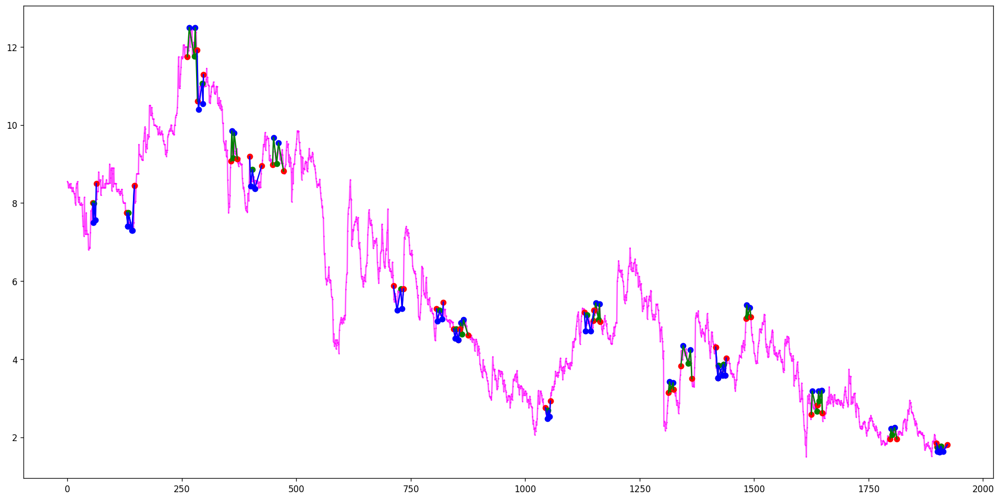

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(204, 208, 217, 220, 222), (231, 233, 237, 238, 241), (361, 364, 372, 373, 378), (410, 412, 413, 418, 426), (459, 461, 465, 466, 472), (587, 589, 601, 606, 609), (1201, 1206, 1213, 1221, 1228), (1760, 1761, 1763, 1765, 1766), (1811, 1812, 1813, 1821, 1823), (1811, 1812, 1813, 1822, 1823), (1859, 1860, 1861, 1864, 1865), (1845, 1846, 1847, 1869, 1870), (1865, 1869, 1870, 1878, 1879), (1880, 1881, 1884, 1892, 1893), (1880, 1881, 1884, 1906, 1907), (1880, 1883, 1884, 1906, 1907), (1884, 1885, 1893, 1906, 1907), (1998, 1999, 2003, 2005, 2006), (1998, 1999, 2003, 2008, 2011), (1998, 1999, 2003, 2010, 2011), (1998, 2002, 2003, 2008, 2011), (1998, 2002, 2003, 2010, 2011), (2004, 2005, 2006, 2010, 2011), (1998, 1999, 2003, 2014, 2015), (1998, 2002, 2003, 2014, 2015), (2004, 2005, 2006, 2014, 2015), (2007, 2008, 2011, 2014, 2015), (2066, 2067, 2078, 2080, 2081), (2180, 2181, 2186, 2189, 2190), (2222, 2226, 2227, 2230, 2233), (2269, 2270, 2273, 2286, 2287), (2291, 2292, 2294, 2304, 2305), (2289

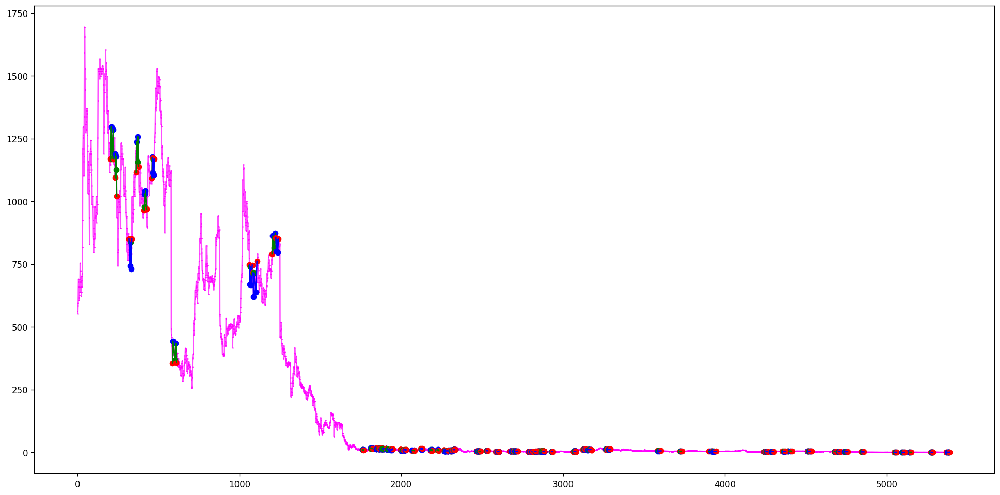

[(528, 531, 532, 536, 537), (750, 754, 765, 770, 774), (939, 941, 944, 949, 952), (938, 949, 953, 956, 957), (974, 976, 979, 983, 987)]
[(856, 859, 865, 871, 875)]
Ticker ADNT found 5 double top patterns, 1 double bottom patterns


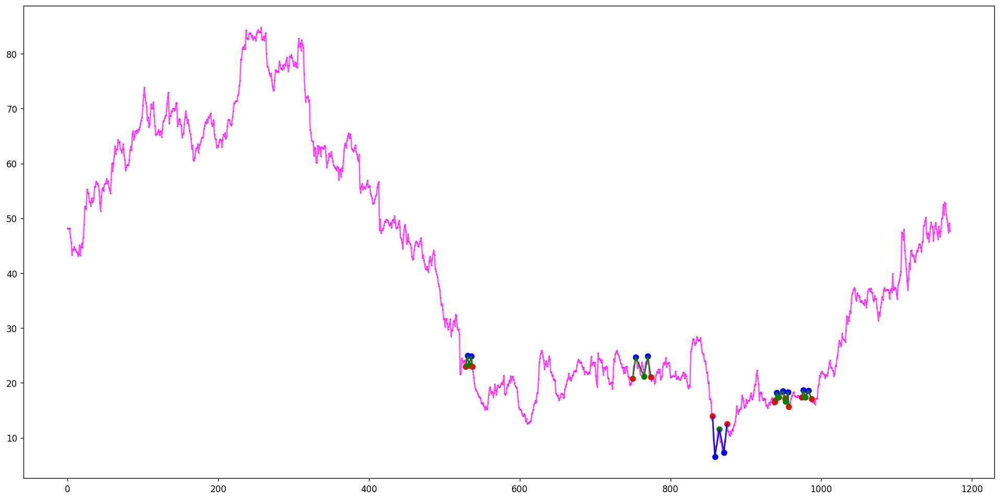

[(344, 348, 355, 358, 364), (540, 545, 556, 559, 562), (708, 712, 717, 725, 735), (2222, 2223, 2229, 2230, 2235), (4737, 4743, 4752, 4757, 4763)]
[(54, 61, 66, 72, 77), (82, 88, 93, 96, 98), (677, 683, 688, 692, 696), (855, 864, 867, 874, 879), (2240, 2244, 2247, 2254, 2261)]
Ticker ADP found 5 double top patterns, 5 double bottom patterns


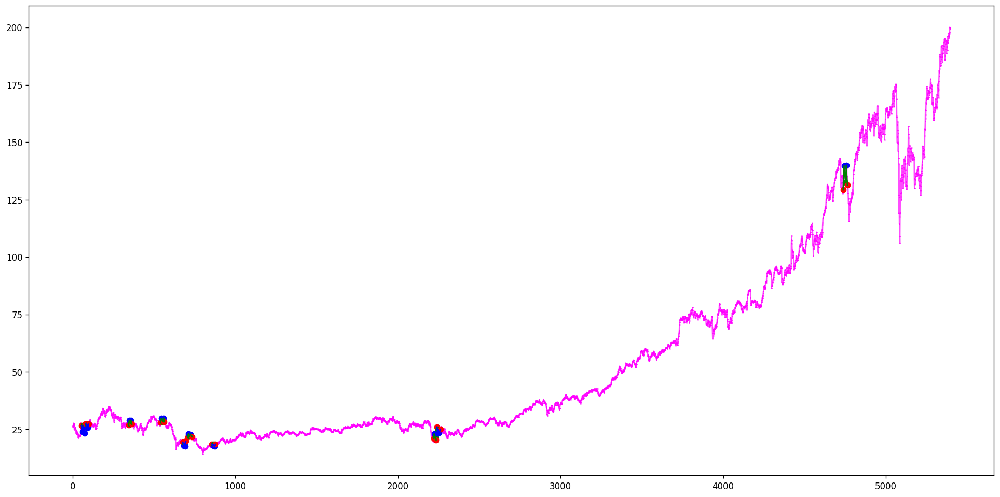

[(115, 117, 120, 123, 127), (314, 327, 334, 339, 340), (477, 483, 487, 489, 490)]
[(90, 93, 100, 110, 116), (267, 271, 278, 283, 287)]
Ticker ADPT found 3 double top patterns, 2 double bottom patterns


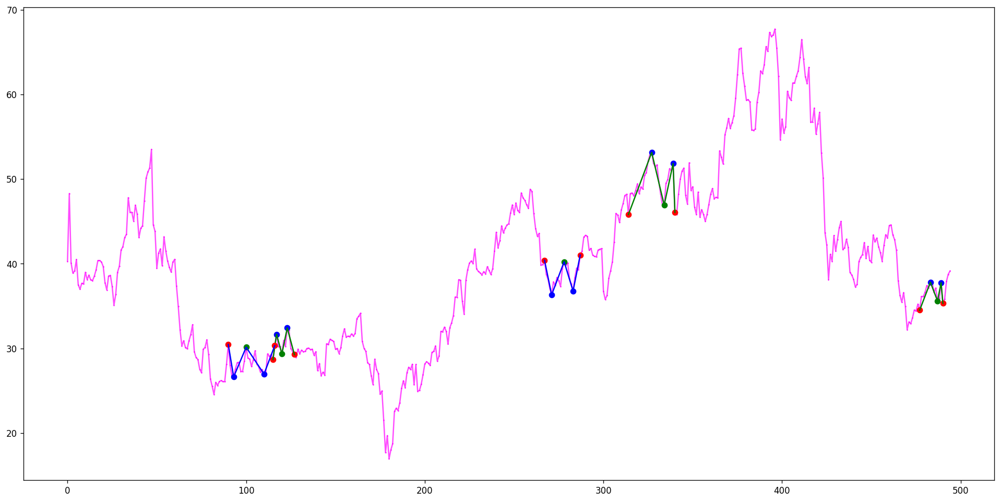

[(2217, 2223, 2225, 2231, 2234), (2251, 2253, 2256, 2263, 2265), (2644, 2648, 2657, 2666, 2669)]
[(445, 449, 464, 466, 471), (703, 708, 713, 723, 730), (733, 740, 741, 744, 752), (810, 812, 818, 822, 829), (990, 992, 1003, 1007, 1009), (1166, 1169, 1177, 1188, 1193), (2204, 2206, 2210, 2214, 2216), (2292, 2297, 2301, 2305, 2310), (2320, 2322, 2325, 2336, 2340), (2598, 2601, 2602, 2614, 2618)]
Ticker ADRNY found 3 double top patterns, 10 double bottom patterns


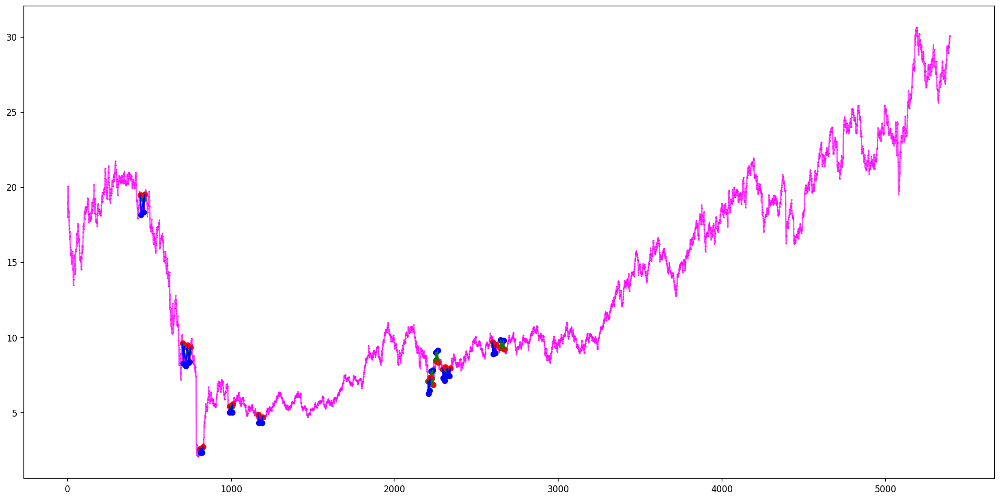

[(190, 194, 198, 204, 207), (516, 521, 524, 527, 537), (1888, 1889, 1894, 1899, 1902), (3984, 3988, 3991, 3998, 4001), (4826, 4836, 4842, 4844, 4847), (5007, 5010, 5016, 5021, 5027)]
[(306, 316, 322, 326, 331), (977, 979, 987, 998, 1004), (2548, 2551, 2556, 2560, 2566), (4789, 4795, 4800, 4802, 4805), (5004, 5007, 5010, 5016, 5020)]
Ticker ADS found 6 double top patterns, 5 double bottom patterns


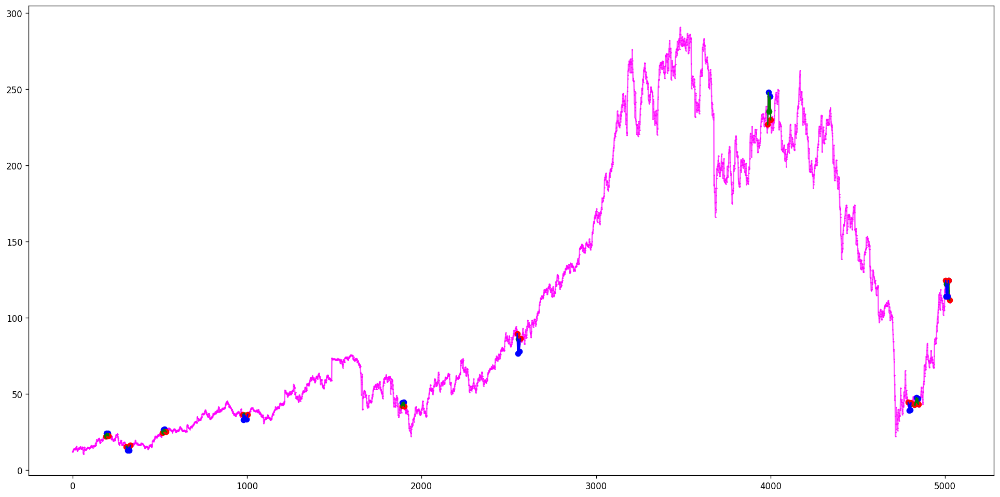

[(72, 75, 79, 82, 84), (91, 93, 101, 105, 113), (233, 234, 236, 241, 242), (288, 289, 290, 296, 299), (324, 326, 328, 346, 347), (537, 541, 543, 559, 562), (1762, 1768, 1776, 1781, 1785), (1868, 1881, 1888, 1895, 1896), (2097, 2103, 2109, 2117, 2121), (2841, 2844, 2852, 2857, 2863), (2941, 2945, 2949, 2952, 2956), (2973, 2975, 2977, 2982, 2983), (3068, 3082, 3086, 3091, 3095), (5079, 5080, 5083, 5089, 5090), (5163, 5168, 5172, 5181, 5183)]
[(69, 72, 75, 79, 82), (326, 328, 340, 343, 345), (455, 458, 462, 464, 467), (634, 639, 645, 654, 659), (732, 736, 741, 749, 755), (732, 736, 741, 750, 755), (1324, 1327, 1331, 1336, 1341), (1973, 1976, 1977, 1985, 1992), (2061, 2063, 2074, 2081, 2086), (2975, 2977, 2982, 2983, 2988), (3006, 3010, 3011, 3016, 3024), (3113, 3114, 3120, 3124, 3126), (3218, 3221, 3231, 3237, 3246), (4877, 4883, 4887, 4893, 4895), (5201, 5203, 5208, 5215, 5226)]
Ticker ADSK found 15 double top patterns, 15 double bottom patterns


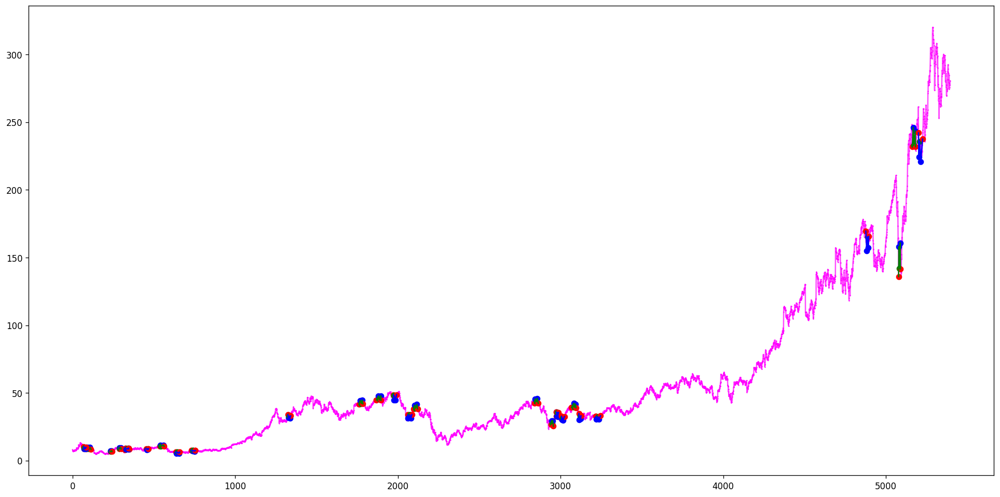

[(119, 124, 135, 139, 140), (140, 142, 147, 154, 161), (203, 204, 206, 210, 212), (361, 373, 378, 383, 386), (753, 760, 763, 779, 781), (819, 821, 825, 830, 836)]
[(190, 196, 200, 202, 204), (190, 197, 200, 202, 204), (495, 497, 505, 511, 517), (495, 498, 505, 511, 517), (821, 825, 830, 836, 839)]
Ticker ADT found 6 double top patterns, 5 double bottom patterns


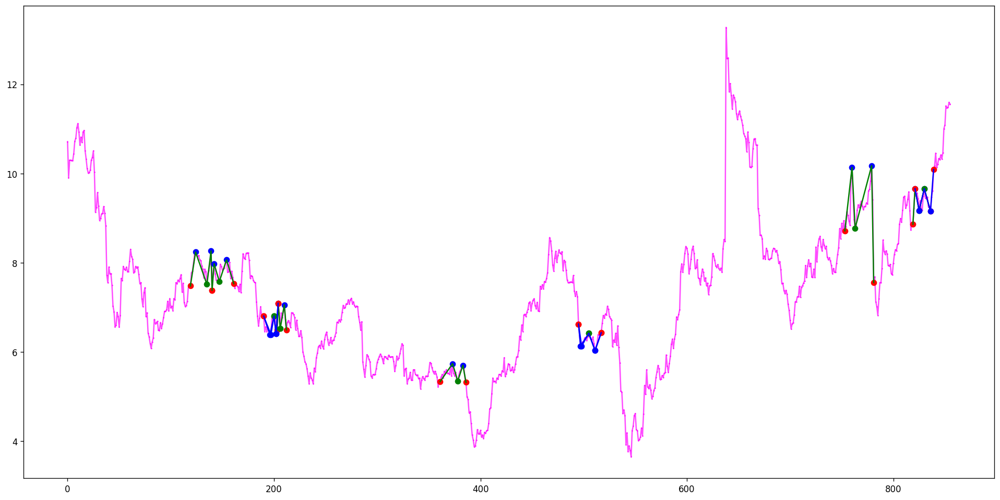

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(576, 579, 585, 587, 589), (653, 654, 660, 663, 665), (919, 922, 927, 929, 933), (966, 968, 971, 972, 974), (1246, 1247, 1250, 1251, 1252), (1341, 1342, 1347, 1349, 1350), (1341, 1342, 1347, 1351, 1353), (1341, 1342, 1347, 1352, 1353), (1341, 1345, 1347, 1351, 1353), (1341, 1345, 1347, 1352, 1353), (1347, 1348, 1350, 1352, 1353), (1402, 1403, 1406, 1408, 1411), (1543, 1544, 1546, 1548, 1553), (1543, 1544, 1546, 1552, 1553), (1543, 1545, 1546, 1552, 1553), (1543, 1544, 1546, 1554, 1555), (1543, 1545, 1546, 1554, 1555), (1543, 1544, 1546, 1556, 1557), (1543, 1545, 1546, 1556, 1557), (1547, 1548, 1553, 1556, 1557), (1547, 1552, 1553, 1556, 1557), (1543, 1544, 1546, 1562, 1564), (1543, 1544, 1546, 1563, 1564), (1543, 1545, 1546, 1562, 1564), (1543, 1545, 1546, 1563, 1564), (1547, 1548, 1553, 1562, 1564), (1547, 1548, 1553, 1563, 1564), (1547, 1552, 1553, 1562, 1564), (1547, 1552, 1553, 1563, 1564), (1553, 1554, 1555, 1562, 1564), (1553, 1554, 1555, 1563, 1564), (1555, 1556, 1557, 1563, 15

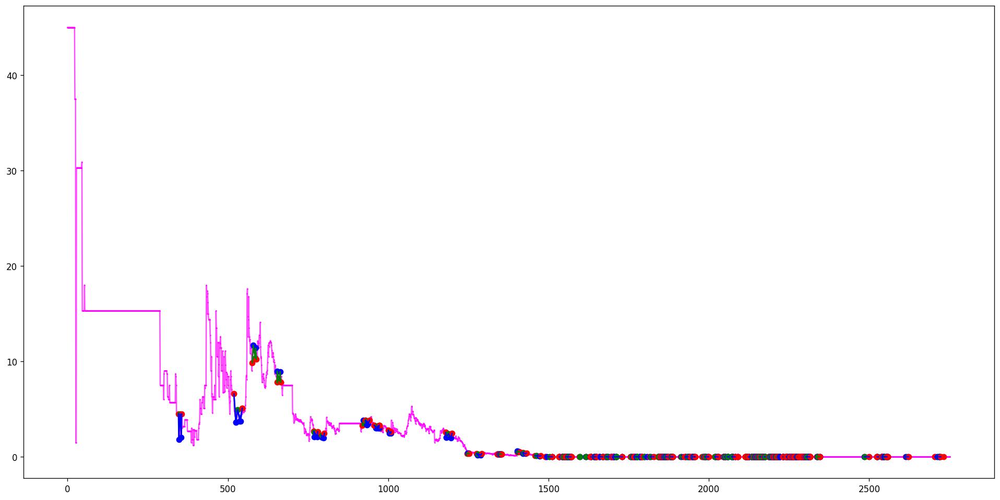

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(292, 295, 301, 304, 308), (292, 295, 301, 310, 312), (301, 304, 308, 310, 312), (321, 327, 329, 335, 342), (632, 634, 642, 643, 648), (919, 921, 925, 932, 935), (1221, 1225, 1233, 1235, 1239), (1456, 1461, 1463, 1475, 1476), (1536, 1539, 1546, 1550, 1554), (1914, 1921, 1936, 1940, 1941), (1956, 1957, 1964, 1966, 1969), (2099, 2104, 2107, 2113, 2121), (2121, 2129, 2137, 2139, 2145), (2789, 2799, 2802, 2808, 2813), (2851, 2857, 2864, 2869, 2872), (4073, 4084, 4093, 4097, 4098), (4608, 4615, 4620, 4624, 4630)]
[(57, 63, 67, 72, 82), (111, 113, 116, 122, 126), (195, 201, 203, 209, 213), (283, 286, 289, 290, 293), (295, 301, 304, 308, 309), (327, 329, 335, 343, 345), (368, 374, 378, 382, 387), (732, 736, 738, 745, 750), (886, 889, 897, 903, 909), (1205, 1207, 1215, 1219, 1222), (1205, 1207, 1215, 1220, 1222), (1305, 1308, 1325, 1327, 1329), (1454, 1456, 1461, 1477, 1482), (1529, 1536, 1539, 1546, 1550), (1940, 1943, 1953, 1956, 1957), (1940, 1943, 1957, 1964, 1966), (2104, 2107, 2113, 212

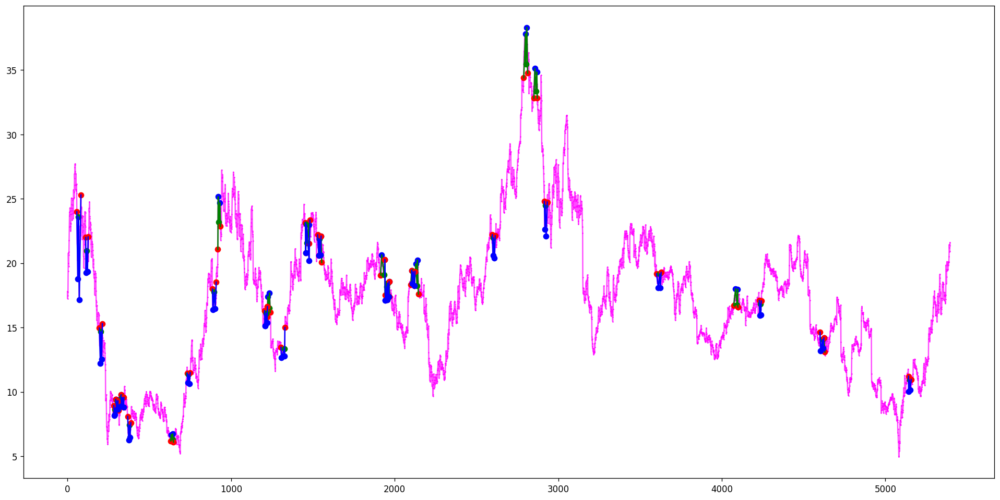

[(51, 52, 56, 58, 59)]
[(90, 92, 100, 102, 106), (90, 92, 100, 103, 106), (185, 191, 194, 202, 211)]
Ticker ADTX found 1 double top patterns, 3 double bottom patterns


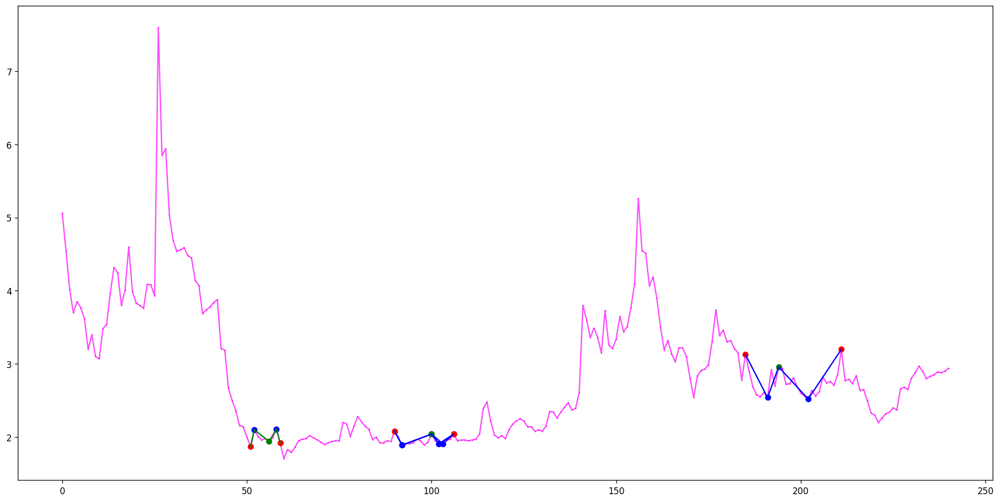

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(28, 30, 35, 41, 49), (262, 264, 269, 285, 289), (480, 484, 486, 490, 492), (599, 603, 610, 612, 617), (797, 799, 803, 807, 811), (1075, 1088, 1090, 1100, 1103), (1188, 1193, 1194, 1199, 1200), (1340, 1346, 1347, 1350, 1352), (1589, 1598, 1603, 1605, 1607)]
[(70, 72, 74, 78, 80), (226, 229, 233, 235, 238), (265, 269, 272, 276, 279), (261, 262, 264, 269, 285), (478, 480, 490, 492, 502), (670, 677, 679, 683, 689), (1167, 1172, 1177, 1183, 1185), (1295, 1298, 1302, 1307, 1310), (1501, 1503, 1507, 1508, 1510), (1710, 1716, 1717, 1723, 1726)]
Ticker ADVM found 9 double top patterns, 10 double bottom patterns


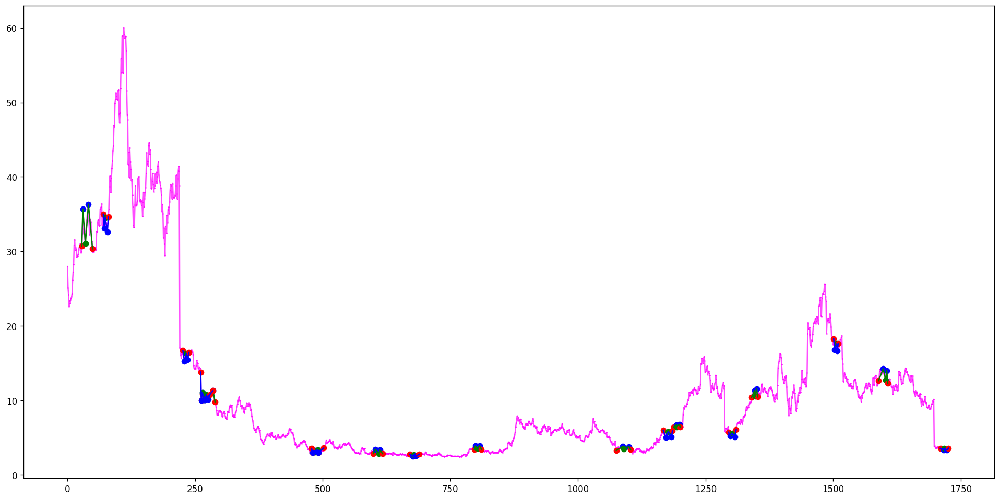

[(1986, 1995, 2000, 2009, 2012), (2274, 2280, 2283, 2288, 2293), (2969, 2974, 2977, 2982, 2991), (2969, 2975, 2977, 2982, 2991)]
[(244, 246, 249, 252, 253), (304, 307, 310, 315, 322), (2268, 2274, 2280, 2283, 2288), (2914, 2919, 2922, 2926, 2932), (4033, 4036, 4044, 4052, 4061)]
Ticker ADX found 4 double top patterns, 5 double bottom patterns


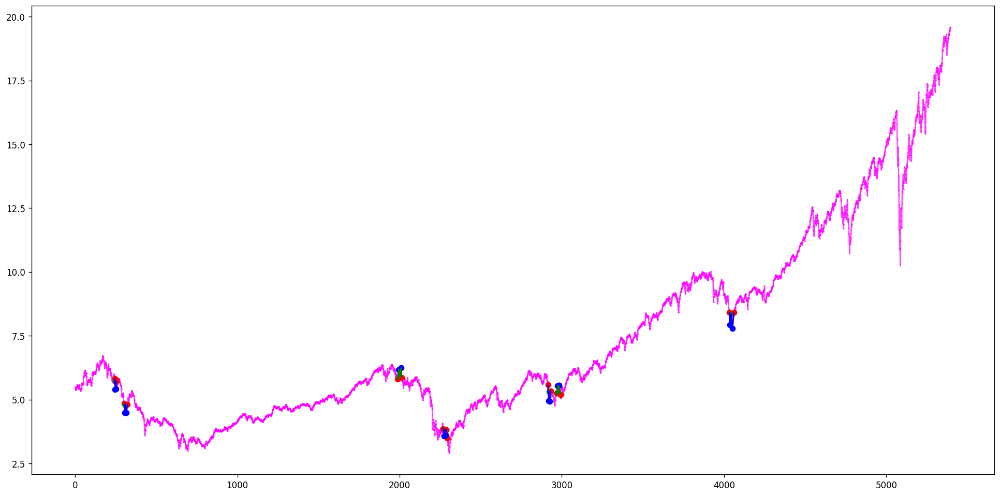

[(266, 271, 276, 277, 279), (279, 283, 291, 304, 305)]
[]
Ticker ADXN found 2 double top patterns, 0 double bottom patterns


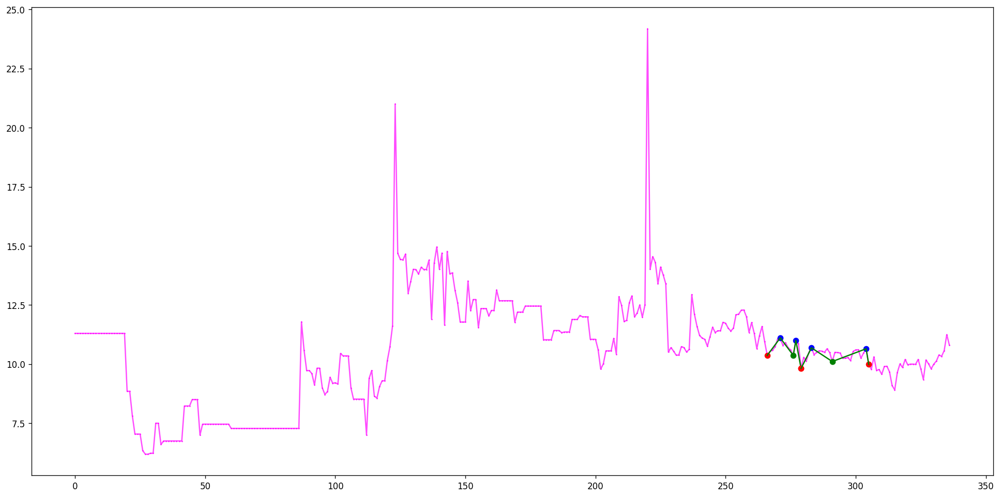

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(291, 293, 297, 298, 299), (1062, 1063, 1066, 1068, 1069), (2562, 2564, 2567, 2568, 2570), (2597, 2599, 2600, 2605, 2608), (2686, 2690, 2693, 2701, 2704), (3128, 3131, 3140, 3145, 3152), (3427, 3428, 3429, 3436, 3439), (3634, 3635, 3640, 3642, 3644)]
[(256, 258, 263, 269, 271), (288, 291, 293, 299, 302), (827, 831, 836, 838, 839), (1061, 1062, 1063, 1066, 1068), (1094, 1096, 1100, 1101, 1102), (1828, 1835, 1837, 1841, 1848), (1987, 1989, 1990, 1997, 1998), (2191, 2193, 2199, 2202, 2204), (2531, 2536, 2539, 2543, 2547), (2706, 2710, 2715, 2718, 2723), (2930, 2932, 2937, 2947, 2950), (3679, 3682, 3683, 3687, 3689), (3679, 3682, 3689, 3695, 3697), (3722, 3723, 3725, 3734, 3736), (3753, 3757, 3761, 3766, 3769)]
Ticker ADXS found 8 double top patterns, 15 double bottom patterns


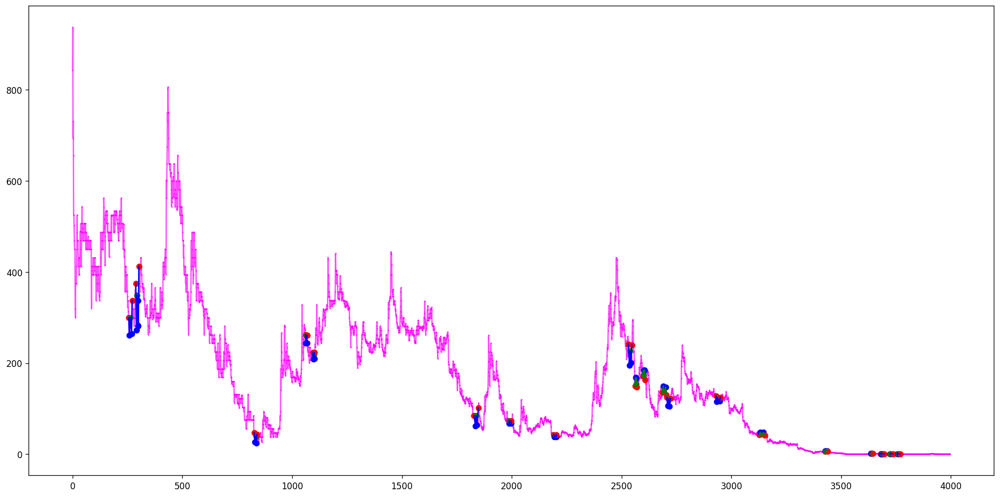

[(205, 213, 215, 220, 223), (205, 213, 223, 226, 232)]
[(2, 3, 8, 14, 22), (213, 215, 220, 223, 226), (350, 358, 361, 374, 377)]
Ticker ADYEY found 2 double top patterns, 3 double bottom patterns


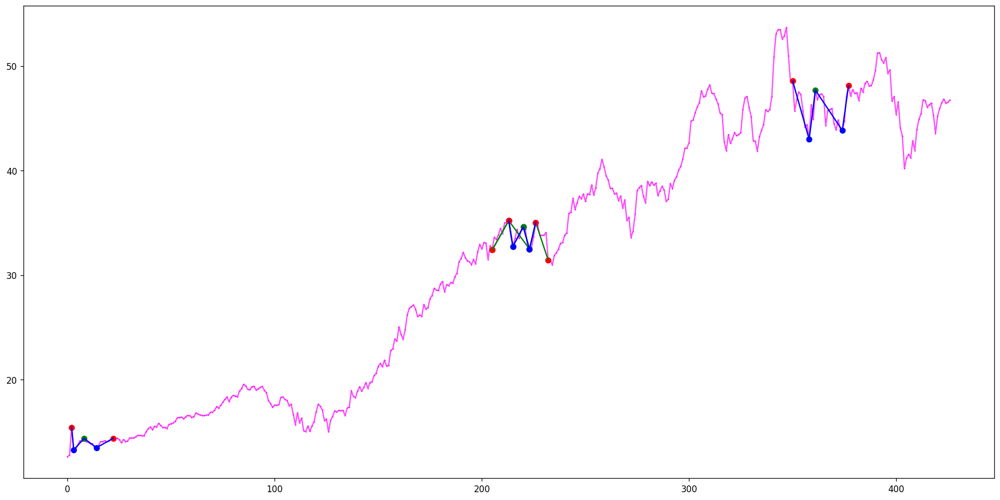

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(898, 905, 906, 909, 911), (1016, 1022, 1024, 1028, 1033), (1440, 1441, 1445, 1449, 1461), (1662, 1665, 1667, 1674, 1679), (1839, 1840, 1844, 1851, 1866), (2545, 2546, 2548, 2552, 2554), (2602, 2603, 2604, 2607, 2614), (2778, 2779, 2785, 2786, 2793), (3731, 3732, 3744, 3745, 3751), (3936, 3940, 3948, 3950, 3953), (3962, 3965, 3969, 3971, 3976), (4161, 4163, 4172, 4175, 4177), (4835, 4838, 4844, 4849, 4853), (4917, 4919, 4922, 4924, 4931), (4978, 4980, 4983, 4987, 4992), (4978, 4982, 4983, 4987, 4992), (5109, 5110, 5115, 5117, 5123), (5372, 5373, 5374, 5377, 5379), (5384, 5385, 5387, 5390, 5393)]
[(905, 906, 909, 911, 915), (1022, 1024, 1028, 1033, 1046), (1169, 1170, 1171, 1177, 1185), (1691, 1692, 1693, 1696, 1698), (2245, 2247, 2248, 2252, 2263), (2546, 2548, 2552, 2554, 2555), (3542, 3544, 3545, 3548, 3550), (3758, 3762, 3763, 3768, 3770), (4104, 4107, 4109, 4115, 4119), (4350, 4353, 4356, 4357, 4359), (4517, 4519, 4520, 4527, 4528), (4551, 4555, 4565, 4567, 4569), (4551, 4555, 456

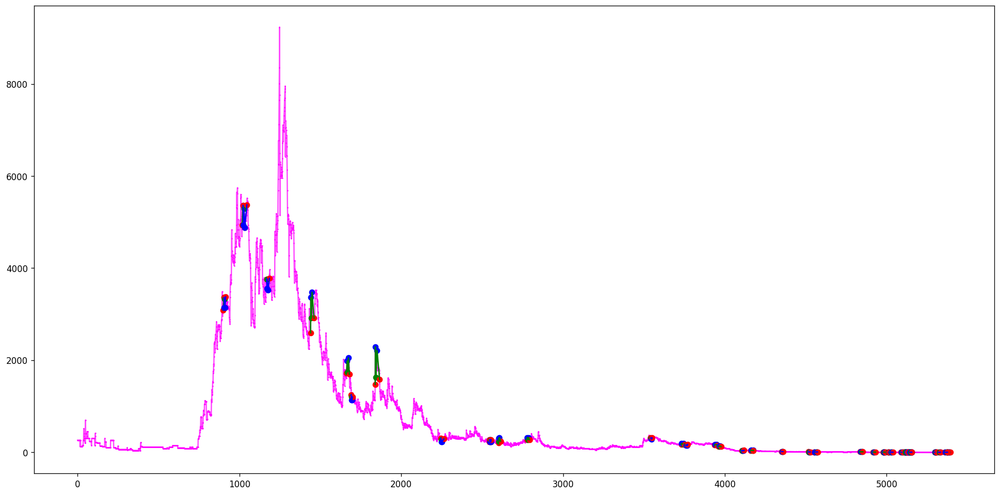

[(534, 538, 542, 548, 549)]
[(436, 441, 448, 453, 457), (640, 645, 655, 660, 667)]
Ticker ADYYF found 1 double top patterns, 2 double bottom patterns


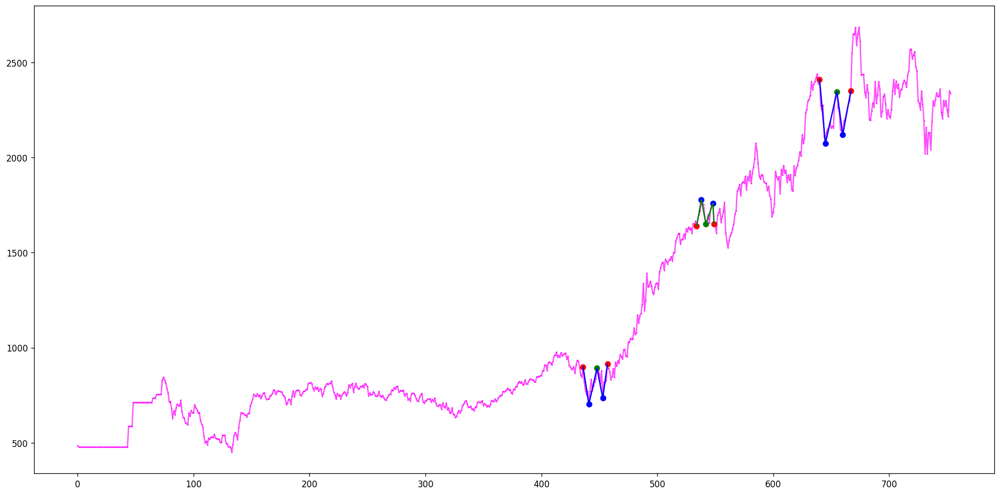

[(1950, 1959, 1961, 1968, 1977), (2009, 2010, 2012, 2019, 2023), (2337, 2339, 2340, 2350, 2354), (2368, 2373, 2380, 2387, 2389), (3920, 3921, 3922, 3928, 3933), (4118, 4123, 4130, 4134, 4137), (4191, 4195, 4200, 4204, 4209), (4256, 4259, 4266, 4270, 4276), (4528, 4529, 4530, 4538, 4548), (4555, 4559, 4569, 4575, 4578), (4752, 4754, 4766, 4768, 4771), (5114, 5116, 5122, 5124, 5126), (5111, 5116, 5126, 5127, 5130), (5142, 5143, 5145, 5150, 5154)]
[(217, 220, 224, 232, 240), (451, 454, 464, 465, 468), (700, 705, 713, 715, 719), (700, 705, 713, 716, 719), (1278, 1280, 1288, 1292, 1301), (1995, 2005, 2010, 2012, 2013), (2339, 2340, 2343, 2344, 2349), (2389, 2397, 2400, 2406, 2411), (2519, 2523, 2525, 2538, 2544), (3460, 3467, 3474, 3484, 3486), (4475, 4482, 4489, 4497, 4500), (4657, 4661, 4667, 4672, 4680), (5124, 5131, 5139, 5142, 5143), (5249, 5250, 5252, 5257, 5263), (5280, 5289, 5299, 5303, 5308)]
Ticker AE found 14 double top patterns, 15 double bottom patterns


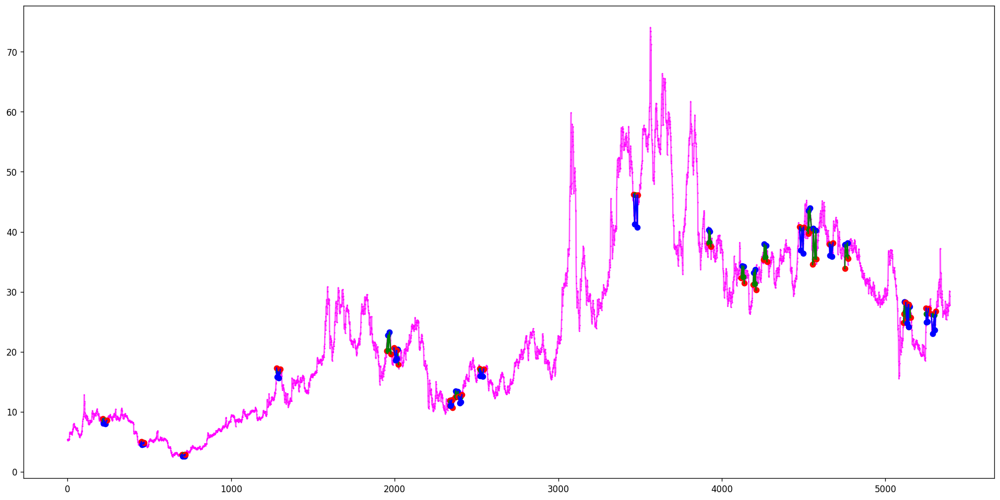

[(725, 731, 735, 745, 750), (3652, 3655, 3661, 3665, 3672)]
[(571, 574, 576, 587, 591), (1126, 1128, 1133, 1139, 1147), (1904, 1906, 1912, 1917, 1928)]
Ticker AEB found 2 double top patterns, 3 double bottom patterns


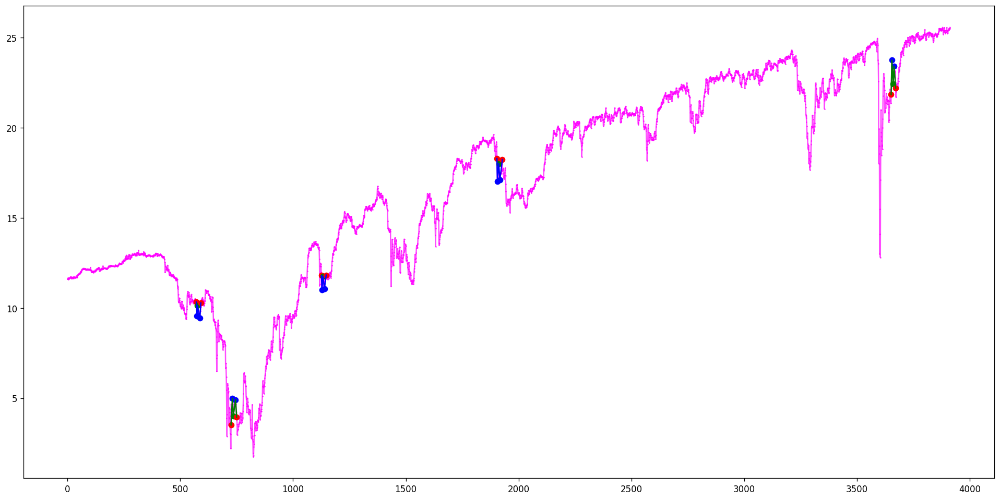

[(2206, 2208, 2209, 2212, 2214), (2217, 2223, 2225, 2232, 2235)]
[]
Ticker AEE found 2 double top patterns, 0 double bottom patterns


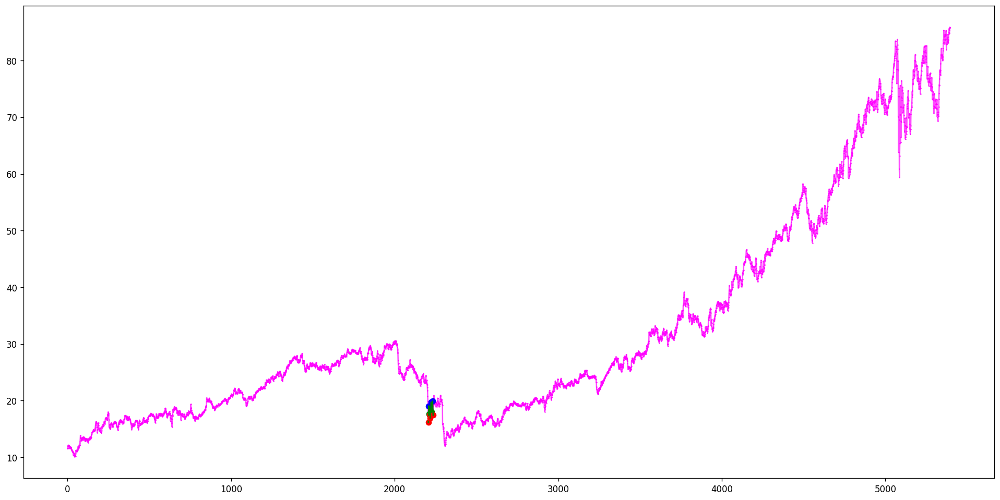

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(7, 11, 20, 28, 35)]
[(965, 969, 972, 977, 984), (2295, 2297, 2301, 2307, 2317), (4720, 4724, 4727, 4736, 4739)]
Ticker AEF found 1 double top patterns, 3 double bottom patterns


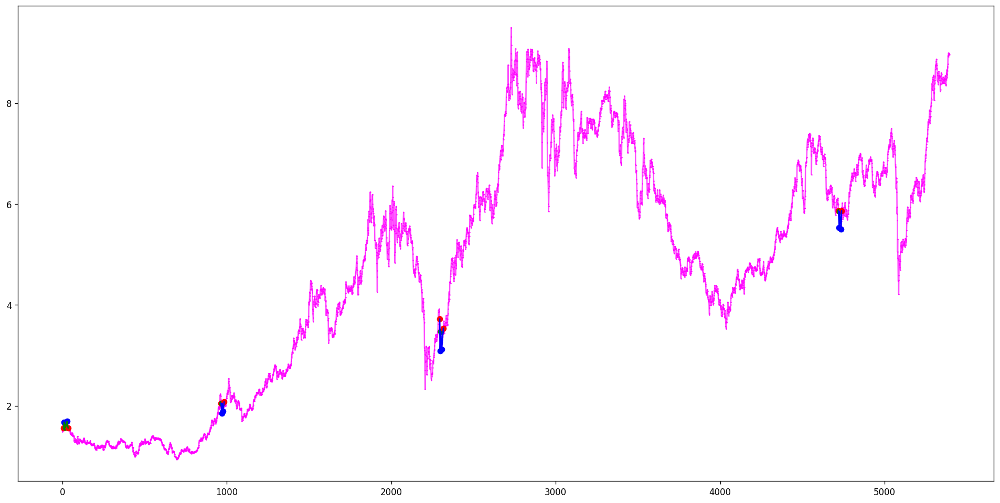

[]
[]
Ticker AEFC found 0 double top patterns, 0 double bottom patterns


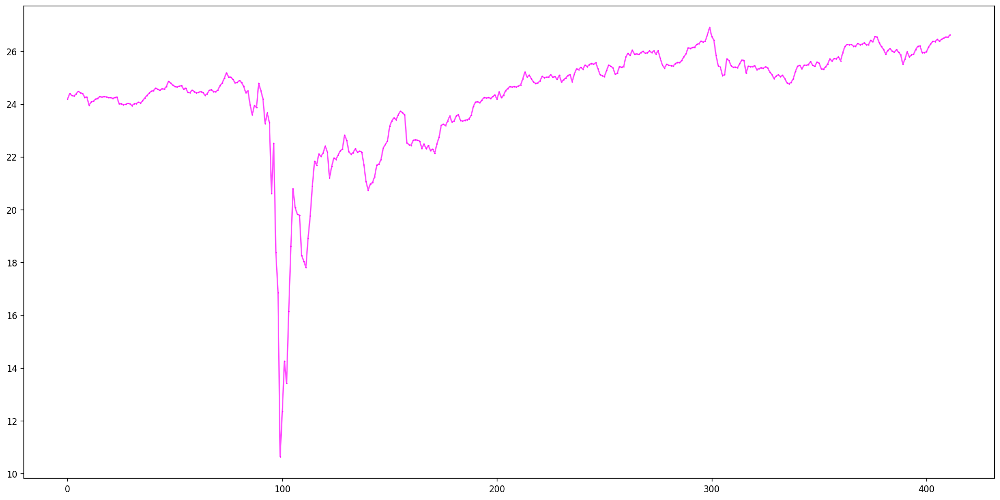

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(460, 463, 481, 483, 488), (488, 490, 493, 501, 503), (2161, 2164, 2171, 2178, 2180), (2161, 2164, 2180, 2186, 2187), (2246, 2248, 2251, 2252, 2258), (2277, 2280, 2285, 2288, 2289), (2329, 2331, 2332, 2335, 2336), (2364, 2366, 2367, 2371, 2375), (2783, 2787, 2797, 2800, 2803), (3011, 3015, 3016, 3019, 3021), (3216, 3219, 3224, 3228, 3234), (3216, 3219, 3224, 3231, 3234), (4809, 4818, 4824, 4830, 4834), (4809, 4819, 4824, 4830, 4834), (5095, 5099, 5107, 5112, 5117), (5156, 5158, 5161, 5165, 5176), (5257, 5258, 5260, 5265, 5270)]
[(13, 20, 22, 27, 33), (302, 307, 310, 315, 319), (484, 488, 490, 493, 500), (1897, 1906, 1909, 1914, 1921), (2335, 2336, 2340, 2341, 2344), (2374, 2381, 2387, 2393, 2397), (2468, 2470, 2471, 2474, 2478), (2611, 2614, 2615, 2621, 2627), (3120, 3123, 3126, 3131, 3133), (3371, 3380, 3384, 3385, 3396), (4199, 4203, 4208, 4212, 4216), (4373, 4383, 4388, 4396, 4400), (4866, 4869, 4875, 4883, 4887), (5141, 5142, 5145, 5148, 5150), (5141, 5142, 5150, 5153, 5158)]
Tick

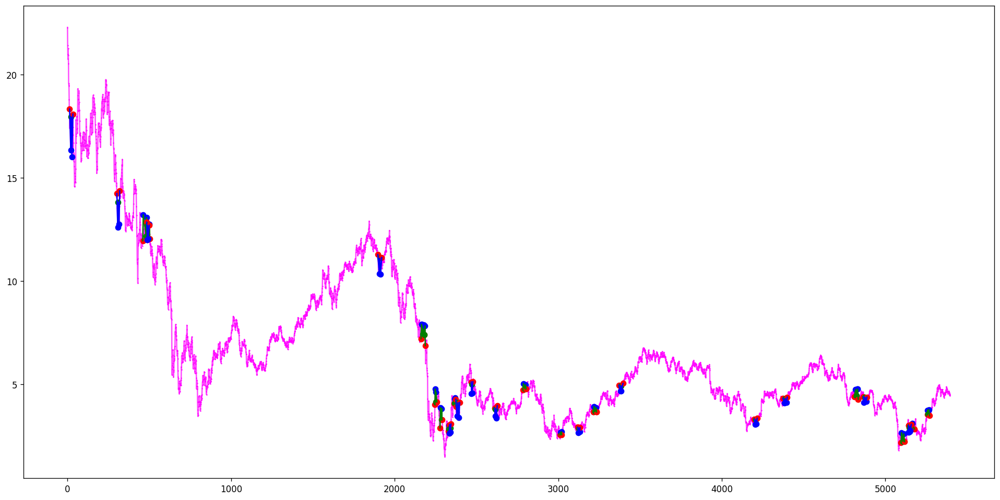

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(201, 203, 210, 215, 218), (240, 244, 250, 252, 257), (491, 492, 493, 496, 499), (601, 603, 608, 611, 612), (648, 650, 651, 654, 658), (648, 650, 651, 656, 658), (690, 692, 693, 699, 702), (690, 692, 693, 700, 702), (693, 694, 697, 700, 702), (703, 704, 705, 708, 711), (703, 704, 705, 718, 720), (706, 707, 711, 718, 720), (706, 708, 711, 718, 720), (738, 739, 750, 751, 753), (738, 739, 750, 752, 753), (787, 788, 793, 795, 797), (787, 790, 793, 795, 797), (809, 811, 812, 815, 816), (806, 811, 824, 830, 834), (806, 813, 824, 830, 834), (806, 815, 824, 830, 834), (834, 835, 837, 839, 840), (834, 835, 837, 842, 844), (834, 835, 837, 843, 844), (834, 836, 837, 842, 844), (834, 836, 837, 843, 844), (837, 838, 840, 842, 844), (837, 838, 840, 843, 844), (837, 839, 840, 843, 844), (852, 853, 858, 862, 871), (852, 853, 858, 864, 871), (852, 853, 858, 872, 873), (859, 862, 871, 872, 873), (859, 864, 871, 872, 873), (852, 853, 858, 877, 880), (852, 853, 858, 879, 880), (859, 862, 871, 877, 880), 

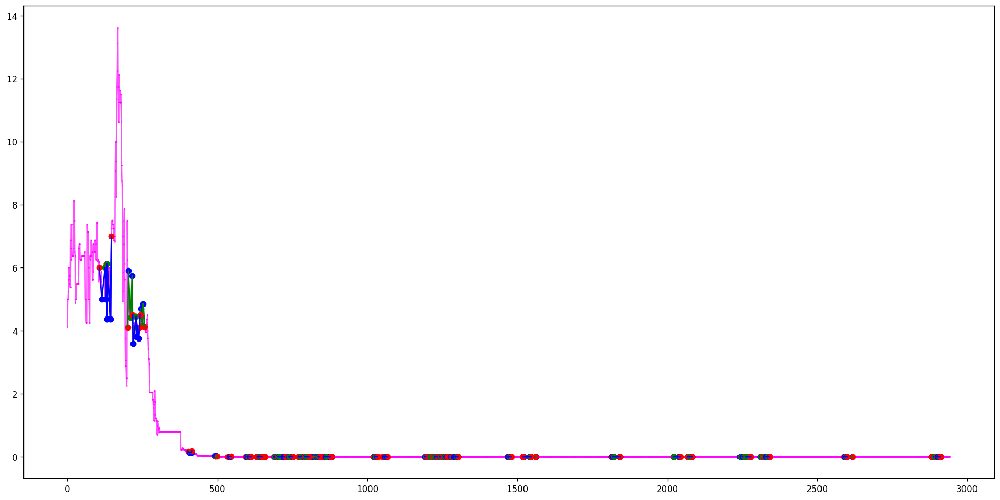

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(967, 971, 981, 982, 988), (1362, 1372, 1375, 1379, 1386), (1362, 1373, 1375, 1379, 1386), (1682, 1684, 1692, 1696, 1702), (1784, 1786, 1792, 1796, 1800), (1784, 1788, 1792, 1796, 1800), (1784, 1789, 1792, 1796, 1800), (1784, 1791, 1792, 1796, 1800), (1901, 1903, 1909, 1915, 1923), (1901, 1904, 1909, 1915, 1923), (1912, 1915, 1919, 1920, 1923), (1967, 1970, 1973, 1976, 1994), (2468, 2469, 2472, 2475, 2483), (2611, 2613, 2614, 2625, 2630), (2789, 2790, 2793, 2799, 2813), (3345, 3347, 3350, 3352, 3354)]
[(956, 959, 961, 967, 968), (991, 996, 998, 1007, 1015), (991, 996, 998, 1008, 1015), (1215, 1216, 1225, 1226, 1228), (1225, 1226, 1228, 1238, 1240), (1733, 1734, 1741, 1750, 1753), (1899, 1901, 1903, 1909, 1915), (1899, 1901, 1903, 1912, 1915), (2018, 2020, 2023, 2026, 2027), (2074, 2075, 2083, 2087, 2091), (2074, 2075, 2083, 2088, 2091), (2183, 2189, 2190, 2198, 2211), (2397, 2399, 2401, 2408, 2412), (2397, 2399, 2401, 2409, 2412), (2507, 2512, 2516, 2520, 2523), (2496, 2501, 2506, 251

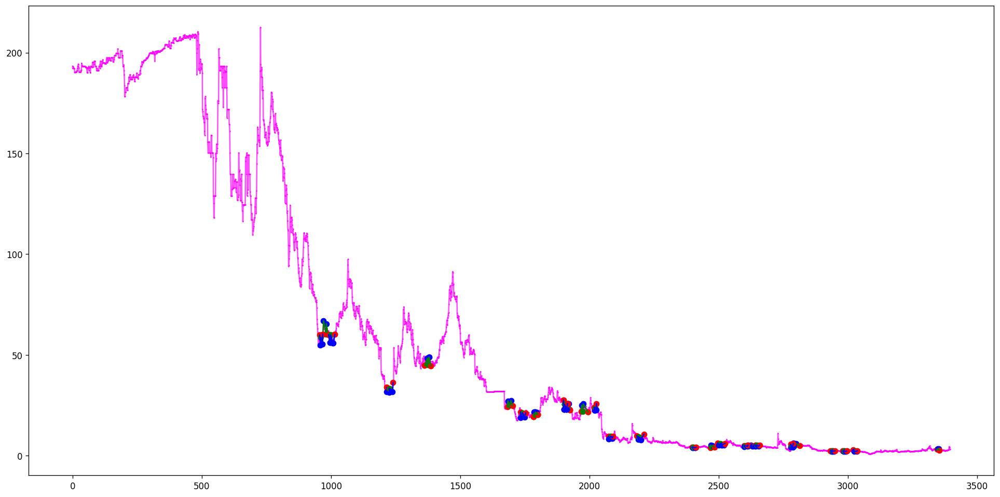

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(24, 29, 36, 37, 40), (84, 88, 92, 94, 100), (84, 88, 92, 95, 100), (109, 112, 119, 124, 125), (109, 113, 119, 124, 125), (131, 134, 136, 140, 146), (184, 187, 192, 193, 194), (219, 222, 229, 234, 242), (250, 251, 266, 267, 270), (250, 255, 266, 267, 270), (272, 274, 275, 280, 285), (288, 289, 292, 294, 302), (288, 289, 292, 295, 302), (288, 289, 292, 300, 302), (292, 294, 298, 300, 302), (292, 295, 298, 300, 302), (308, 309, 311, 313, 314), (335, 336, 340, 347, 349), (335, 336, 340, 348, 349), (335, 337, 340, 347, 349), (335, 337, 340, 348, 349), (335, 336, 340, 350, 354), (335, 337, 340, 350, 354), (485, 486, 489, 491, 494), (485, 486, 489, 492, 494), (485, 486, 494, 495, 497), (485, 486, 494, 496, 497), (706, 707, 708, 714, 716), (830, 836, 838, 841, 842), (1017, 1019, 1020, 1027, 1037), (1191, 1198, 1206, 1207, 1208), (1348, 1350, 1365, 1366, 1371), (1459, 1460, 1476, 1478, 1483), (1610, 1613, 1614, 1617, 1618), (2001, 2002, 2006, 2008, 2013), (2114, 2119, 2122, 2127, 2131), (2247

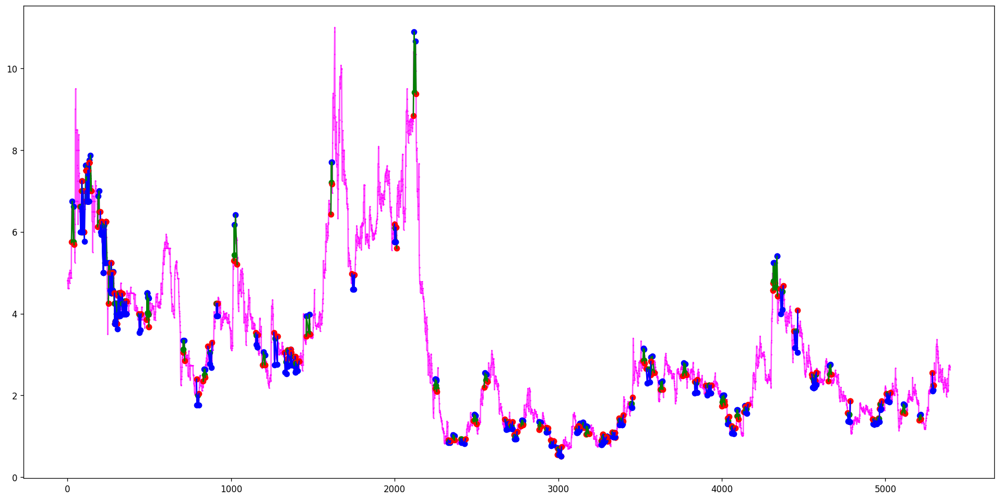

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(513, 516, 521, 524, 525), (781, 783, 787, 791, 793), (1177, 1178, 1180, 1184, 1185), (1191, 1193, 1202, 1206, 1209), (1697, 1699, 1704, 1706, 1708), (1910, 1912, 1915, 1921, 1923), (2098, 2103, 2109, 2113, 2117), (2122, 2124, 2129, 2131, 2134), (2122, 2131, 2134, 2139, 2142), (2164, 2165, 2171, 2176, 2180), (2164, 2165, 2171, 2178, 2180), (2328, 2338, 2340, 2346, 2353), (2441, 2448, 2452, 2460, 2468), (2710, 2714, 2717, 2721, 2724), (2927, 2932, 2937, 2945, 2949), (3124, 3128, 3131, 3135, 3140), (3124, 3128, 3140, 3146, 3149), (4737, 4739, 4746, 4759, 4763), (5343, 5346, 5357, 5361, 5367)]
[(197, 198, 203, 209, 221), (242, 246, 250, 252, 253), (286, 291, 295, 303, 307), (432, 437, 439, 442, 444), (463, 466, 468, 472, 475), (742, 745, 746, 751, 752), (1141, 1143, 1151, 1157, 1161), (1266, 1270, 1281, 1282, 1285), (1394, 1399, 1403, 1404, 1407), (2250, 2251, 2252, 2260, 2261), (2301, 2303, 2304, 2307, 2310), (2338, 2340, 2346, 2353, 2361), (2469, 2475, 2483, 2492, 2497), (2531, 2533, 2

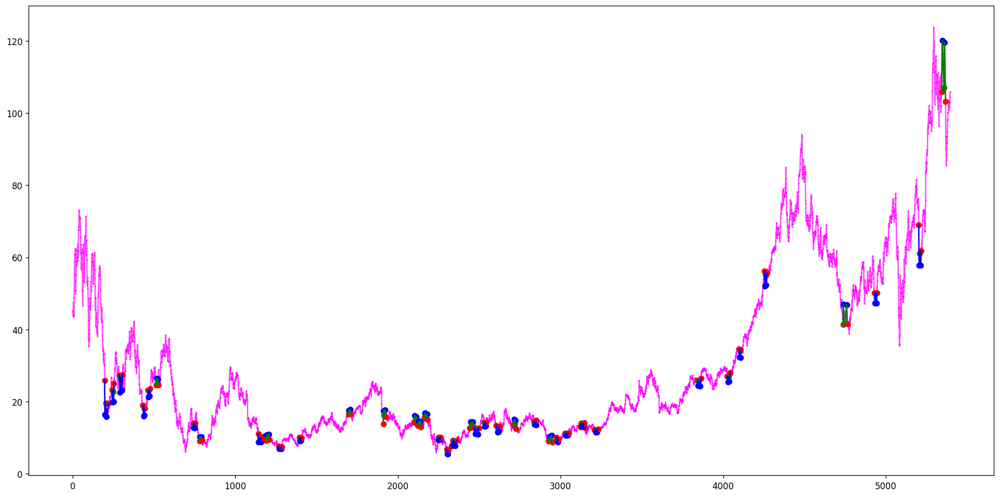

[(3137, 3146, 3153, 3159, 3160), (3170, 3178, 3185, 3187, 3188), (3876, 3879, 3884, 3890, 3892), (4110, 4114, 4121, 4127, 4137), (4276, 4280, 4286, 4289, 4299)]
[(757, 768, 775, 779, 785), (1068, 1070, 1074, 1076, 1079), (1622, 1627, 1630, 1638, 1642), (1651, 1656, 1661, 1667, 1677), (1961, 1965, 1969, 1971, 1974), (2907, 2916, 2922, 2930, 2932), (3565, 3570, 3577, 3584, 3590), (4156, 4157, 4160, 4168, 4170), (4156, 4157, 4170, 4174, 4180)]
Ticker AEL found 5 double top patterns, 9 double bottom patterns


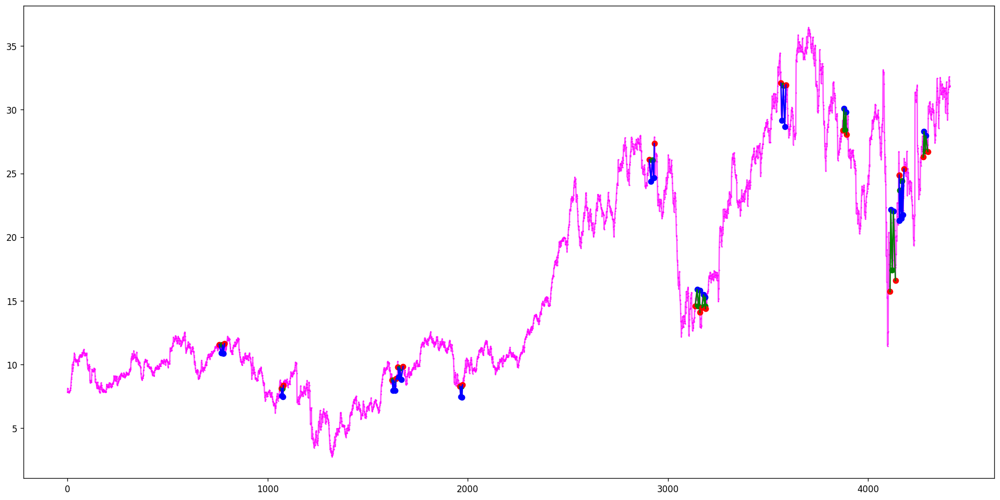

[(25, 27, 32, 35, 41), (22, 23, 25, 35, 42), (63, 64, 67, 72, 76), (117, 119, 124, 125, 127), (173, 177, 181, 186, 188), (227, 231, 234, 235, 238), (253, 256, 264, 265, 269), (355, 358, 360, 365, 370), (915, 916, 920, 926, 931), (1632, 1638, 1642, 1644, 1646), (1771, 1787, 1791, 1795, 1798), (1889, 1896, 1901, 1911, 1914), (2274, 2277, 2283, 2290, 2299), (3546, 3548, 3553, 3556, 3560), (4192, 4196, 4198, 4207, 4215)]
[(59, 61, 64, 81, 83), (202, 206, 209, 217, 224), (202, 206, 209, 218, 224), (441, 444, 448, 451, 460), (608, 609, 610, 614, 617), (699, 702, 703, 706, 707), (1009, 1013, 1016, 1022, 1025), (1077, 1084, 1088, 1091, 1100), (1681, 1688, 1693, 1697, 1706), (1759, 1764, 1766, 1769, 1772), (1975, 1976, 1978, 1981, 1982), (2297, 2302, 2305, 2308, 2314), (2373, 2380, 2383, 2393, 2399), (2648, 2650, 2653, 2656, 2662), (3081, 3085, 3088, 3090, 3097), (3499, 3504, 3506, 3513, 3521), (3749, 3750, 3753, 3755, 3757), (3815, 3818, 3827, 3833, 3836), (3836, 3839, 3847, 3848, 3852), (3986

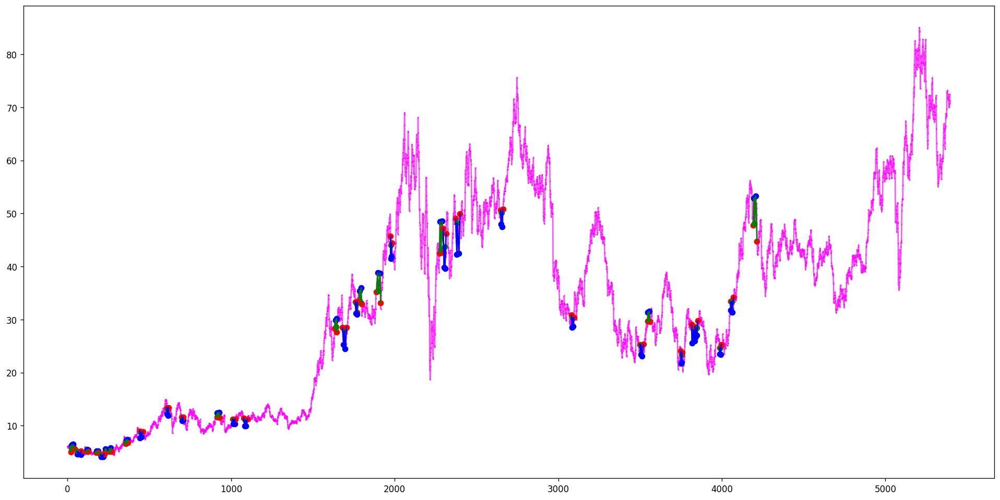

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1226, 1229, 1233, 1235, 1242), (2254, 2255, 2265, 2267, 2271), (2413, 2414, 2418, 2420, 2429), (2479, 2482, 2485, 2490, 2493), (2723, 2724, 2727, 2728, 2733), (3855, 3856, 3857, 3861, 3864), (4388, 4389, 4392, 4399, 4403), (4598, 4600, 4604, 4611, 4622), (4746, 4749, 4750, 4754, 4755), (4877, 4879, 4883, 4885, 4888), (4943, 4944, 4945, 4950, 4952), (5007, 5009, 5010, 5016, 5018), (5081, 5083, 5087, 5090, 5094), (5131, 5132, 5137, 5140, 5142)]
[(1650, 1660, 1664, 1668, 1671), (1755, 1759, 1760, 1764, 1767), (1774, 1778, 1783, 1786, 1787), (1997, 2000, 2005, 2006, 2007), (2101, 2106, 2109, 2114, 2117), (2109, 2114, 2117, 2122, 2123), (2359, 2367, 2376, 2377, 2384), (2409, 2413, 2414, 2418, 2420), (4222, 4224, 4228, 4231, 4236), (4427, 4429, 4431, 4444, 4450), (4546, 4550, 4558, 4562, 4573), (4895, 4897, 4898, 4901, 4902), (4921, 4924, 4930, 4933, 4936), (5121, 5124, 5125, 5128, 5132), (5132, 5137, 5140, 5142, 5147), (5211, 5213, 5218, 5223, 5225), (5211, 5214, 5218, 5223, 5225), (5274,

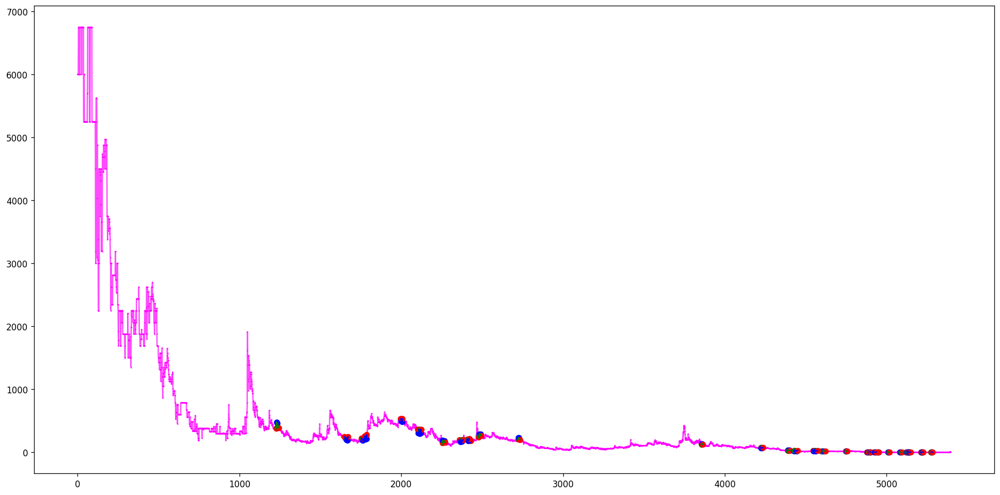

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(439, 443, 446, 454, 461), (881, 883, 887, 902, 904), (1201, 1202, 1206, 1210, 1215), (1217, 1219, 1221, 1225, 1226), (1340, 1341, 1346, 1347, 1351), (1340, 1341, 1346, 1349, 1351), (1376, 1380, 1384, 1390, 1391), (1766, 1772, 1775, 1777, 1780), (1805, 1808, 1813, 1814, 1819), (1805, 1809, 1813, 1814, 1819), (1850, 1854, 1867, 1870, 1878), (1960, 1965, 1967, 1972, 1975)]
[(646, 656, 661, 665, 674), (702, 703, 704, 710, 713), (696, 701, 713, 719, 722), (725, 728, 735, 737, 741), (1156, 1160, 1166, 1174, 1175), (1196, 1201, 1202, 1206, 1210), (1225, 1226, 1232, 1236, 1246), (1225, 1226, 1232, 1237, 1246), (1358, 1360, 1363, 1366, 1369), (1393, 1398, 1399, 1404, 1413), (1801, 1805, 1808, 1813, 1814), (1922, 1925, 1927, 1931, 1932), (1951, 1960, 1965, 1975, 1978), (1966, 1967, 1972, 1975, 1978)]
Ticker AENZ found 12 double top patterns, 14 double bottom patterns


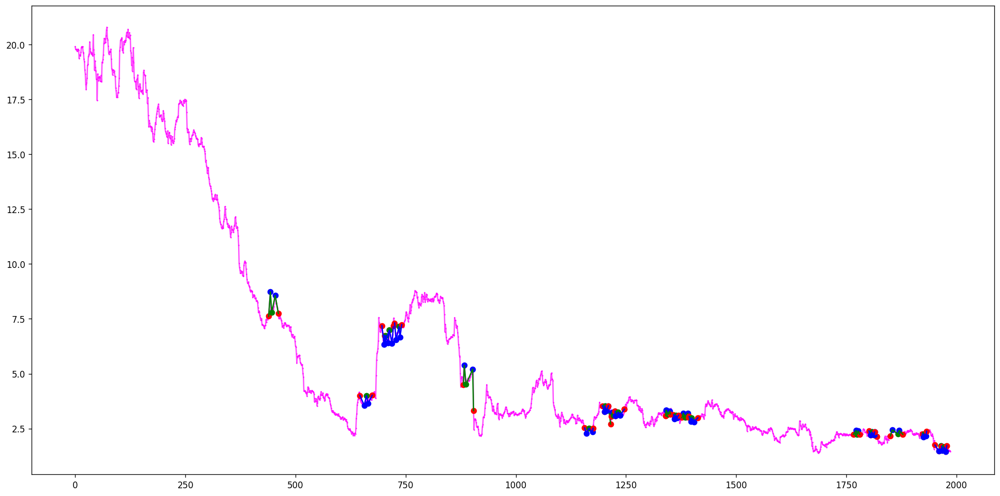

[(2209, 2220, 2229, 2230, 2235)]
[(776, 780, 786, 789, 791), (2224, 2225, 2226, 2229, 2230), (4240, 4248, 4254, 4256, 4263), (5083, 5086, 5091, 5095, 5099)]
Ticker AEP found 1 double top patterns, 4 double bottom patterns


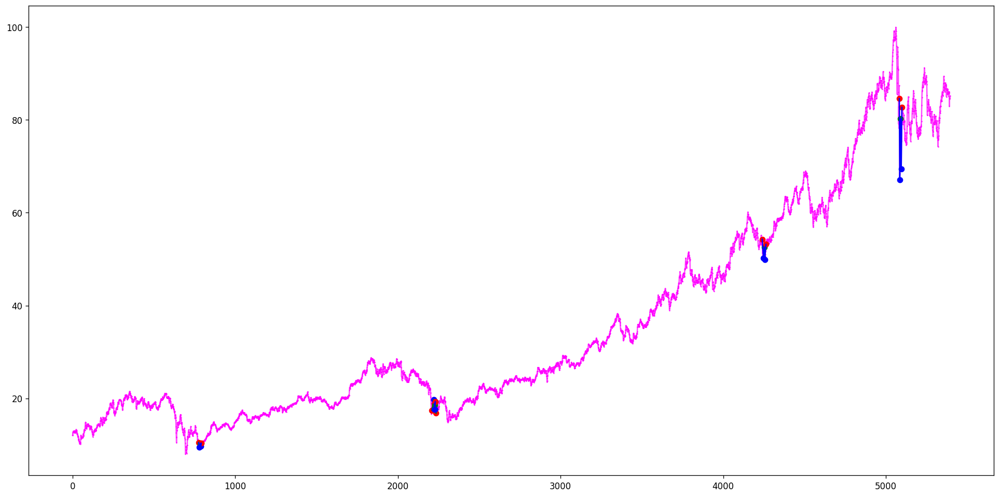

[]
[]
Ticker AEPPL found 0 double top patterns, 0 double bottom patterns


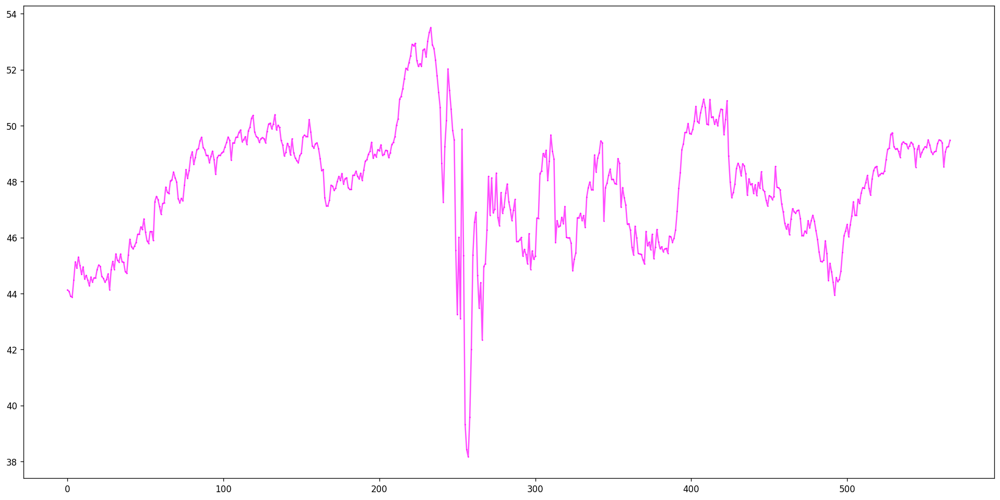

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(252, 253, 255, 258, 262), (623, 624, 628, 631, 636), (909, 910, 911, 914, 916), (1162, 1163, 1164, 1181, 1182), (1168, 1169, 1178, 1181, 1182), (1580, 1582, 1583, 1586, 1590), (1685, 1686, 1689, 1694, 1696), (1685, 1686, 1689, 1695, 1696), (1685, 1687, 1689, 1695, 1696), (1703, 1704, 1705, 1712, 1714), (1721, 1726, 1729, 1733, 1741), (1721, 1728, 1729, 1733, 1741), (1774, 1775, 1778, 1782, 1789), (1774, 1775, 1778, 1784, 1789), (1774, 1776, 1778, 1784, 1789), (1897, 1898, 1903, 1909, 1910), (1897, 1902, 1903, 1909, 1910), (1916, 1917, 1919, 1921, 1924), (1916, 1917, 1919, 1923, 1924), (1916, 1918, 1919, 1923, 1924), (1916, 1917, 1924, 1925, 1928), (1916, 1917, 1924, 1927, 1928), (1916, 1918, 1924, 1925, 1928), (1916, 1918, 1924, 1927, 1928), (1916, 1921, 1924, 1927, 1928), (1910, 1911, 1912, 1917, 1930), (1910, 1911, 1912, 1918, 1930), (1910, 1911, 1912, 1921, 1930), (1910, 1911, 1912, 1923, 1930), (1910, 1911, 1912, 1925, 1930), (1910, 1911, 1912, 1927, 1930), (1912, 1917, 1928, 192

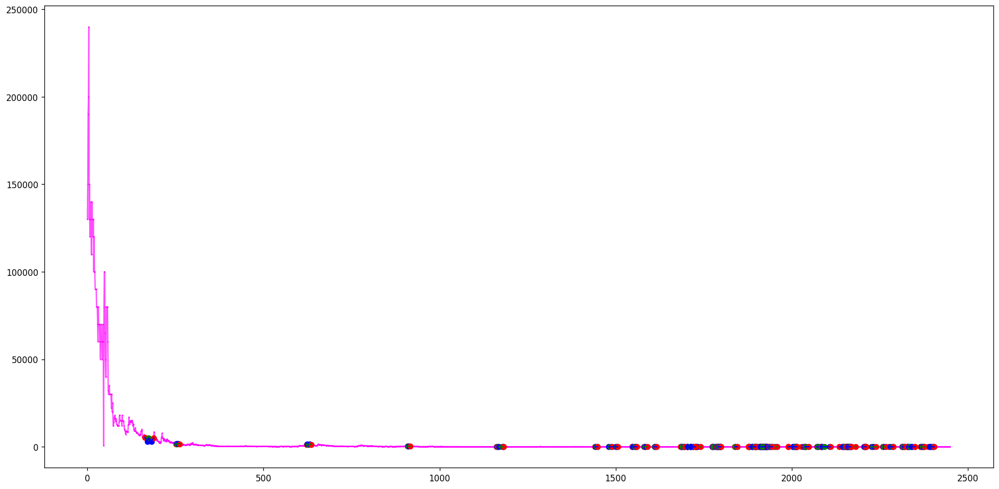

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(137, 143, 148, 153, 162), (423, 425, 429, 431, 439), (632, 633, 635, 642, 644), (1873, 1875, 1881, 1898, 1900), (3061, 3066, 3073, 3079, 3086), (3546, 3550, 3552, 3560, 3561)]
[(603, 605, 608, 609, 612), (603, 605, 608, 610, 612), (684, 687, 692, 699, 705), (1083, 1086, 1092, 1098, 1101), (1215, 1217, 1220, 1224, 1230), (2237, 2240, 2255, 2259, 2263), (2998, 3001, 3013, 3020, 3025)]
Ticker AER found 6 double top patterns, 7 double bottom patterns


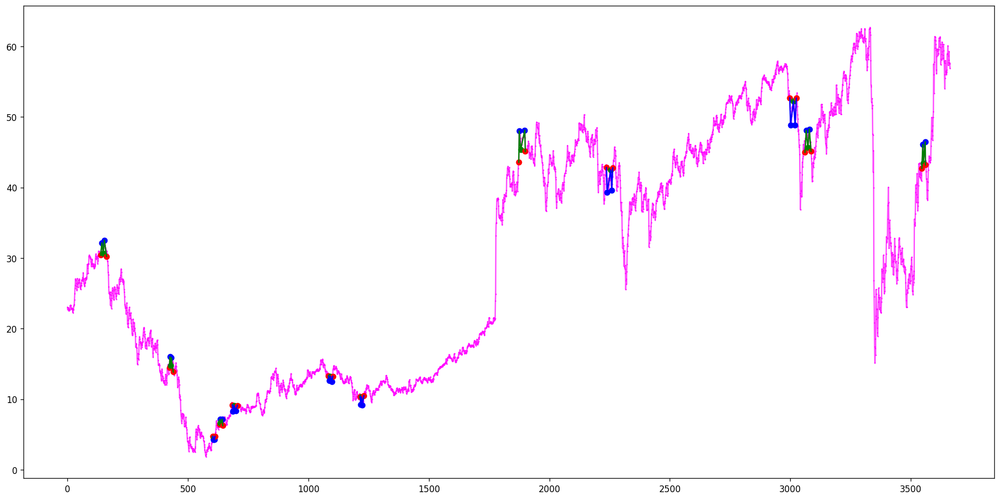

[(265, 270, 276, 279, 288), (438, 445, 454, 455, 463), (550, 554, 555, 564, 568), (660, 662, 669, 676, 682), (784, 786, 790, 792, 799), (852, 858, 861, 865, 866), (960, 964, 977, 982, 985), (1053, 1055, 1059, 1069, 1075), (1053, 1055, 1059, 1070, 1075), (2190, 2191, 2194, 2195, 2197), (2272, 2273, 2274, 2279, 2282), (2272, 2273, 2274, 2280, 2282), (2333, 2335, 2336, 2340, 2341), (2364, 2365, 2367, 2374, 2376), (3485, 3490, 3497, 3502, 3507), (4194, 4196, 4201, 4208, 4215), (4538, 4540, 4543, 4546, 4551)]
[(51, 55, 61, 72, 76), (135, 137, 141, 144, 145), (299, 307, 313, 317, 324), (447, 454, 455, 463, 467), (569, 570, 572, 577, 581), (1046, 1051, 1055, 1059, 1069), (1921, 1923, 1929, 1932, 1937), (1912, 1915, 1921, 1923, 1938), (2233, 2235, 2240, 2241, 2242), (2335, 2336, 2340, 2341, 2344), (2350, 2353, 2357, 2360, 2364), (2483, 2487, 2496, 2499, 2502), (2483, 2489, 2496, 2499, 2502), (2607, 2610, 2616, 2617, 2624), (2924, 2927, 2932, 2936, 2944), (4086, 4090, 4098, 4102, 4113), (4241, 

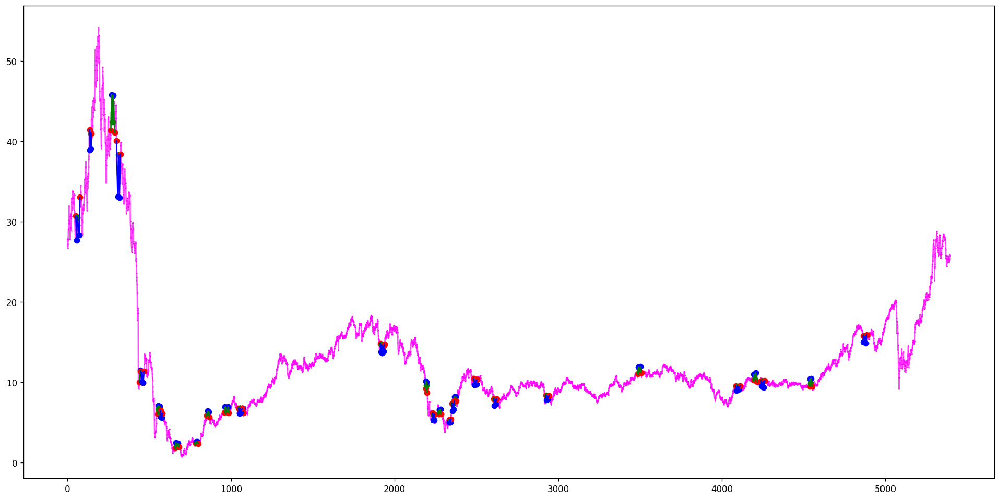

[]
[]
Ticker AESC found 0 double top patterns, 0 double bottom patterns


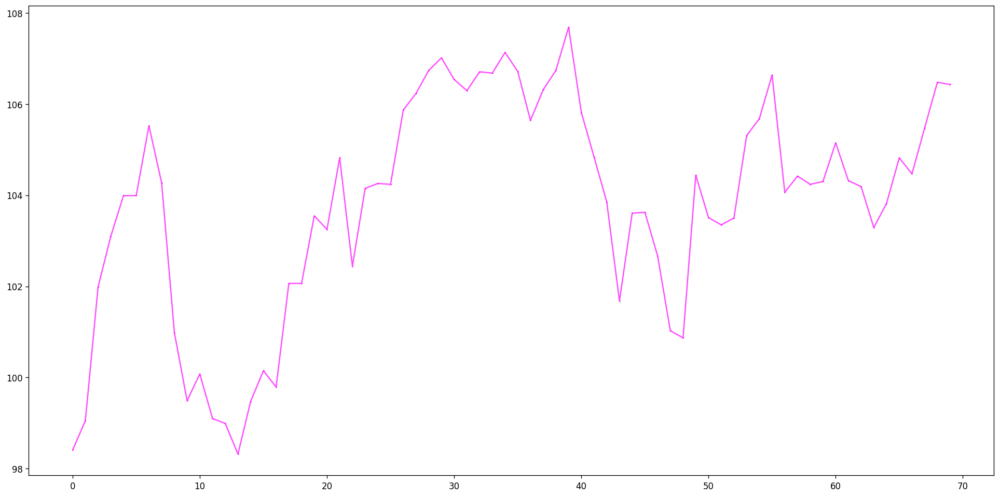

[(175, 183, 189, 195, 203), (999, 1007, 1011, 1014, 1015), (1620, 1625, 1635, 1644, 1647), (2303, 2305, 2308, 2313, 2315), (2438, 2441, 2447, 2450, 2453), (3752, 3759, 3765, 3769, 3771)]
[(584, 587, 591, 598, 606), (825, 827, 828, 831, 836), (1159, 1165, 1170, 1173, 1177), (1645, 1647, 1650, 1655, 1659), (1645, 1653, 1659, 1663, 1666), (1645, 1653, 1659, 1664, 1666), (1645, 1655, 1659, 1663, 1666), (1645, 1655, 1659, 1664, 1666), (2236, 2242, 2247, 2257, 2263), (2301, 2303, 2305, 2315, 2317), (2305, 2308, 2313, 2315, 2317), (2432, 2438, 2441, 2447, 2448), (2464, 2473, 2477, 2483, 2487), (2754, 2767, 2773, 2778, 2780), (2844, 2849, 2851, 2855, 2860), (3424, 3429, 3436, 3446, 3448), (3668, 3677, 3682, 3688, 3689), (3785, 3788, 3796, 3805, 3809), (3869, 3876, 3879, 3883, 3888)]
Ticker AETUF found 6 double top patterns, 19 double bottom patterns


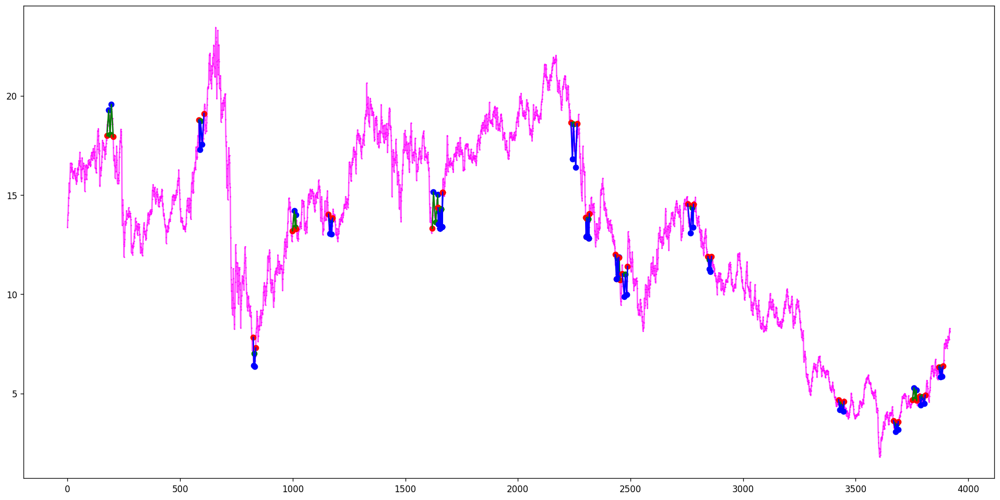

[(365, 373, 376, 379, 384)]
[(264, 265, 269, 272, 277), (720, 724, 727, 730, 740), (885, 888, 898, 899, 902), (952, 957, 959, 965, 967), (1209, 1213, 1220, 1221, 1223), (1232, 1235, 1238, 1242, 1249)]
Ticker AEXAY found 1 double top patterns, 6 double bottom patterns


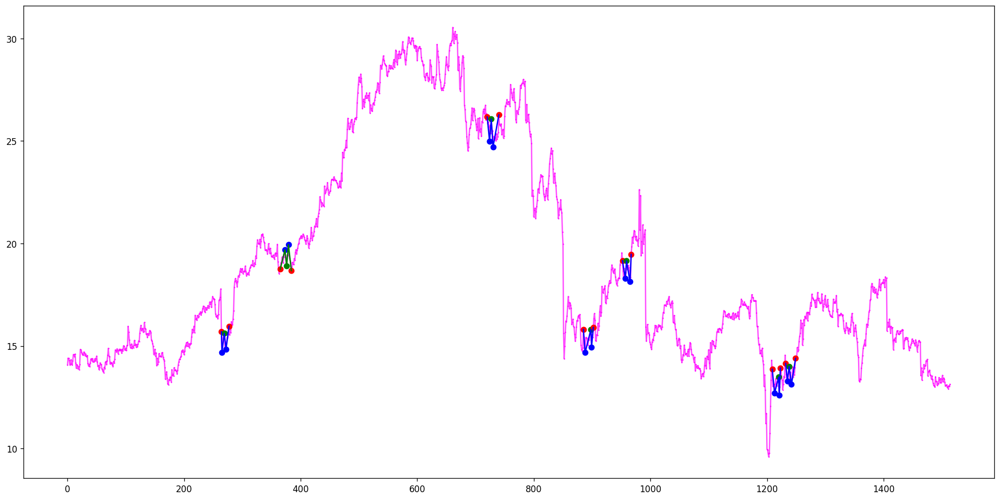

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(199, 205, 213, 217, 220), (534, 535, 538, 539, 543), (534, 535, 538, 540, 543), (674, 676, 678, 682, 693), (737, 739, 745, 750, 758), (785, 786, 788, 791, 794), (785, 787, 788, 791, 794), (811, 812, 814, 816, 817), (839, 842, 845, 847, 848), (942, 944, 948, 951, 960), (1070, 1071, 1075, 1076, 1079), (1132, 1133, 1136, 1138, 1140), (1132, 1133, 1136, 1139, 1140), (1132, 1135, 1136, 1139, 1140), (1132, 1133, 1136, 1141, 1143), (1132, 1133, 1136, 1142, 1143), (1132, 1135, 1136, 1141, 1143), (1132, 1135, 1136, 1142, 1143), (1137, 1138, 1140, 1142, 1143), (1132, 1133, 1136, 1146, 1148), (1132, 1133, 1136, 1147, 1148), (1132, 1135, 1136, 1146, 1148), (1132, 1135, 1136, 1147, 1148), (1137, 1138, 1140, 1146, 1148), (1137, 1138, 1140, 1147, 1148), (1137, 1139, 1140, 1146, 1148), (1137, 1139, 1140, 1147, 1148), (1140, 1141, 1143, 1146, 1148), (1140, 1141, 1143, 1147, 1148), (1140, 1142, 1143, 1147, 1148), (1163, 1164, 1169, 1173, 1175), (1163, 1164, 1169, 1174, 1175), (1163, 1168, 1169, 1173, 

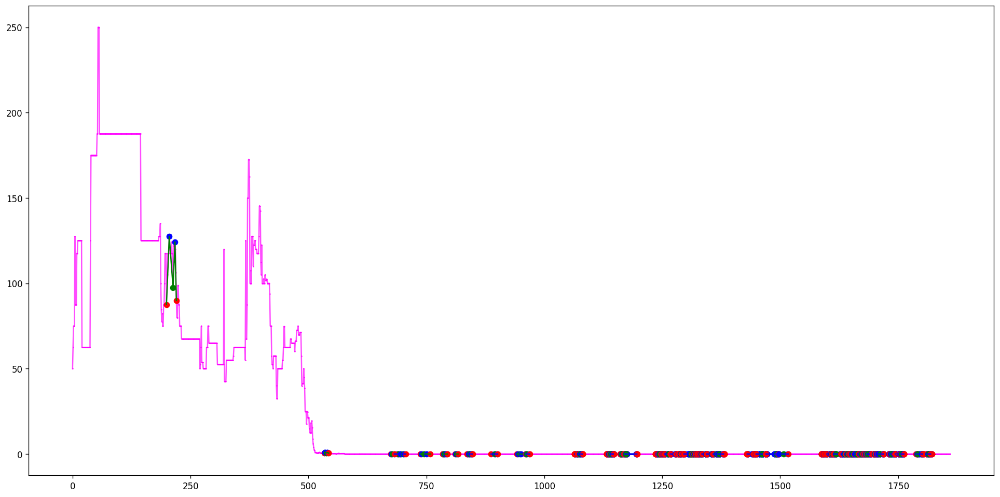

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(44, 46, 49, 50, 52), (44, 46, 49, 51, 52), (49, 50, 52, 56, 57), (44, 46, 49, 58, 59), (49, 50, 52, 58, 59), (49, 51, 52, 58, 59), (103, 105, 108, 112, 117), (103, 105, 108, 116, 117), (103, 107, 108, 116, 117), (324, 327, 328, 340, 349), (324, 327, 328, 348, 349), (897, 900, 905, 906, 907), (897, 902, 905, 906, 907), (1003, 1005, 1007, 1019, 1022), (1425, 1426, 1430, 1445, 1450), (1425, 1426, 1430, 1446, 1450), (2249, 2255, 2262, 2265, 2270), (2249, 2255, 2262, 2266, 2270), (2249, 2256, 2262, 2265, 2270), (2249, 2256, 2262, 2266, 2270), (2274, 2280, 2284, 2289, 2301), (2274, 2281, 2284, 2289, 2301), (2312, 2314, 2316, 2324, 2328), (2360, 2364, 2367, 2376, 2381), (2398, 2402, 2406, 2410, 2418), (2430, 2431, 2433, 2440, 2443), (2430, 2431, 2433, 2441, 2443), (2999, 3000, 3003, 3008, 3015), (3079, 3084, 3093, 3101, 3107), (3132, 3133, 3134, 3137, 3138), (3184, 3189, 3199, 3200, 3204), (3406, 3407, 3410, 3420, 3427), (3475, 3478, 3482, 3488, 3497), (3475, 3478, 3482, 3489, 3497), (3623,

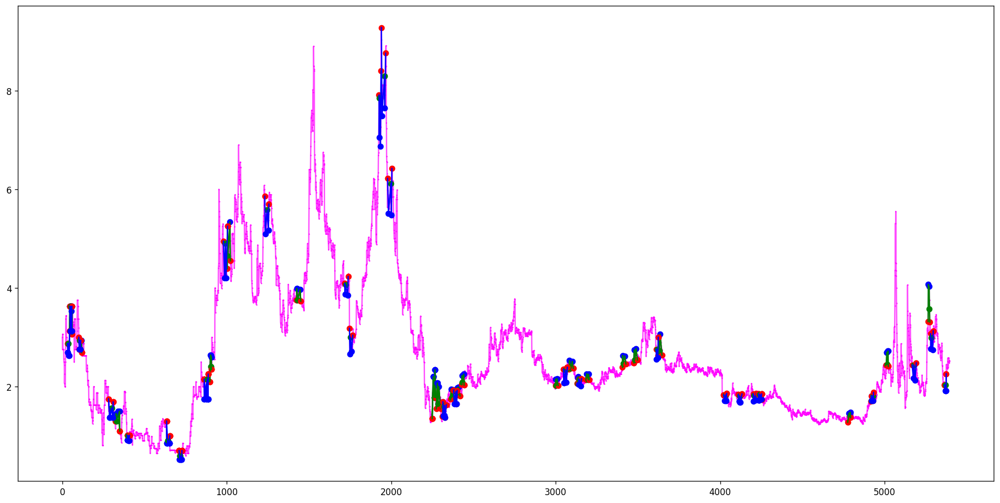

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(66, 69, 74, 83, 85), (85, 86, 87, 91, 96), (155, 157, 160, 164, 173), (187, 189, 191, 194, 196), (546, 547, 553, 555, 557), (546, 547, 553, 556, 557), (546, 552, 553, 556, 557), (546, 547, 553, 558, 559), (546, 552, 553, 558, 559), (611, 612, 615, 617, 620), (611, 612, 615, 619, 620), (611, 614, 615, 619, 620), (611, 612, 615, 622, 624), (611, 612, 615, 623, 624), (611, 614, 615, 622, 624), (611, 614, 615, 623, 624), (616, 617, 620, 622, 624), (616, 617, 620, 623, 624), (616, 619, 620, 623, 624), (647, 652, 658, 663, 669), (647, 652, 658, 664, 669), (647, 653, 658, 663, 669), (647, 653, 658, 664, 669), (730, 731, 732, 736, 737), (737, 738, 740, 742, 743), (730, 731, 737, 738, 744), (730, 731, 737, 739, 744), (730, 731, 737, 741, 744), (730, 731, 737, 742, 744), (730, 736, 737, 741, 744), (730, 736, 737, 742, 744), (719, 724, 728, 731, 746), (719, 724, 728, 736, 746), (719, 724, 728, 738, 746), (719, 724, 728, 739, 746), (719, 724, 728, 741, 746), (719, 724, 728, 742, 746), (766, 769,

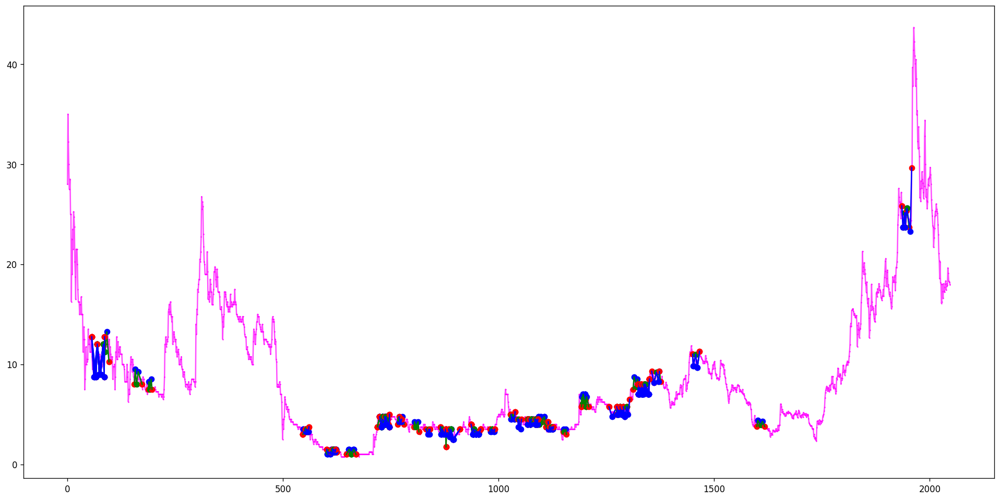

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(220, 221, 227, 229, 242), (778, 783, 784, 790, 791), (801, 804, 806, 811, 814), (943, 944, 949, 955, 960), (1053, 1054, 1056, 1059, 1060), (2083, 2084, 2087, 2088, 2089), (2478, 2481, 2482, 2485, 2486), (2603, 2604, 2609, 2611, 2617), (2896, 2898, 2908, 2913, 2919), (2970, 2972, 2979, 2991, 2992), (3448, 3451, 3453, 3458, 3472), (3783, 3787, 3790, 3791, 3792), (4088, 4100, 4105, 4107, 4111), (4088, 4100, 4105, 4108, 4111), (4366, 4371, 4375, 4384, 4389), (4448, 4449, 4450, 4453, 4458), (4710, 4712, 4721, 4726, 4731), (4801, 4803, 4811, 4814, 4821), (4801, 4805, 4811, 4814, 4821), (4948, 4954, 4963, 4974, 4975)]
[(1865, 1866, 1867, 1870, 1871), (2039, 2042, 2043, 2046, 2048), (2336, 2339, 2340, 2343, 2346), (2392, 2397, 2401, 2404, 2406), (2481, 2482, 2485, 2486, 2488), (3252, 3255, 3258, 3263, 3266), (3446, 3448, 3451, 3453, 3458), (3517, 3520, 3523, 3528, 3533), (3782, 3783, 3787, 3790, 3791), (4024, 4031, 4035, 4041, 4042), (4190, 4194, 4197, 4201, 4207), (4190, 4194, 4197, 4202, 4

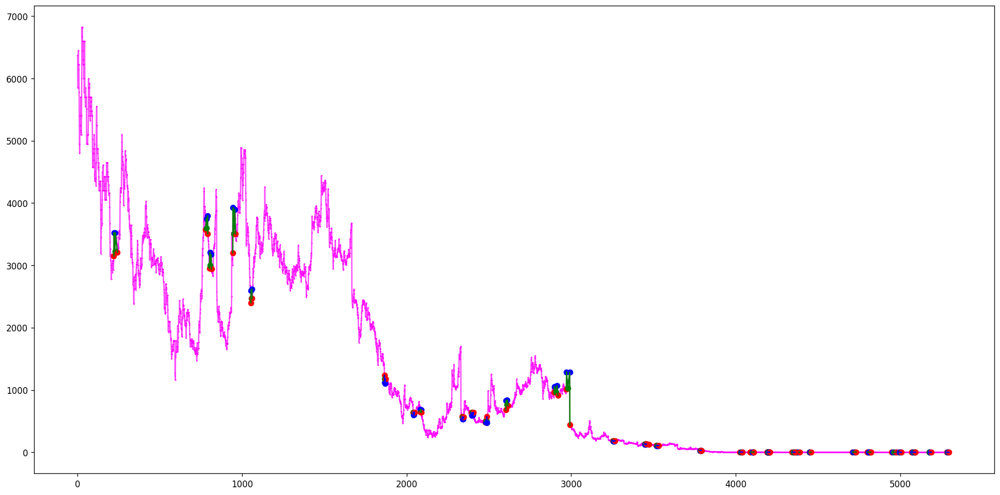

[(752, 759, 768, 776, 780)]
[]
Ticker AFAVX found 1 double top patterns, 0 double bottom patterns


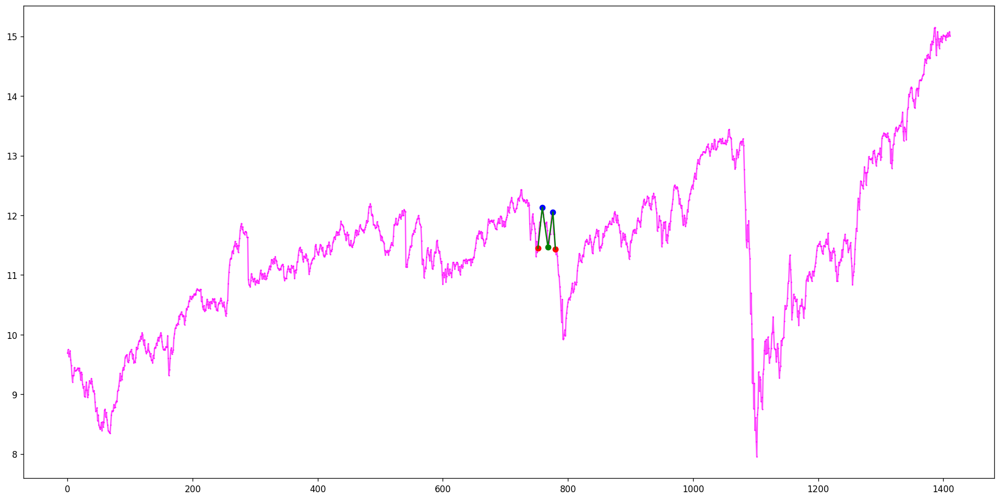

[(539, 545, 547, 552, 559), (2306, 2313, 2322, 2330, 2333)]
[(484, 487, 492, 497, 502)]
Ticker AFAZX found 2 double top patterns, 1 double bottom patterns


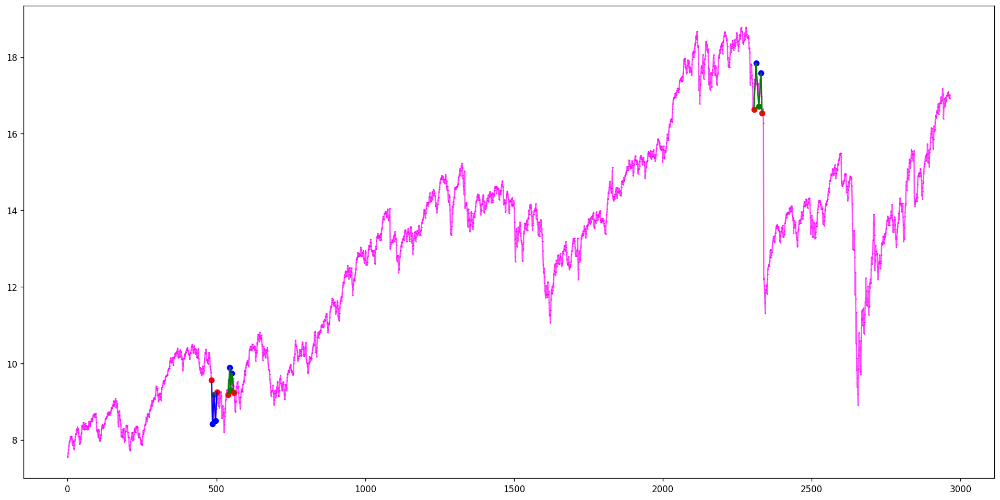

[(1693, 1698, 1704, 1707, 1711)]
[]
Ticker AFB found 1 double top patterns, 0 double bottom patterns


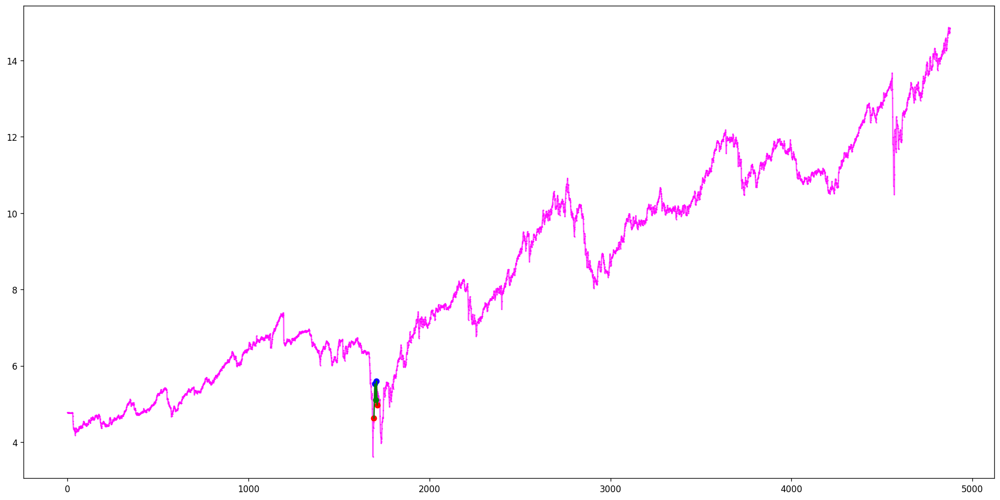

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(319, 320, 321, 324, 332), (319, 320, 321, 325, 332), (319, 320, 321, 328, 332), (3157, 3158, 3180, 3182, 3183), (3157, 3177, 3180, 3182, 3183), (3655, 3659, 3672, 3673, 3678), (3655, 3659, 3672, 3677, 3678), (4292, 4293, 4294, 4299, 4300)]
[(320, 321, 324, 326, 328), (2084, 2086, 2091, 2093, 2099), (2084, 2086, 2091, 2096, 2099), (2084, 2090, 2091, 2096, 2099), (4161, 4162, 4164, 4166, 4172), (4495, 4496, 4497, 4501, 4506), (4495, 4496, 4497, 4505, 4506)]
Ticker AFBA found 8 double top patterns, 7 double bottom patterns


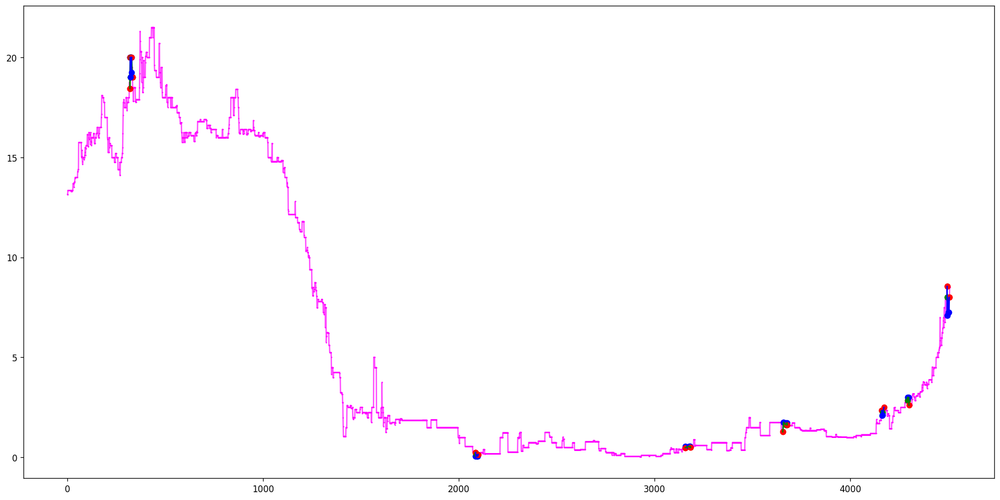

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1426, 1428, 1435, 1440, 1448), (1426, 1428, 1435, 1443, 1448), (1426, 1430, 1435, 1440, 1448), (1426, 1430, 1435, 1443, 1448), (1426, 1431, 1435, 1440, 1448), (1426, 1431, 1435, 1443, 1448), (1590, 1593, 1603, 1606, 1617), (1590, 1593, 1603, 1607, 1617), (1590, 1594, 1603, 1606, 1617), (1590, 1594, 1603, 1607, 1617), (2217, 2222, 2228, 2233, 2235), (2217, 2222, 2228, 2234, 2235), (2217, 2224, 2228, 2233, 2235), (2217, 2224, 2228, 2234, 2235), (2217, 2227, 2228, 2234, 2235), (2486, 2488, 2491, 2499, 2502), (2486, 2488, 2491, 2501, 2502), (2731, 2733, 2741, 2742, 2746), (2731, 2735, 2741, 2742, 2746), (2731, 2737, 2741, 2742, 2746), (2944, 2948, 2952, 2958, 2968), (3340, 3344, 3347, 3348, 3353), (3347, 3348, 3353, 3354, 3356), (3512, 3513, 3518, 3526, 3536), (3808, 3815, 3820, 3825, 3831), (3808, 3815, 3820, 3826, 3831), (3962, 3963, 3968, 3970, 3974), (3962, 3963, 3968, 3971, 3974), (4142, 4144, 4153, 4157, 4160), (4247, 4251, 4254, 4258, 4266), (4247, 4251, 4254, 4259, 4266), (4351, 

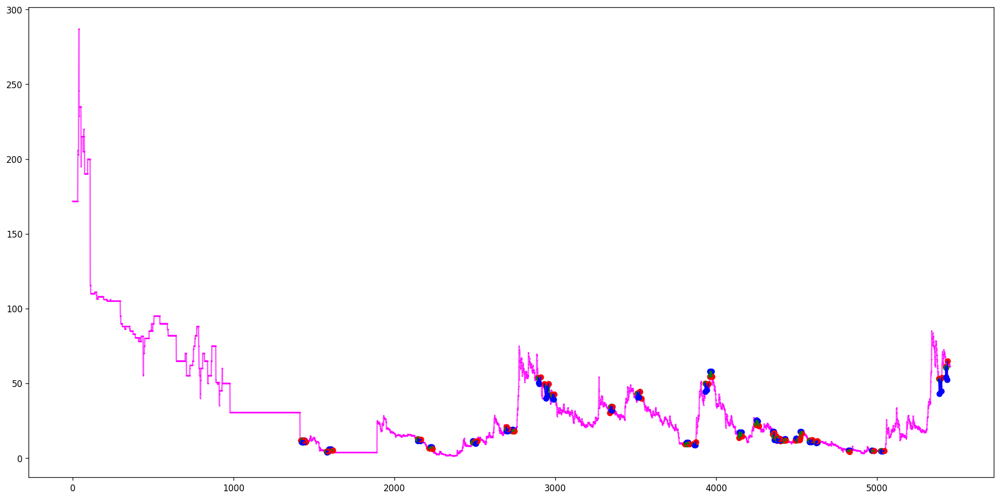

[]
[]
Ticker AFCG found 0 double top patterns, 0 double bottom patterns


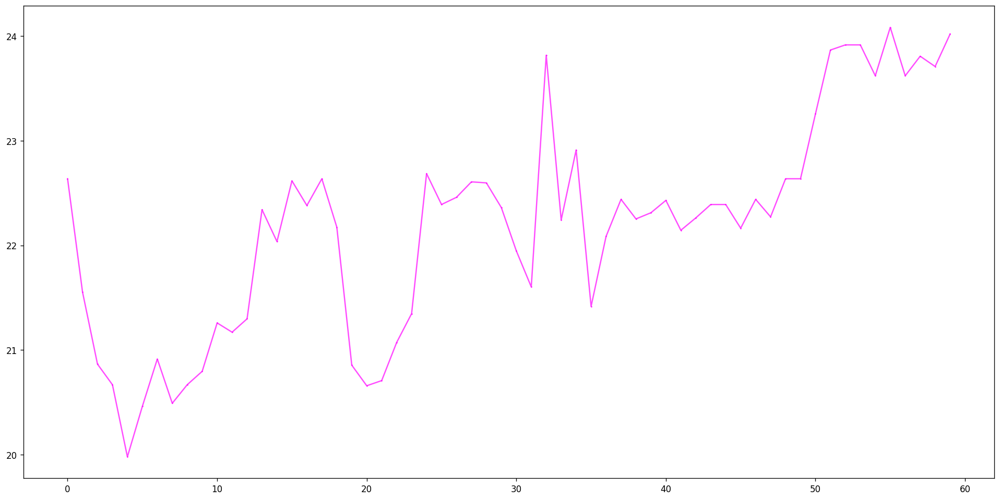

[(806, 807, 809, 812, 814), (874, 880, 883, 887, 893), (1527, 1534, 1540, 1545, 1549), (1569, 1574, 1577, 1582, 1589)]
[(1514, 1517, 1522, 1526, 1532)]
Ticker AFDIX found 4 double top patterns, 1 double bottom patterns


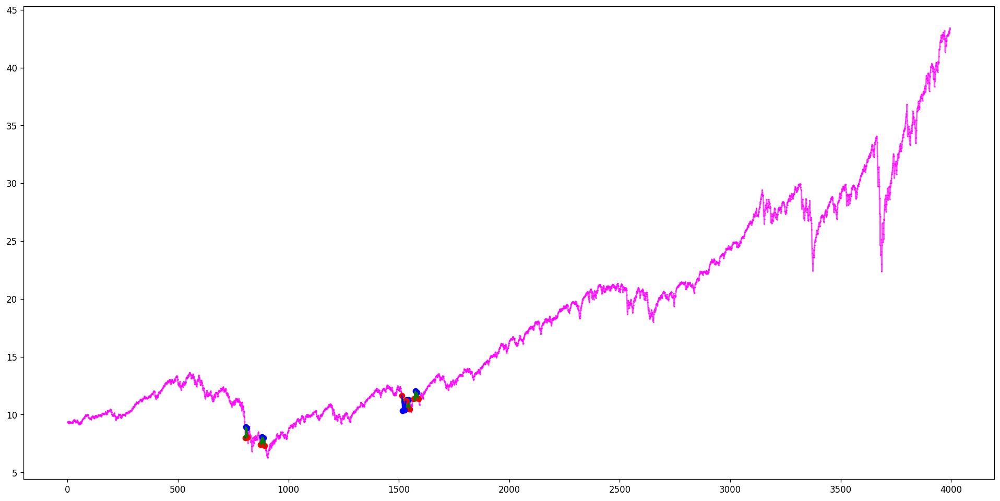

[]
[(1304, 1307, 1314, 1318, 1325)]
Ticker AFDVX found 0 double top patterns, 1 double bottom patterns


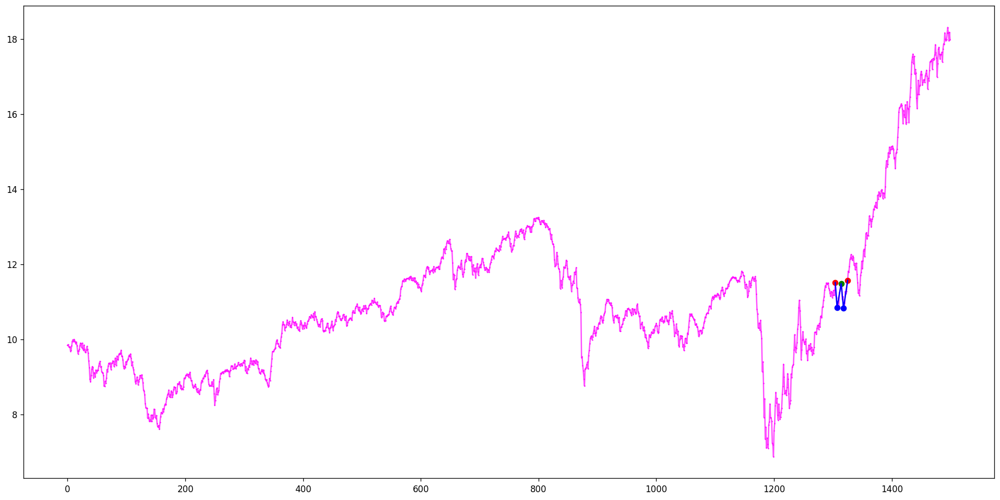

[(2414, 2418, 2425, 2427, 2435), (5342, 5346, 5355, 5361, 5366)]
[]
Ticker AFE.JO found 2 double top patterns, 0 double bottom patterns


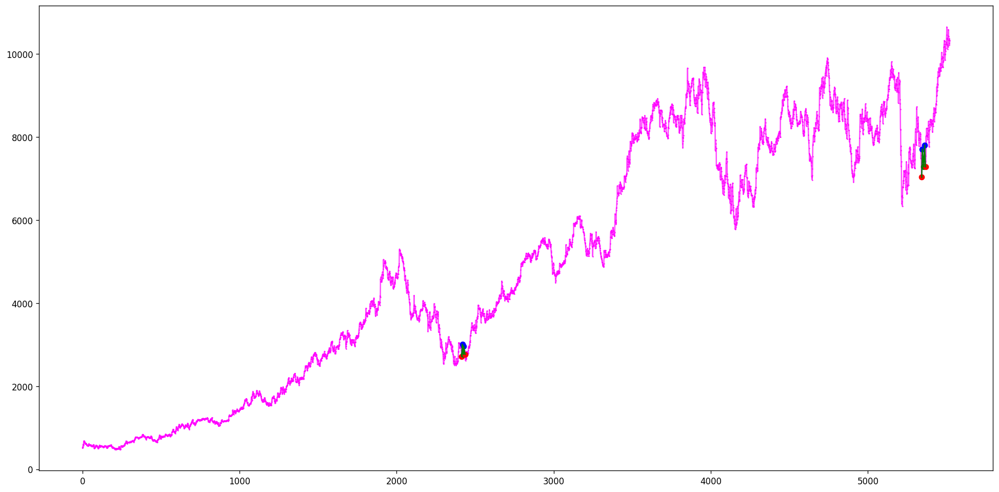

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(16, 17, 21, 23, 26), (16, 18, 21, 23, 26), (142, 143, 146, 154, 157), (162, 163, 164, 170, 172), (162, 163, 164, 171, 172), (164, 165, 168, 170, 172), (164, 165, 168, 171, 172), (192, 193, 196, 198, 199), (231, 232, 234, 237, 238), (516, 518, 524, 526, 530), (516, 519, 524, 526, 530), (587, 589, 592, 597, 609), (587, 589, 592, 605, 609), (942, 943, 946, 956, 959), (942, 943, 946, 957, 959), (1815, 1818, 1819, 1824, 1828), (1815, 1818, 1819, 1826, 1828)]
[(15, 16, 17, 21, 23), (23, 37, 41, 46, 51), (99, 105, 108, 115, 123), (99, 105, 108, 118, 123), (99, 105, 108, 121, 123), (163, 164, 165, 168, 170), (163, 164, 165, 169, 170), (163, 164, 165, 176, 187), (165, 168, 170, 176, 187), (165, 169, 170, 176, 187), (171, 172, 173, 176, 187), (175, 176, 180, 183, 187), (193, 196, 198, 200, 201), (220, 222, 226, 229, 230), (230, 231, 232, 238, 239), (260, 261, 264, 267, 272), (298, 299, 300, 303, 306), (298, 299, 300, 305, 306), (393, 394, 395, 401, 404), (428, 434, 437, 443, 449), (428, 435, 4

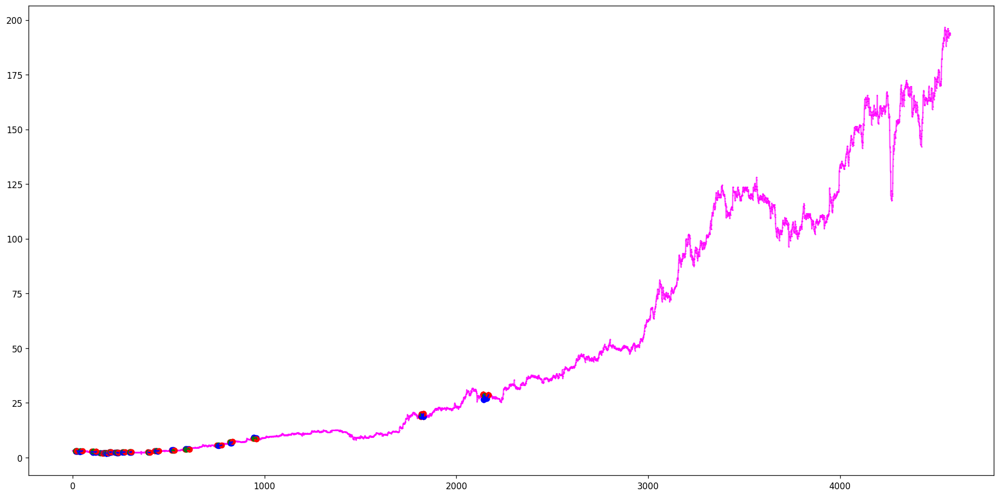

[]
[]
Ticker AFGC found 0 double top patterns, 0 double bottom patterns


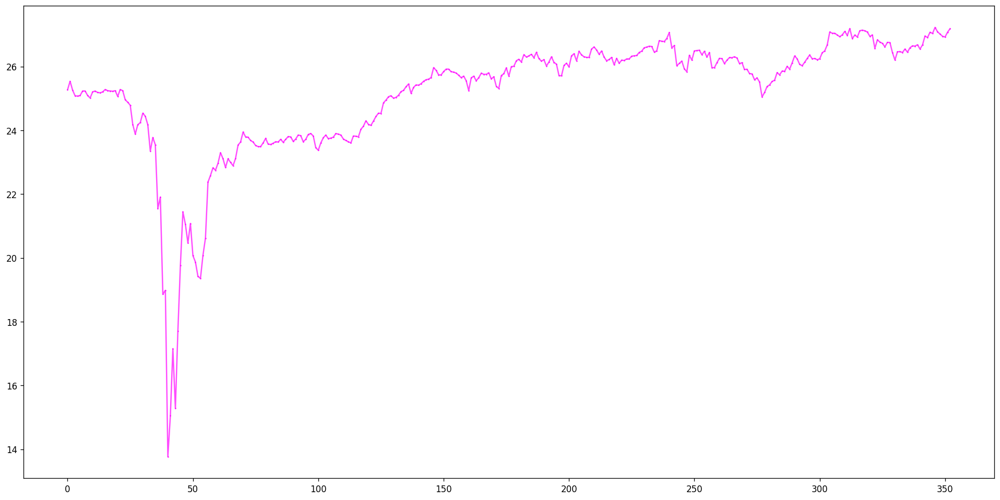

[]
[]
Ticker AFGD found 0 double top patterns, 0 double bottom patterns


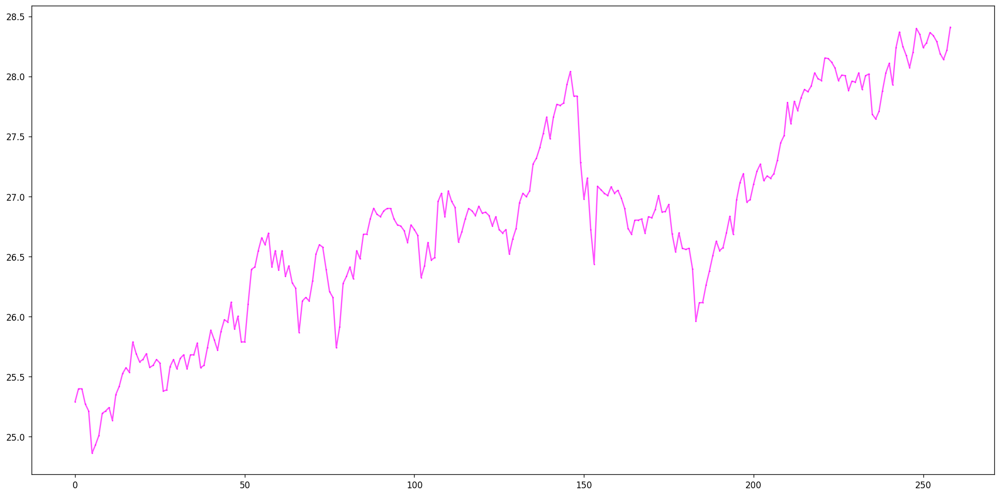

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1022, 1028, 1032, 1039, 1043), (1624, 1627, 1633, 1635, 1638)]
[(547, 548, 554, 558, 571), (1475, 1489, 1492, 1493, 1495), (1630, 1633, 1635, 1638, 1642), (1651, 1653, 1657, 1661, 1668)]
Ticker AFH.JO found 2 double top patterns, 4 double bottom patterns


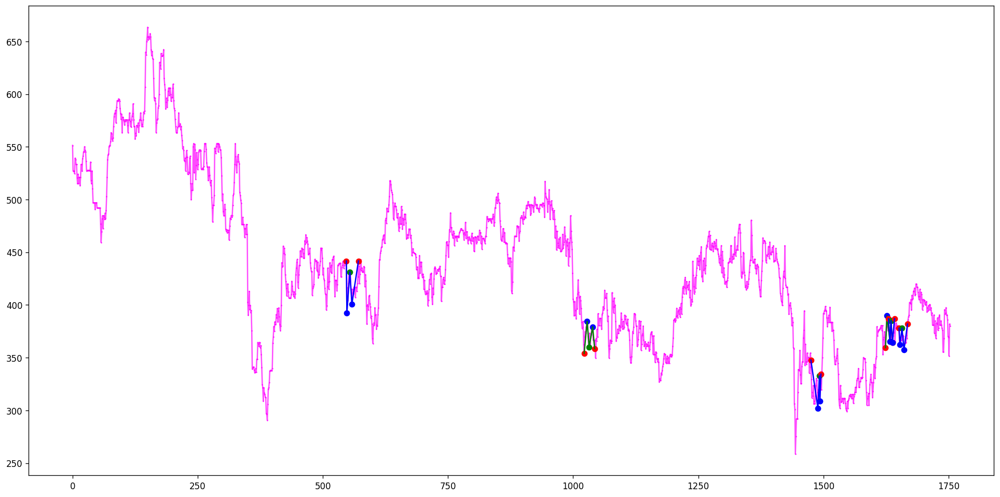

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(246, 247, 251, 254, 263), (270, 273, 274, 285, 291), (270, 273, 274, 286, 291)]
[(136, 137, 138, 141, 149), (136, 137, 138, 146, 149), (136, 137, 138, 148, 149), (139, 140, 142, 146, 149), (139, 140, 142, 148, 149), (139, 141, 142, 148, 149), (152, 157, 160, 164, 165), (316, 317, 321, 324, 328), (316, 318, 321, 324, 328)]
Ticker AFHBL found 3 double top patterns, 9 double bottom patterns


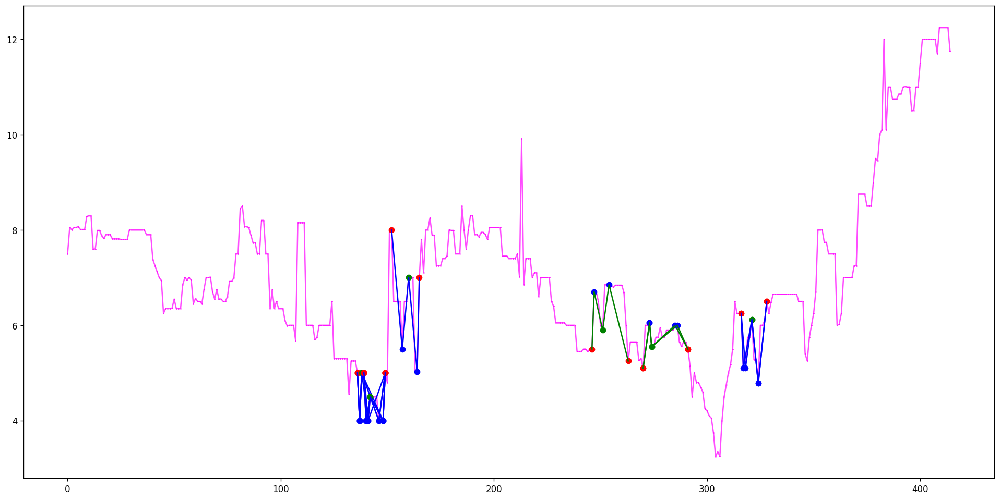

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(359, 362, 366, 372, 373), (778, 779, 783, 790, 793), (944, 947, 956, 965, 967), (1170, 1174, 1177, 1187, 1197), (1170, 1175, 1177, 1187, 1197), (1228, 1234, 1240, 1244, 1252), (1228, 1234, 1240, 1245, 1252), (1382, 1383, 1385, 1391, 1404), (1801, 1802, 1803, 1806, 1807), (1986, 1987, 1990, 1993, 1995), (1986, 1988, 1990, 1993, 1995), (2014, 2016, 2017, 2023, 2024), (2033, 2041, 2043, 2048, 2051), (2033, 2041, 2043, 2050, 2051)]
[(24, 27, 28, 32, 40), (24, 27, 28, 33, 40), (92, 97, 99, 112, 114), (117, 122, 126, 129, 134), (476, 478, 483, 485, 491), (1043, 1056, 1061, 1065, 1067), (1358, 1367, 1373, 1380, 1381), (1358, 1368, 1373, 1380, 1381), (1802, 1803, 1805, 1807, 1809), (1802, 1803, 1805, 1808, 1809), (1802, 1804, 1805, 1808, 1809), (1855, 1856, 1858, 1863, 1864), (2011, 2013, 2016, 2018, 2020), (2011, 2013, 2016, 2021, 2023), (2011, 2013, 2016, 2022, 2023), (2011, 2014, 2016, 2021, 2023), (2011, 2014, 2016, 2022, 2023), (2016, 2017, 2020, 2022, 2023), (2011, 2013, 2016, 2024, 20

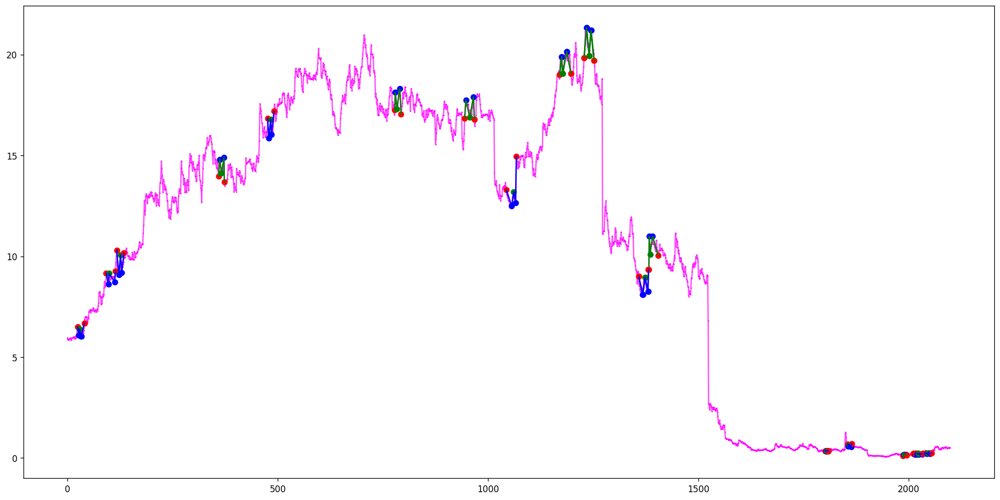

[(3878, 3880, 3883, 3893, 3897)]
[(1732, 1733, 1738, 1742, 1746), (1771, 1772, 1776, 1780, 1798), (1890, 1893, 1895, 1913, 1918)]
Ticker AFHL.TA found 1 double top patterns, 3 double bottom patterns


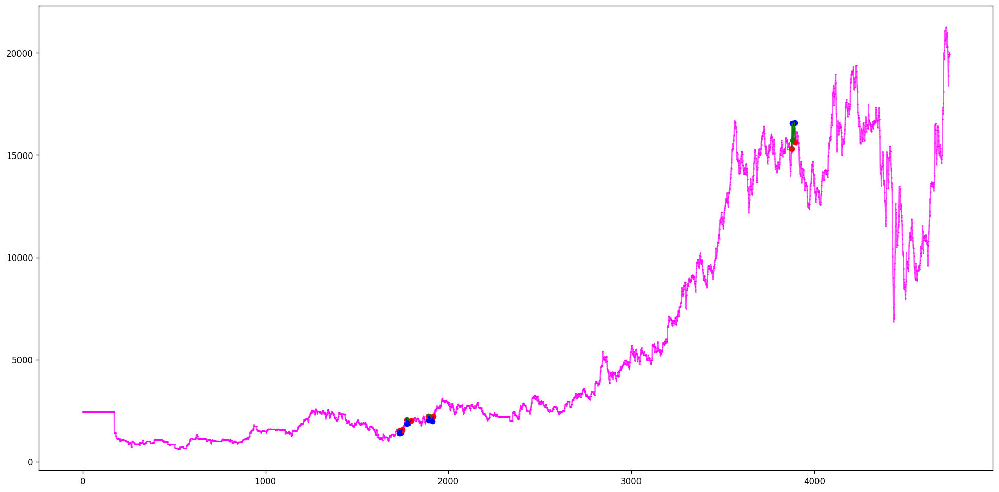

[]
[]
Ticker AFHP.L found 0 double top patterns, 0 double bottom patterns


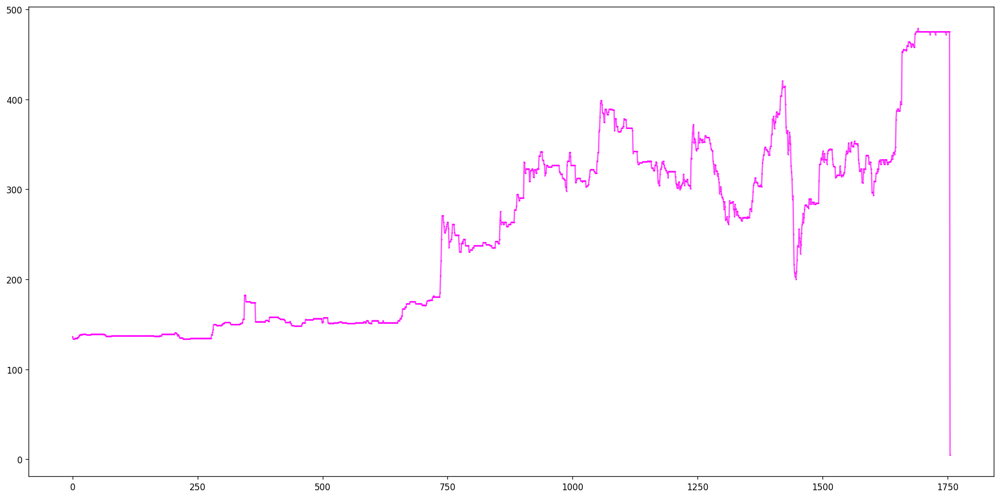

[(245, 252, 255, 269, 271), (513, 516, 522, 524, 529), (796, 802, 806, 815, 817), (893, 905, 912, 915, 916), (1183, 1184, 1185, 1190, 1191)]
[(655, 659, 664, 672, 673), (746, 747, 757, 761, 765), (889, 893, 905, 912, 915), (915, 916, 919, 928, 931)]
Ticker AFI found 5 double top patterns, 4 double bottom patterns


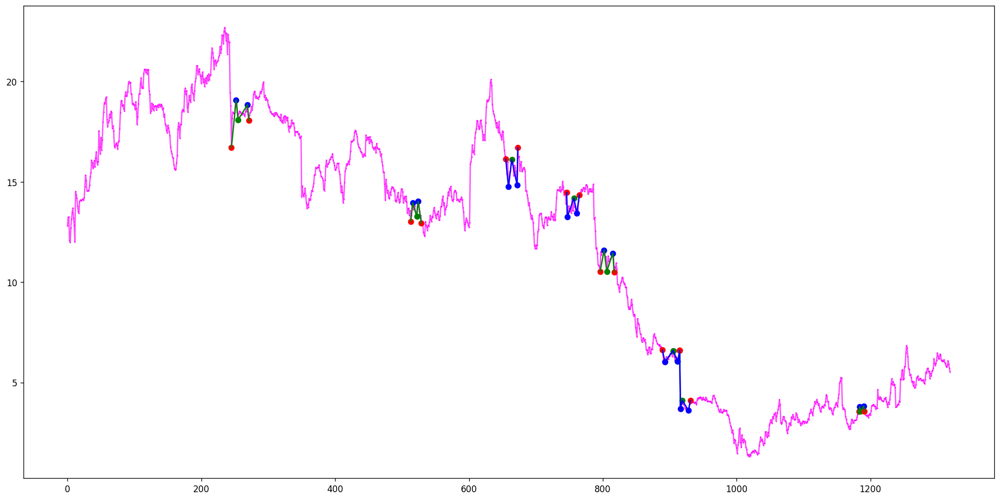

[]
[]
Ticker AFIB found 0 double top patterns, 0 double bottom patterns


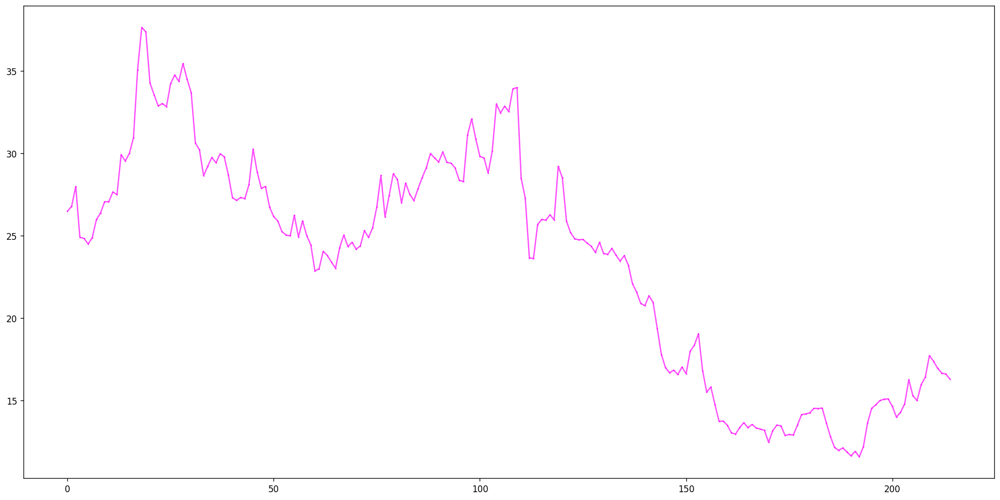

[(84, 85, 96, 102, 103), (103, 107, 114, 118, 122), (619, 621, 625, 631, 637)]
[(595, 596, 600, 605, 609)]
Ticker AFIN found 3 double top patterns, 1 double bottom patterns


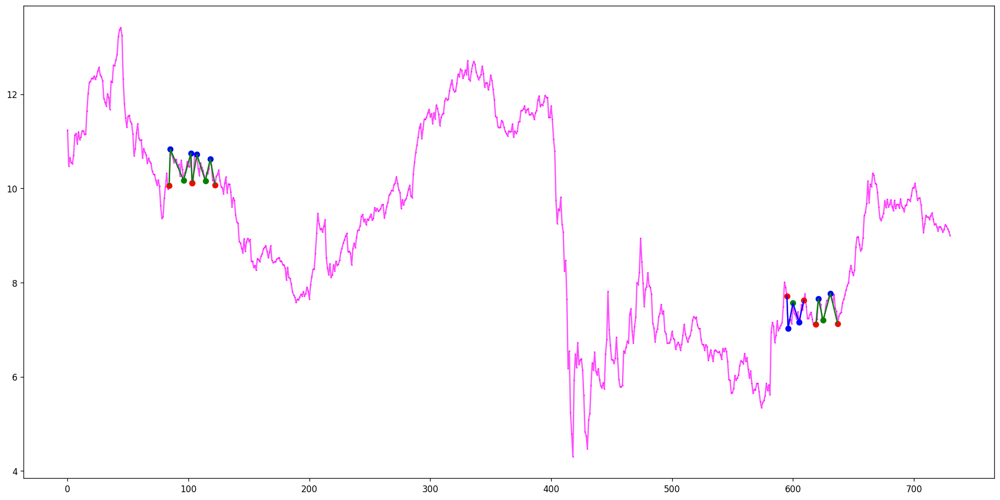

[(264, 270, 275, 279, 289)]
[]
Ticker AFINP found 1 double top patterns, 0 double bottom patterns


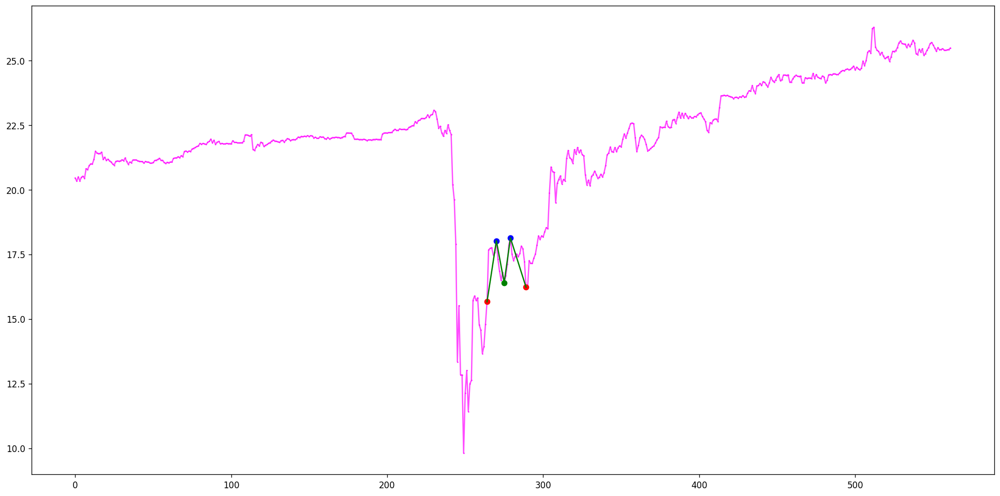

[(1603, 1606, 1610, 1618, 1624)]
[(954, 958, 964, 967, 972), (1291, 1298, 1303, 1305, 1311), (1598, 1601, 1606, 1610, 1618)]
Ticker AFJAX found 1 double top patterns, 3 double bottom patterns


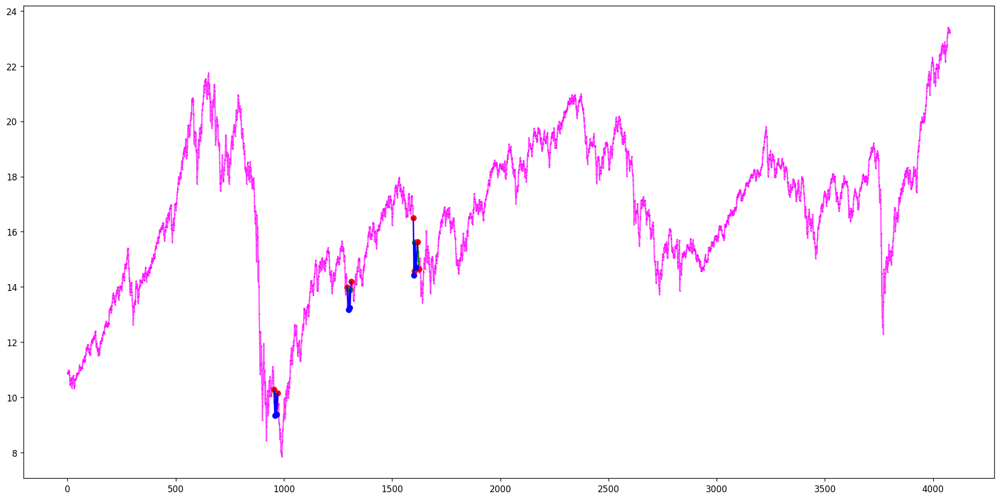

[(1603, 1606, 1610, 1618, 1624)]
[(954, 958, 964, 967, 972), (1291, 1298, 1303, 1305, 1311), (1598, 1601, 1606, 1610, 1618)]
Ticker AFJCX found 1 double top patterns, 3 double bottom patterns


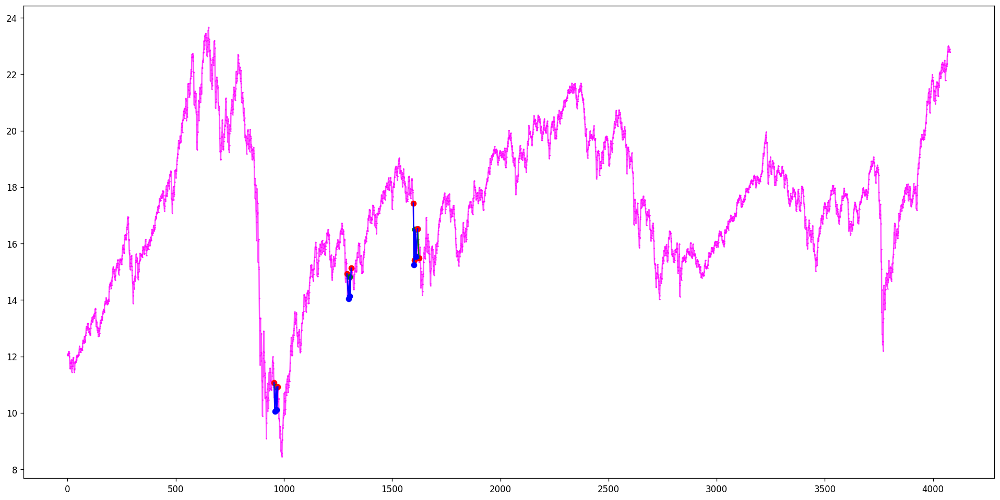

[(467, 475, 478, 487, 495)]
[(90, 92, 96, 102, 110), (1991, 1996, 2001, 2003, 2013)]
Ticker AFK found 1 double top patterns, 2 double bottom patterns


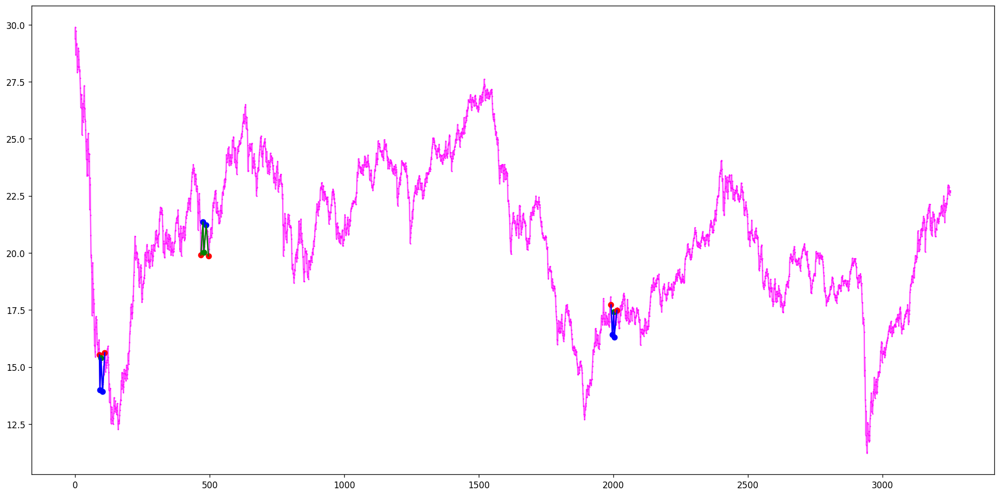

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(153, 166, 172, 177, 179), (153, 166, 172, 178, 179), (153, 167, 172, 177, 179), (153, 167, 172, 178, 179), (206, 207, 208, 214, 216), (206, 207, 208, 215, 216), (209, 210, 213, 215, 216), (236, 239, 244, 247, 248), (236, 239, 244, 249, 250), (236, 243, 244, 249, 250), (248, 249, 250, 257, 269), (248, 249, 250, 264, 269), (248, 249, 250, 268, 269), (250, 251, 256, 264, 269), (250, 251, 256, 268, 269), (250, 255, 256, 264, 269), (250, 255, 256, 268, 269), (256, 257, 258, 268, 269), (363, 368, 370, 373, 374), (363, 368, 370, 377, 378), (363, 369, 370, 377, 378), (370, 371, 374, 377, 378), (501, 502, 507, 510, 512), (501, 502, 507, 517, 524), (501, 502, 507, 523, 524), (501, 506, 507, 517, 524), (501, 506, 507, 523, 524), (509, 510, 512, 523, 524), (509, 510, 512, 528, 531), (509, 510, 512, 530, 531), (516, 517, 524, 528, 531), (516, 517, 524, 530, 531), (516, 523, 524, 530, 531), (653, 656, 659, 662, 666), (653, 656, 659, 663, 666), (682, 691, 696, 702, 707), (682, 691, 696, 703, 707), 

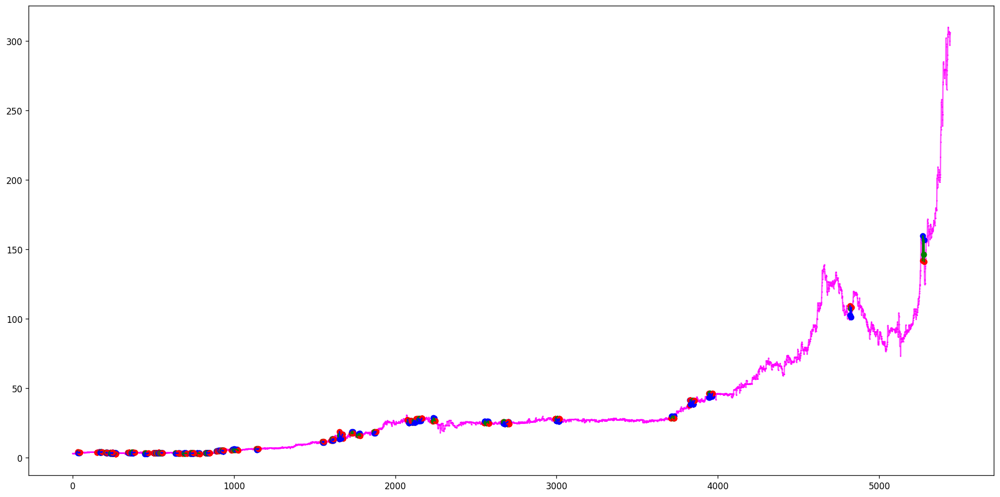

[(1378, 1383, 1390, 1396, 1400)]
[(138, 148, 151, 157, 161), (595, 598, 604, 611, 620), (1008, 1013, 1018, 1019, 1034), (1138, 1139, 1140, 1146, 1149), (1397, 1400, 1409, 1419, 1424), (1730, 1736, 1744, 1757, 1758)]
Ticker AFKS.ME found 1 double top patterns, 6 double bottom patterns


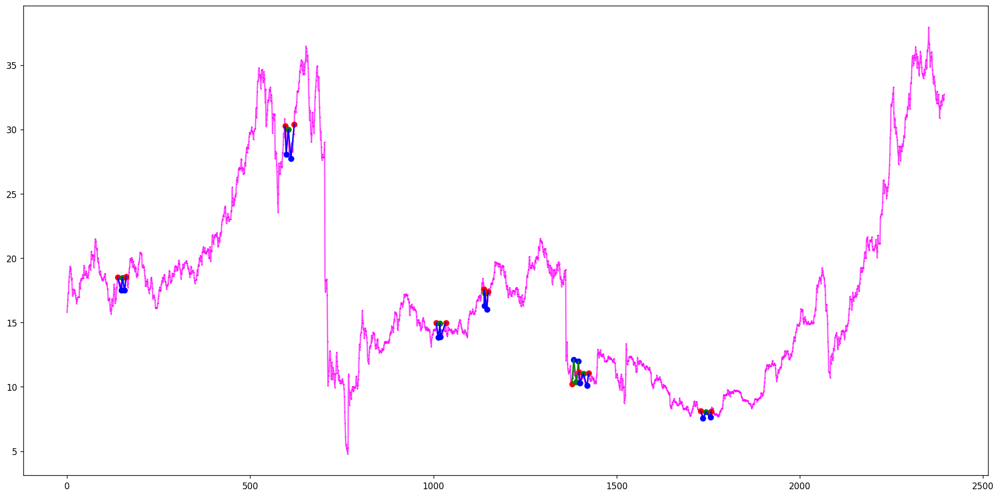

[(264, 268, 272, 278, 286), (503, 505, 518, 520, 522), (2251, 2253, 2260, 2263, 2269), (2355, 2361, 2362, 2366, 2369), (2412, 2417, 2419, 2423, 2430), (2972, 2974, 2977, 2982, 2989), (5095, 5099, 5106, 5112, 5117)]
[(1910, 1915, 1921, 1923, 1933), (2020, 2022, 2024, 2034, 2042), (2240, 2241, 2245, 2251, 2252), (2374, 2380, 2383, 2393, 2396), (4760, 4765, 4767, 4774, 4785)]
Ticker AFL found 7 double top patterns, 5 double bottom patterns


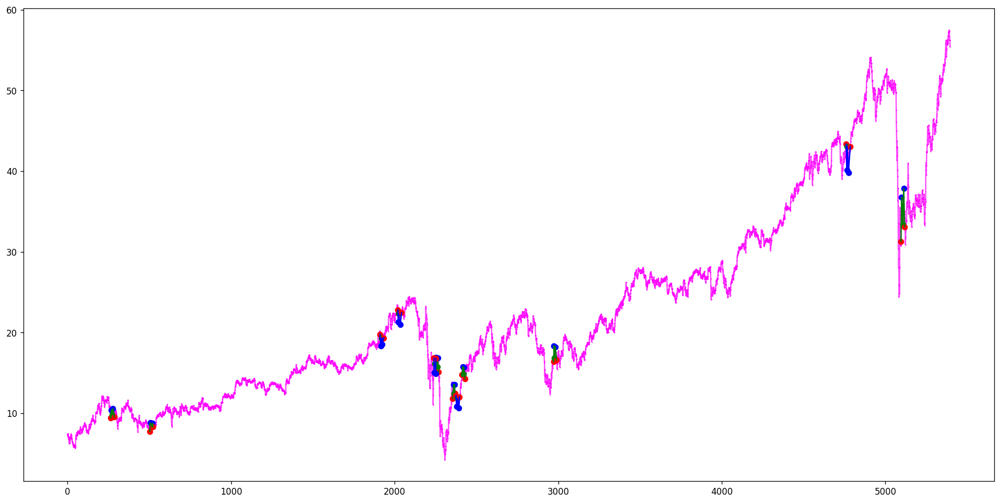

[(232, 236, 240, 241, 245), (3109, 3113, 3119, 3125, 3133)]
[(243, 247, 251, 253, 257), (243, 247, 251, 254, 257), (603, 608, 611, 618, 627), (2547, 2549, 2559, 2568, 2575), (2775, 2780, 2783, 2788, 2800), (3216, 3219, 3225, 3229, 3237)]
Ticker AFL.SG found 2 double top patterns, 6 double bottom patterns


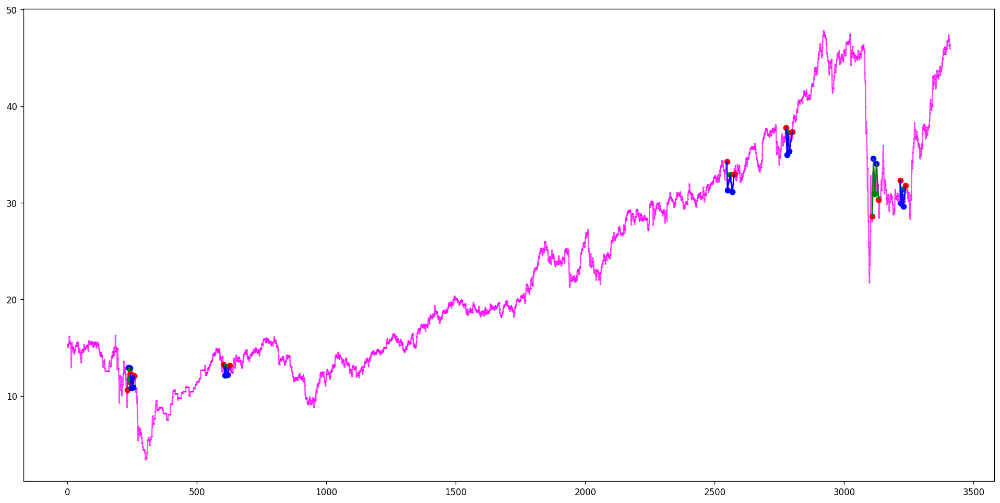

[]
[]
Ticker AFLG found 0 double top patterns, 0 double bottom patterns


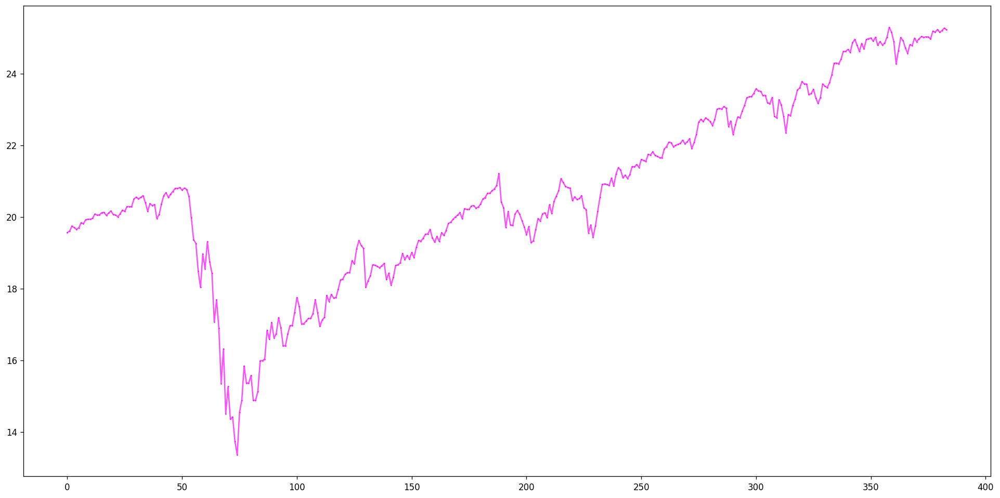

[(777, 790, 798, 800, 801), (1006, 1008, 1013, 1019, 1020)]
[(41, 45, 48, 56, 62), (387, 389, 393, 396, 413), (2107, 2109, 2113, 2119, 2122)]
Ticker AFLT.ME found 2 double top patterns, 3 double bottom patterns


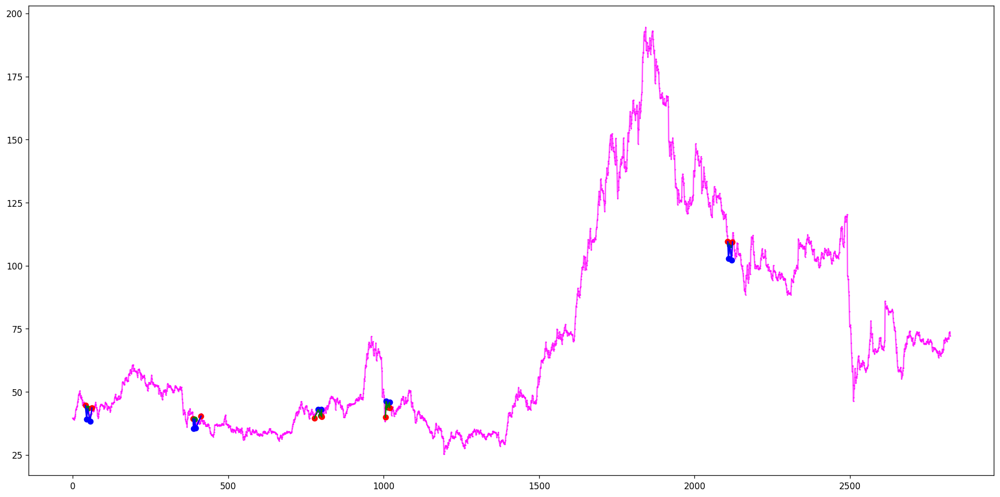

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(894, 895, 902, 906, 911), (948, 950, 952, 958, 963), (1002, 1006, 1010, 1015, 1017), (992, 995, 998, 1006, 1018), (1921, 1922, 1928, 1930, 1932), (2007, 2012, 2018, 2020, 2025), (2007, 2013, 2018, 2020, 2025), (2073, 2074, 2082, 2088, 2091), (2190, 2196, 2202, 2212, 2215), (3058, 3062, 3064, 3069, 3072), (3177, 3178, 3187, 3190, 3193), (3177, 3179, 3187, 3190, 3193), (3390, 3394, 3395, 3398, 3400), (3657, 3660, 3663, 3669, 3672), (3909, 3919, 3927, 3931, 3933), (3997, 4000, 4005, 4011, 4014), (4132, 4136, 4141, 4147, 4150)]
[(880, 887, 889, 894, 895), (1043, 1048, 1050, 1055, 1057), (1078, 1082, 1083, 1086, 1089), (1143, 1146, 1149, 1152, 1157), (1185, 1188, 1191, 1194, 1198), (1452, 1455, 1457, 1464, 1466), (1517, 1524, 1530, 1534, 1538), (1638, 1646, 1649, 1655, 1665), (1790, 1792, 1795, 1798, 1802), (1915, 1918, 1922, 1928, 1930), (1915, 1918, 1930, 1932, 1937), (2243, 2245, 2248, 2253, 2256), (2243, 2245, 2248, 2254, 2256), (2748, 2756, 2762, 2768, 2771), (3081, 3083, 3090, 3101,

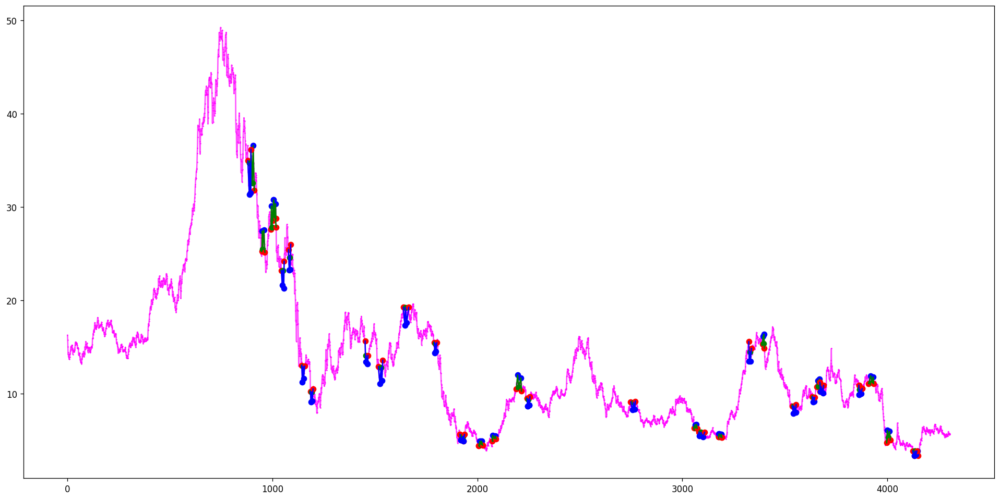

[]
[]
Ticker AFM.JF found 0 double top patterns, 0 double bottom patterns


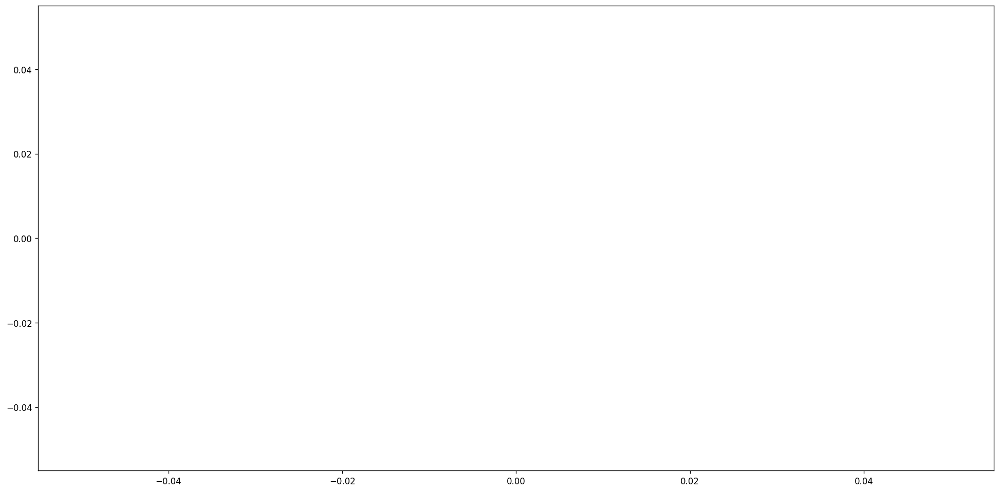

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(92, 94, 102, 105, 107), (263, 267, 273, 275, 284), (868, 872, 875, 878, 884), (919, 927, 937, 945, 946), (919, 928, 937, 945, 946), (1280, 1283, 1288, 1294, 1299), (1403, 1408, 1418, 1423, 1427)]
[(94, 102, 105, 109, 111), (260, 263, 267, 273, 275), (306, 309, 310, 317, 319), (377, 378, 381, 386, 390), (460, 465, 466, 473, 476), (568, 571, 572, 578, 581), (568, 571, 572, 580, 581), (592, 593, 597, 600, 601), (592, 594, 597, 600, 601), (654, 656, 658, 667, 675), (818, 820, 827, 828, 832), (818, 820, 827, 829, 832), (835, 837, 839, 842, 845), (860, 861, 863, 868, 872), (1235, 1239, 1242, 1247, 1253), (1230, 1231, 1235, 1247, 1258), (1300, 1307, 1313, 1319, 1324), (1408, 1418, 1423, 1427, 1428), (1602, 1604, 1609, 1610, 1613), (1620, 1622, 1626, 1631, 1633)]
Ticker AFMD found 7 double top patterns, 20 double bottom patterns


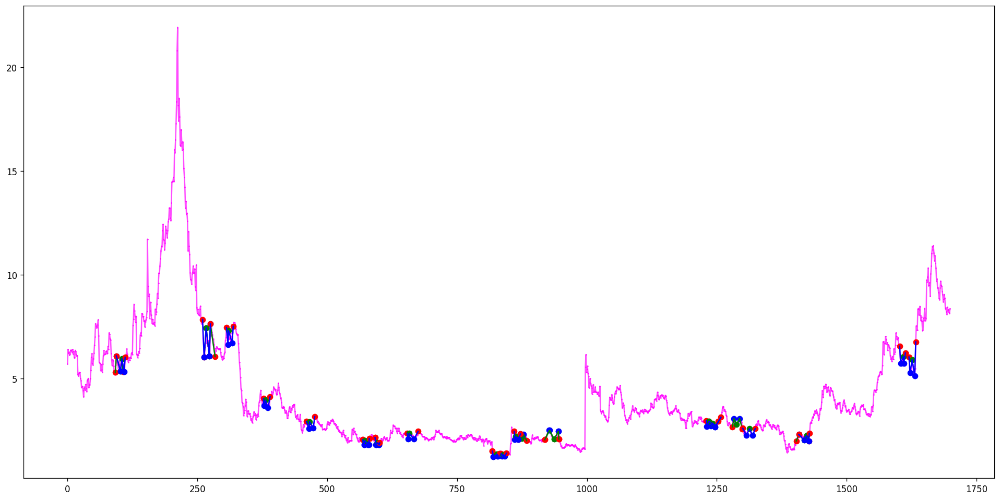

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(269, 271, 273, 276, 277), (356, 358, 363, 365, 366), (877, 881, 888, 893, 894), (1156, 1158, 1162, 1163, 1166), (1176, 1177, 1178, 1182, 1185), (1195, 1197, 1204, 1205, 1206), (1375, 1378, 1383, 1388, 1392), (4497, 4498, 4499, 4502, 4503)]
[(855, 865, 867, 871, 873), (1142, 1147, 1150, 1155, 1156), (1558, 1559, 1562, 1568, 1570), (1768, 1780, 1781, 1791, 1792), (1989, 1996, 2004, 2006, 2011), (1989, 1998, 2004, 2006, 2011)]
Ticker AFN.L found 8 double top patterns, 6 double bottom patterns


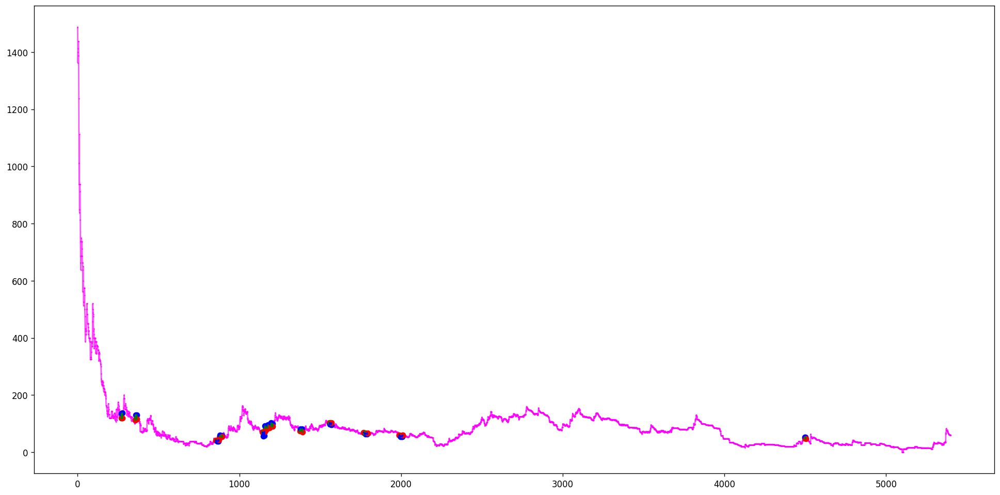

[(290, 293, 297, 298, 307), (290, 293, 297, 299, 307), (455, 458, 461, 463, 469)]
[(113, 115, 122, 131, 135)]
Ticker AFP.SW found 3 double top patterns, 1 double bottom patterns


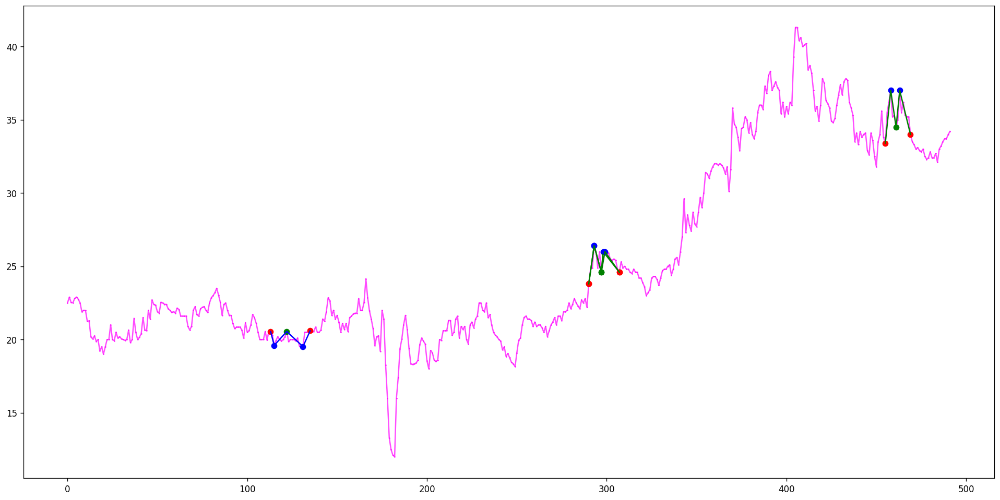

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(34, 35, 43, 47, 48), (50, 56, 59, 61, 67), (431, 434, 435, 439, 441), (843, 844, 847, 850, 851), (1532, 1533, 1534, 1542, 1543), (1532, 1533, 1534, 1551, 1552), (1674, 1682, 1688, 1691, 1693), (1694, 1695, 1698, 1700, 1703), (1694, 1695, 1698, 1702, 1703), (1710, 1711, 1715, 1721, 1724), (1710, 1711, 1715, 1723, 1724), (1710, 1712, 1715, 1721, 1724), (1710, 1712, 1715, 1723, 1724), (1760, 1761, 1762, 1769, 1770), (1808, 1812, 1815, 1817, 1818), (1804, 1805, 1808, 1817, 1819), (1894, 1895, 1896, 1904, 1905), (1932, 1933, 1934, 1937, 1939), (1932, 1933, 1934, 1938, 1939), (1932, 1933, 1934, 1940, 1941), (1934, 1935, 1936, 1940, 1941), (1932, 1933, 1934, 1942, 1945), (1932, 1933, 1934, 1944, 1945), (1934, 1935, 1936, 1942, 1945), (1934, 1935, 1936, 1944, 1945), (1936, 1937, 1939, 1942, 1945), (1936, 1937, 1939, 1944, 1945), (1936, 1938, 1939, 1942, 1945), (1936, 1938, 1939, 1944, 1945), (1932, 1933, 1934, 1946, 1954), (1932, 1933, 1934, 1953, 1954), (1934, 1935, 1936, 1946, 1954), (1934

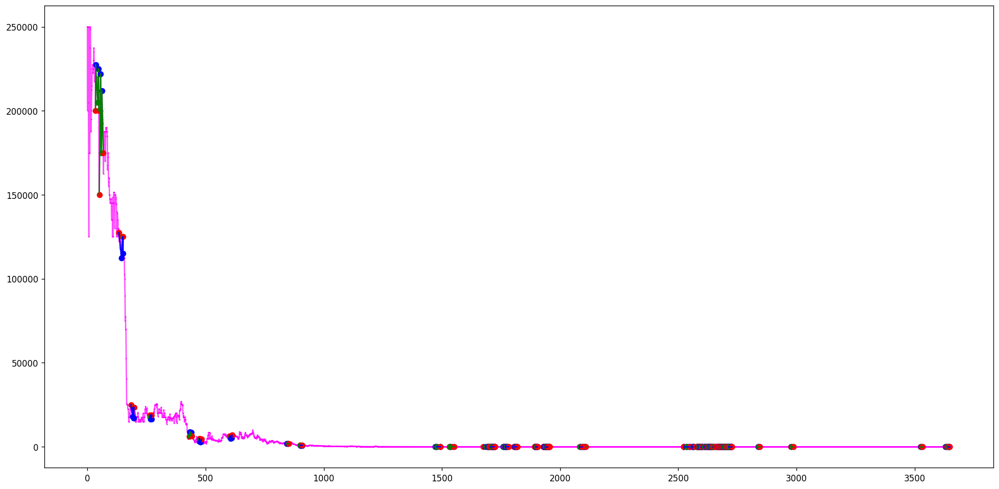

[]
[(47, 52, 56, 66, 69)]
Ticker AFRM found 0 double top patterns, 1 double bottom patterns


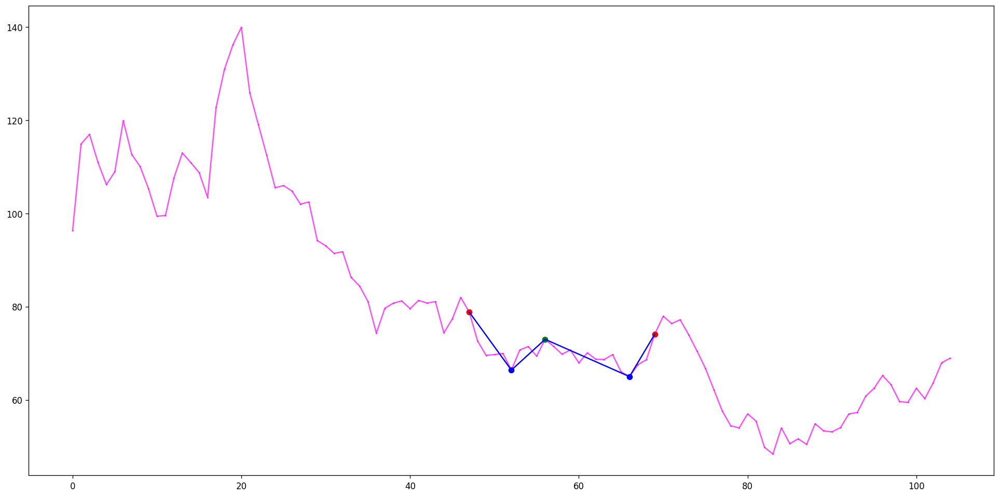

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(511, 513, 515, 520, 526)]
[]
Ticker AFS.L found 1 double top patterns, 0 double bottom patterns


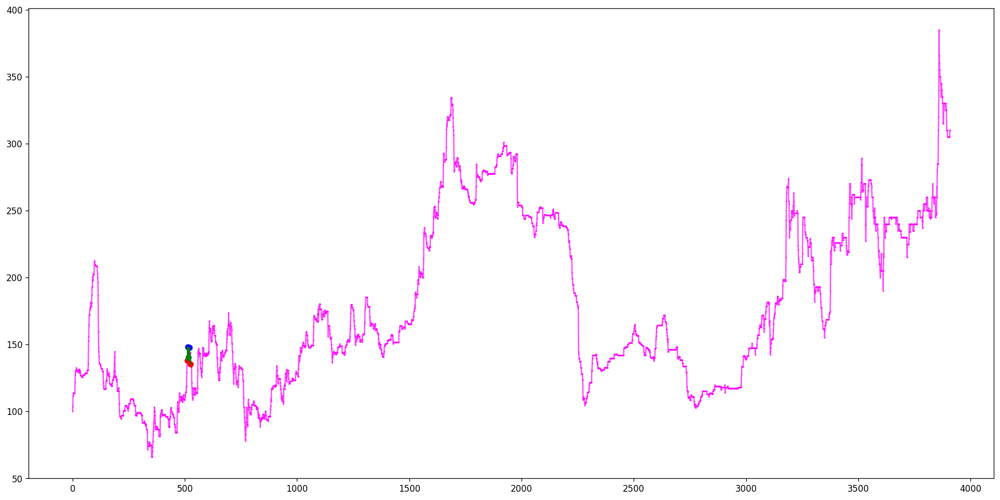

[(1119, 1127, 1133, 1140, 1142), (1208, 1217, 1220, 1223, 1230), (1221, 1222, 1230, 1241, 1249), (1221, 1223, 1230, 1241, 1249), (1300, 1304, 1314, 1316, 1324), (1300, 1304, 1314, 1321, 1324)]
[]
Ticker AFSIB found 6 double top patterns, 0 double bottom patterns


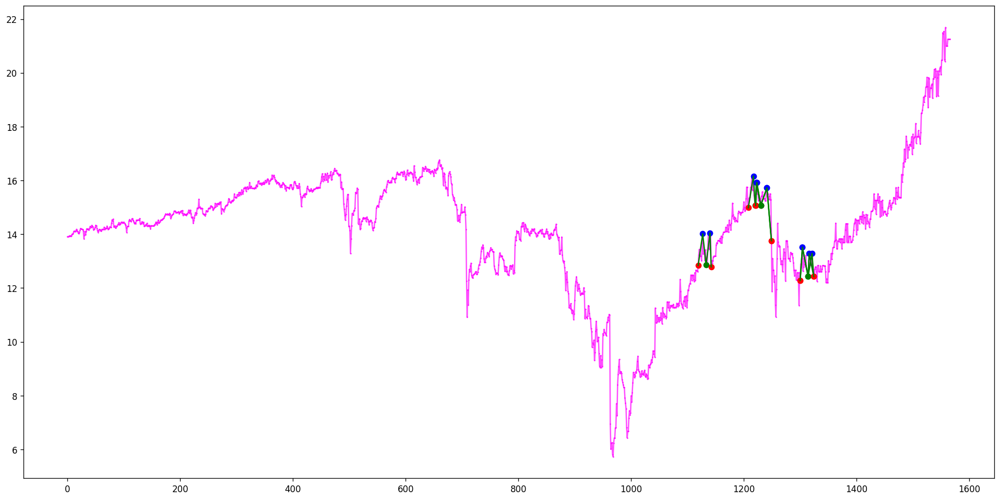

[(1408, 1410, 1417, 1418, 1421), (1432, 1437, 1440, 1441, 1443), (1432, 1437, 1440, 1445, 1447)]
[]
Ticker AFSIC found 3 double top patterns, 0 double bottom patterns


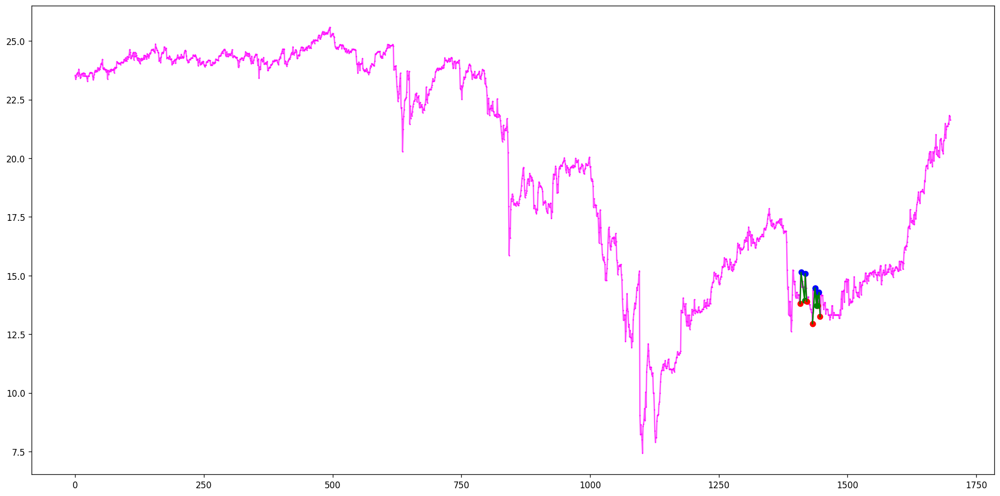

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(1023, 1034, 1037, 1041, 1046), (1023, 1034, 1037, 1042, 1046)]
[(1045, 1047, 1049, 1056, 1059)]
Ticker AFSIM found 2 double top patterns, 1 double bottom patterns


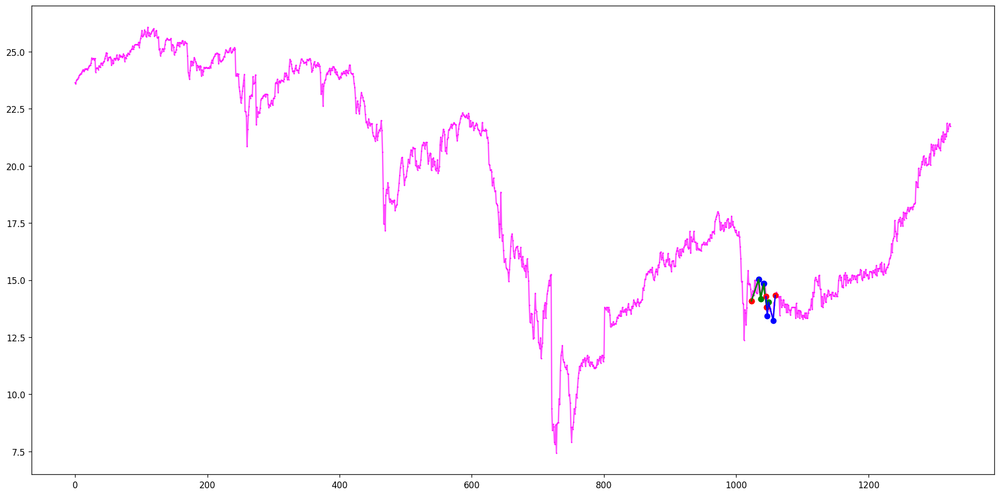

[]
[]
Ticker AFSIN found 0 double top patterns, 0 double bottom patterns


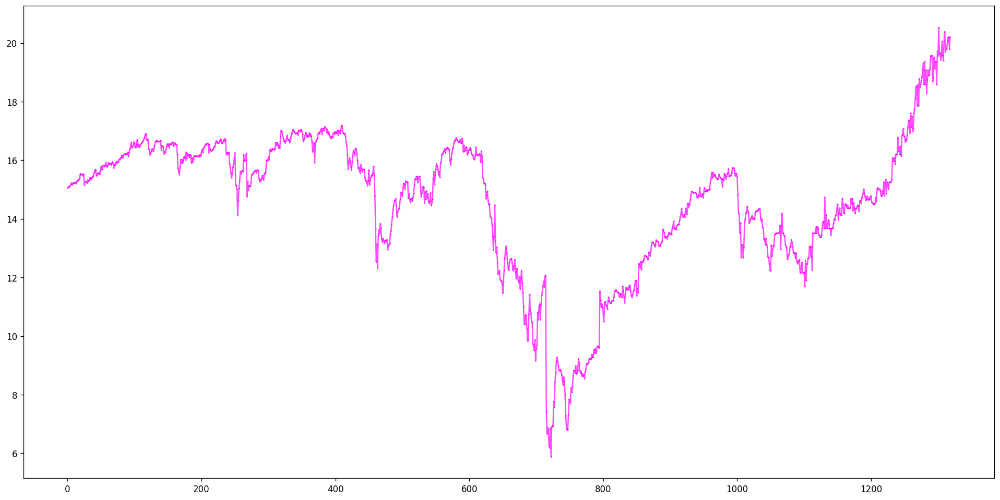

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(847, 851, 863, 864, 866)]
[]
Ticker AFSIP found 1 double top patterns, 0 double bottom patterns


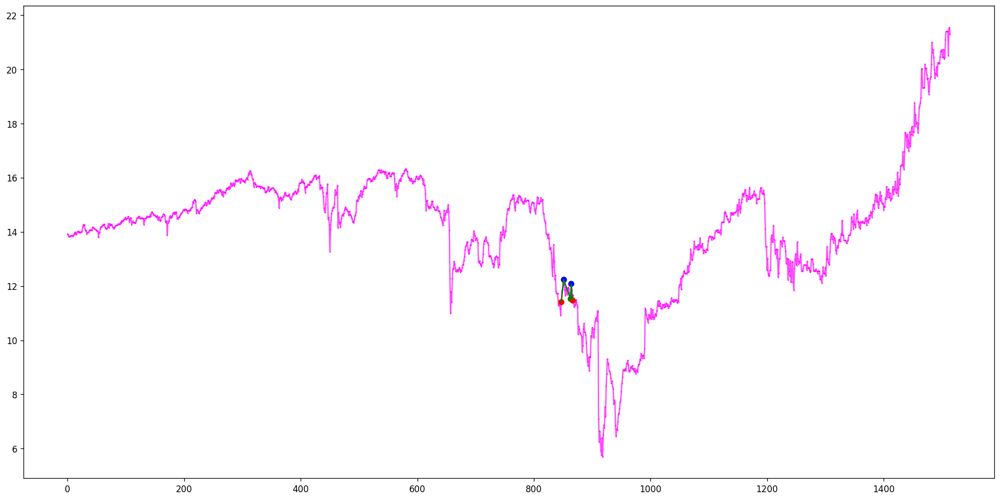

[]
[]
Ticker AFT found 0 double top patterns, 0 double bottom patterns


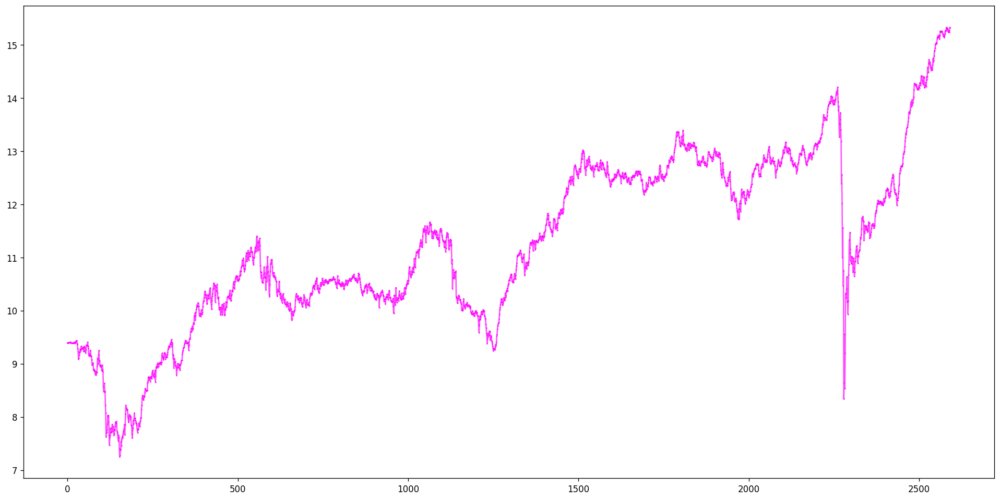

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(7, 19, 23, 28, 29), (33, 34, 37, 40, 42), (32, 34, 42, 44, 45), (32, 35, 42, 44, 45), (32, 38, 42, 44, 45), (85, 89, 90, 95, 98), (221, 222, 224, 231, 234), (221, 222, 224, 232, 234), (291, 292, 293, 296, 297), (309, 310, 313, 319, 320), (342, 343, 346, 348, 350), (354, 355, 361, 366, 368), (354, 356, 361, 366, 368), (391, 392, 396, 399, 400), (400, 408, 412, 417, 426), (400, 409, 412, 417, 426), (490, 494, 500, 501, 503), (696, 697, 704, 708, 712), (902, 903, 908, 916, 920), (930, 933, 939, 941, 952), (1013, 1017, 1019, 1032, 1033), (1020, 1022, 1025, 1032, 1033), (1051, 1057, 1065, 1069, 1070), (1051, 1057, 1070, 1073, 1075), (1051, 1057, 1070, 1074, 1075), (1224, 1225, 1227, 1230, 1236), (1236, 1238, 1243, 1244, 1245), (1236, 1240, 1243, 1244, 1245), (1277, 1280, 1284, 1285, 1287), (1277, 1280, 1284, 1286, 1287), (1277, 1281, 1284, 1285, 1287), (1277, 1281, 1284, 1286, 1287), (1295, 1296, 1298, 1300, 1301), (1523, 1524, 1525, 1528, 1533), (1523, 1524, 1525, 1531, 1533), (1540, 154

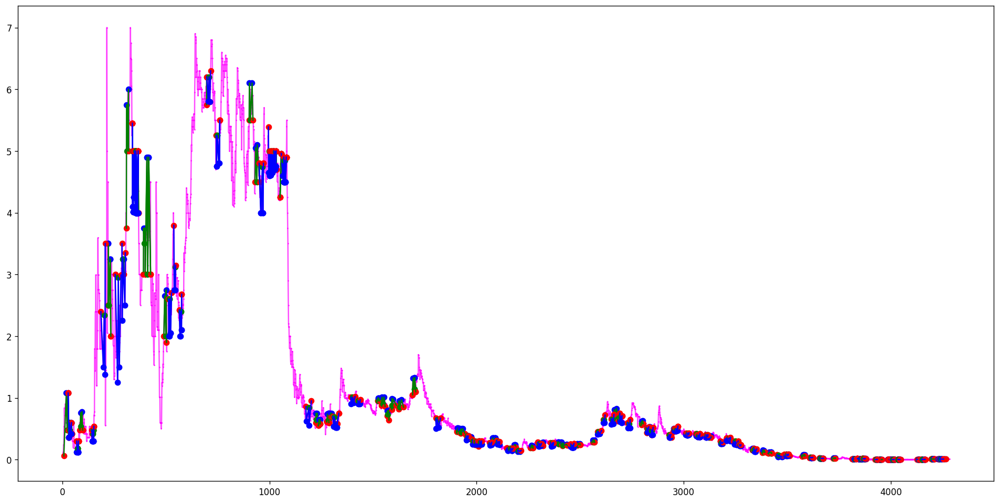

[]
[]
Ticker AFTPY found 0 double top patterns, 0 double bottom patterns


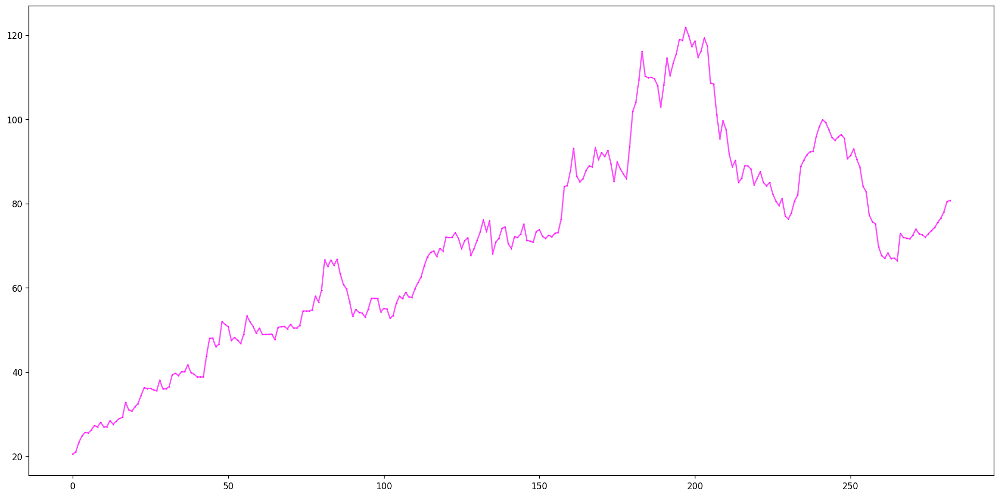

[]
[(263, 265, 272, 281, 283)]
Ticker AFW.DE found 0 double top patterns, 1 double bottom patterns


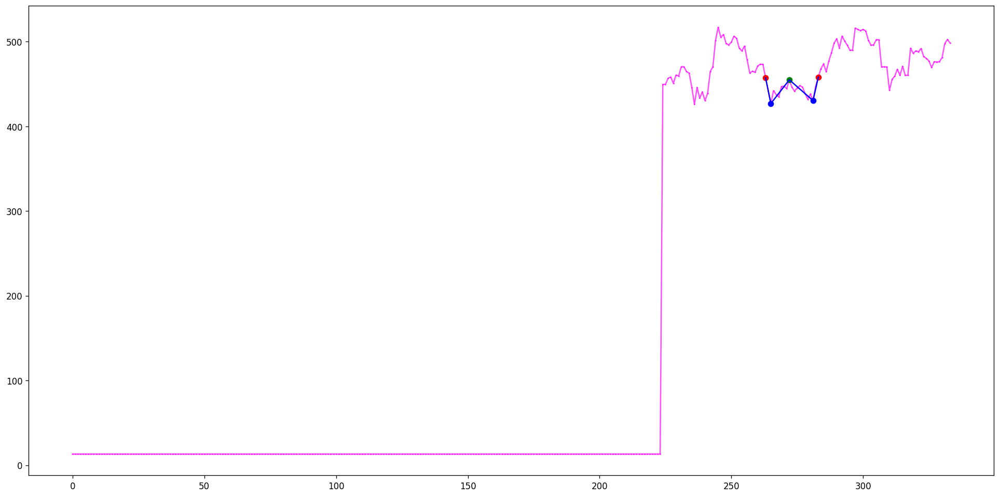

[]
[(158, 164, 169, 170, 177), (272, 278, 283, 290, 299)]
Ticker AFW.DU found 0 double top patterns, 2 double bottom patterns


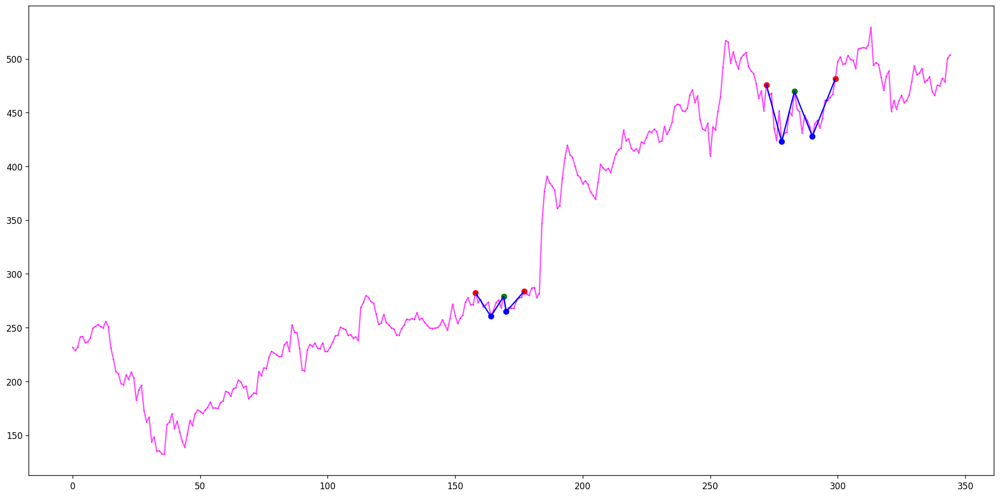

[(186, 188, 194, 199, 205), (413, 415, 421, 425, 427), (413, 417, 421, 425, 427), (413, 419, 421, 425, 427), (1128, 1131, 1135, 1138, 1146), (1254, 1262, 1265, 1266, 1272), (1336, 1338, 1341, 1346, 1354), (1336, 1346, 1354, 1358, 1363), (2189, 2197, 2205, 2213, 2217), (2189, 2197, 2205, 2214, 2217), (2325, 2329, 2334, 2340, 2349), (2325, 2329, 2334, 2341, 2349), (3347, 3352, 3358, 3363, 3365), (4441, 4445, 4451, 4454, 4463), (4692, 4694, 4696, 4699, 4703)]
[(43, 48, 49, 54, 55), (652, 656, 660, 669, 674), (741, 750, 751, 761, 763), (741, 750, 751, 762, 763), (1085, 1087, 1091, 1094, 1096), (1122, 1125, 1131, 1135, 1138), (1587, 1602, 1606, 1613, 1615), (1623, 1630, 1643, 1646, 1648), (3062, 3066, 3079, 3081, 3085), (3125, 3134, 3136, 3143, 3146), (3171, 3172, 3175, 3178, 3182), (3401, 3405, 3414, 3418, 3420), (3606, 3608, 3616, 3617, 3619), (3606, 3609, 3616, 3617, 3619), (4252, 4255, 4264, 4268, 4275), (4792, 4795, 4803, 4804, 4810), (4949, 4956, 4967, 4972, 4976)]
Ticker AFW.F found 

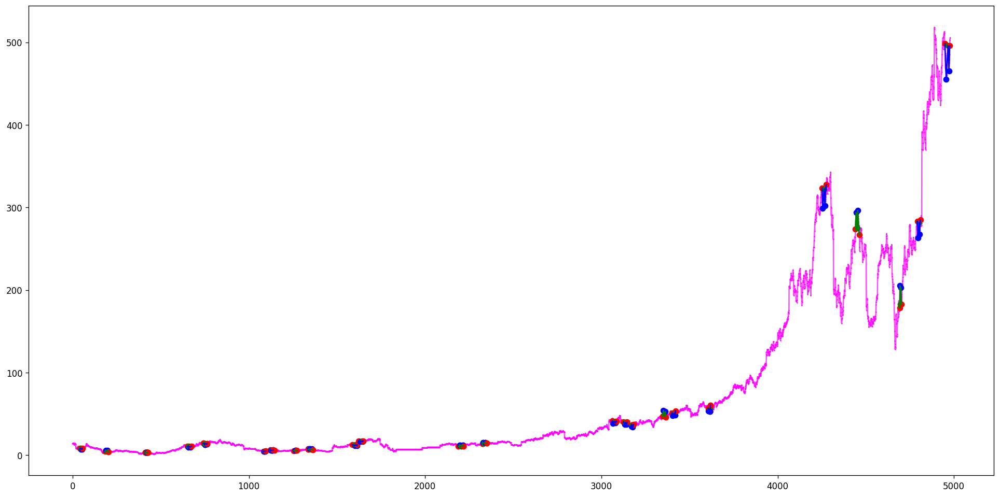

[]
[(666, 672, 677, 678, 685)]
Ticker AFW.MU found 0 double top patterns, 1 double bottom patterns


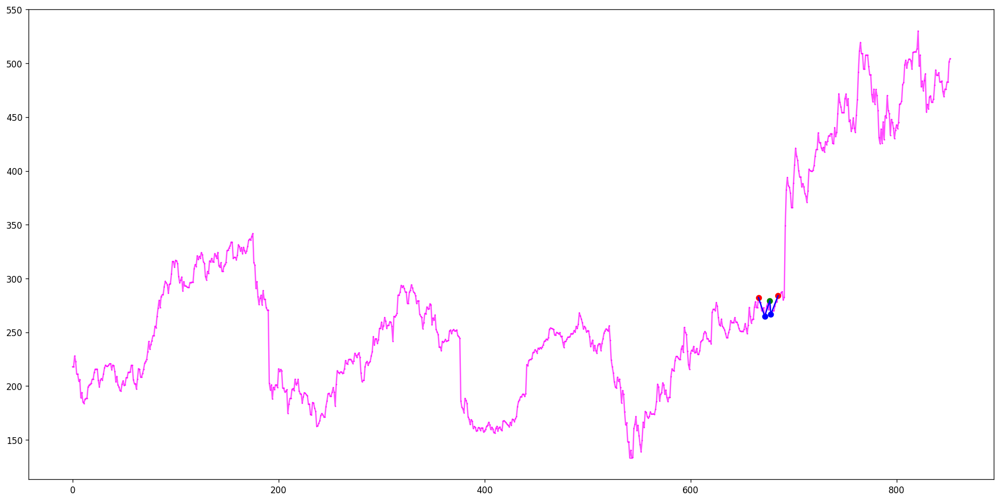

[(177, 178, 182, 192, 196), (262, 263, 266, 272, 276), (656, 659, 669, 671, 675), (1407, 1413, 1416, 1433, 1435), (1825, 1827, 1829, 1832, 1836)]
[(195, 199, 207, 215, 219), (272, 276, 280, 287, 291), (639, 641, 645, 647, 659), (736, 744, 749, 750, 751), (1827, 1829, 1832, 1836, 1839), (2040, 2044, 2050, 2056, 2062)]
Ticker AFW.SG found 5 double top patterns, 6 double bottom patterns


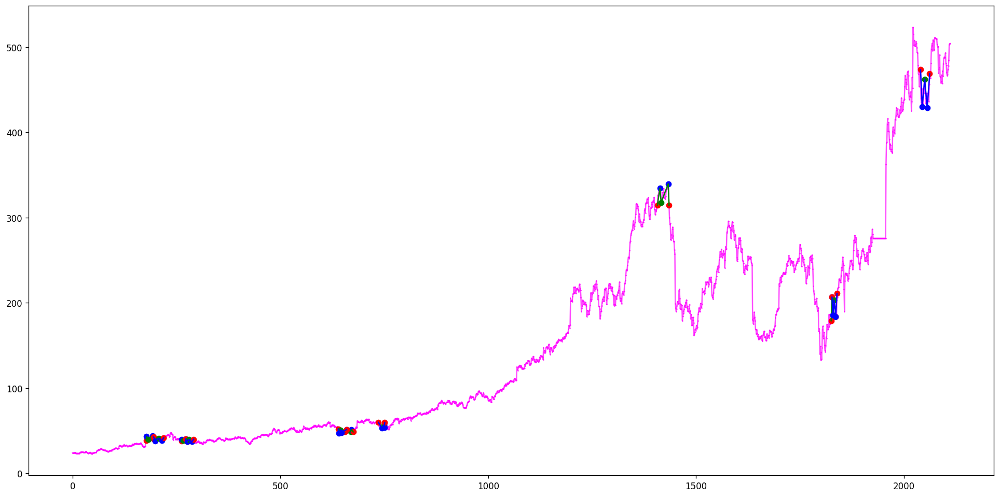

[(1924, 1928, 1933, 1941, 1947), (2090, 2094, 2096, 2100, 2102), (2265, 2270, 2273, 2275, 2277), (2356, 2359, 2366, 2370, 2374), (2895, 2900, 2904, 2912, 2916), (3803, 3810, 3814, 3824, 3828), (5088, 5092, 5106, 5109, 5112)]
[(545, 549, 555, 563, 568), (866, 873, 878, 889, 892), (999, 1001, 1006, 1007, 1010), (999, 1001, 1006, 1008, 1010), (1029, 1036, 1041, 1044, 1045), (1065, 1069, 1071, 1077, 1079), (1471, 1476, 1478, 1486, 1490), (1605, 1608, 1619, 1626, 1628), (1832, 1837, 1842, 1848, 1855), (3029, 3032, 3040, 3044, 3054), (3281, 3283, 3294, 3305, 3309), (4011, 4014, 4016, 4027, 4029)]
Ticker AFX.DE found 7 double top patterns, 12 double bottom patterns


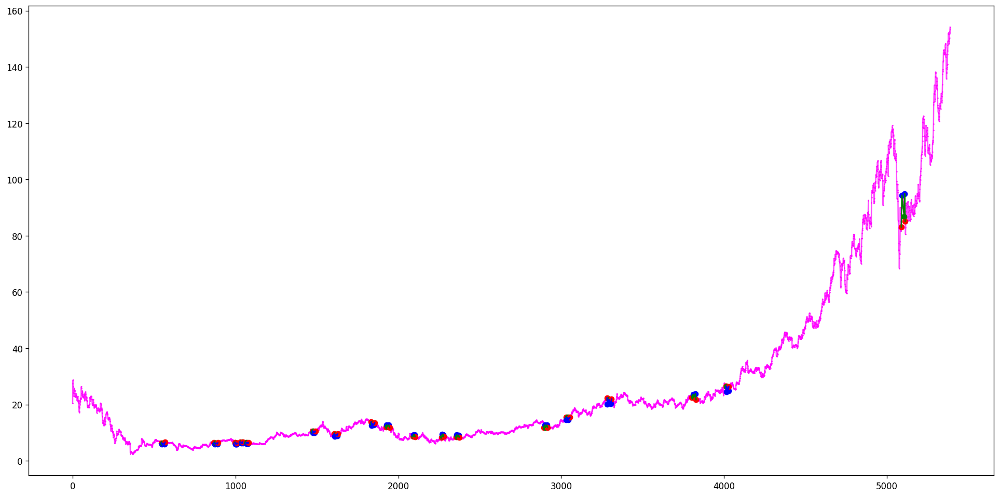

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(756, 757, 758, 763, 765), (801, 802, 804, 807, 808), (835, 837, 838, 842, 843), (831, 834, 835, 845, 846), (835, 837, 838, 845, 846), (838, 839, 840, 845, 846), (844, 845, 846, 852, 854), (844, 845, 846, 857, 859), (846, 847, 848, 857, 859), (1875, 1879, 1885, 1892, 1898), (2302, 2304, 2308, 2309, 2310), (2326, 2329, 2340, 2342, 2343), (2390, 2393, 2400, 2403, 2408), (2573, 2574, 2586, 2591, 2600), (2573, 2577, 2586, 2591, 2600), (2600, 2603, 2607, 2611, 2616), (3834, 3842, 3846, 3856, 3860), (5122, 5124, 5126, 5132, 5135), (5120, 5124, 5138, 5141, 5144)]
[(194, 202, 206, 211, 213), (336, 337, 343, 350, 357), (754, 756, 757, 766, 768), (798, 801, 802, 810, 811), (803, 804, 806, 810, 811), (798, 801, 802, 814, 815), (803, 804, 806, 814, 815), (807, 810, 811, 816, 817), (834, 835, 837, 840, 845), (834, 835, 837, 841, 845), (834, 835, 837, 843, 845), (834, 835, 837, 844, 845), (837, 838, 839, 843, 845), (837, 838, 839, 844, 845), (839, 840, 842, 844, 845), (845, 846, 852, 854, 857), (84

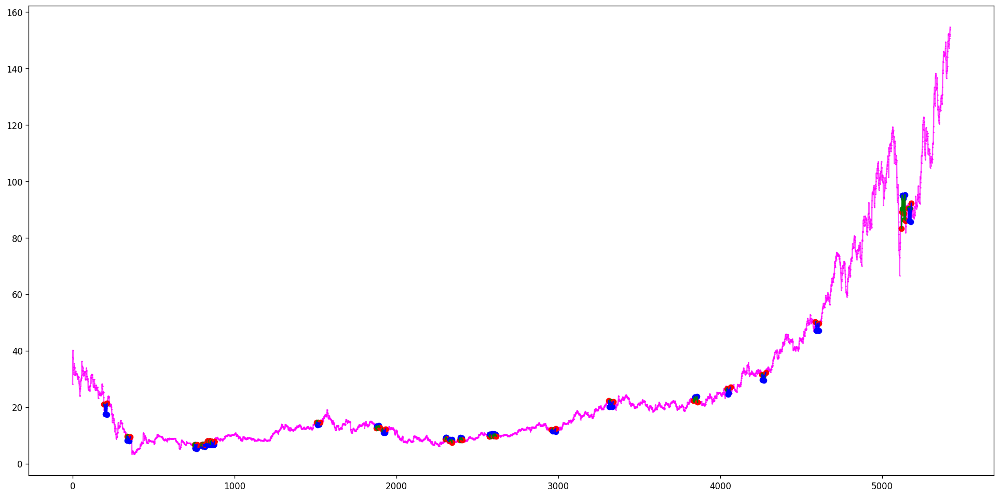

[(2464, 2468, 2473, 2481, 2484), (4184, 4186, 4189, 4200, 4210), (4687, 4688, 4690, 4696, 4699)]
[(2533, 2543, 2546, 2553, 2557), (4697, 4701, 4704, 4712, 4715)]
Ticker AFX.HA found 3 double top patterns, 2 double bottom patterns


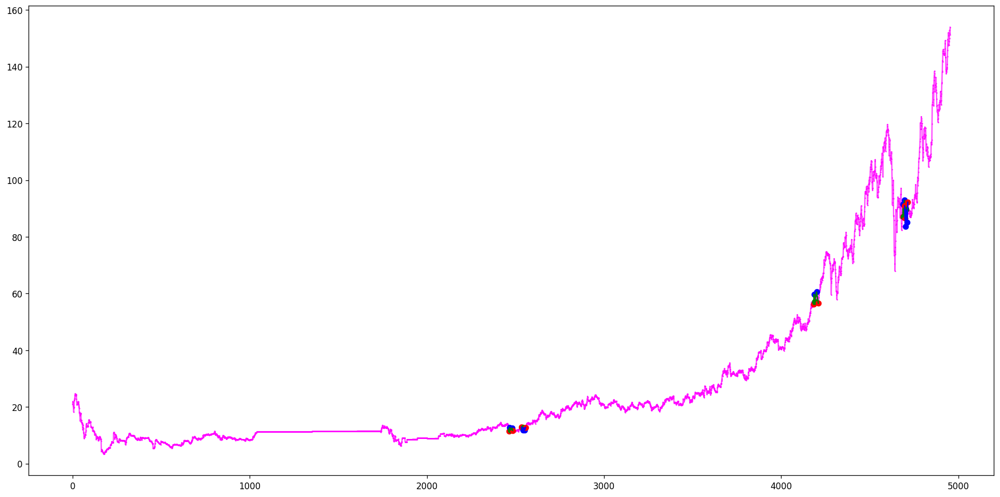

[]
[]
Ticker AFX.L found 0 double top patterns, 0 double bottom patterns


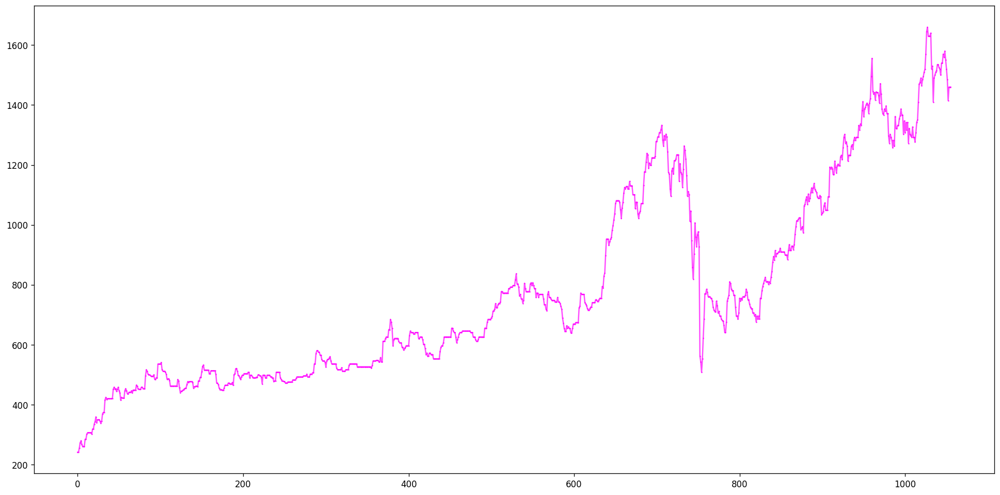

[]
[]
Ticker AFX.VI found 0 double top patterns, 0 double bottom patterns


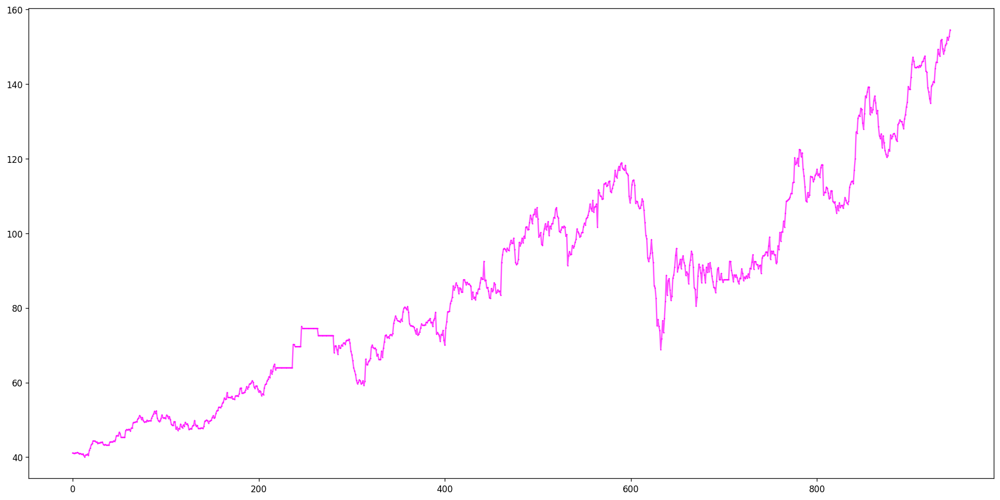

[(194, 196, 198, 204, 206), (228, 232, 238, 242, 250), (252, 253, 258, 265, 276)]
[(34, 36, 43, 46, 49), (448, 451, 461, 467, 469)]
Ticker AFYA found 3 double top patterns, 2 double bottom patterns


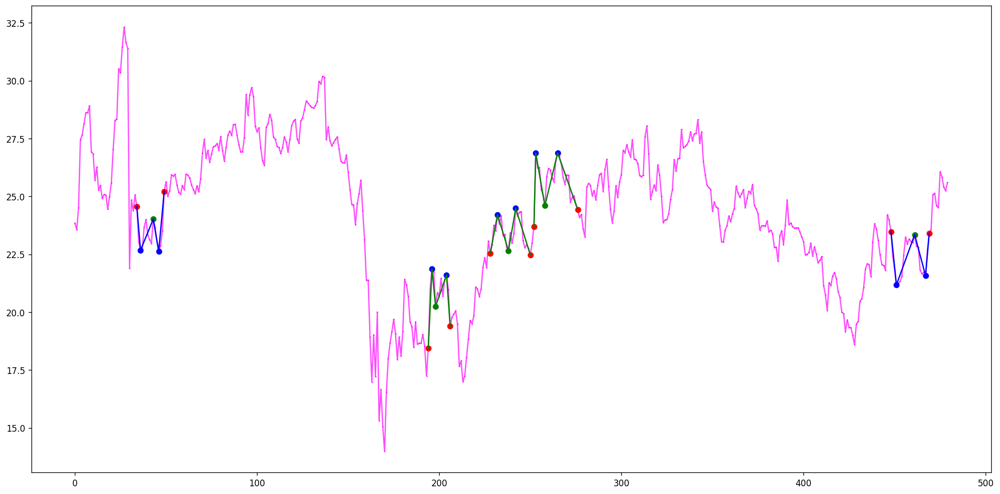

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(537, 539, 549, 551, 563), (594, 595, 602, 605, 608), (716, 720, 722, 725, 726), (902, 903, 905, 909, 911), (1109, 1110, 1122, 1124, 1137), (1169, 1171, 1175, 1181, 1184), (1361, 1364, 1369, 1375, 1379), (1475, 1481, 1484, 1491, 1496), (1892, 1895, 1904, 1907, 1913), (2398, 2412, 2416, 2418, 2419), (2462, 2467, 2474, 2484, 2488), (2520, 2522, 2526, 2528, 2533), (2707, 2709, 2713, 2720, 2724), (2902, 2903, 2908, 2909, 2910), (2976, 2980, 2985, 2991, 3001), (3094, 3101, 3104, 3106, 3108)]
[(665, 671, 673, 679, 686), (713, 714, 720, 726, 735), (752, 754, 757, 758, 759), (746, 747, 751, 758, 762), (1103, 1109, 1110, 1122, 1124), (1910, 1915, 1921, 1924, 1934), (2036, 2039, 2044, 2046, 2054), (2036, 2046, 2054, 2055, 2058), (2202, 2203, 2209, 2214, 2220), (2314, 2320, 2324, 2328, 2331), (2392, 2398, 2412, 2416, 2418), (2710, 2713, 2720, 2724, 2728), (2734, 2739, 2747, 2751, 2759), (3122, 3126, 3131, 3135, 3137)]
Ticker AFZ.BE found 16 double top patterns, 14 double bottom patterns


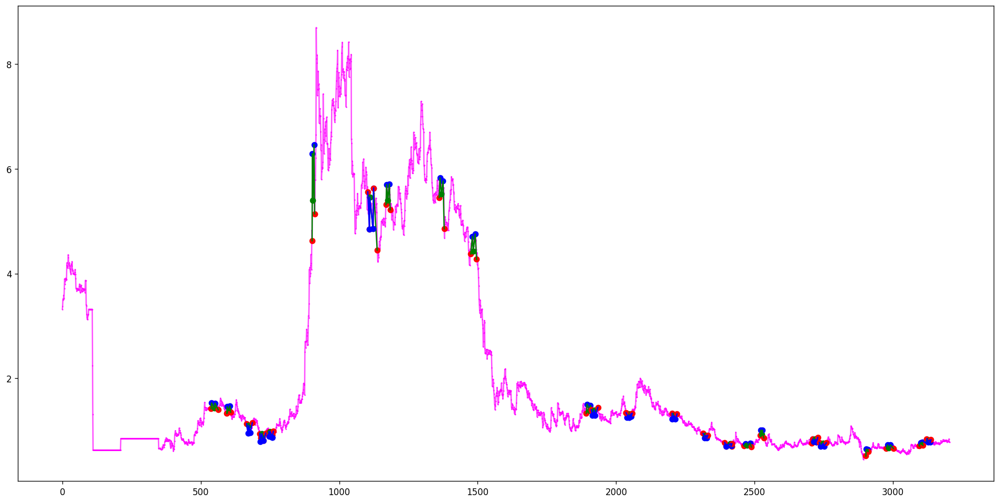

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(470, 471, 479, 482, 492), (673, 680, 681, 684, 685), (779, 781, 784, 786, 787), (904, 905, 911, 913, 914), (984, 992, 995, 1001, 1002), (1038, 1044, 1050, 1054, 1059), (1127, 1130, 1133, 1140, 1143), (1434, 1441, 1443, 1450, 1455), (1538, 1539, 1543, 1544, 1546), (1813, 1815, 1816, 1820, 1821), (1851, 1855, 1857, 1866, 1873), (2356, 2371, 2375, 2377, 2378), (2421, 2430, 2432, 2436, 2447), (2666, 2669, 2672, 2679, 2682), (2666, 2669, 2683, 2687, 2692), (2861, 2863, 2869, 2871, 2874), (3080, 3083, 3085, 3089, 3090)]
[(334, 337, 338, 342, 343), (400, 401, 407, 412, 415), (459, 460, 461, 468, 470), (503, 508, 511, 522, 529), (503, 508, 511, 523, 529), (625, 630, 632, 637, 641), (680, 681, 684, 685, 696), (704, 707, 710, 714, 722), (722, 723, 726, 728, 729), (745, 750, 760, 767, 771), (745, 750, 760, 768, 771), (1062, 1068, 1072, 1081, 1082), (1142, 1144, 1145, 1150, 1151), (1855, 1857, 1862, 1863, 1865), (1872, 1874, 1877, 1883, 1887), (2095, 2096, 2097, 2100, 2102), (2629, 2633, 2635, 2

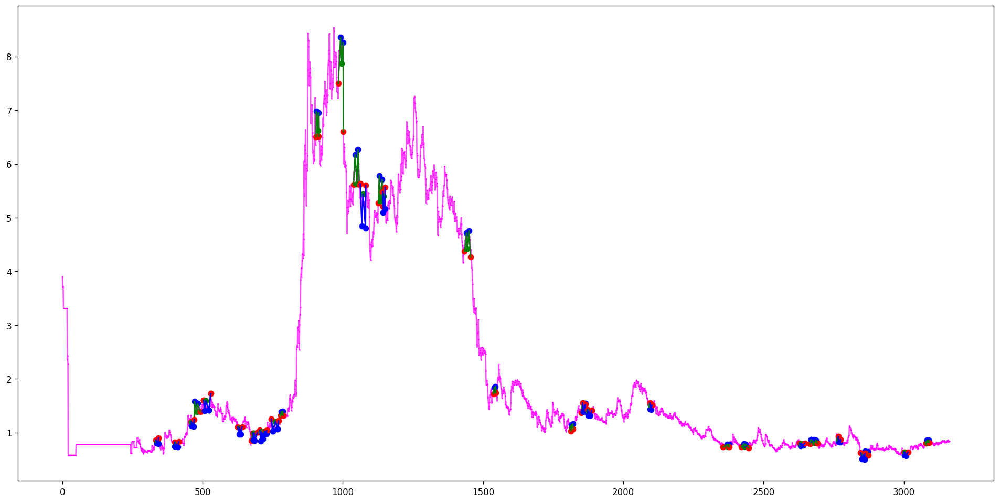

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(68, 75, 77, 84, 85), (121, 127, 133, 137, 142), (165, 168, 173, 175, 178), (210, 213, 216, 223, 226), (935, 938, 946, 949, 954), (2107, 2110, 2114, 2126, 2129), (2107, 2110, 2114, 2127, 2129)]
[(145, 150, 152, 165, 168), (1777, 1781, 1789, 1793, 1801), (1777, 1781, 1789, 1795, 1801), (1777, 1782, 1789, 1793, 1801), (1777, 1782, 1789, 1795, 1801)]
Ticker AFZ.MU found 7 double top patterns, 5 double bottom patterns


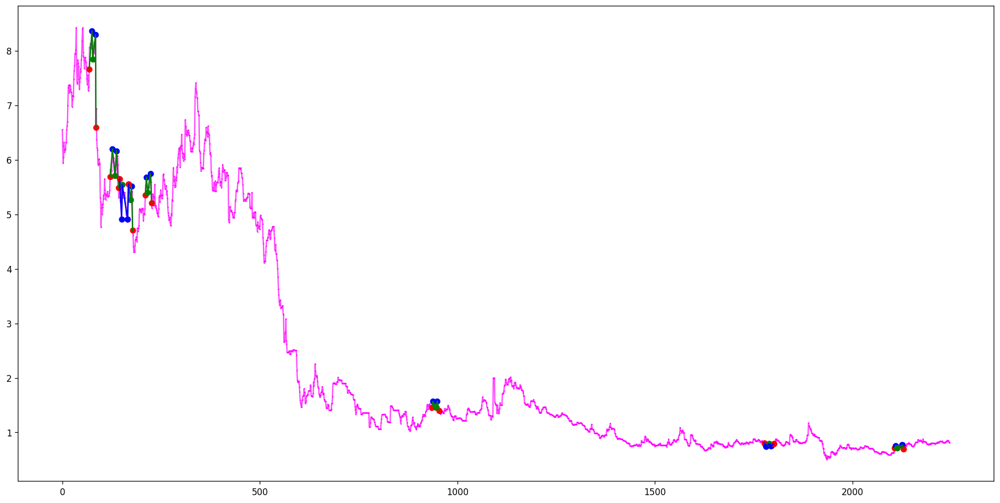

[(123, 129, 137, 140, 144), (153, 154, 167, 170, 181), (167, 170, 175, 177, 181), (212, 215, 220, 223, 228), (519, 525, 528, 534, 539), (858, 861, 862, 870, 873), (1563, 1565, 1570, 1571, 1576), (1563, 1565, 1570, 1572, 1576), (1563, 1566, 1570, 1571, 1576), (1563, 1566, 1570, 1572, 1576), (1783, 1786, 1791, 1792, 1795), (2137, 2138, 2141, 2148, 2151)]
[(148, 153, 154, 167, 169), (421, 423, 425, 434, 440), (1239, 1243, 1249, 1257, 1264), (1357, 1363, 1369, 1372, 1375), (1355, 1363, 1376, 1379, 1380), (1438, 1443, 1449, 1451, 1454), (1493, 1501, 1509, 1512, 1515), (1515, 1519, 1524, 1530, 1532), (1534, 1535, 1538, 1543, 1546), (1935, 1936, 1938, 1944, 1947)]
Ticker AFZ.SG found 12 double top patterns, 10 double bottom patterns


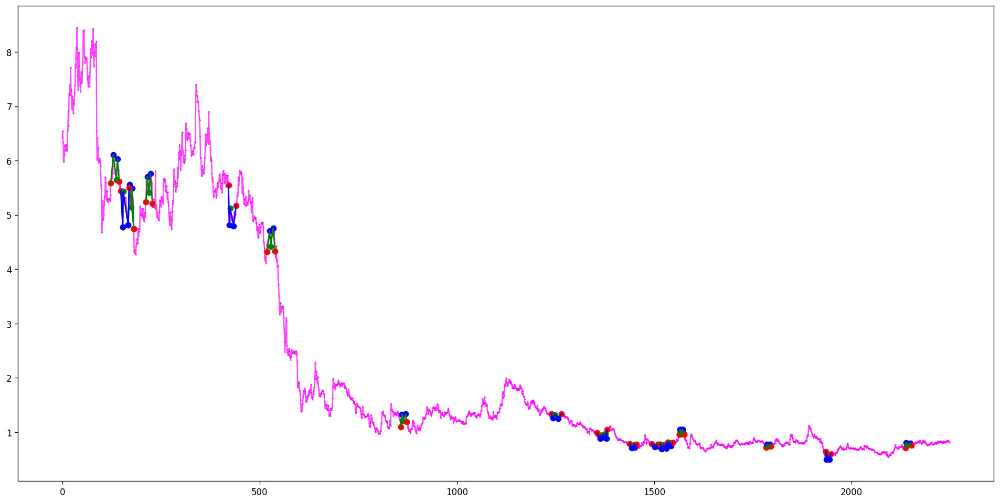

[(463, 471, 473, 477, 484), (867, 870, 874, 880, 882), (996, 1005, 1013, 1016, 1019), (1051, 1054, 1056, 1059, 1067), (1130, 1134, 1138, 1147, 1155), (1193, 1203, 1212, 1215, 1221), (1269, 1271, 1273, 1279, 1280), (1268, 1271, 1280, 1287, 1292), (1827, 1828, 1833, 1834, 1839)]
[(79, 82, 83, 87, 91), (519, 527, 528, 538, 542), (742, 745, 747, 753, 758), (1237, 1240, 1243, 1244, 1248), (1271, 1273, 1279, 1280, 1287), (1307, 1314, 1321, 1330, 1333), (1421, 1422, 1428, 1431, 1436), (1532, 1535, 1538, 1540, 1542), (1639, 1641, 1644, 1647, 1649), (1796, 1797, 1798, 1803, 1805), (1825, 1827, 1828, 1839, 1849)]
Ticker AMC found 9 double top patterns, 11 double bottom patterns


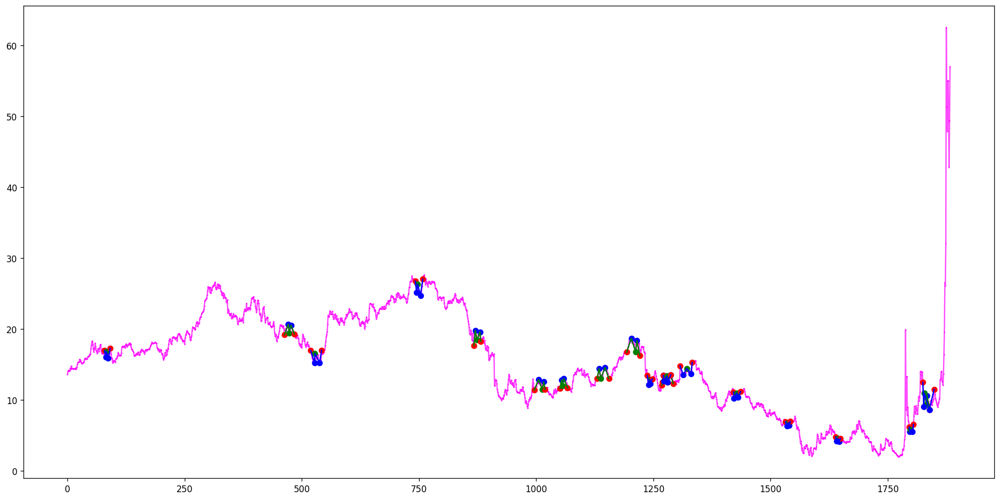

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(270, 273, 277, 283, 285), (620, 623, 626, 634, 638), (862, 863, 864, 868, 871), (920, 923, 925, 931, 937), (963, 971, 976, 982, 986), (1276, 1285, 1291, 1295, 1303), (1523, 1528, 1536, 1539, 1546), (1523, 1528, 1546, 1548, 1551), (2115, 2117, 2121, 2125, 2129), (2238, 2240, 2241, 2253, 2257), (2698, 2701, 2706, 2710, 2716), (2973, 2975, 2977, 2985, 2992), (3124, 3126, 3129, 3136, 3139), (3282, 3285, 3291, 3301, 3306), (5118, 5120, 5122, 5127, 5132), (5268, 5272, 5286, 5289, 5293)]
[(244, 246, 249, 251, 253), (297, 299, 301, 305, 307), (521, 525, 529, 535, 542), (859, 862, 863, 871, 879), (1083, 1086, 1093, 1096, 1106), (1083, 1087, 1093, 1096, 1106), (1577, 1579, 1593, 1601, 1603), (2240, 2241, 2253, 2257, 2263), (2273, 2274, 2275, 2278, 2280), (2293, 2297, 2299, 2302, 2304), (2400, 2401, 2404, 2421, 2424), (2400, 2401, 2404, 2422, 2424), (2955, 2956, 2964, 2969, 2971), (2976, 2977, 2982, 2983, 2985), (3122, 3124, 3126, 3129, 3136), (3361, 3362, 3364, 3386, 3389), (3364, 3380, 3384, 

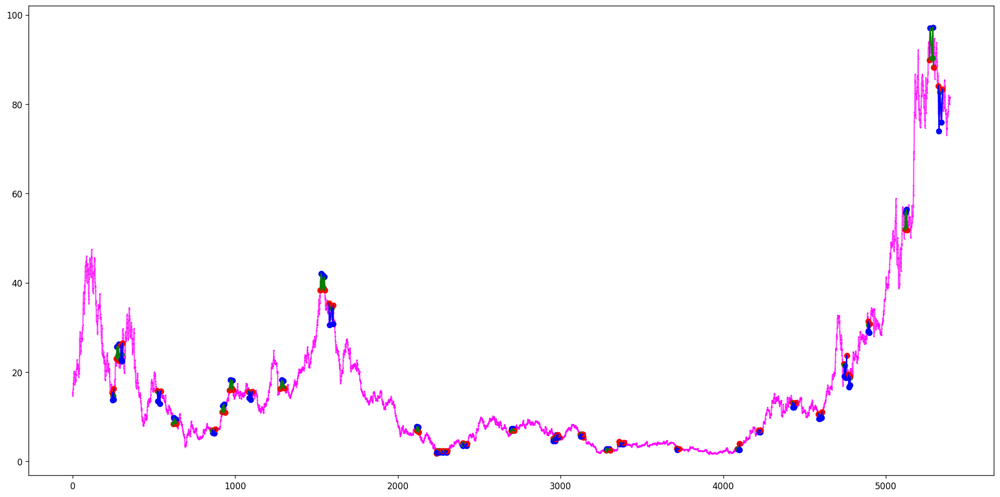

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(383, 385, 388, 390, 392), (474, 475, 480, 486, 493), (540, 541, 544, 546, 549), (1066, 1071, 1078, 1080, 1086), (1439, 1445, 1452, 1460, 1462), (4781, 4791, 4797, 4799, 4805)]
[(82, 84, 86, 89, 93), (119, 120, 123, 131, 134), (1226, 1228, 1235, 1238, 1243), (2208, 2209, 2212, 2216, 2218), (2374, 2381, 2384, 2390, 2396), (3145, 3151, 3157, 3160, 3162), (3221, 3225, 3226, 3238, 3243), (4734, 4737, 4743, 4752, 4760)]
Ticker AMZN found 6 double top patterns, 8 double bottom patterns


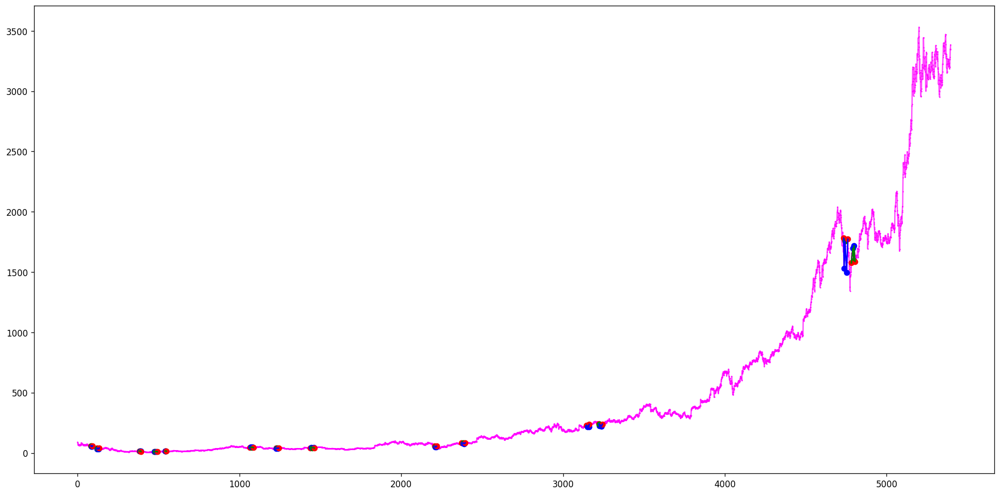

[(50, 52, 56, 61, 68), (75, 76, 84, 86, 89), (221, 230, 233, 237, 246), (436, 441, 449, 455, 458), (579, 582, 586, 594, 603), (2235, 2240, 2244, 2246, 2251), (2274, 2280, 2281, 2287, 2289), (2969, 2975, 2977, 2986, 2993), (2969, 2975, 2977, 2987, 2993), (5095, 5099, 5103, 5104, 5109), (5179, 5184, 5192, 5193, 5203)]
[(81, 84, 86, 97, 102), (261, 264, 268, 271, 281), (455, 458, 462, 466, 474), (698, 701, 704, 707, 713), (2055, 2058, 2062, 2063, 2072), (2207, 2209, 2212, 2217, 2218), (2269, 2274, 2280, 2281, 2287), (2636, 2641, 2647, 2649, 2653), (2947, 2949, 2952, 2956, 2961), (5113, 5117, 5119, 5124, 5125)]
Ticker BA found 11 double top patterns, 10 double bottom patterns


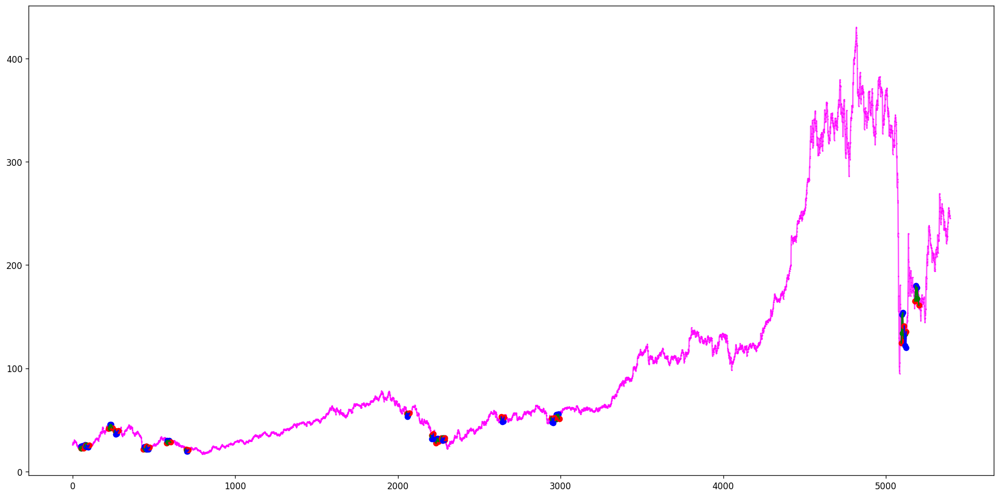

[]
[(887, 892, 900, 905, 912), (1577, 1578, 1584, 1589, 1591)]
Ticker BABA found 0 double top patterns, 2 double bottom patterns


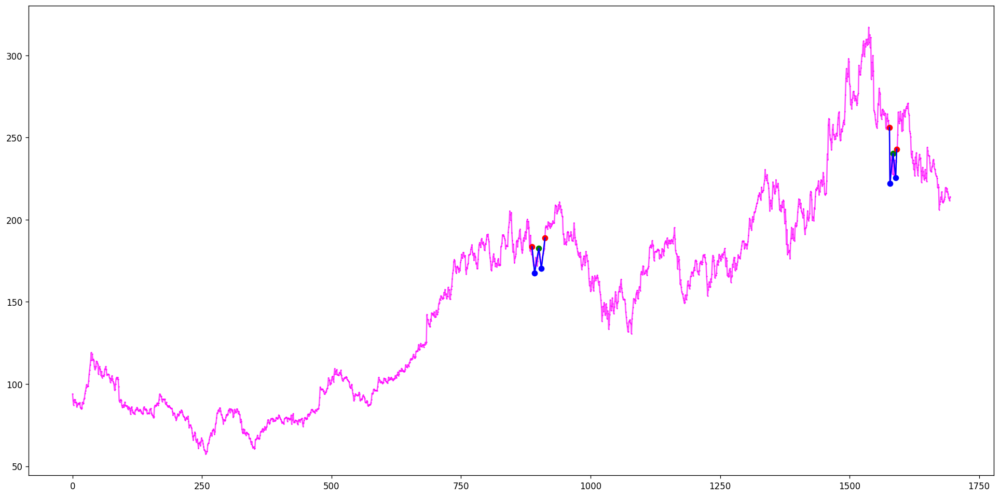

[(35, 41, 50, 57, 60), (344, 349, 354, 358, 362), (541, 547, 556, 560, 564), (866, 867, 875, 880, 887), (2159, 2162, 2169, 2171, 2177), (3069, 3071, 3075, 3080, 3082), (3937, 3939, 3945, 3950, 3955), (4372, 4373, 4379, 4380, 4389), (4396, 4397, 4404, 4413, 4421), (4571, 4578, 4584, 4585, 4586)]
[(390, 393, 394, 398, 399), (521, 525, 528, 535, 541), (717, 719, 725, 726, 729), (1310, 1314, 1315, 1320, 1322), (1393, 1396, 1402, 1406, 1415), (1484, 1492, 1494, 1501, 1502), (2104, 2108, 2112, 2122, 2124), (2703, 2707, 2711, 2715, 2719), (3364, 3374, 3384, 3387, 3390), (3538, 3542, 3545, 3551, 3557), (3988, 3992, 3999, 4009, 4014), (4926, 4935, 4939, 4943, 4949)]
Ticker BB found 10 double top patterns, 12 double bottom patterns


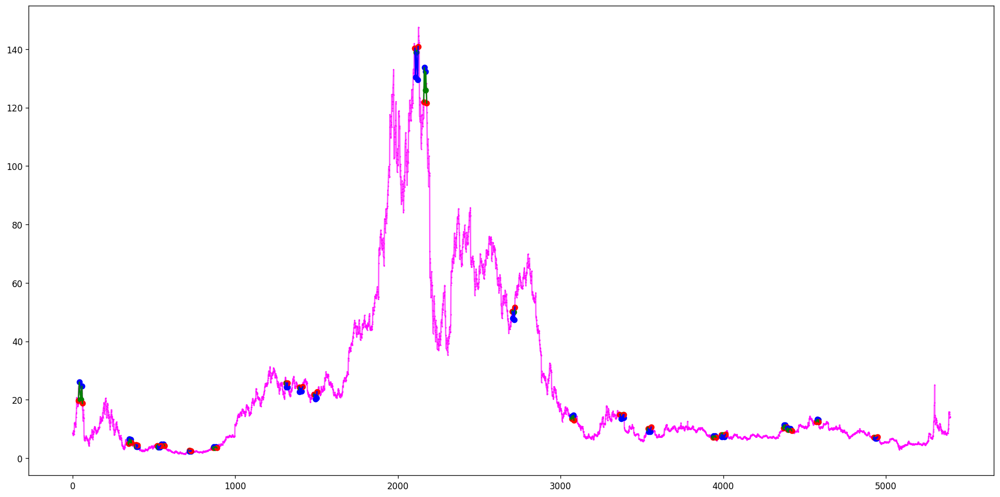

[]
[]
Ticker DAX found 0 double top patterns, 0 double bottom patterns


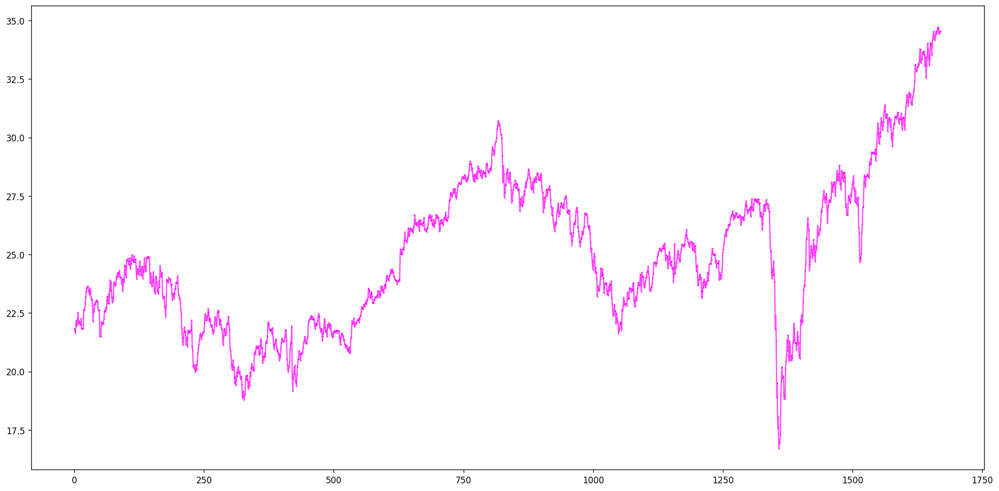

[(226, 229, 233, 236, 244), (710, 711, 712, 715, 721), (1387, 1389, 1392, 1395, 1396), (1376, 1378, 1380, 1389, 1402), (1439, 1443, 1450, 1459, 1464)]
[(245, 249, 254, 265, 269), (269, 270, 272, 276, 278), (711, 712, 715, 721, 729), (804, 808, 815, 818, 824), (844, 845, 850, 852, 855), (964, 968, 970, 973, 978), (1049, 1056, 1065, 1070, 1075), (1269, 1271, 1275, 1280, 1281), (1481, 1484, 1488, 1491, 1493), (1678, 1679, 1680, 1683, 1686), (1768, 1777, 1781, 1785, 1796)]
Ticker ETH-USD found 5 double top patterns, 11 double bottom patterns


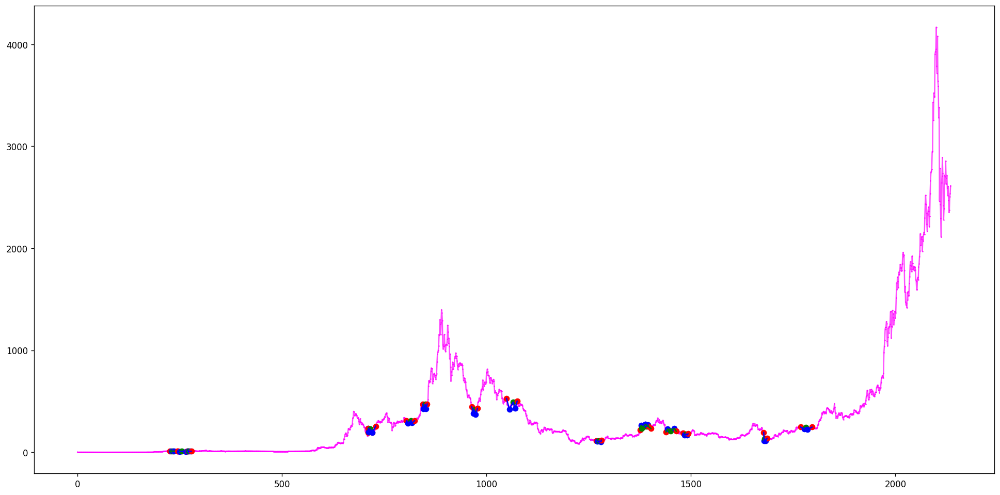

[(3, 4, 9, 10, 13), (168, 170, 185, 191, 196), (203, 209, 216, 221, 224), (2036, 2039, 2044, 2049, 2051), (2084, 2088, 2089, 2093, 2108), (2768, 2774, 2779, 2784, 2785), (3114, 3120, 3124, 3128, 3139), (3581, 3583, 3589, 3598, 3607), (3763, 3770, 3775, 3777, 3790), (4735, 4743, 4750, 4760, 4762), (5097, 5099, 5106, 5111, 5122)]
[(164, 168, 170, 185, 191), (702, 708, 714, 717, 725), (734, 736, 741, 751, 752), (885, 889, 897, 900, 910), (1583, 1584, 1586, 1591, 1595), (1583, 1591, 1595, 1605, 1608), (1795, 1800, 1803, 1807, 1812), (1917, 1923, 1927, 1933, 1935), (2374, 2380, 2386, 2391, 2397), (3772, 3775, 3777, 3790, 3793), (4787, 4789, 4799, 4804, 4811), (5149, 5153, 5158, 5161, 5164)]
Ticker F found 11 double top patterns, 12 double bottom patterns


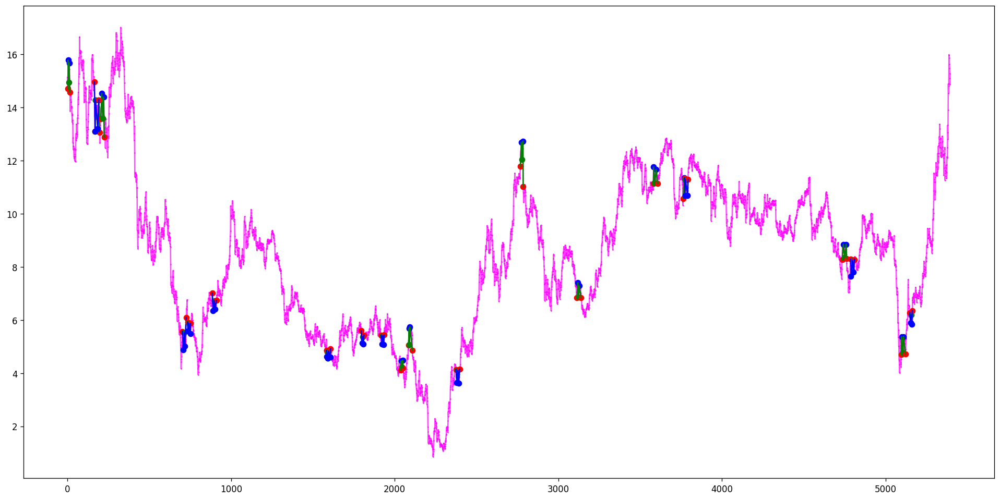

[(395, 402, 405, 419, 423), (473, 474, 476, 482, 485), (2119, 2122, 2125, 2126, 2127)]
[(483, 486, 491, 494, 505), (663, 668, 677, 684, 691)]
Ticker FB found 3 double top patterns, 2 double bottom patterns


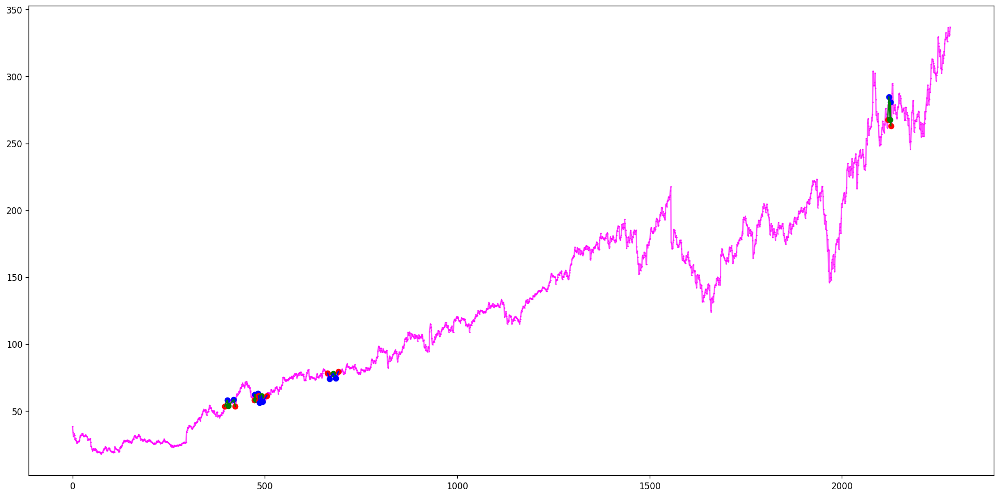

[(128, 131, 133, 137, 140), (286, 288, 291, 299, 301), (765, 770, 775, 776, 781), (1420, 1433, 1435, 1439, 1441), (1541, 1545, 1548, 1554, 1566), (1632, 1634, 1646, 1649, 1655), (1716, 1717, 1720, 1723, 1728), (2123, 2126, 2129, 2133, 2139), (2681, 2684, 2687, 2702, 2704), (3532, 3537, 3540, 3546, 3553), (4547, 4551, 4556, 4560, 4562), (4570, 4572, 4579, 4585, 4592), (4594, 4596, 4600, 4602, 4604), (4609, 4612, 4613, 4618, 4624)]
[(1103, 1110, 1115, 1117, 1122), (1489, 1493, 1496, 1500, 1502), (1751, 1753, 1758, 1765, 1770), (1935, 1946, 1949, 1953, 1959), (3228, 3233, 3245, 3249, 3252), (4024, 4028, 4030, 4037, 4041), (4456, 4460, 4465, 4474, 4479), (4572, 4575, 4576, 4579, 4581), (4591, 4594, 4596, 4600, 4602), (4591, 4594, 4602, 4604, 4610)]
Ticker GME found 14 double top patterns, 10 double bottom patterns


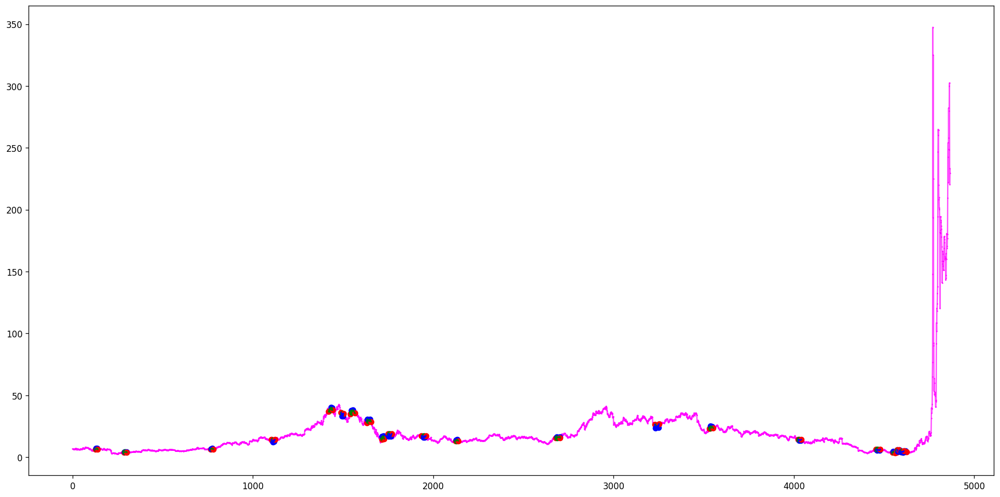

[(88, 94, 97, 104, 107), (823, 833, 838, 844, 850), (1055, 1056, 1060, 1061, 1062), (1449, 1457, 1461, 1466, 1473), (2773, 2775, 2778, 2789, 2796)]
[(813, 814, 815, 819, 822), (984, 986, 990, 996, 1000), (1019, 1022, 1026, 1027, 1029), (3572, 3574, 3581, 3589, 3597)]
Ticker GOOG found 5 double top patterns, 4 double bottom patterns


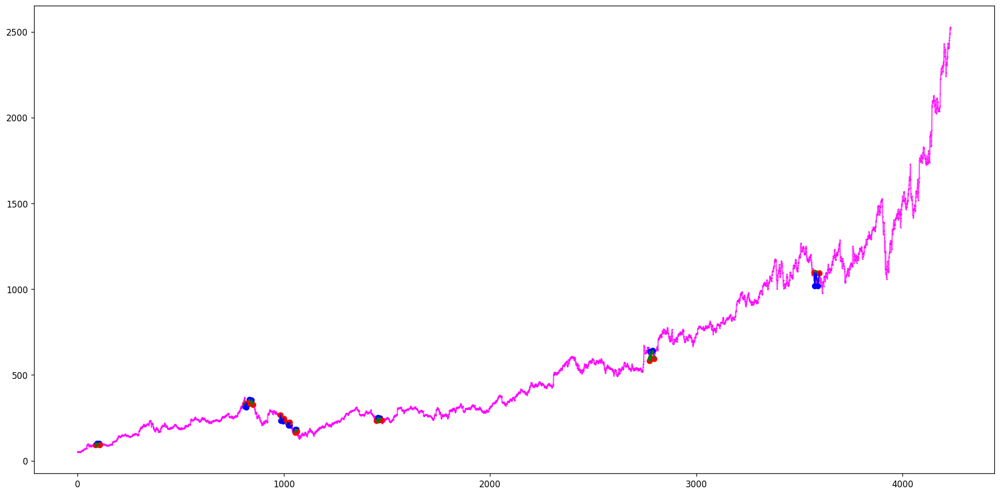

[(56, 58, 62, 65, 70), (107, 108, 115, 116, 119), (218, 224, 231, 234, 236), (2206, 2208, 2209, 2212, 2214)]
[(2292, 2297, 2301, 2307, 2313)]
Ticker IBM found 4 double top patterns, 1 double bottom patterns


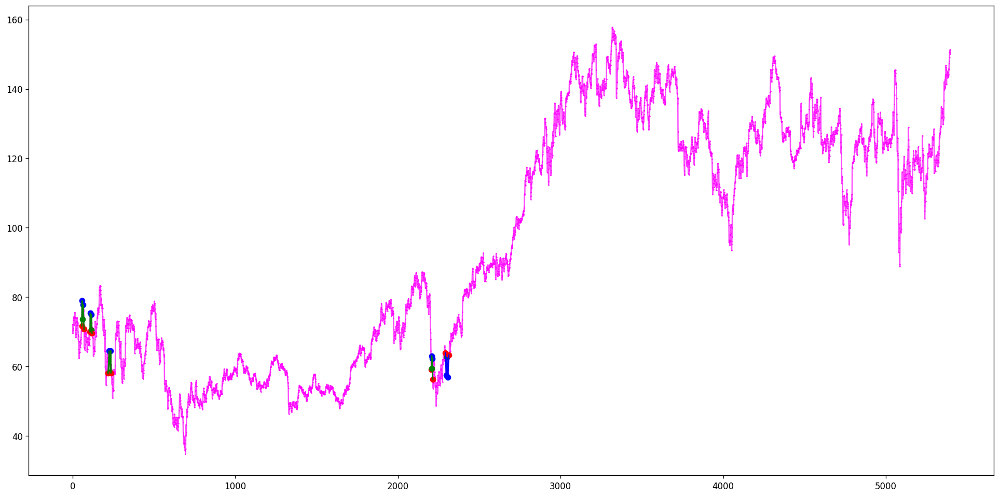

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(142, 146, 152, 155, 158), (801, 806, 813, 823, 824), (2206, 2207, 2208, 2212, 2215), (2242, 2252, 2257, 2263, 2269)]
[(42, 49, 51, 59, 64), (64, 68, 78, 82, 88), (64, 68, 78, 83, 88), (2212, 2217, 2230, 2235, 2240)]
Ticker KO found 4 double top patterns, 4 double bottom patterns


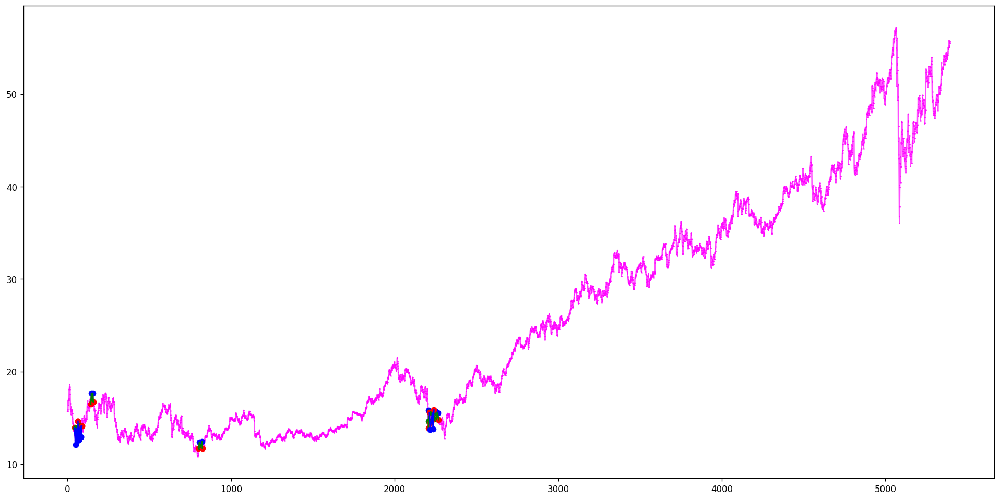

[(57, 64, 67, 76, 79), (278, 280, 285, 286, 287), (418, 419, 428, 430, 438), (579, 585, 593, 596, 604), (723, 727, 730, 733, 734), (1184, 1186, 1191, 1195, 1198), (1620, 1623, 1631, 1632, 1636), (2121, 2123, 2126, 2133, 2137), (2717, 2719, 2727, 2728, 2732), (3869, 3877, 3882, 3892, 3896), (4454, 4464, 4469, 4475, 4478)]
[(286, 291, 295, 304, 313), (1313, 1317, 1323, 1325, 1329), (1493, 1505, 1512, 1514, 1518), (2123, 2126, 2133, 2137, 2141), (2154, 2160, 2161, 2168, 2174), (2361, 2364, 2368, 2370, 2373), (2587, 2591, 2598, 2605, 2611), (2703, 2707, 2711, 2717, 2719), (2732, 2736, 2741, 2745, 2747), (3223, 3225, 3230, 3236, 3240), (4725, 4729, 4740, 4742, 4747)]
Ticker NFLX found 11 double top patterns, 11 double bottom patterns


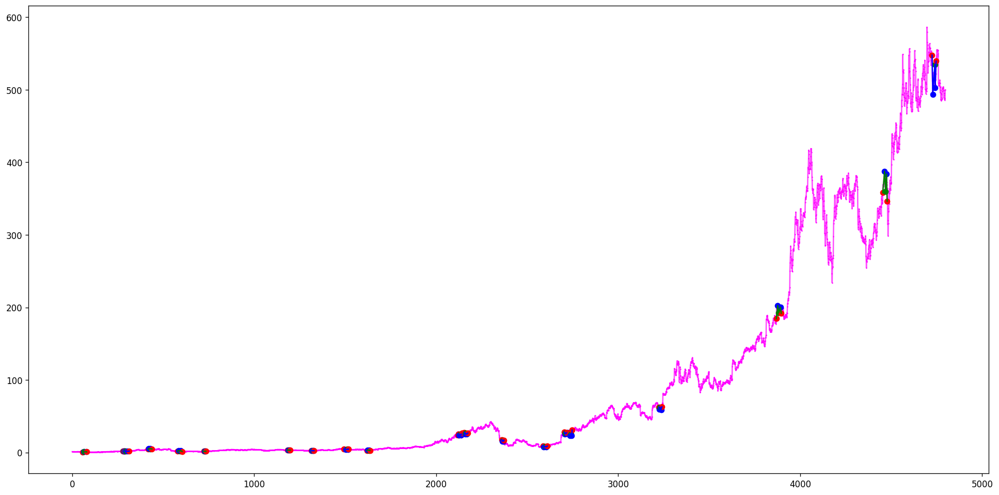

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(50, 58, 65, 67, 71), (132, 135, 137, 142, 143), (331, 334, 343, 348, 353), (480, 482, 488, 490, 493), (586, 587, 589, 594, 597), (654, 661, 668, 674, 680), (850, 856, 864, 867, 870), (850, 856, 864, 868, 870), (2027, 2031, 2035, 2048, 2052), (2247, 2253, 2260, 2265, 2269), (2362, 2365, 2369, 2373, 2375), (2706, 2711, 2715, 2717, 2724), (2977, 2979, 2983, 2985, 2991), (3257, 3261, 3267, 3272, 3274), (3274, 3276, 3281, 3283, 3284), (3334, 3336, 3339, 3341, 3342), (3867, 3873, 3885, 3891, 3895), (4485, 4490, 4496, 4503, 4509)]
[(244, 246, 249, 252, 253), (284, 288, 294, 299, 304), (482, 485, 486, 493, 500), (506, 508, 511, 513, 515), (787, 789, 794, 797, 799), (1615, 1619, 1621, 1630, 1633), (2180, 2183, 2186, 2189, 2191), (2213, 2217, 2220, 2221, 2223), (2227, 2229, 2230, 2235, 2238), (2275, 2278, 2280, 2283, 2286), (2374, 2380, 2385, 2391, 2396), (3201, 3206, 3207, 3215, 3218), (3219, 3224, 3228, 3233, 3240), (3219, 3226, 3228, 3233, 3240), (3572, 3575, 3583, 3586, 3588), (3815, 3818,

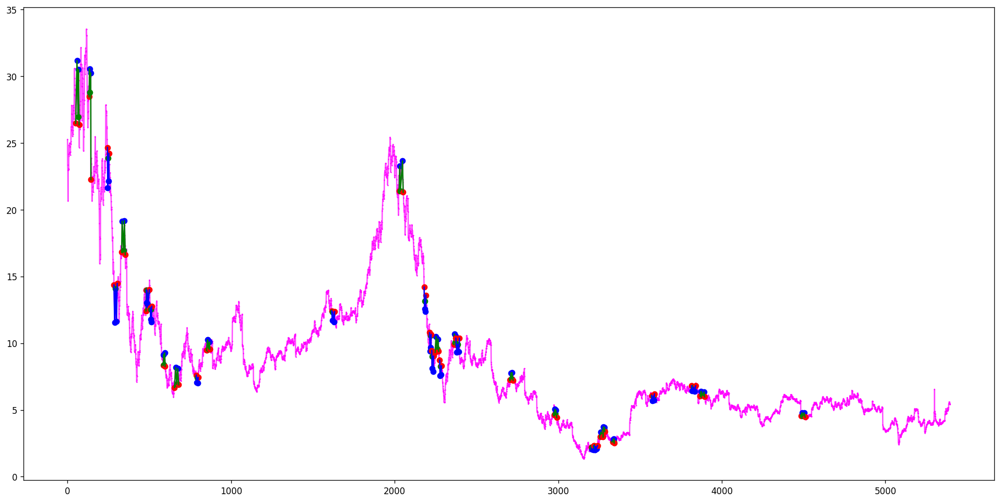

[(155, 160, 161, 170, 174), (397, 401, 405, 409, 410), (397, 401, 412, 416, 421), (967, 968, 975, 983, 989), (1359, 1361, 1365, 1368, 1369), (2103, 2105, 2108, 2118, 2121), (2207, 2208, 2210, 2213, 2215), (2247, 2254, 2260, 2266, 2272), (2326, 2331, 2344, 2347, 2350), (2365, 2373, 2382, 2385, 2391), (2365, 2373, 2382, 2386, 2391), (2903, 2907, 2911, 2915, 2916), (2961, 2966, 2970, 2976, 2978), (3485, 3490, 3496, 3503, 3509), (4385, 4386, 4387, 4395, 4399)]
[(194, 201, 203, 209, 213), (425, 426, 427, 438, 444), (577, 580, 583, 586, 588), (1201, 1203, 1207, 1208, 1210), (1804, 1810, 1814, 1823, 1824), (1804, 1812, 1814, 1823, 1824), (1894, 1907, 1911, 1916, 1919), (1947, 1949, 1952, 1955, 1959), (1976, 1977, 1978, 1986, 1988), (2202, 2207, 2208, 2216, 2220), (2915, 2918, 2921, 2927, 2934), (2976, 2979, 2983, 2991, 2993), (4586, 4594, 4601, 4607, 4614), (4772, 4775, 4780, 4781, 4783), (4927, 4928, 4931, 4936, 4937), (5202, 5204, 5209, 5215, 5218)]
Ticker NVDA found 15 double top patterns,

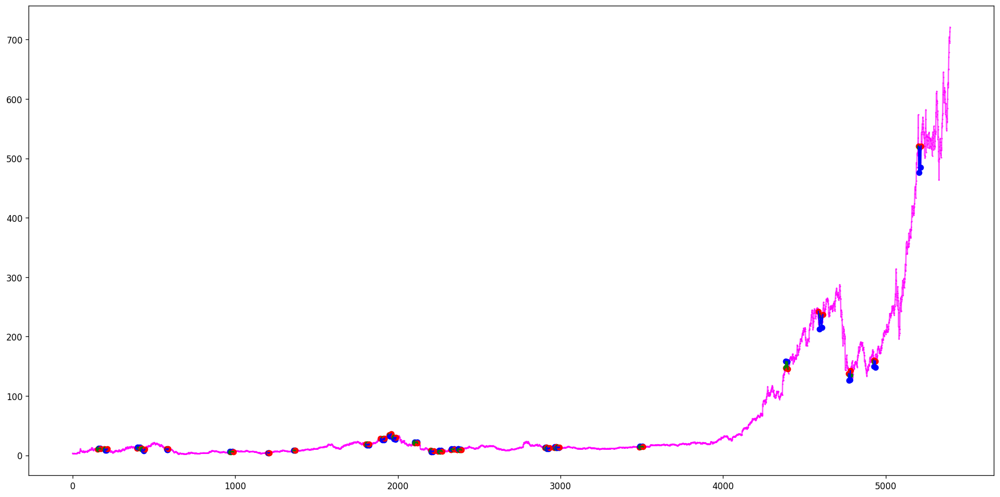

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(104, 108, 112, 113, 115), (940, 950, 957, 965, 968), (1368, 1372, 1377, 1378, 1379), (1578, 1584, 1587, 1594, 1597), (1664, 1677, 1681, 1684, 1687), (1778, 1781, 1789, 1793, 1796), (1820, 1825, 1826, 1829, 1832), (1960, 1961, 1962, 1966, 1971), (2169, 2171, 2173, 2176, 2177), (2245, 2246, 2247, 2250, 2251), (2332, 2334, 2339, 2343, 2353), (2332, 2335, 2339, 2343, 2353), (2332, 2337, 2339, 2343, 2353), (2568, 2571, 2574, 2577, 2587), (2568, 2572, 2574, 2577, 2587), (2654, 2657, 2660, 2663, 2668), (2685, 2687, 2693, 2694, 2701), (2685, 2687, 2693, 2695, 2701), (2685, 2687, 2693, 2699, 2701), (2685, 2690, 2693, 2694, 2701), (2685, 2690, 2693, 2695, 2701), (2685, 2690, 2693, 2699, 2701), (3086, 3087, 3095, 3100, 3114), (3502, 3504, 3505, 3509, 3518), (3657, 3658, 3661, 3664, 3667), (3705, 3708, 3713, 3714, 3717), (3799, 3800, 3804, 3807, 3813), (4303, 4304, 4307, 4312, 4315), (4352, 4355, 4361, 4362, 4364), (4724, 4730, 4736, 4744, 4748), (5102, 5104, 5106, 5110, 5113), (5187, 5199, 5201

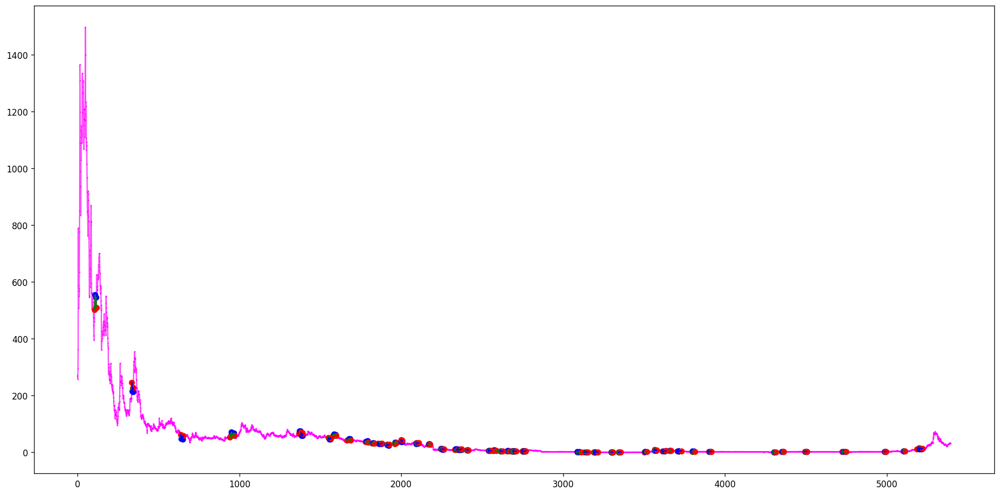

[(134, 136, 140, 143, 145), (198, 200, 207, 209, 211), (269, 271, 280, 284, 286), (334, 335, 337, 340, 342), (467, 472, 481, 483, 485), (592, 597, 600, 607, 608), (592, 607, 608, 612, 614), (655, 662, 671, 673, 680), (1986, 1988, 1992, 1998, 2001), (1978, 1982, 1986, 1988, 2002), (2109, 2118, 2122, 2128, 2131), (2272, 2281, 2286, 2289, 2298), (4121, 4125, 4138, 4145, 4146)]
[(196, 198, 200, 212, 221), (251, 253, 254, 265, 271), (331, 333, 340, 344, 346), (707, 710, 715, 718, 721), (781, 782, 785, 790, 801), (884, 890, 895, 904, 910), (2007, 2015, 2019, 2025, 2026), (2129, 2135, 2143, 2150, 2152), (2231, 2236, 2241, 2242, 2248), (2293, 2298, 2305, 2308, 2309), (3113, 3115, 3121, 3124, 3127), (3257, 3259, 3261, 3268, 3270), (4550, 4552, 4559, 4564, 4566)]
Ticker QCOM found 13 double top patterns, 13 double bottom patterns


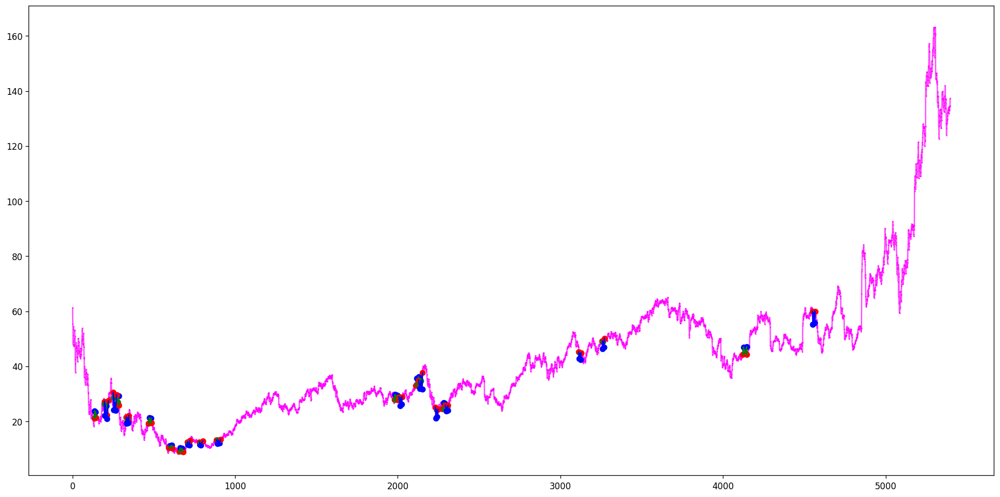

[(1985, 1995, 2000, 2006, 2012), (2363, 2371, 2381, 2385, 2390)]
[(378, 382, 384, 392, 399), (2374, 2381, 2385, 2390, 2396), (2607, 2614, 2619, 2623, 2627), (2914, 2917, 2922, 2926, 2932)]
Ticker QQQ found 2 double top patterns, 4 double bottom patterns


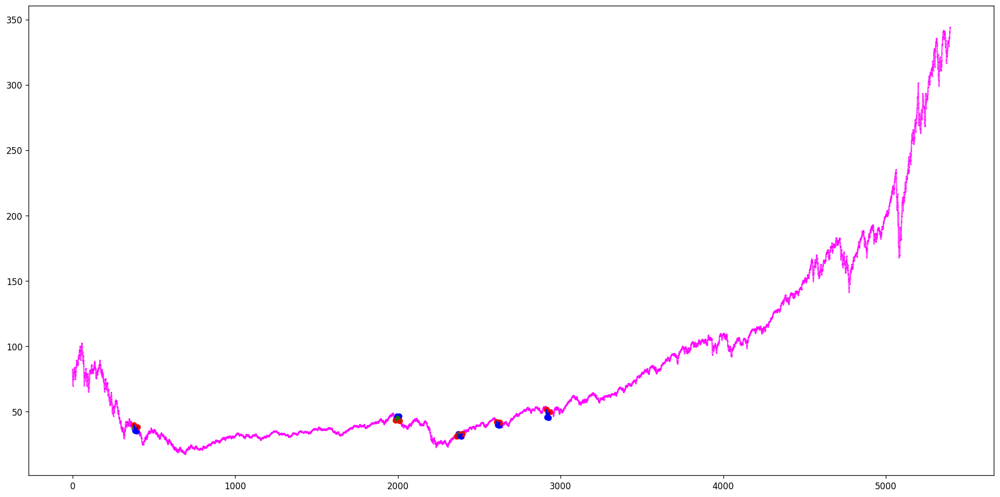

[]
[]
Ticker QYLD found 0 double top patterns, 0 double bottom patterns


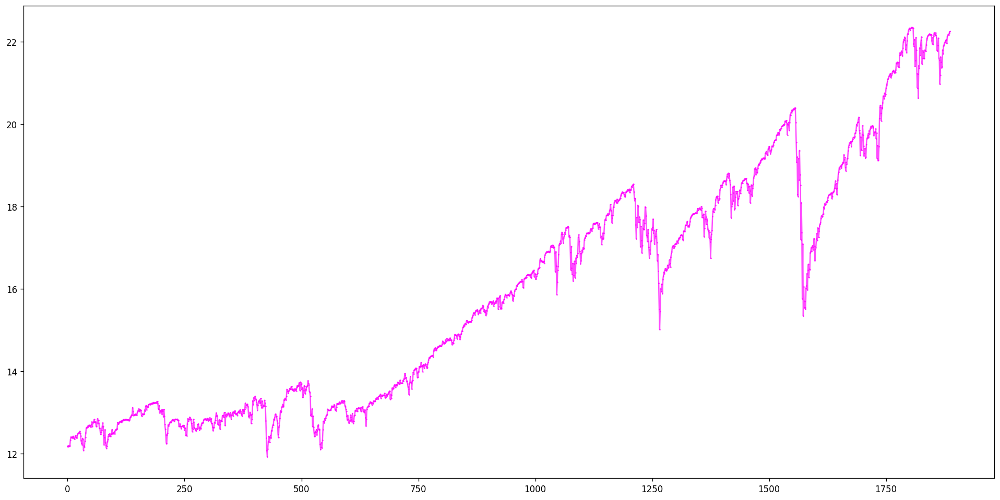

[(2, 4, 8, 11, 13), (54, 55, 63, 67, 72), (148, 151, 156, 157, 162), (434, 440, 442, 447, 453), (1697, 1702, 1711, 1716, 1720), (1992, 1995, 2003, 2005, 2011), (2412, 2416, 2419, 2425, 2430), (4102, 4104, 4109, 4113, 4116), (5111, 5113, 5117, 5119, 5121)]
[(1649, 1650, 1655, 1661, 1666), (4930, 4935, 4940, 4943, 4948), (4996, 5003, 5007, 5011, 5014), (5141, 5142, 5147, 5153, 5158)]
Ticker R found 9 double top patterns, 4 double bottom patterns


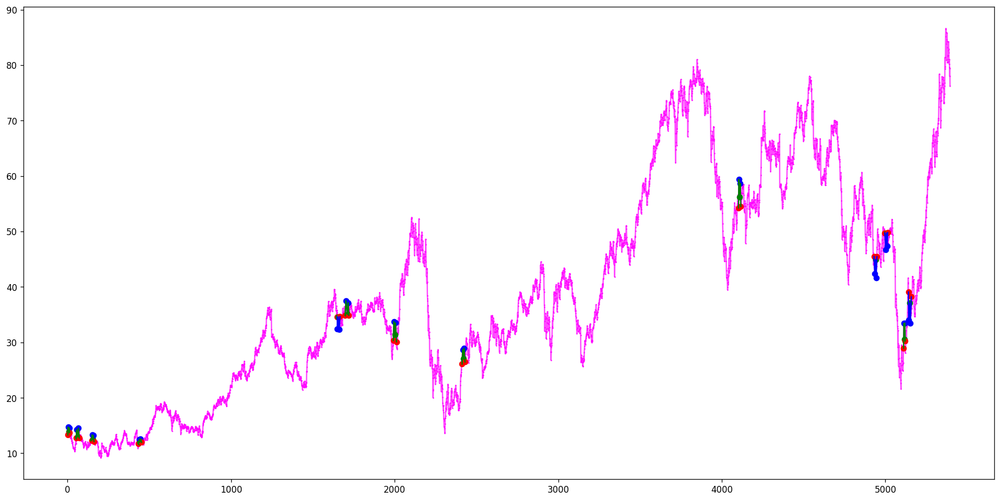

[]
[(412, 416, 419, 422, 425)]
Ticker RIDE found 0 double top patterns, 1 double bottom patterns


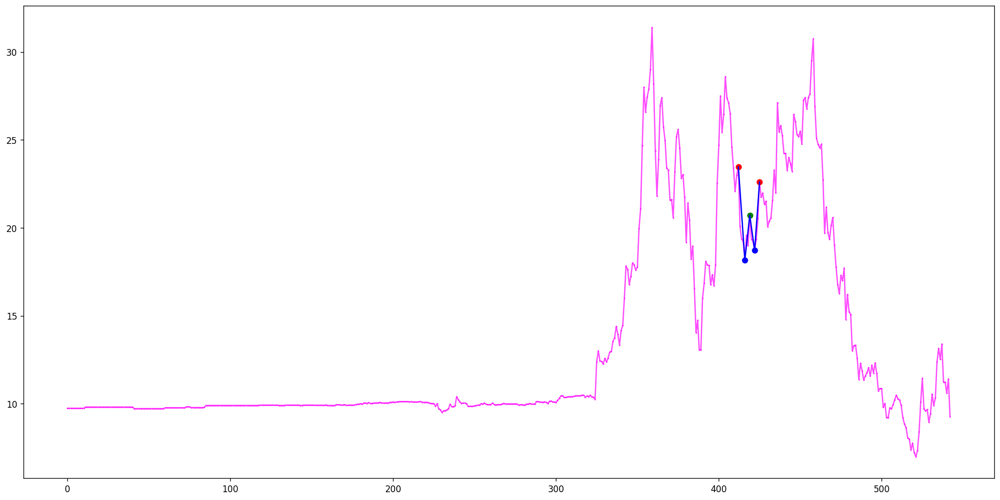

[(2, 13, 17, 21, 24), (2, 13, 17, 22, 24), (306, 316, 323, 327, 334), (306, 316, 323, 328, 334), (639, 642, 652, 657, 663), (948, 949, 951, 957, 960), (1094, 1096, 1100, 1103, 1110)]
[(49, 54, 57, 61, 72), (178, 179, 180, 189, 193), (395, 404, 406, 411, 415), (500, 502, 507, 509, 512), (848, 850, 856, 861, 863), (1065, 1069, 1075, 1078, 1088), (1076, 1078, 1085, 1087, 1088), (1128, 1129, 1133, 1138, 1140), (1251, 1254, 1261, 1263, 1267), (1288, 1289, 1290, 1295, 1298)]
Ticker RIOT found 7 double top patterns, 10 double bottom patterns


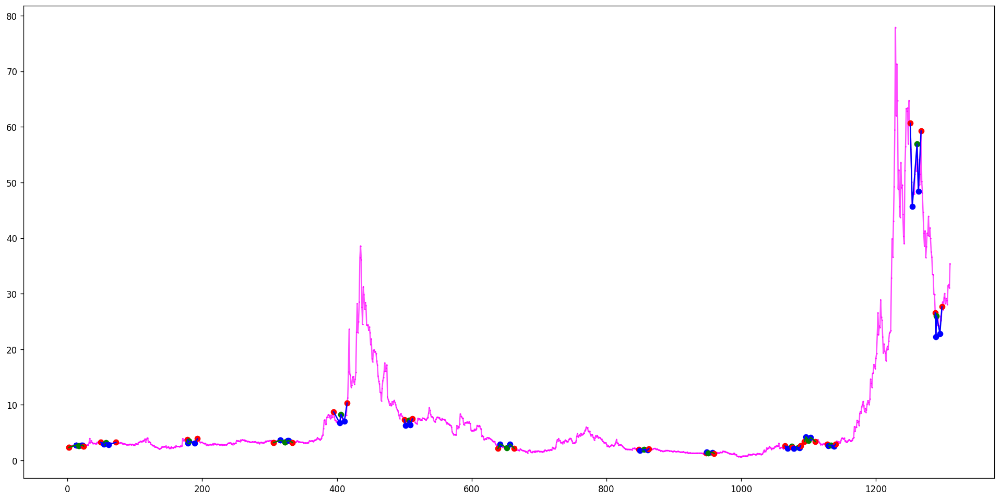

[(8, 13, 18, 21, 25), (229, 230, 232, 239, 246), (452, 462, 465, 472, 478), (583, 587, 595, 601, 603), (1829, 1831, 1833, 1840, 1843), (2005, 2006, 2008, 2011, 2014), (2144, 2145, 2148, 2149, 2150), (2199, 2201, 2205, 2208, 2215), (3922, 3932, 3938, 3943, 3944), (4414, 4418, 4428, 4430, 4441), (4537, 4542, 4553, 4559, 4564), (4955, 4957, 4966, 4970, 4976), (5112, 5117, 5122, 5131, 5135)]
[(230, 232, 239, 246, 251), (462, 465, 472, 478, 487), (488, 493, 503, 507, 510), (592, 595, 601, 604, 610), (808, 813, 814, 823, 833), (1327, 1329, 1330, 1333, 1340), (1769, 1775, 1777, 1782, 1786), (1818, 1822, 1825, 1829, 1831), (1858, 1860, 1865, 1867, 1868), (2012, 2016, 2019, 2034, 2038), (2098, 2101, 2103, 2106, 2111), (2396, 2399, 2401, 2409, 2414), (4143, 4149, 4153, 4162, 4167), (4542, 4546, 4549, 4553, 4559)]
Ticker SNP found 13 double top patterns, 14 double bottom patterns


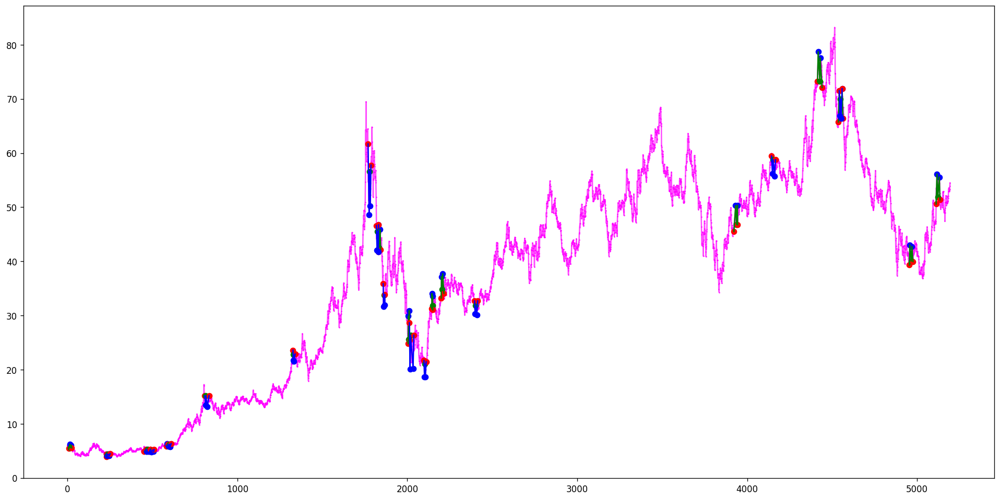

[(636, 638, 652, 655, 658), (665, 667, 674, 675, 678), (665, 670, 674, 675, 678)]
[(641, 644, 648, 652, 653), (734, 738, 740, 750, 753)]
Ticker SPCE found 3 double top patterns, 2 double bottom patterns


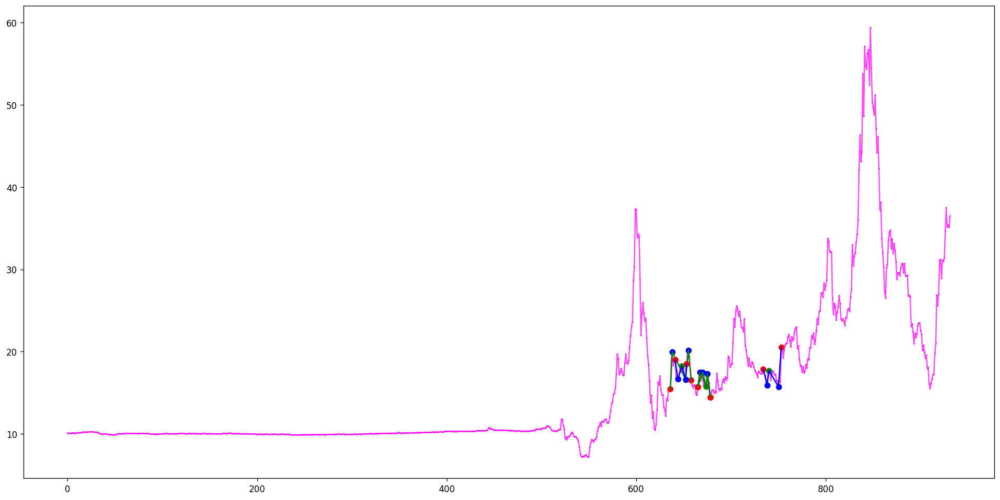

[(72, 78, 89, 93, 98), (2206, 2207, 2209, 2212, 2216), (2274, 2280, 2283, 2288, 2293), (2927, 2934, 2940, 2945, 2949)]
[(82, 89, 93, 100, 105), (300, 307, 310, 315, 322)]
Ticker SPY found 4 double top patterns, 2 double bottom patterns


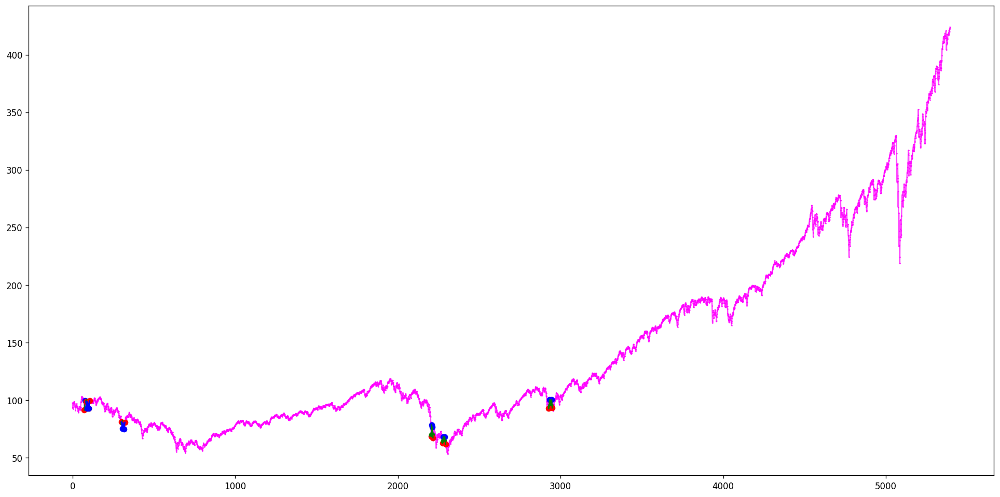

[(2026, 2030, 2036, 2039, 2042), (2206, 2208, 2209, 2212, 2214), (2217, 2223, 2225, 2230, 2234), (2241, 2246, 2251, 2263, 2268)]
[(71, 76, 78, 85, 89), (263, 269, 273, 279, 290), (574, 580, 582, 589, 591), (933, 937, 944, 949, 957), (2150, 2158, 2163, 2173, 2176), (2914, 2917, 2924, 2926, 2929), (4732, 4735, 4743, 4754, 4759), (5084, 5086, 5089, 5095, 5099)]
Ticker T found 4 double top patterns, 8 double bottom patterns


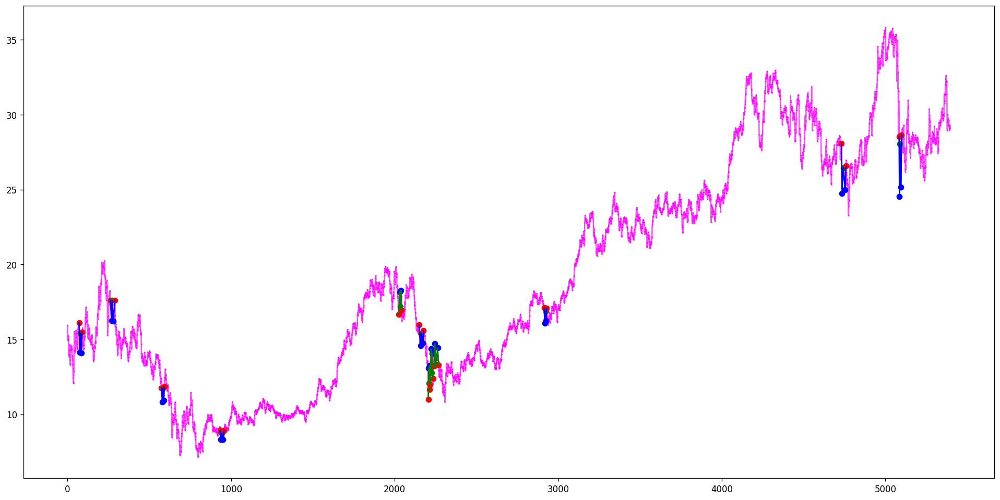

[(11, 13, 22, 24, 27), (143, 147, 154, 155, 160), (142, 147, 160, 161, 164), (347, 351, 356, 364, 366), (533, 536, 542, 544, 546), (648, 657, 663, 664, 666), (957, 959, 963, 968, 971), (1153, 1159, 1164, 1169, 1175), (2156, 2165, 2176, 2181, 2183), (2414, 2416, 2417, 2426, 2432), (2649, 2651, 2652, 2662, 2665)]
[(13, 15, 17, 22, 24), (147, 154, 155, 160, 161), (472, 477, 483, 487, 497), (575, 580, 582, 589, 591), (565, 567, 571, 580, 593), (664, 668, 679, 684, 692), (1177, 1184, 1191, 1194, 1199), (1850, 1851, 1864, 1873, 1877), (1958, 1969, 1974, 1975, 1977)]
Ticker TSLA found 11 double top patterns, 9 double bottom patterns


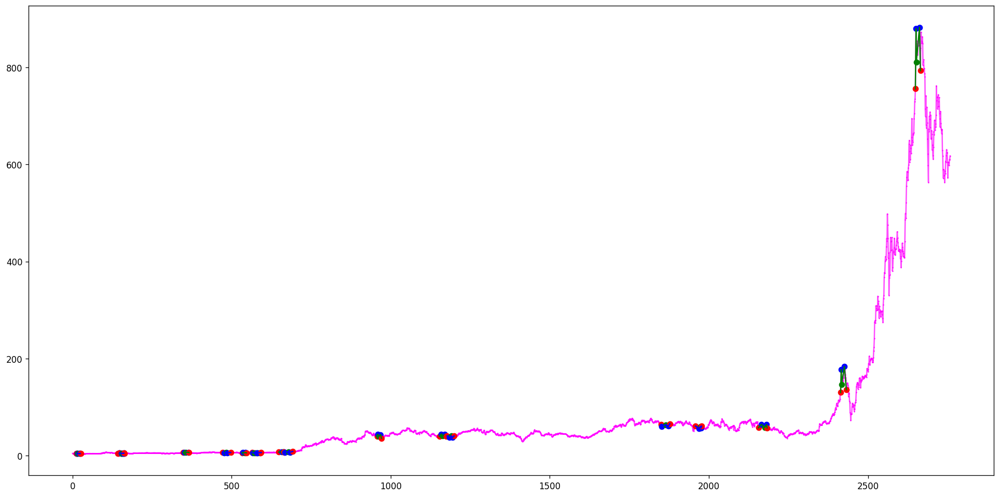

[(181, 183, 186, 190, 198), (181, 183, 198, 202, 208), (647, 656, 659, 664, 671), (898, 902, 905, 912, 914), (2661, 2665, 2670, 2671, 2674)]
[(851, 854, 859, 863, 866), (2657, 2661, 2665, 2674, 2680)]
Ticker V found 5 double top patterns, 2 double bottom patterns


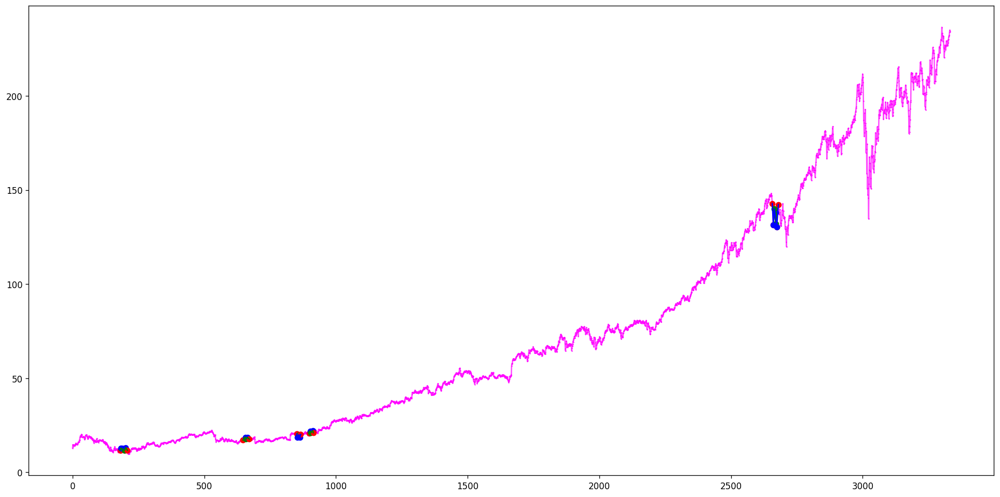

[(537, 543, 545, 550, 559), (1216, 1221, 1232, 1238, 1240), (1438, 1445, 1451, 1457, 1460), (1480, 1485, 1490, 1493, 1494), (1480, 1485, 1490, 1496, 1502), (2631, 2640, 2647, 2650, 2656), (3019, 3020, 3023, 3033, 3043)]
[(716, 717, 719, 728, 732), (846, 847, 851, 853, 854), (996, 999, 1001, 1006, 1008), (1034, 1044, 1047, 1052, 1058), (1620, 1624, 1631, 1634, 1641), (3661, 3664, 3669, 3672, 3674), (3728, 3731, 3736, 3743, 3754)]
Ticker VIAC found 7 double top patterns, 7 double bottom patterns


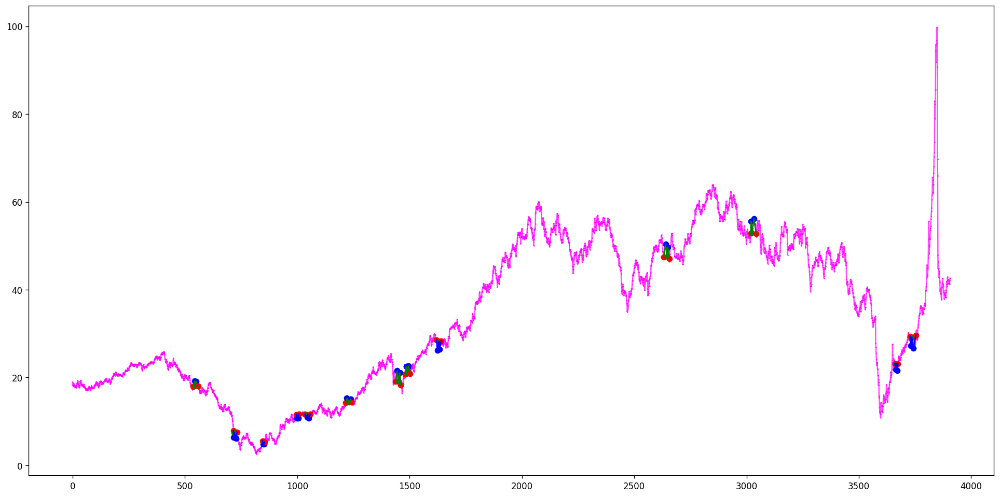

[(607, 610, 614, 618, 625)]
[(622, 625, 629, 636, 637)]
Ticker VICI found 1 double top patterns, 1 double bottom patterns


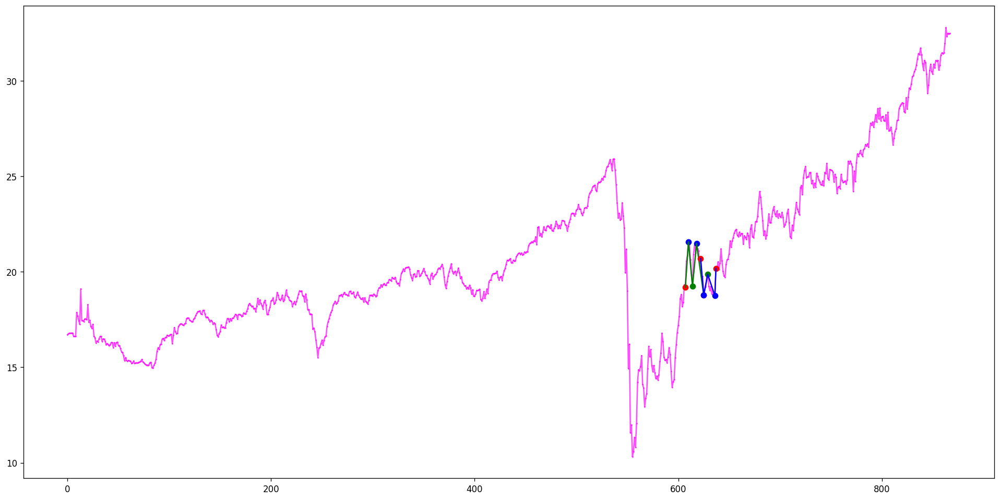

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(126, 131, 137, 142, 147), (289, 290, 292, 296, 299), (654, 656, 668, 674, 680), (1044, 1046, 1049, 1052, 1058), (1188, 1195, 1201, 1206, 1209), (1282, 1285, 1288, 1293, 1295), (1425, 1431, 1433, 1436, 1443), (1727, 1733, 1735, 1745, 1750), (1999, 2006, 2009, 2020, 2025), (2171, 2172, 2173, 2179, 2182), (2205, 2210, 2217, 2221, 2228), (2241, 2243, 2251, 2255, 2257), (2415, 2416, 2419, 2427, 2430), (2617, 2619, 2622, 2627, 2634), (2927, 2932, 2940, 2944, 2949), (3330, 3337, 3342, 3349, 3352), (3494, 3500, 3504, 3505, 3507), (3960, 3963, 3970, 3971, 3974), (4054, 4055, 4061, 4065, 4078), (4085, 4086, 4088, 4095, 4096), (4101, 4102, 4104, 4110, 4115), (4101, 4102, 4104, 4122, 4126), (4104, 4110, 4115, 4122, 4126), (4280, 4285, 4290, 4294, 4297), (4438, 4440, 4443, 4446, 4450), (4970, 4974, 4975, 4979, 4981), (5028, 5029, 5032, 5034, 5035), (5263, 5265, 5268, 5272, 5275)]
[(179, 180, 184, 186, 188), (290, 292, 296, 299, 301), (313, 316, 317, 323, 326), (386, 388, 390, 396, 401), (533, 534

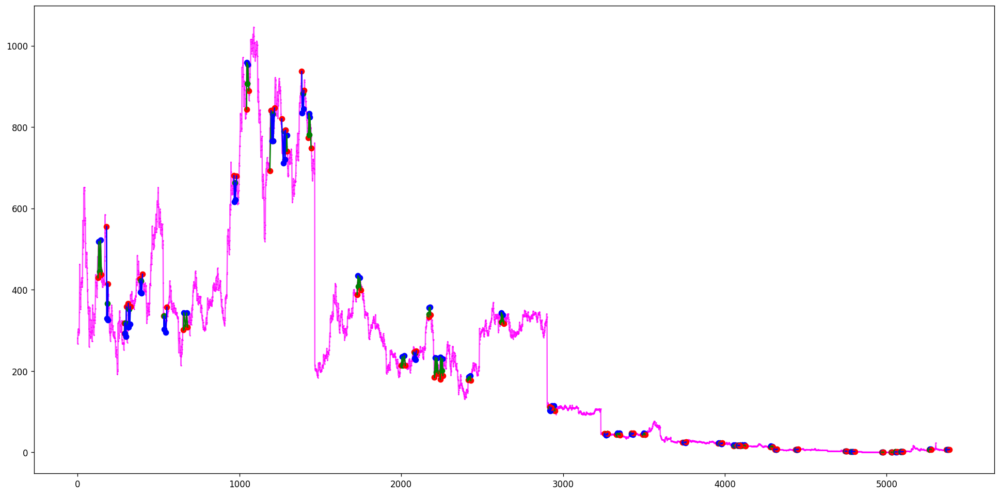

[(642, 645, 654, 658, 668), (801, 806, 812, 814, 818), (2205, 2208, 2209, 2212, 2214), (2244, 2246, 2251, 2263, 2265)]
[(151, 152, 155, 158, 160), (150, 152, 160, 162, 164), (574, 580, 582, 589, 591), (2202, 2205, 2212, 2216, 2218)]
Ticker VZ found 4 double top patterns, 4 double bottom patterns


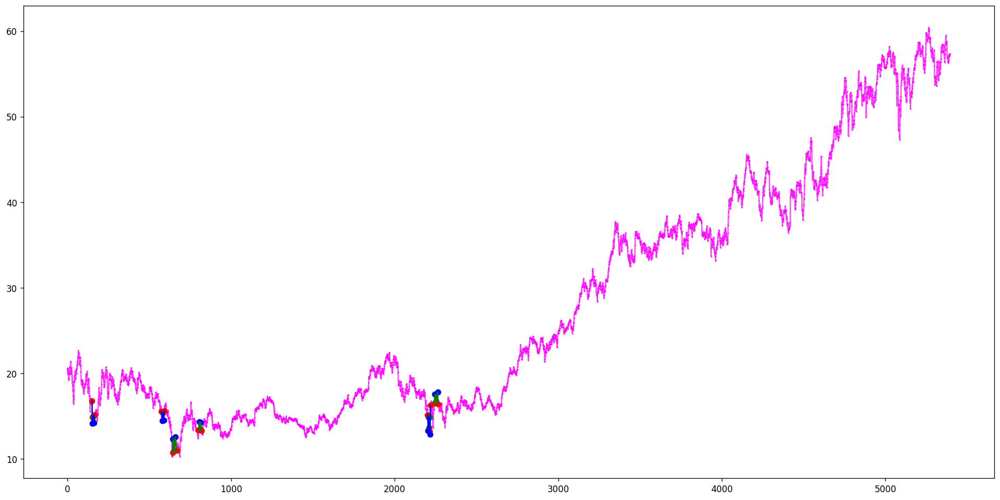

[(113, 115, 119, 122, 125), (192, 199, 209, 211, 213), (261, 264, 268, 278, 279), (354, 356, 364, 366, 367), (1623, 1627, 1634, 1637, 1647)]
[(144, 148, 150, 156, 160), (434, 440, 446, 449, 458), (1281, 1282, 1291, 1294, 1298), (1281, 1282, 1298, 1303, 1305)]
Ticker W found 5 double top patterns, 4 double bottom patterns


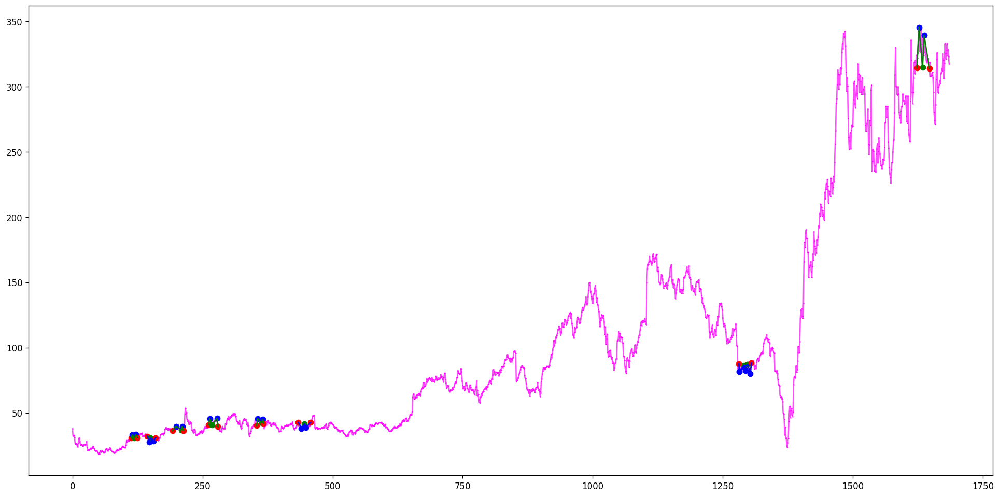

[(2217, 2218, 2220, 2223, 2225), (2362, 2364, 2367, 2371, 2377), (2514, 2518, 2530, 2534, 2539), (2577, 2588, 2593, 2597, 2600), (2641, 2646, 2651, 2660, 2669), (2685, 2694, 2697, 2706, 2712), (2966, 2975, 2977, 2982, 2991), (3935, 3937, 3940, 3950, 3954)]
[(64, 73, 78, 85, 91), (114, 115, 123, 125, 127), (114, 118, 123, 125, 127), (2375, 2380, 2385, 2393, 2394), (2414, 2419, 2423, 2431, 2439), (2916, 2919, 2922, 2927, 2932), (2935, 2940, 2944, 2949, 2959), (2944, 2949, 2954, 2956, 2959)]
Ticker WFC found 8 double top patterns, 8 double bottom patterns


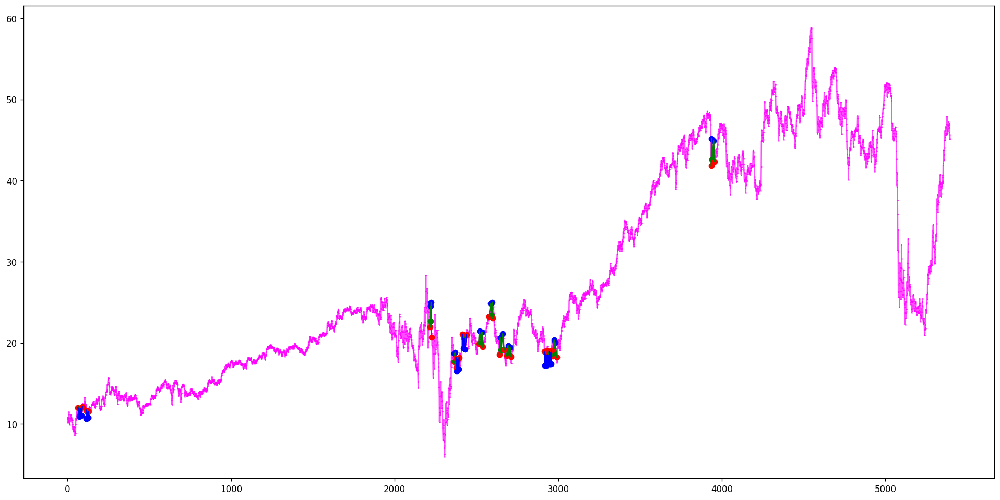

[(88, 93, 102, 106, 111), (608, 615, 618, 622, 624), (2243, 2245, 2250, 2263, 2267)]
[(109, 111, 114, 119, 122), (187, 197, 205, 208, 212), (363, 366, 370, 380, 384), (634, 638, 643, 648, 655), (2139, 2144, 2149, 2153, 2159), (2274, 2285, 2287, 2292, 2294)]
Ticker WMT found 3 double top patterns, 6 double bottom patterns


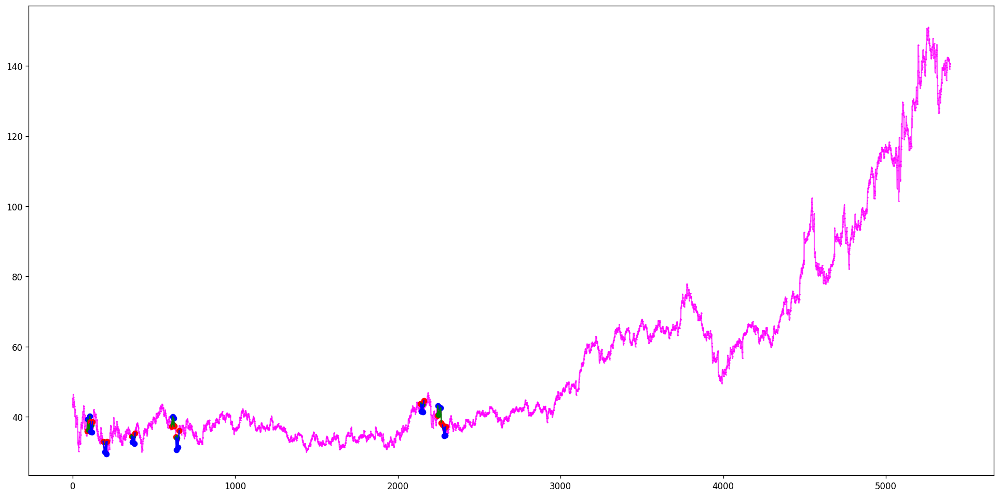

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(60, 70, 77, 84, 87), (996, 1005, 1014, 1017, 1021), (1394, 1402, 1405, 1409, 1414), (1662, 1664, 1674, 1677, 1681), (2014, 2018, 2021, 2027, 2033), (2097, 2106, 2110, 2119, 2122), (2518, 2519, 2524, 2525, 2527), (2650, 2654, 2658, 2672, 2676), (3392, 3394, 3403, 3408, 3413), (3791, 3794, 3797, 3802, 3813), (3859, 3863, 3875, 3876, 3885), (3962, 3966, 3978, 3984, 3986), (4008, 4010, 4015, 4018, 4028), (4093, 4098, 4102, 4107, 4112), (4257, 4260, 4268, 4269, 4276), (4256, 4260, 4276, 4278, 4284), (4893, 4895, 4898, 4902, 4907), (5163, 5165, 5168, 5173, 5174), (5163, 5166, 5168, 5173, 5174), (5182, 5185, 5192, 5197, 5203), (5182, 5189, 5192, 5197, 5203), (5182, 5191, 5192, 5197, 5203), (5234, 5238, 5239, 5243, 5244)]
[(71, 77, 84, 87, 96), (71, 77, 84, 89, 96), (428, 433, 439, 441, 443), (428, 433, 444, 449, 452), (678, 682, 690, 694, 698), (733, 743, 754, 756, 758), (733, 747, 754, 756, 758), (797, 801, 806, 812, 818), (1048, 1054, 1057, 1060, 1063), (1345, 1347, 1350, 1365, 1370), (15

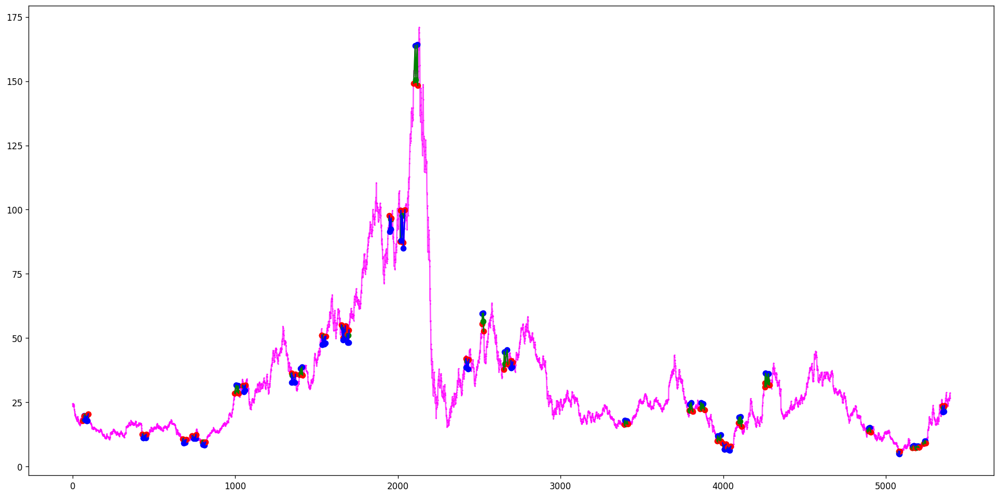

[(5221, 5225, 5234, 5235, 5238)]
[(197, 202, 211, 213, 225), (304, 308, 313, 315, 318), (467, 471, 482, 488, 495), (2020, 2023, 2025, 2034, 2042)]
Ticker XOM found 1 double top patterns, 4 double bottom patterns


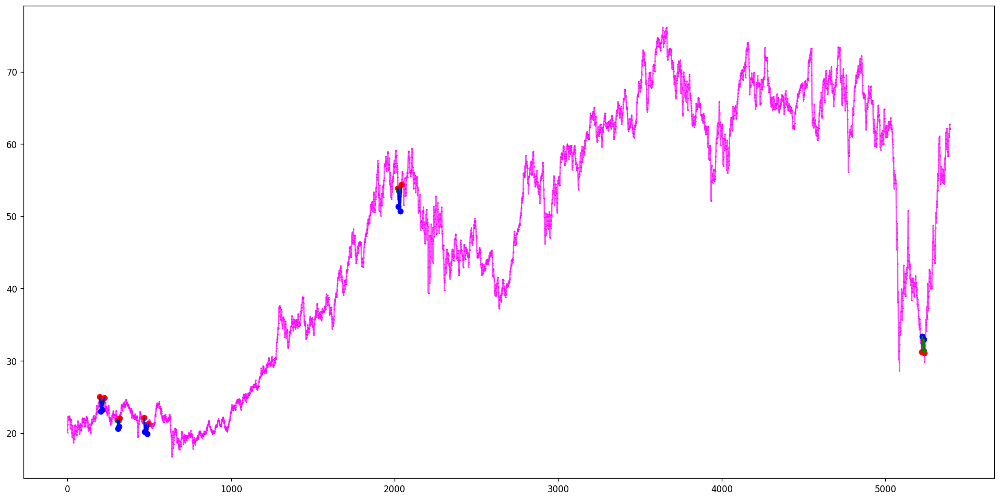

[(93, 94, 97, 101, 108)]
[]
Ticker XPEV found 1 double top patterns, 0 double bottom patterns


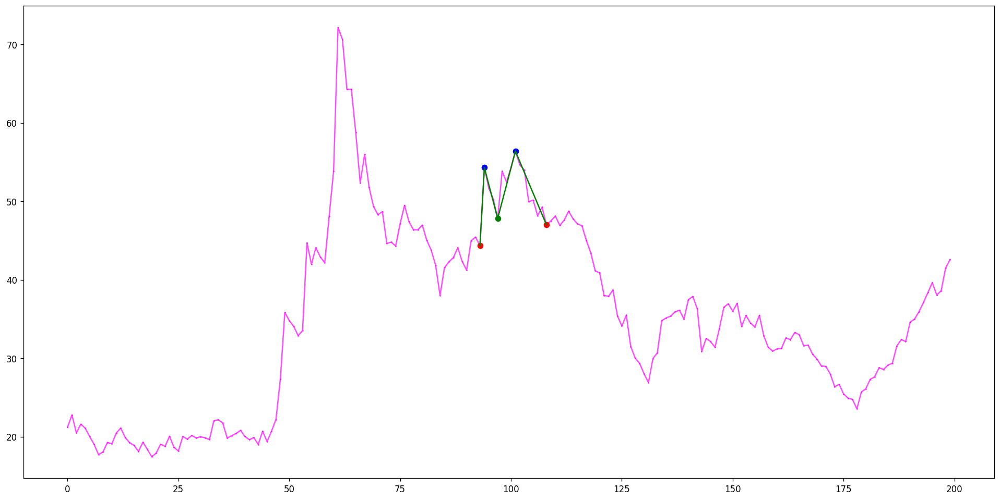

[(5087, 5091, 5095, 5099, 5115), (5181, 5183, 5190, 5200, 5208)]
[(2204, 2206, 2208, 2217, 2221)]
Ticker Y found 2 double top patterns, 1 double bottom patterns


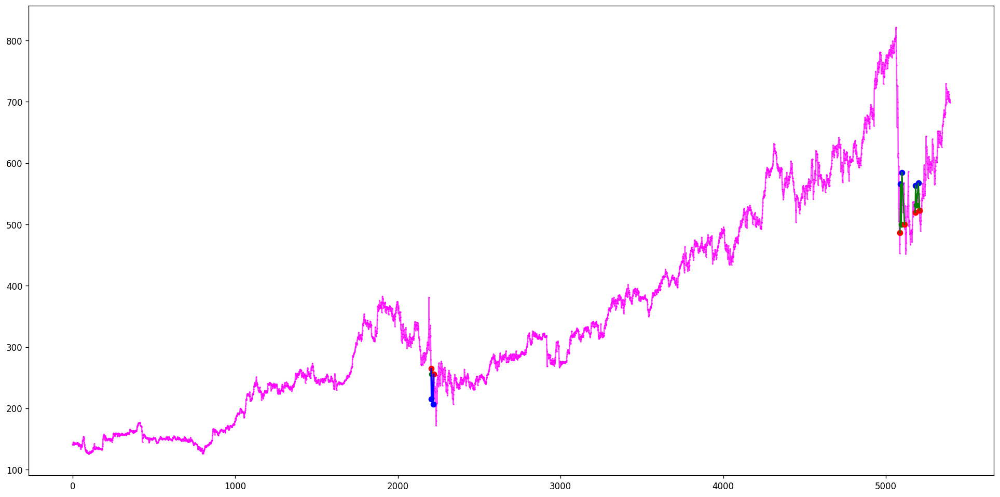

[(145, 150, 155, 166, 169), (489, 492, 496, 508, 509), (1209, 1220, 1223, 1231, 1234), (1367, 1371, 1374, 1376, 1381)]
[(3, 10, 12, 15, 30), (297, 303, 310, 313, 317), (382, 384, 387, 396, 407), (801, 805, 815, 817, 820), (1040, 1049, 1052, 1055, 1058), (1327, 1329, 1330, 1335, 1336)]
Ticker Z found 4 double top patterns, 6 double bottom patterns


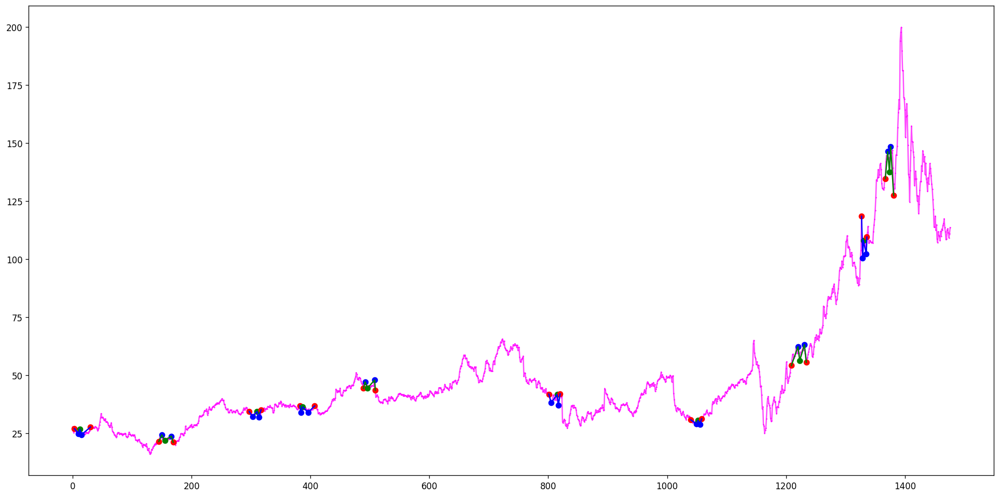

[(8, 10, 12, 15, 16), (314, 315, 319, 327, 331)]
[(309, 314, 315, 319, 327), (426, 430, 432, 436, 438)]
Ticker ZM found 2 double top patterns, 2 double bottom patterns


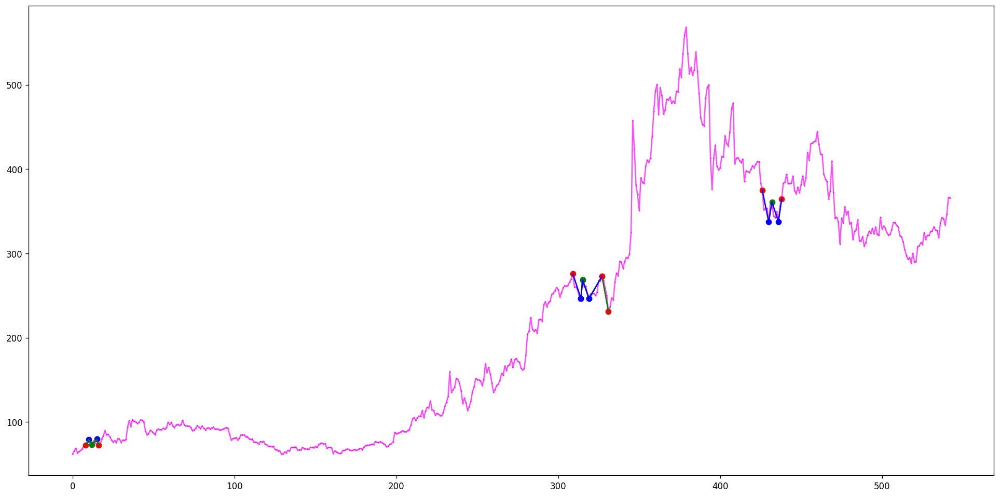

In [ ]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

for ticker in ticker_dfs.keys():
    ticker_df = ticker_dfs[ticker]
    if ticker_df is None:
        continue

    # discrete dataset
    x_data = ticker_df.index.to_numpy()      # the index will be our x axis, not date
    y_data = ticker_df[price_name].to_numpy()
    # scaler = MinMaxScaler(feature_range = (0, 100))
    # y_data = scaler.fit_transform(y_data.reshape(-1, 1)).reshape(-1)
    # y_fit = kalmanSmooth(y_data)
    y_fit = y_data  # do not smoothing data
    # y_fit = gaussfit(x_data, y_data)
    # print(x_data)
    # print(y_data)

    # suspected_double_tops = []
    # suspected_double_bottoms = []
    # suspected_double_tops = find_double_top_in_pre_time_steps(x_data, y_data, pre_time_steps, smooth=True)
    # suspected_double_bottoms = find_double_bot_in_pre_time_steps(x_data, y_data, pre_time_steps, smooth=True)
    suspected_double_tops = find_double_top_in_pre_time_steps(x_data, y_fit, pre_time_steps)
    suspected_double_bottoms = find_double_bot_in_pre_time_steps(x_data, y_fit, pre_time_steps)
    # suspected_double_tops = find_double_top_in_pre_time_steps(x_data, y_data, pre_time_steps)
    # suspected_double_bottoms = find_double_bot_in_pre_time_steps(x_data, y_data, pre_time_steps)
    # suspected_double_tops = find_double_top(x_data, y_data)
    # suspected_double_bottoms = find_double_bottom(x_data, y_data)
    print(suspected_double_tops)
    print(suspected_double_bottoms)
    print('Ticker {} found {} double top patterns, {} double bottom patterns'.format(ticker, len(suspected_double_tops), len(suspected_double_bottoms)))
    # save_data_price_patterns(x_data, y_data, suspected_double_tops,
    #                          "{}_{}_{}_{}_double_top_data_patterns.csv"
    #                          .format(ticker, start_time, end_time, pre_time_steps))
    # save_data_price_patterns(x_data, y_data, suspected_double_bottoms,
    #                          "{}_{}_{}_{}_double_bot_data_patterns.csv"
    #                          .format(ticker, start_time, end_time, pre_time_steps))
    for i, double_top in enumerate(suspected_double_tops):
        save_data_price_pattern(ticker_df,
                                double_top,
                                "{}_{}_{}_{}_{:03d}_double_top_data_pattern.csv"
                                .format(ticker, start_time, end_time, pre_time_steps, i))
    for i, double_bot in enumerate(suspected_double_bottoms):
        save_data_price_pattern(ticker_df,
                                double_bot,
                                "{}_{}_{}_{}_{:03d}_double_bot_data_pattern.csv"
                                .format(ticker, start_time, end_time, pre_time_steps, i))

    visualize_res(x_data, y_data, y_fit, suspected_double_tops, suspected_double_bottoms)

In [ ]:
# from tsmoothie.smoother import *

# for ticker in ticker_dfs.keys():
#     ticker_df = ticker_dfs[ticker]
#     if ticker_df is None:
#         continue

#     # discrete dataset
#     x_data = ticker_df.index.to_numpy()      # the index will be our x axis, not date
#     y_data = ticker_df[price_name].to_numpy()
#     scaler = MinMaxScaler(feature_range = (0, 100))
#     y_data = scaler.fit_transform(y_data.reshape(-1, 1)).reshape(-1)
#     y_fit = kalmanSmooth(y_data)
#     print(y_data)
#     y_fit = y_data  # do not smoothing data

#     # # operate smoothing
#     # smoother = LowessSmoother(smooth_fraction=0.99, iterations=1)
#     # smoother.smooth(y_data)

#     # # generate intervals
#     # low, up = smoother.get_intervals('prediction_interval')

#     # # operate smoothing
#     # smoother = ExponentialSmoother(window_len=20, alpha=0.5)
#     # smoother.smooth(y_data)

#     # # generate intervals
#     # low, up = smoother.get_intervals('sigma_interval')

#     # operate smoothing
#     smoother = KalmanSmoother(component='level_trend', 
#                             component_noise={'level':0.5, 'trend':0.5})
#     smoother.smooth(y_data)

#     # generate intervals
#     low, up = smoother.get_intervals('kalman_interval')

#     low = low[0]
#     up = up[0]
#     print(low)
#     print(up)
#     y_fit = smoother.smooth_data
#     y_fit = y_fit[0]
#     print(y_fit)

#     plt.figure(figsize=(20, 10), dpi= 120, facecolor='w', edgecolor='k')
#     plt.plot(y_fit, linewidth=3, color='blue')
#     plt.plot(y_data, '.k', markersize=0.5, alpha=1)
#     plt.fill_between(x_data, low, up,
#                      color="k", alpha=0.2)
#     # plt.plot(smoother.data[0], '.k')
#     # plt.fill_between(range(len(smoother.data[0])), low, up,
#     #                 color="k", alpha=0.2)
#     plt.xlim(1200, 1400)
#     plt.xlabel("time")
#     plt.ylabel("y")

In [ ]:
!zip -j /content/data_price_patterns_double_top.zip /content/*double_top_data_pattern.csv
!zip -j /content/data_price_patterns_double_bot.zip /content/*double_bot_data_pattern.csv
!zip -jm /content/data_price_patterns.zip /content/*.csv

Streaming output truncated to the last 5000 lines.
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_014_double_bot_data_pattern.csv (deflated 77%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_014_double_top_data_pattern.csv (deflated 84%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_015_double_bot_data_pattern.csv (deflated 75%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_015_double_top_data_pattern.csv (deflated 85%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_016_double_bot_data_pattern.csv (deflated 75%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_016_double_top_data_pattern.csv (deflated 85%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_017_double_bot_data_pattern.csv (deflated 83%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_017_double_top_data_pattern.csv (deflated 87%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_018_double_bot_data_pattern.csv (deflated 83%)
  adding: ADTM_2000-01-01 00:00:00_2021-06-15_30_018_double_top_data_pattern.csv (def